# Multiview clustering

In this notebook we use a combination of techniques in order to cluster our data in a multiview approach. 

In [188]:
# Import theme for plots
import theme
theme.apply_all()

# Data Preparation

### Load all requirements

In [2]:
from Scripts_full_pipeline.Utils import *
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import pickle
import dill
from Scripts_full_pipeline.SVM import *

#Import own functions
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

from sklearn.mixture import GaussianMixture
from sklearn.metrics import adjusted_rand_score
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage, leaves_list
import scipy.cluster.hierarchy as hierarchy

import seaborn as sns
from scipy.stats import f_oneway, kruskal, shapiro, levene, chi2_contingency, fisher_exact

from Scripts_full_pipeline.parea_classes import KMeansPyrea, ModelBasedClusteringPyrea, HierarchicalClusteringPyrea, EnsembleClusteringPyrea




### Load in data and metatable

In [3]:
data = pd.read_csv("/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/merged_data.csv")
meta = pd.read_csv("/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/merged_meta.csv")



Change colums to character type when categorical.

In [4]:

# Load the dictionary from an Excel file
dictionary_DIR = "/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Feature selection/Complete_dictionary.xlsx"  
# Read the dictionary Excel file
dict_df = pd.read_excel(dictionary_DIR)
ignore_keys = [-900, -300]

# Infer datatype for each note using a vectorized approach with apply and ifelse-like logic.
dict_df["InferredDataType"] = dict_df["Notes"].apply(lambda note: 
    (
        "Categorical" 
        if len(set(float(k) for k in re.findall(r"(-?\d+)\s*=\s*[^,;]+", note) if float(k) not in ignore_keys) ) >= 2 
        else np.nan
    ) if pd.notna(note) and note != "" else np.nan
)

# Identify variables marked as "Categorical"
cat_vars = dict_df.loc[dict_df["InferredDataType"] == "Categorical", "ElementName"].tolist()

# Convert the corresponding columns in data to string
# (Ensure that the column exists in data)
cols_to_convert = [col for col in cat_vars if col in data.columns]
data[cols_to_convert] = data[cols_to_convert].astype(str)
data.replace("nan", np.nan, inplace=True) # make sure NaN values are not changed to nan strings

### Remove community controls

In [5]:
remove_CC = True

if remove_CC:
    # Remove all rows where the 'phenotype' column has the value 'HC'
    data = data[data['phenotype'] != 'HC'].reset_index(drop=True)

### Split into discovery and test

In [6]:
# 1. Load the Prescient ID list once:
prescient = pd.read_csv(
    "~/Library/CloudStorage/OneDrive-Personal/OneDrive/"
    "PhD/"
    "Data/Prescient_Client List_ DPACC ID with RA Name (ALL sites)_20_03_2025.txt",
    sep="\t"
)
prescient.columns = ["fkLocationID", "pkclientid", "src_subject_id", "RAname"]
prescient_ids = set(prescient["src_subject_id"])

# 2. Suppose your dict of modalities is called `data_dict`:
#    e.g. data_dict = {'fmri': fmri_df, 'eeg': eeg_df, ...}

# 3. Split it:
discovery_data, test_data = split_by_network(data, prescient_ids)

# Now `discovery_dict['fmri']` has only Prescient rows for fMRI, 
# and `test_dict['fmri']` only the Pronet rows, etc.

### Data cleaning

Handle missing values. 
First remove columns with more than 50% missing and then removing rows that have more than 50% missing. #TODO! Check later how much % you actually want to use. 
Right now we're using a simple model to impute the data Important to look at this and choose an appropriate way to deal with missing data. TODO!

In [7]:
cleaned_discovery, cleaned_test = remove_high_missing_data_split(
    discovery_data, test_data,
    subject_id_column='src_subject_id',
    col_threshold=0.5,
    row_threshold=0.5
)

display(cleaned_discovery)

,src_subject_id,Site,caarms_pos_tot,chrbprs_activation_subscale,chrbprs_affect_subscale,chrbprs_bprs_total,chrbprs_disorganization_subscale,chrbprs_negative_symptom_subscale,chrbprs_positive_symptom_subscale,chrcdss_total,...,psychs_sips_p2,psychs_sips_p3,psychs_sips_p4,psychs_sips_p5,race,sex,sips_aps_scr_lifetime,sips_bips_scr_lifetime,sips_grd_scr_lifetime,sips_pos_tot
0,BM73097,Birmingham,30.0,4.0,10.0,44.0,5.0,4.0,5.0,16.0,...,3.0,0.0,4.0,2.0,White,F,1.0,0.0,0.0,12.0
1,BM89694,Birmingham,61.0,3.0,15.0,69.0,6.0,11.0,13.0,14.0,...,4.0,5.0,5.0,3.0,White,F,1.0,0.0,0.0,21.0
2,BM97411,Birmingham,50.0,3.0,4.0,32.0,3.0,4.0,4.0,2.0,...,4.0,4.0,5.0,1.0,White,F,1.0,0.0,0.0,18.0
3,BM13122,Birmingham,53.0,3.0,10.0,47.0,4.0,7.0,8.0,13.0,...,4.0,1.0,5.0,2.0,Black or African American,F,1.0,0.0,0.0,16.0
4,BM84422,Birmingham,48.0,3.0,3.0,28.0,3.0,3.0,6.0,2.0,...,4.0,0.0,5.0,4.0,White,M,1.0,0.0,0.0,17.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
818,HK96942,Hong_Kong,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.0,0.0,4.0,0.0,Asian,F,0.0,0.0,0.0,9.0
820,JE65927,Jena,45.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.0,5.0,3.0,2.0,White,F,1.0,0.0,0.0,19.0
821,JE38936,Jena,42.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,...,3.0,0.0,3.0,0.0,White,F,1.0,0.0,0.0,11.0
822,JE89080,Jena,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,3.0,1.0,White,F,1.0,0.0,0.0,5.0


In [8]:
# Only keep relevant modalities
modalities_keep = ["Psychoticism", "Detachment", "Functioning", "Internalising", "Cognition"]

vars_to_keep = meta["ElementName"][meta["Modality"].isin(modalities_keep)].tolist()
# Filter the data if the columns are present in cleaned_discovery. Also include src_subject_id
vars_to_keep.append("src_subject_id")
vars_to_keep.append("phenotype")
cleaned_discovery = cleaned_discovery[cleaned_discovery.columns.intersection(vars_to_keep)]

In [180]:
cleaned_test

,src_subject_id,caarms_pos_tot,chrbprs_activation_subscale,chrbprs_affect_subscale,chrbprs_disorganization_subscale,chrbprs_negative_symptom_subscale,chrbprs_positive_symptom_subscale,chrcdss_total,chrcssrsb_intensity_lifetime,chrgfr_gf_role_high,...,psychs_caarms_p2,psychs_caarms_p3,psychs_caarms_p4,psychs_pos_tot,psychs_sips_p1,psychs_sips_p2,psychs_sips_p3,psychs_sips_p4,psychs_sips_p5,sips_pos_tot
0,CA00229,60.0,6.0,3.0,4.0,3.0,12.0,0.0,5.0,Serious impairment in role functioning,...,12.0,24.0,9.0,15.0,3.0,4.0,0.0,4.0,3.0,14.0
1,CA17436,61.0,3.0,6.0,6.0,4.0,9.0,1.0,19.0,Good role functioning,...,15.0,12.0,4.0,29.0,5.0,3.0,1.0,4.0,2.0,15.0
2,HA03882,19.0,3.0,4.0,3.0,6.0,3.0,1.0,NaN,Good role functioning,...,4.0,8.0,6.0,10.0,1.0,2.0,0.0,4.0,3.0,10.0
3,HA16198,46.0,3.0,7.0,6.0,3.0,9.0,6.0,8.0,Good role functioning,...,8.0,6.0,16.0,15.0,4.0,2.0,2.0,3.0,4.0,15.0
4,HA19439,44.0,3.0,5.0,5.0,3.0,8.0,8.0,21.0,Good role functioning,...,15.0,2.0,12.0,23.0,3.0,3.0,3.0,2.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
834,BI34174,40.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,15.0,12.0,4.0,15.0,3.0,3.0,0.0,3.0,1.0,10.0
838,MA31422,40.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,20.0,0.0,0.0,18.0,4.0,4.0,0.0,0.0,0.0,8.0
839,UR02041,72.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,25.0,12.0,15.0,24.0,4.0,5.0,1.0,3.0,3.0,16.0
840,UR18410,51.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.0,25.0,10.0,25.0,4.0,4.0,0.0,5.0,2.0,15.0


In [10]:
# Save the cleaned dataframes to a CSV file
cleaned_discovery.to_csv(
    "/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/"
    "PhD/Data/cleaned_discovery_data.csv",
    index=False
)

cleaned_test.to_csv(
    "/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/cleaned_test_data.csv",
    index=False
)

# Difference CC/CHR

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_cc_chr_distributions(df, col, group_col="phenotype", order=("HC", "CHR"), bins=30):
    # drop missing + keep only groups of interest (in case others exist)
    d = df[[col, group_col]].dropna()
    d = d[d[group_col].isin(order)]

    fig, axes = plt.subplots(1, 2, figsize=(13, 4), gridspec_kw={"width_ratios": [1, 1.2]})
    fig.suptitle(f"{col} by {group_col}", y=1.02)

    # 1) violin + box + jitter (great for “are they different?”)
    ax = axes[0]
    sns.violinplot(data=d, x=group_col, y=col, order=order, inner=None, cut=0, ax=ax)
    sns.boxplot(data=d, x=group_col, y=col, order=order, width=0.25, showfliers=False, ax=ax)
    sns.stripplot(data=d, x=group_col, y=col, order=order, color="k", alpha=0.35, jitter=0.25, size=3, ax=ax)
    ax.set_xlabel("")
    ax.set_title("Violin + box + points")

    # 2) overlaid histogram (easy visual comparison)
    ax = axes[1]
    sns.histplot(data=d, x=col, hue=group_col, hue_order=order,
                 bins=bins, stat="density", common_norm=False,
                 element="step", fill=False, ax=ax)
    sns.kdeplot(data=d, x=col, hue=group_col, hue_order=order, common_norm=False, ax=ax)
    ax.set_title("Histogram (density) + KDE")
    ax.legend_.set_title(group_col)

    plt.tight_layout()
    plt.show()

# Use it in your loop
for col in cleaned_discovery.columns:
    if col != "src_subject_id" and col not in cat_vars:
        # skip non-numeric safely
        if np.issubdtype(cleaned_discovery[col].dtype, np.number):
            plot_cc_chr_distributions(cleaned_discovery, col)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_overlap_focus(df, col, group_col="phenotype", groups=("HC", "CHR"),
                       bins=40, chr_tail_quantile=0.25, zoom="auto"):
    d = df[[col, group_col]].copy().dropna()

    # normalize labels
    d[group_col] = d[group_col].astype(str).str.strip().str.upper()
    groups = tuple(g.upper() for g in groups)
    d = d[d[group_col].isin(groups)]

    # safety
    if d.empty or d[group_col].nunique() < 2:
        print(f"{col}: need both groups present. Found:", d[group_col].value_counts().to_dict())
        return

    chr_vals = d.loc[d[group_col] == groups[1], col].astype(float)
    hc_vals  = d.loc[d[group_col] == groups[0], col].astype(float)

    q_tail = float(chr_vals.quantile(chr_tail_quantile))
    hc_in_tail = float((hc_vals <= q_tail).mean() * 100)

    # pick zoom range to focus on overlap (low CHR + all HC)
    if zoom == "auto":
        x_max = max(float(hc_vals.max()), q_tail) * 1.10
        x_min = min(float(hc_vals.min()), float(chr_vals.min()))
    else:
        x_min, x_max = zoom

    fig, axes = plt.subplots(3, 1, figsize=(13, 10), gridspec_kw={"height_ratios": [1.1, 1, 1]})
    fig.suptitle(f"{col}: overlap of {groups[0]} with low tail of {groups[1]}", y=0.98)

    # --- 1) Best for “who overlaps”: 1D jittered points on a shared x-axis
    ax = axes[0]
    sns.stripplot(
        data=d, x=col, y=group_col, order=list(groups),
        jitter=0.25, size=3, alpha=0.35, ax=ax
    )
    ax.axvline(q_tail, linestyle="--")
    ax.set_title(f"Individuals (shared x-axis). Dashed = {groups[1]} {int(chr_tail_quantile*100)}th percentile. "
                 f"{hc_in_tail:.1f}% of {groups[0]} ≤ that line")
    ax.set_xlabel(col)
    ax.set_ylabel("")

    # --- 2) Full distributions (as context)
    ax = axes[1]
    sns.histplot(
        data=d, x=col, hue=group_col, hue_order=list(groups),
        bins=bins, stat="density", common_norm=False,
        element="step", fill=False, ax=ax
    )
    sns.kdeplot(
        data=d, x=col, hue=group_col, hue_order=list(groups),
        common_norm=False, linewidth=2, ax=ax
    )
    ax.axvline(q_tail, linestyle="--")
    ax.set_title("Full range: histogram + KDE (dashed line repeats tail threshold)")
    ax.set_xlabel(col)

    # --- 3) Zoomed overlap region (this is the money view)
    ax = axes[2]
    sns.histplot(
        data=d, x=col, hue=group_col, hue_order=list(groups),
        bins=bins, stat="density", common_norm=False,
        element="step", fill=True, alpha=0.20, ax=ax
    )
    sns.kdeplot(
        data=d, x=col, hue=group_col, hue_order=list(groups),
        common_norm=False, linewidth=2, ax=ax
    )
    ax.set_xlim(x_min, x_max)
    ax.axvline(q_tail, linestyle="--")
    ax.set_title(f"Zoomed to overlap region (xlim=[{x_min:.2f}, {x_max:.2f}])")
    ax.set_xlabel(col)

    plt.tight_layout()
    plt.show()


# loop
for col in cleaned_discovery.columns:
    if col != "src_subject_id" and col not in cat_vars:
        if np.issubdtype(cleaned_discovery[col].dtype, np.number):
            plot_overlap_focus(cleaned_discovery, col, group_col="phenotype", groups=("HC", "CHR"))

# Simple ensemble cluster

In [ ]:
# Run preprocessing
from Scripts_full_pipeline.Utils import *
#from Scripts_full_pipeline.full_pipeline import preprocessing

# Set parameters
subject_id_column = 'src_subject_id'
col_threshold = 0.5
row_threshold = 0.5
skew_threshold = 0.75
scaler_type = 'robust'  # Options: 'standard', 'minmax', 'robust'
modalities = ['Internalising', 'Functioning', 'Detachment', 'Psychoticism', 'Cognition']

simple_df = pd.read_csv(
    "/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/cleaned_discovery_data.csv"
)

df_simple, subject_id_list, dict_simple = preprocessing(
    simple_df, meta,
    subject_id_column=subject_id_column,
    col_threshold=col_threshold,
    row_threshold=row_threshold,
    skew_threshold=skew_threshold,
    scaler_type=scaler_type,
    modalities=modalities
)





In [ ]:
from functools import reduce

# 1) Normalize the key column (yours has a leading space in the name)
dfs = []
for mod, df in dict_simple.items():
    df = df.copy()
    df.columns = df.columns.str.strip()  # fixes ' src_subject_id' -> 'src_subject_id'
    dfs.append(df)

# 2) Merge all frames on src_subject_id
df_all_simple = reduce(
    lambda left, right: pd.merge(left, right, on="src_subject_id", how="outer"),
    dfs
)

In [ ]:
import numpy as np
from scipy.spatial.distance import squareform
from scipy.cluster import hierarchy
from scipy.cluster.hierarchy import leaves_list
import matplotlib.pyplot as plt

labels_all_k = []

for k in range(2, 7):
    print(f"Running simple clustering for k={k}")

    n_boot_full = 100
    seeds = np.array([12345 + b for b in range(n_boot_full)], dtype=np.int64)

    num_samples = df_all_simple.shape[0]
    id_col = "src_subject_id"
    feature_cols = [c for c in df_all_simple.columns if c != id_col]
    n_features = len(feature_cols)
    if n_features < 2:
        raise ValueError(f"Not enough feature columns after excluding '{id_col}'.")

    frac = 0.8
    p = max(1, int(round(frac * n_features)))

    # Pre-slice feature matrix once per k
    X_full = df_all_simple[feature_cols]          # DataFrame view
    # If KMeansPyrea can take numpy, prefer:
    # X_full = df_all_simple[feature_cols].to_numpy()

    co_assoc = np.zeros((num_samples, num_samples), dtype=np.float32)
    co_count = np.zeros((num_samples, num_samples), dtype=np.uint16)

    idx = np.arange(num_samples)
    ix = np.ix_(idx, idx)  # constant here since idx doesn't change

    for b in range(n_boot_full):
        rng = np.random.default_rng(seeds[b])

        # sample variables
        var_idx = rng.choice(n_features, size=p, replace=False)

        # fast integer-column slice
        Xb = X_full.iloc[:, var_idx]
        # If using numpy: Xb = X_full[:, var_idx]

        labels_boot = KMeansPyrea(n_clusters=k).execute(Xb)

        # vectorized updates
        co_count[ix] += 1

        labels_sub = np.asarray(labels_boot)[idx]
        same = (labels_sub[:, None] == labels_sub[None, :])
        co_assoc[ix] += same  # bool auto-casts to 0/1 when added to float

    # normalize
    co_assoc = np.divide(co_assoc, co_count, out=np.zeros_like(co_assoc), where=co_count > 0)
    np.fill_diagonal(co_assoc, 1.0)

    dist_matrix = 1.0 - co_assoc
    np.fill_diagonal(dist_matrix, 0.0)
    dist_matrix = np.clip(dist_matrix, 0.0, 1.0)

    condensed = squareform(dist_matrix, checks=True)
    Z = hierarchy.linkage(condensed, method="average")

    try:
        final_labels = hierarchy.cut_tree(Z, n_clusters=k).reshape(-1)
    except ValueError:
        final_labels = hierarchy.fcluster(Z, t=k, criterion="maxclust")

    labels_all_k.append(final_labels)

    # --- Visualization (optional; plotting can dominate runtime) ---
    M = co_assoc
    order = leaves_list(Z)
    M_ord = M[np.ix_(order, order)]

    plt.figure()
    plt.imshow(M_ord, aspect="auto")
    plt.title("Consensus matrix (reordered by hierarchical clustering)")
    plt.colorbar(label="Consensus")
    plt.show()

    # Align labels to consensus matrix order
    labels_aligned = final_labels

    # Now sort consensus by aligned labels
    order = np.lexsort((np.arange(len(labels_aligned)), labels_aligned))
    M_ord = M[np.ix_(order, order)]
    labels_ord = labels_aligned[order]

    plt.figure()
    plt.imshow(M_ord, aspect='auto')
    plt.title("Consensus matrix (sorted by final labels, aligned to union_ids)")
    plt.colorbar(label="Consensus")
    plt.show()

# Full pipeline results

## Synthetic data test

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

with open('/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Results/Study_1/Temporary_results/results/fold0/metrics.pkl', 'rb') as f:
    metrics_fold0 = pickle.load(f)

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

# Only for testing of synthetic data
print("Best individual fitness in fold 0:", metrics_fold0['best_fitness'])

#### Test how well it matches the original labels

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

# Load in original data with labels
data_with_labels = pd.read_csv("/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Code/MultiCluster/synthetic_multimodal_spartan.csv")

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

import numpy as np
import pandas as pd
from sklearn.metrics import (
    adjusted_rand_score
)

# ─── 1) Your two arrays ───────────────────────────────────────────────────────
# (Replace these with your actual variables)
cluster_labels = np.array(metrics_fold0["train_individual_labels"][0])   # ← your “predicted” clusters
true_labels    = np.array(data_with_labels["subgroup_m1"])  # ← your “ground truth”

# ─── 1) map true_labels → integers ───────────────────────────────────────────
label_names = np.unique(true_labels)                # ['Group1','Group2','Group3']
label_to_int = {name:i for i,name in enumerate(label_names)}
true_ints = np.array([label_to_int[g] for g in true_labels])


# ─── 5) accuracy & ARI ────────────────────────────────────────────────────────
ari = adjusted_rand_score(true_ints, cluster_labels)
print(f"Adjusted Rand Index: {ari:.3f}")

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

# ─── 1) Your two arrays ───────────────────────────────────────────────────────
# (Replace these with your actual variables)
cluster_labels = np.array(metrics_fold0["train_individual_labels"][1])   # ← your “predicted” clusters
true_labels    = np.array(data_with_labels["subgroup_m2"])  # ← your “ground truth”

# ─── 1) map true_labels → integers ───────────────────────────────────────────
label_names = np.unique(true_labels)                # ['Group1','Group2','Group3']
label_to_int = {name:i for i,name in enumerate(label_names)}
true_ints = np.array([label_to_int[g] for g in true_labels])


# ─── 5) accuracy & ARI ────────────────────────────────────────────────────────
ari = adjusted_rand_score(true_ints, cluster_labels)
print(f"Adjusted Rand Index: {ari:.3f}")

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

# ─── 1) Your two arrays ───────────────────────────────────────────────────────
# (Replace these with your actual variables)
cluster_labels = np.array(metrics_fold0["train_individual_labels"][2])   # ← your “predicted” clusters
true_labels    = np.array(data_with_labels["subgroup_m3"])  # ← your “ground truth”

# ─── 1) map true_labels → integers ───────────────────────────────────────────
label_names = np.unique(true_labels)                # ['Group1','Group2','Group3']
label_to_int = {name:i for i,name in enumerate(label_names)}
true_ints = np.array([label_to_int[g] for g in true_labels])


# ─── 5) accuracy & ARI ────────────────────────────────────────────────────────
ari = adjusted_rand_score(true_ints, cluster_labels)
print(f"Adjusted Rand Index: {ari:.3f}")

#### Plot the clusters

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np
import umap  # pip install umap-learn

# Map folds to their metric dicts for convenience
metrics_by_fold = {0: metrics_fold0}

for fold in [0]:
    print(f"Fold: {fold}")

    # Pull data and the list of label vectors for this fold
    fold_metrics = metrics_by_fold[fold]
    data = fold_metrics['ae_res']                     # dict: modality -> df
    labels_list = fold_metrics['train_individual_labels']  # list[labels_vector], same order as modalities

    # Make sure we iterate modalities in a deterministic order
    modality_names = list(data.keys())

    if len(labels_list) != len(modality_names):
        raise ValueError(
            f"labels_list has {len(labels_list)} items but there are {len(modality_names)} modalities for fold {fold}."
        )

    for i, modality in enumerate(modality_names):
        print(f"  Modality: {modality}")
        df = data[modality]
        X = np.asarray(df['final_latent'])

        # Labels aligned with this modality
        y = np.asarray(labels_list[i])
        if len(y) != len(X):
            raise ValueError(
                f"Label vector length ({len(y)}) does not match samples ({len(X)}) for fold {fold}, modality {modality}."
            )

        # Build a stable color map for the unique labels in this modality
        classes = np.unique(y)
        palette = sns.color_palette("tab10", n_colors=len(classes))
        color_map = {cls: palette[j] for j, cls in enumerate(classes)}
        colors = [color_map[cls] for cls in y]

        # ---- Reductions ----
        # PCA (2D)
        pca = PCA(n_components=2)
        pca_proj = pca.fit_transform(X)

        # t-SNE (2D)
        tsne_2d = TSNE(n_components=2, perplexity=30, random_state=42)
        tsne_proj_2d = tsne_2d.fit_transform(X)

        # t-SNE (3D)
        #tsne_3d = TSNE(n_components=3, perplexity=30, random_state=42)
        #tsne_proj_3d = tsne_3d.fit_transform(X)

        # NEW: UMAP (2D)
        # Tip: tune n_neighbors (local vs global) and min_dist (cluster tightness)
        umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
        umap_proj_2d = umap_2d.fit_transform(X)

        # ---- Plots ----
        fig = plt.figure(figsize=(22, 5))

        ax1 = fig.add_subplot(1, 4, 1)
        ax1.scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax1.set_title(f'PCA (2D) — {modality} (fold {fold})')

        ax2 = fig.add_subplot(1, 4, 2)
        ax2.scatter(tsne_proj_2d[:, 0], tsne_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax2.set_title(f't-SNE (2D) — {modality} (fold {fold})')

        #ax3 = fig.add_subplot(1, 4, 3, projection='3d')
        #ax3.scatter(tsne_proj_3d[:, 0], tsne_proj_3d[:, 1], tsne_proj_3d[:, 2],
                    #c=colors, alpha=0.6, edgecolors="none")
        #ax3.set_title(f't-SNE (3D) — {modality} (fold {fold})')
        #ax3.set_xlabel('Dim 1'); ax3.set_ylabel('Dim 2'); ax3.set_zlabel('Dim 3')
        #ax3.view_init(elev=20, azim=45)

        ax4 = fig.add_subplot(1, 4, 3)
        ax4.scatter(umap_proj_2d[:, 0], umap_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax4.set_title(f'UMAP (2D) — {modality} (fold {fold})')

        # Legend (same for all panels)
        handles = [
            Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
            for cls in classes
        ]
        for ax in [ax1, ax2, ax4]:
            ax.legend(handles=handles, title='Label', loc='best', frameon=True)

        plt.tight_layout()
        plt.show()

#### Plot GA learning

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

import os, glob, dill, numpy as np
import matplotlib.pyplot as plt

pattern = os.path.join(intermediates_dir, "fold*/ga/fitness_history.pkl")
fold_indices_to_plot = None  # e.g. [0,1]; None => auto-detect all folds
title_prefix = "GA Convergence per Fold"

# --- helpers ---
def unpack_fitness_tuple(t):
    """
    Returns a dict with keys: vstab, fstab, qmin, qfin (None if unavailable).
    Supports:
      - single objective: (final_stab,)
      - 4 objectives: (view_stab, final_stab, qmin, qfin)
      - legacy 2 obj (view, final) if present.
    """
    if not isinstance(t, (tuple, list)):
        return dict(vstab=None, fstab=None, qmin=None, qfin=None)
    if len(t) == 1:
        return dict(vstab=None, fstab=float(t[0]), qmin=None, qfin=None)
    if len(t) == 2:
        return dict(vstab=float(t[0]), fstab=float(t[1]), qmin=None, qfin=None)
    if len(t) >= 4:
        return dict(vstab=float(t[0]), fstab=float(t[1]), qmin=float(t[2]), qfin=float(t[3]))
    return dict(vstab=None, fstab=None, qmin=None, qfin=None)

def summarize_generation(fits):
    """
    fits: list of tuples for a generation.
    Returns per-metric dicts: best and mean for vstab, fstab, qmin, qfin.
    Missing metrics are returned as None.
    """
    recs = [unpack_fitness_tuple(t) for t in fits]
    out = {}
    for key in ["vstab", "fstab", "qmin", "qfin"]:
        vals = [r[key] for r in recs if r[key] is not None and np.isfinite(r[key])]
        if len(vals) == 0:
            out[f"best_{key}"] = None
            out[f"mean_{key}"] = None
        else:
            out[f"best_{key}"] = float(np.max(vals))
            out[f"mean_{key}"] = float(np.mean(vals))
    return out

# --- load histories ---
history_paths = sorted(glob.glob(pattern))
if not history_paths:
    raise FileNotFoundError(f"No fitness_history.pkl files found at: {pattern}")

# Map fold index from path order
folds_available = list(range(len(history_paths)))
if fold_indices_to_plot is None:
    fold_indices = folds_available
else:
    fold_indices = [f for f in fold_indices_to_plot if f in folds_available]
    if not fold_indices:
        raise ValueError(f"No valid folds in {fold_indices_to_plot}; available: {folds_available}")

# --- plotting ---
nrows = len(fold_indices)
fig, axes = plt.subplots(
    nrows=nrows, ncols=2, figsize=(12, 4.2*nrows), squeeze=False
)

for row, fold in enumerate(fold_indices):
    with open(history_paths[fold], "rb") as f:
        history = dill.load(f)

    gens = sorted(history.keys())
    summaries = {g: summarize_generation(history[g]) for g in gens}

    # Left subplot: STABILITY (view + final)
    ax = axes[row, 0]
    best_view   = [summaries[g]["best_vstab"] for g in gens]
    mean_view   = [summaries[g]["mean_vstab"] for g in gens]
    best_final  = [summaries[g]["best_fstab"] for g in gens]
    mean_final  = [summaries[g]["mean_fstab"] for g in gens]

    # Plot only if metric exists in history
    if any(v is not None for v in best_view):
        ax.plot(gens, best_view, marker="o", label="Best View Stability")
        ax.plot(gens, mean_view, marker="o", linestyle=":", label="Mean View Stability")
    if any(v is not None for v in best_final):
        ax.plot(gens, best_final, marker="s", linestyle="--", label="Best Final Stability")
        ax.plot(gens, mean_final, marker="s", linestyle=":", label="Mean Final Stability")

    ax.set_xlabel("Generation")
    ax.set_ylabel("Stability (higher is better)")
    ax.set_title(f"{title_prefix}: Stability — Fold {fold}")
    ax.grid(True)
    ax.legend(loc="lower right")

    # Right subplot: QUALITY (qmin + qfinal) if available
    axq = axes[row, 1]
    best_qmin  = [summaries[g]["best_qmin"] for g in gens]
    mean_qmin  = [summaries[g]["mean_qmin"] for g in gens]
    best_qfin  = [summaries[g]["best_qfin"] for g in gens]
    mean_qfin  = [summaries[g]["mean_qfin"] for g in gens]

    has_qmin = any(v is not None for v in best_qmin)
    has_qfin = any(v is not None for v in best_qfin)

    if has_qmin:
        axq.plot(gens, best_qmin, marker="^", label="Best Bottleneck View Quality (qmin)")
        axq.plot(gens, mean_qmin, marker="^", linestyle=":", label="Mean Bottleneck View Quality")
    if has_qfin:
        axq.plot(gens, best_qfin, marker="D", linestyle="--", label="Best Final Quality (qfinal)")
        axq.plot(gens, mean_qfin, marker="D", linestyle=":", label="Mean Final Quality")

    if not (has_qmin or has_qfin):
        axq.text(0.5, 0.5, "No quality metrics in history\n(run with multi-objective)",
                 ha="center", va="center", transform=axq.transAxes)

    axq.set_xlabel("Generation")
    axq.set_ylabel("Quality (normalized, higher is better)")
    axq.set_title(f"{title_prefix}: Quality — Fold {fold}")
    axq.grid(True)
    axq.legend(loc="lower right")

plt.tight_layout()
plt.show()

## Load in results

In [13]:

# Load in the metrics.pkl from each training fold 
# Results_noDim_4opt_5fold_FIXED_highmut_onlyagree_min50_SVM_ARI
base = '/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Results/Study_1/Temporary_results/Results_noDim_4opt_5fold_FIXED_highmut_onlyAgree_ARI_fixmin50clust_SVMall_matrixMATLAB_ensembled_onlyCHR/'
# Define results path
results_dir = os.path.join(base, "results/")
intermediates_dir = os.path.join(base, "intermediates/")

# Make and define directory for plots etc.
plots_dir = os.path.join(base, "plots/")
os.makedirs(plots_dir, exist_ok=True)
# Find all fold directories that contain a metrics.pkl
metrics_files = sorted(glob.glob(os.path.join(results_dir, 'fold*/metrics.pkl')))

# Load metrics dynamically
metrics = {}

for metrics_file in metrics_files:
    fold_name = os.path.basename(os.path.dirname(metrics_file))  # e.g., 'fold0'
    with open(metrics_file, 'rb') as f:
        metrics[fold_name] = pickle.load(f)

# Access your metrics like this:
# metrics['fold0'], metrics['fold1'], etc.
print(f"Loaded metrics for folds: {list(metrics.keys())}")



Loaded metrics for folds: ['fold0', 'fold1', 'fold2', 'fold3', 'fold4']


In [14]:

# Print best_params for each fold
for fold_name, data in metrics.items():
    print(f"{fold_name}: {data['best_params']}")

fold0: {'k_s': [2, 2, 10, 2, 3], 'k_final': 4, 'fusion_method': 'agreement', 'linkage': ['weighted', 'weighted', 'weighted', 'average', 'average'], 'pre_linkage': 'average'}
fold1: {'k_s': [5, 2, 3, 2, 2], 'k_final': 4, 'fusion_method': 'agreement', 'linkage': ['weighted', 'average', 'average', 'average', 'complete'], 'pre_linkage': 'complete'}
fold2: {'k_s': [2, 6, 4, 2, 4], 'k_final': 2, 'fusion_method': 'agreement', 'linkage': ['average', 'complete', 'average', 'average', 'average'], 'pre_linkage': 'average'}
fold3: {'k_s': [2, 5, 3, 5, 3], 'k_final': 2, 'fusion_method': 'agreement', 'linkage': ['weighted', 'average', 'average', 'weighted', 'average'], 'pre_linkage': 'average'}
fold4: {'k_s': [9, 2, 9, 2, 5], 'k_final': 2, 'fusion_method': 'agreement', 'linkage': ['complete', 'weighted', 'weighted', 'average', 'average'], 'pre_linkage': 'complete'}


In [15]:

# Collect parameters from folds
param_list = [data["best_params"] for fold_name, data in metrics.items()]
param_df = pd.DataFrame(param_list)

reconstructed = {}

for col in param_df.columns:
    s = param_df[col]

    # Column contains lists/tuples → per-position mode
    if s.apply(lambda x: isinstance(x, (list, tuple))).any():
        # turn each list into a row of a small DF
        tmp = pd.DataFrame(s.tolist())
        # mode per column, take first mode; convert back to list
        reconstructed[col] = tmp.mode().iloc[0].tolist()
    else:
        # scalar column → simple mode
        m = s.mode()
        reconstructed[col] = m.iloc[0] if not m.empty else None

print(reconstructed)

{'k_s': [2, 2, 3, 2, 3], 'k_final': np.int64(2), 'fusion_method': 'agreement', 'linkage': ['weighted', 'average', 'average', 'average', 'average'], 'pre_linkage': 'average'}


In [16]:

import numpy as np
import pandas as pd
import shutil

# ---- CONFIG ----
SPACING = "   "            # spaces between blocks
MAX_TITLE_LEN = 8          # truncate long fold names
cols, _ = shutil.get_terminal_size(fallback=(120, 20))
block_width = cols // 5    # adjust automatically to screen width


# ---- HELPERS ----
def clean_name(name):
    """Shorten fold names."""
    return name[:MAX_TITLE_LEN]

def format_block(title, df, width):
    """Return a formatted fixed-width text block."""
    title = clean_name(title)
    header = f" {title} ".center(width, "=")
    body = df.to_string(index=False).split("\n")
    body = [line.ljust(width) for line in body]
    return [header] + body


# ---- BUILD BLOCKS ----
blocks = []
for fold_name, data in metrics.items():
    labels = data['train_final_labels']
    unique, counts = np.unique(labels, return_counts=True)

    df = pd.DataFrame({
        "Label": unique,
        "Count": counts
    })

    block = format_block(fold_name, df, block_width)
    blocks.append(block)


# ---- PRINT SIDE BY SIDE ----
max_lines = max(len(b) for b in blocks)

for i in range(max_lines):
    row_parts = []
    for block in blocks:
        if i < len(block):
            row_parts.append(block[i])
        else:
            row_parts.append(" " * block_width)
    print(SPACING.join(row_parts))

======== fold0 =========   ======== fold1 =========   ======== fold2 =========   ======== fold3 =========   ======== fold4 =========
 Label  Count               Label  Count               Label  Count               Label  Count               Label  Count           
     0    128                   0    100                   0    207                   0    287                   0    172           
     1    117                   1    198                   1    320                   1    255                   1    356           
     2    113                   2     91                                                                                            
     3    175                   3    141                                                                                            


In [17]:

import numpy as np
import pandas as pd
import shutil

# ---- CONFIG ----
SPACING = "   "            # spaces between blocks
MAX_TITLE_LEN = 8          # truncate long fold names
cols, _ = shutil.get_terminal_size(fallback=(120, 20))
block_width = cols // 5    # adjust automatically to screen width


# ---- HELPERS ----
def clean_name(name):
    """Shorten fold names."""
    return name[:MAX_TITLE_LEN]

def format_block(title, df, width):
    """Return a formatted fixed-width text block."""
    title = clean_name(title)
    header = f" {title} ".center(width, "=")
    body = df.to_string(index=False).split("\n")
    body = [line.ljust(width) for line in body]
    return [header] + body

for modality in metrics['fold0']['ae_res'].keys():
    print(f"Modality: {modality}")
    blocks = []
    for fold_name, data in metrics.items():
        labels = data['train_individual_labels'][list(metrics['fold0']['ae_res'].keys()).index(modality)]
        unique, counts = np.unique(labels, return_counts=True)

        df = pd.DataFrame({
            "Label": unique,
            "Count": counts
        })

        block = format_block(fold_name, df, block_width)
        blocks.append(block)


    # ---- PRINT SIDE BY SIDE ----
    max_lines = max(len(b) for b in blocks)

    for i in range(max_lines):
        row_parts = []
        for block in blocks:
            if i < len(block):
                row_parts.append(block[i])
            else:
                row_parts.append(" " * block_width)
        print(SPACING.join(row_parts))
    print("\n")



Modality: Internalising
======== fold0 =========   ======== fold1 =========   ======== fold2 =========   ======== fold3 =========   ======== fold4 =========
 Label  Count               Label  Count               Label  Count               Label  Count               Label  Count           
     0    214                   0    228                   0    246                   0    287                   0    174           
     1    319                   1    184                   1    281                   1    255                   1    197           
                                3     58                                                                         2     67           
                                4     60                                                                         6     90           


Modality: Functioning
======== fold0 =========   ======== fold1 =========   ======== fold2 =========   ======== fold3 =========   ======== fold4 =========
 Label  Count        

## Check quality of clusters

### Stability of best individual in each fold

In [18]:
# Print best_fitness for each fold
for fold_name, data in metrics.items():
    print(f"Best individual fitness in {fold_name}: {data['best_fitness']}")

Best individual fitness in fold0: {'mean_view_stability': 0.18260581620504457, 'final_stability': 0.21297614230130985, 'mean_view_stability_ari': 0.18260581620504457, 'final_stability_ari': 0.21297614230130985, 'mean_view_stability_jaccard': 0.1994843711940995, 'final_stability_jaccard': 0.2798124971026759, 'mean_view_stability_MAT_CCC': 0.9014200398084407, 'mean_view_stability_MAT_PAC': 0.653145645119873, 'final_stability_SUM_MAT': {'PAC': 0.7489973620935173, 'CCC': 0.8406148414730589, 'meta': {'n_subjects': 655, 'n_bootstraps': 100, 'range_min': 0.1, 'range_max': 0.9, 'linkage_method': 'average', 'n_pairs_used': 214185}}, 'views_stability_SUM_MAT': [{'PAC': 0.8401288605644653, 'CCC': 0.8943802996169955, 'meta': {'n_subjects': 655, 'n_bootstraps': 100, 'range_min': 0.1, 'range_max': 0.9, 'linkage_method': 'average', 'n_pairs_used': 214185}}, {'PAC': 0.5692835632747392, 'CCC': 0.9467666066747956, 'meta': {'n_subjects': 655, 'n_bootstraps': 100, 'range_min': 0.1, 'range_max': 0.9, 'link

### Test similarity between views

In [ ]:
# Compute ARI between each pair of modalities for each fold
for fold_name, data in metrics.items():
    print(f"\n=== {fold_name} ===")
    ids = data["train_ids"]                    # the canonical subject order used during training
    per_mod_labels = data["train_individual_labels"]

    for i in range(len(per_mod_labels)):
        for j in range(i + 1, len(per_mod_labels)):
            # build ID->label maps per modality
            map_i = dict(zip(ids, per_mod_labels[i]))
            map_j = dict(zip(ids, per_mod_labels[j]))

            # restrict to IDs present in both maps (in case a view dropped some)
            common = [sid for sid in ids if sid in map_i and sid in map_j]
            if len(common) < 2:
                print(f"Skipping modalities {i} vs {j}: no shared subjects.")
                continue

            labels_i = [map_i[sid] for sid in common]
            labels_j = [map_j[sid] for sid in common]
            ari_score = adjusted_rand_score(labels_i, labels_j)
            print(f"ARI between modality {i} and {j} (aligned on {len(common)} IDs): {ari_score:.4f}")


In [ ]:
import numpy as np
import pandas as pd
from collections import Counter

def make_id_label_map(ids, labels):
    """Create id→label mapping, handling duplicates and scalar labels robustly."""
    # Ensure both are iterable arrays
    if np.isscalar(labels) or not hasattr(labels, "__len__"):
        # Single label → broadcast to all IDs
        labels = np.full(len(ids), labels)
    ids = np.asarray(ids)
    labels = np.asarray(labels)
    
    m = {}
    L = min(len(ids), len(labels))
    for sid, lab in zip(ids[:L], labels[:L]):
        m.setdefault(sid, []).append(int(lab))
    for sid, labs in list(m.items()):
        m[sid] = Counter(labs).most_common(1)[0][0]
    return m


def coassociation_across_modalities_with_different_ids(ids_list, label_list, require_min_cooccurrence=1):
    """Compute cross-modality co-association, even when each modality has different IDs or lengths."""
    assert len(ids_list) == len(label_list), "Number of ID lists must match number of label lists."
    
    # Diagnostic print to help you verify data structure
    print("\n📊 Modality overview:")
    for i, (ids, labs) in enumerate(zip(ids_list, label_list)):
        print(f"  Modality {i}: {len(ids)} ids, type(labels)={type(labs)}, "
              f"len(labels)={len(labs) if hasattr(labs, '__len__') else 'scalar'}")

    # Build per-modality id→label maps
    maps = [make_id_label_map(ids, labs) for ids, labs in zip(ids_list, label_list)]
    
    # Union of all IDs
    all_ids = sorted(set().union(*[set(m.keys()) for m in maps]))
    n = len(all_ids)
    idx_of = {sid: i for i, sid in enumerate(all_ids)}
    
    co = np.zeros((n, n), dtype=np.uint16)
    same = np.zeros((n, n), dtype=np.uint16)
    
    for m in maps:
        vec = np.full(n, -1, dtype=int)
        for sid, lab in m.items():
            vec[idx_of[sid]] = lab
        present = (vec != -1)
        co_mask = np.outer(present, present)
        eq_mask = (vec[:, None] == vec[None, :]) & co_mask
        same += eq_mask
        co += co_mask
    
    with np.errstate(invalid="ignore", divide="ignore"):
        coassoc = same.astype(float) / co.astype(float)
    coassoc[co == 0] = np.nan
    np.fill_diagonal(coassoc, 1.0)
    
    coassoc_df = pd.DataFrame(coassoc, index=all_ids, columns=all_ids)
    
    iu = np.triu_indices(n, k=1)
    valid = co[iu] >= require_min_cooccurrence
    mean_stability = float(np.nanmean(coassoc[iu][valid])) if np.any(valid) else 0.0
    
    return coassoc_df, mean_stability


# ---------------------------
for fold_name, data in metrics.items():
    print(f"\n=== {fold_name} ===")

    ids_list = []
    label_list = []

    # Collect the modalities *within this fold only*
    for i in range(len(data['train_individual_labels'])):
        ids_list.append(data['train_ids'])
        label_list.append(data['train_individual_labels'][i])

    # Compute co-association across modalities (within this fold)
    coassoc_df_mods, mean_mod_stability = coassociation_across_modalities_with_different_ids(
        ids_list, label_list, require_min_cooccurrence=1
    )

    print("✅ Mean cross-modality co-association:", mean_mod_stability)
    print("Matrix shape:", coassoc_df_mods.shape)
    print(coassoc_df_mods.head())

### Stability in final labels across folds

In [ ]:
import itertools
import numpy as np
from sklearn.metrics import adjusted_rand_score

def pairwise_fold_ari(metrics_list):
    """Return dict {(i,j): (ari, n_common)} comparing final labels across folds."""
    id_label_maps = []
    for m in metrics_list:
        ids = m['train_ids']
        labs = m['train_final_labels']
        id_label_maps.append(dict(zip(ids, labs)))

    ari_scores = {}
    for i, j in itertools.combinations(range(len(metrics_list)), 2):
        map_i = id_label_maps[i]
        map_j = id_label_maps[j]
        common = sorted(set(map_i) & set(map_j))
        if len(common) < 2:
            ari_scores[(i, j)] = (np.nan, len(common))
            continue
        labels_i = [map_i[sid] for sid in common]
        labels_j = [map_j[sid] for sid in common]
        ari_scores[(i, j)] = (adjusted_rand_score(labels_i, labels_j), len(common))
    return ari_scores

# -------------------------------------------------------------

# ARI between folds (final labels)
metrics_list = list(metrics.values())
fold_pairs = pairwise_fold_ari(metrics_list)
print("\n=== Cross-fold final-label ARI ===")
finite = []
for (i, j), (ari, n_common) in fold_pairs.items():
    if np.isnan(ari):
        print(f"Fold {i} vs {j}: skipped (only {n_common} shared subjects)")
    else:
        print(f"Fold {i} vs {j}: ARI={ari:.4f} on {n_common} shared subjects")
        finite.append(ari)
if finite:
    print(f"Average cross-fold ARI: {np.mean(finite):.4f}")
else:
    print("Average cross-fold ARI: n/a")


In [ ]:
import numpy as np
import pandas as pd

def coassociation_between_folds(fold_dicts, label_key='train_final_labels'):
    """
    Compute co-association stability across folds.
    The “co-association across folds” code unions every subject ID that ever appeared in any fold, but a cross-validation split uses disjoint subjects per fold. 
    When you build the co‑occurrence matrix, only pairs of subjects that sit in the same fold ever have co > 0; any pair spanning two folds never co-occurs. 
    So the mean you print, 0.785, is really just the average within-fold stability re-aggregated (block‑diagonal). It cannot tell you how consistent fold A is 
    with fold B because the subjects never overlap. You’re re‑measuring the same signal your GA already optimises within each fold.


    """
    # Collect union of all subject IDs
    id_set = set()
    collapsed = []
    for d in fold_dicts:
        uids = np.array(d['train_ids'])
        labs = np.array(d[label_key])
        # Build mapping id -> label for safety
        id_to_label = {uid: lab for uid, lab in zip(uids, labs)}
        collapsed.append(id_to_label)
        id_set.update(uids.tolist())

    union_ids = np.array(sorted(id_set))
    n = len(union_ids)
    if n <= 1:
        return None, 0.0

    # Map subject id -> index in union
    index = {sid: i for i, sid in enumerate(union_ids)}

    # Initialize co-occurrence and same-cluster counters
    co = np.zeros((n, n), dtype=np.uint32)
    same = np.zeros((n, n), dtype=np.uint32)

    for id_to_label in collapsed:
        vec = np.full(n, -1, dtype=int)
        # Fill vec by matching ids explicitly
        for sid, lab in id_to_label.items():
            vec[index[sid]] = lab
        present = (vec != -1)
        co_mask = np.outer(present, present)
        eq_mask = (vec[:, None] == vec[None, :]) & co_mask
        same += eq_mask
        co += co_mask

    # Compute pairwise fraction for i<j
    iu = np.triu_indices(n, k=1)
    valid = co[iu] > 0
    if not np.any(valid):
        mean_stability = 0.0
    else:
        mean_stability = float(np.mean(same[iu][valid] / co[iu][valid]))

    # Build co-association matrix as DataFrame
    with np.errstate(invalid='ignore', divide='ignore'):
        coassoc_matrix = same / co
    np.fill_diagonal(coassoc_matrix, 1.0)
    coassoc_df = pd.DataFrame(coassoc_matrix, index=union_ids, columns=union_ids)

    return coassoc_df, mean_stability

# -------------------------------
# Collect all folds dynamically
folds = list(metrics.values())

# Compute co-association stability across folds
coassoc_df, mean_stability = coassociation_between_folds(folds, label_key='train_final_labels')

print("Mean co-association stability across folds:", mean_stability)
print(coassoc_df.head())

### Stability of individual labels across folds

In [ ]:
import numpy as np
import pandas as pd
import itertools

def coassociation_between_folds(fold_dicts, label_key='train_final_labels'):
    """
    Compute co-association stability across folds for one label type.
    Returns both matrix and mean stability.
    """
    id_set = set()
    collapsed = []
    for d in fold_dicts:
        uids = np.array(d['train_ids'])
        labs = np.array(d[label_key])
        id_to_label = {uid: lab for uid, lab in zip(uids, labs)}
        collapsed.append(id_to_label)
        id_set.update(uids.tolist())

    union_ids = np.array(sorted(id_set))
    n = len(union_ids)
    if n <= 1:
        return None, 0.0

    index = {sid: i for i, sid in enumerate(union_ids)}
    co = np.zeros((n, n), dtype=np.uint32)
    same = np.zeros((n, n), dtype=np.uint32)

    for id_to_label in collapsed:
        vec = np.full(n, -1, dtype=int)
        for sid, lab in id_to_label.items():
            vec[index[sid]] = lab
        present = (vec != -1)
        co_mask = np.outer(present, present)
        eq_mask = (vec[:, None] == vec[None, :]) & co_mask
        same += eq_mask
        co += co_mask

    iu = np.triu_indices(n, k=1)
    valid = co[iu] > 0
    mean_stability = float(np.mean(same[iu][valid] / co[iu][valid])) if np.any(valid) else 0.0

    with np.errstate(invalid='ignore', divide='ignore'):
        coassoc_matrix = same / co
    np.fill_diagonal(coassoc_matrix, 1.0)
    coassoc_df = pd.DataFrame(coassoc_matrix, index=union_ids, columns=union_ids)

    return coassoc_df, mean_stability


def coassociation_per_modality_across_folds(
    fold_dicts,
    id_key='train_ids',
    indiv_label_key='train_individual_labels',
    indiv_id_key='train_individual_ids'
):
    """
    Compute co-association stability across folds for each modality.
    Prints mean and all pairwise fold stabilities.
    """
    n_modalities = len(fold_dicts[0][indiv_label_key])
    modality_results = {}

    for m in range(n_modalities):
        print(f"\n=== Modality {m} ===")
        # collect per-fold label maps for this modality
        modality_folds = []
        for f, fold in enumerate(fold_dicts):
            # get IDs for this modality
            if indiv_id_key in fold and len(fold[indiv_id_key]) > m:
                ids = np.array(fold[indiv_id_key][m])
            else:
                ids = np.array(fold[id_key][:len(fold[indiv_label_key][m])])
            labs = np.array(fold[indiv_label_key][m])
            if len(ids) != len(labs):
                raise ValueError(f"Fold {f}, modality {m}: len(ids)={len(ids)}, len(labels)={len(labs)}")
            modality_folds.append({'train_ids': ids, 'train_labels': labs})

        # compute pairwise fold stabilities
        fold_pairs = list(itertools.combinations(range(len(fold_dicts)), 2))
        pairwise_stabilities = {}
        for (i, j) in fold_pairs:
            _, stab = coassociation_between_folds(
                [modality_folds[i], modality_folds[j]], label_key='train_labels'
            )
            pairwise_stabilities[(i, j)] = stab
            print(f"  Fold {i} vs {j}: stability = {stab:.3f}")

        # compute mean across all folds
        _, mean_stab = coassociation_between_folds(modality_folds, label_key='train_labels')
        print(f"  → Mean across all folds: {mean_stab:.3f}")

        modality_results[m] = {
            "pairwise_stabilities": pairwise_stabilities,
            "mean_stability": mean_stab
        }

    return modality_results


# -------------------------------
# Collect all folds dynamically
folds = list(metrics.values())

# Compute co-association per modality across folds
modality_results = coassociation_per_modality_across_folds(
    folds,
    id_key='train_ids',
    indiv_label_key='train_individual_labels',
    indiv_id_key='train_individual_ids'  # optional, if present
)

# Optional: summary table
print("\n=== Summary of modality-wise co-association stability ===")
summary_rows = []
for m, res in modality_results.items():
    for (i, j), val in res["pairwise_stabilities"].items():
        summary_rows.append({"modality": m, "fold_pair": f"{i}-{j}", "stability": val})
    summary_rows.append({"modality": m, "fold_pair": "mean", "stability": res["mean_stability"]})

summary_df = pd.DataFrame(summary_rows)
print(summary_df)

## Plot history to see how the GA is working

### Each population

In [ ]:
import glob, os, dill
import numpy as np
import matplotlib.pyplot as plt

fitness_n = 4 # Set number of fitness objectives so we select the correct tuple indices

history_paths = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/fitness_history.pkl")))
for fold, path in enumerate(history_paths):
    print("Fold:", fold)
    with open(path, "rb") as f:
        history = dill.load(f)

    gens     = sorted(history.keys())
    pop_size = len(history[gens[0]])
    n_gens   = len(gens)
    total    = pop_size * n_gens
    fold_name = os.path.basename(os.path.dirname(os.path.dirname(path)))

    # ---------- Stability figure ----------
    fig, ax = plt.subplots(figsize=(20, 8))
    view_color, final_color = "tab:blue", "tab:orange"

    for gen_idx, gen in enumerate(gens):
        xs = np.arange(gen_idx * pop_size, (gen_idx + 1) * pop_size)

        if fitness_n == 4: 
            view_stab  = [tup[0] for tup in history[gen]]
            final_stab = [tup[2] for tup in history[gen]]

            label_vs = "View stability"  if gen_idx == 0 else None
            label_fs = "Final stability" if gen_idx == 0 else None

            ax.plot(xs, view_stab,  marker="o", linestyle="-", color=view_color,  markersize=2, label=label_vs)
            ax.plot(xs, final_stab, marker="s", linestyle="-", color=final_color, markersize=2, label=label_fs)

        elif fitness_n == 2: # Assuming this is only the final 2 metrics
            final_stab = [tup[0] for tup in history[gen]]

            label_fs = "Final stability" if gen_idx == 0 else None

            ax.plot(xs, final_stab, marker="s", linestyle="-", color=final_color, markersize=2, label=label_fs)


    ax.set_xlabel("Individual index within generation")
    ax.set_ylabel("Stability")
    ax.set_title(f"GA Stability Across Generations – {fold_name}")
    ax.grid(False)

    secax = ax.secondary_xaxis("bottom", functions=(lambda x: x, lambda x: x))
    secax.spines["bottom"].set_position(("outward", 36))
    gen_centers = [(i * pop_size + (i + 1) * pop_size - 1) / 2 for i in range(n_gens)]
    secax.set_xticks(gen_centers)
    secax.set_xticklabels([f"Gen {g}" for g in gens])
    secax.set_xlabel("Generation")
    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.show()

    # ---------- Quality figure ----------
    fig, ax = plt.subplots(figsize=(20, 8))
    view_color, final_color = "tab:green", "tab:red"

    for gen_idx, gen in enumerate(gens):
        xs = np.arange(gen_idx * pop_size, (gen_idx + 1) * pop_size)

        if fitness_n ==4:

            view_qual  = [tup[1] for tup in history[gen]]
            final_qual = [tup[3] for tup in history[gen]]

            label_vq = "View quality"  if gen_idx == 0 else None
            label_fq = "Final quality" if gen_idx == 0 else None

            ax.plot(xs, view_qual,  marker="o", linestyle="-", color=view_color,  markersize=2, label=label_vq)
            ax.plot(xs, final_qual, marker="s", linestyle="-", color=final_color, markersize=2, label=label_fq)
        elif fitness_n == 2: # Assuming this is only the final 2 metrics
            final_qual = [tup[1] for tup in history[gen]]

            label_fq = "Final quality" if gen_idx == 0 else None

            ax.plot(xs, final_qual, marker="s", linestyle="-", color=final_color, markersize=2, label=label_fq)

    ax.set_xlabel("Individual index within generation")
    ax.set_ylabel("Quality")
    ax.set_title(f"GA Quality Across Generations – {fold_name}")
    ax.grid(False)

    secax = ax.secondary_xaxis("bottom", functions=(lambda x: x, lambda x: x))
    secax.spines["bottom"].set_position(("outward", 36))
    secax.set_xticks(gen_centers)
    secax.set_xticklabels([f"Gen {g}" for g in gens])
    secax.set_xlabel("Generation")
    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()

    plt.show()


### Best individual in each generation (not combined fitness, individual fitness)

In [ ]:
import glob, os, dill
import matplotlib.pyplot as plt

history_paths = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/fitness_history.pkl")))

#Make directory for GA plots
os.makedirs(os.path.join(plots_dir, "GAplots/"), exist_ok=True)

# ---------- Stability ----------
plt.figure(figsize=(8,5))
for fold, path in enumerate(history_paths):
    with open(path, "rb") as f:
        history = dill.load(f)
    gens = sorted(history.keys())
    if fitness_n == 4:

        best_view_stab  = [max(history[g], key=lambda tup: tup[0])[0] for g in gens]
        best_final_stab = [max(history[g], key=lambda tup: tup[2])[2] for g in gens]

        plt.plot(gens, best_view_stab,  marker="o", linestyle="-",  label=f"Fold {fold} – View")
        plt.plot(gens, best_final_stab, marker="s", linestyle="--", label=f"Fold {fold} – Final")
    elif fitness_n == 2:  # Assuming only final stability is present
        best_final_stab = [max(history[g], key=lambda tup: tup[0])[0] for g in gens]

        plt.plot(gens, best_final_stab, marker="s", linestyle="--", label=f"Fold {fold} – Final")

plt.xlabel("Generation"); plt.ylabel("Best Stability")
plt.title("GA Convergence – Stability")
plt.legend(); plt.grid(True); plt.tight_layout()
fig.savefig(os.path.join(plots_dir, "GAplots/", "GAstability.png"))

plt.show()

# ---------- Quality ----------
plt.figure(figsize=(8,5))
for fold, path in enumerate(history_paths):
    with open(path, "rb") as f:
        history = dill.load(f)
    gens = sorted(history.keys())
    if fitness_n == 4:

        best_view_qual  = [max(history[g], key=lambda tup: tup[1])[1] for g in gens]
        best_final_qual = [max(history[g], key=lambda tup: tup[3])[3] for g in gens]

        plt.plot(gens, best_view_qual,  marker="o", linestyle="-",  label=f"Fold {fold} – View")
        plt.plot(gens, best_final_qual, marker="s", linestyle="--", label=f"Fold {fold} – Final")
    elif fitness_n == 2: # Assuming only final quality is present
        best_final_qual = [max(history[g], key=lambda tup: tup[1])[1] for g in gens]

        plt.plot(gens, best_final_qual, marker="s", linestyle="--", label=f"Fold {fold} – Final")

plt.xlabel("Generation"); plt.ylabel("Best Quality")
plt.title("GA Convergence – Quality")
plt.legend(); plt.grid(True); plt.tight_layout()

fig.savefig(os.path.join(plots_dir, "GAplots/", "GAquality.png"))

plt.show()


### Actual Pareto selection

In [ ]:
import glob, os, dill
import numpy as np
import matplotlib.pyplot as plt

hist_paths = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/fitness_history.pkl")))

def pareto_champions(hist_path):
    fold_dir = os.path.dirname(os.path.dirname(hist_path))  # .../foldX
    fold_idx = int(os.path.basename(fold_dir).replace("fold", ""))
    with open(hist_path, "rb") as f:
        history = dill.load(f)
    gens = sorted(history.keys())

    champions = []
    for gen in gens:
        fitness = np.array(history[gen], dtype=float)
        mins, maxs = fitness.min(axis=0), fitness.max(axis=0)
        rng = np.where(maxs > mins, maxs - mins, 1.0)
        norm = (fitness - mins) / rng
        dists = np.linalg.norm(1.0 - norm, axis=1)
        best_idx = np.argmin(dists)
        champions.append((gen, fitness[best_idx]))
    return fold_idx, champions

for path in hist_paths:
    fold, champs = pareto_champions(path)
    gens = [g for g, _ in champs]
    vals = np.array([fit for _, fit in champs])

    if fitness_n == 4:
        mean_view_stab, mean_view_qual = vals[:, 0], vals[:, 1]
        final_stab, final_qual = vals[:, 2], vals[:, 3]
        plt.figure(figsize=(8,5))
        plt.plot(gens, mean_view_stab, marker="s", label="Mean or min view stability")
        plt.plot(gens, final_stab, marker="^", label="Final stability")

    elif fitness_n == 2: # Assuming only final metrics are present
        final_stab, final_qual = vals[:, 0], vals[:, 1]
        plt.figure(figsize=(8,5))
        plt.plot(gens, final_stab, marker="^", label="Final stability")

    plt.xlabel("Generation"); plt.ylabel("Balanced champion stability")
    plt.title(f"Fold {fold} – Pareto-champion stability per generation")
    plt.grid(True, alpha=0.3); plt.legend(); plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "GAplots/", f"Fold{fold}_GA_pareto_stability.png"))

    plt.show()

    plt.figure(figsize=(8,5))
    if fitness_n == 4:
        plt.plot(gens, mean_view_qual, marker="o", label="Mean or min view quality")
        plt.plot(gens, final_qual, marker="d", label="Final quality")
    elif fitness_n == 2: # Assuming only final metrics are present
        plt.plot(gens, final_qual, marker="d", label="Final quality")

    plt.xlabel("Generation"); plt.ylabel("Balanced champion quality")
    plt.title(f"Fold {fold} – Pareto-champion quality per generation")
    plt.grid(True, alpha=0.3); plt.legend(); plt.tight_layout()
    
    fig.savefig(os.path.join(plots_dir, "GAplots/", f"Fold{fold}_GA_pareto_quality.png"))

    plt.show()

### Mean fitness within generation

In [ ]:
import glob, os, re, dill
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter, defaultdict

# ------------------------------------------------------------------
# 1) Mean fitness per generation (view stab/qual, final stab/qual)
history_paths = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/fitness_history.pkl")))

fig, ax = plt.subplots(figsize=(9, 5))
for fold, path in enumerate(history_paths):
    with open(path, "rb") as f:
        history = dill.load(f)
    gens = sorted(history.keys())

    if fitness_n == 4:
        mean_view_stab  = [np.mean([t[0] for t in history[g]]) for g in gens]
        mean_view_qual  = [np.mean([t[1] for t in history[g]]) for g in gens]
        mean_final_stab = [np.mean([t[2] for t in history[g]]) for g in gens]
        mean_final_qual = [np.mean([t[3] for t in history[g]]) for g in gens]

        ax.plot(gens, mean_view_stab,  marker="o", linestyle="-",  label=f"Fold {fold} – View stab")
        ax.plot(gens, mean_view_qual,  marker="o", linestyle="--", label=f"Fold {fold} – View qual")
        ax.plot(gens, mean_final_stab, marker="s", linestyle="-",  label=f"Fold {fold} – Final stab")
        ax.plot(gens, mean_final_qual, marker="s", linestyle="--", label=f"Fold {fold} – Final qual")

    elif fitness_n == 2:  # Assuming only final metrics are present
        mean_final_stab = [np.mean([t[0] for t in history[g]]) for g in gens]
        mean_final_qual = [np.mean([t[1] for t in history[g]]) for g in gens]

        ax.plot(gens, mean_final_stab, marker="s", linestyle="-", label=f"Fold {fold} – Final stab")
        ax.plot(gens, mean_final_qual, marker="s", linestyle="--", label=f"Fold {fold} – Final qual")


ax.set_xlabel("Generation")
ax.set_ylabel("Mean Fitness")
ax.set_title("GA Mean Fitness per Generation")
ax.legend(ncol=2, fontsize=9)
ax.grid(True, alpha=0.3)
plt.tight_layout()

fig.savefig(os.path.join(plots_dir, "GAplots/", "GA_mean_fitness.png"))

plt.show()


### Modality specific fitness

In [ ]:
import glob, os, dill
import matplotlib.pyplot as plt

view_hist_paths = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/view_history.pkl")))

for fold, path in enumerate(view_hist_paths):
    with open(path, "rb") as f:
        vh = dill.load(f)

    modalities = vh["modalities"]
    gens = sorted(vh["generations"].keys())
    stab_values = [[vh["generations"][g]["best_stab"][m] for g in gens] for m in range(len(modalities))]
    qual_values = [[vh["generations"][g]["best_qual"][m] for g in gens] for m in range(len(modalities))]

    # ---- Stability per modality ----
    plt.figure(figsize=(8,5))
    for mod_idx, mod in enumerate(modalities):
        plt.plot(gens, stab_values[mod_idx], marker="o", label=f"{mod}")
    plt.xlabel("Generation"); plt.ylabel("Best Stability")
    plt.title(f"Fold {fold} – View Stability")
    plt.grid(True, alpha=0.3); plt.legend(); plt.tight_layout()
    plt.show()

    # ---- Quality per modality ----
    plt.figure(figsize=(8,5))
    for mod_idx, mod in enumerate(modalities):
        plt.plot(gens, qual_values[mod_idx], marker="s", label=f"{mod}")
    plt.xlabel("Generation"); plt.ylabel("Best Quality")
    plt.title(f"Fold {fold} – View Quality")
    plt.grid(True, alpha=0.3); plt.legend(); plt.tight_layout()
    plt.show()


### Gene diversity

In [ ]:

# ------------------------------------------------------------------
# 2) Gene diversity (normalized entropy per gene per generation)
pop_files = sorted(glob.glob(os.path.join(intermediates_dir, "fold*/ga/population_fold*_gen*.pkl")))
pattern = re.compile(r"fold(\d+)/ga/population_fold\d+_gen(\d+)\.pkl")

from deap import base, creator

# Rebuild the exact classes the GA used
if "FitnessMulti4" in creator.__dict__:
    del creator.FitnessMulti4
if "Individual" in creator.__dict__:
    del creator.Individual

if fitness_n == 4:
    weights = (1.0, 1.0, 1.0, 1.0)  # [mean_view_stab, mean_view_qual, final_stab, final_qual]
elif fitness_n == 2:
    weights = (1.0, 1.0)            # [final_stab, final_qual]

creator.create("FitnessMulti4", base.Fitness, weights=weights)
creator.create("Individual", list, fitness=creator.FitnessMulti4)


if not pop_files:
    print("No population_gen*.pkl files found under", intermediates_dir)


fold_pop = defaultdict(list)
for path in pop_files:
    m = pattern.search(path.replace("\\", "/"))
    if not m:
        continue
    fold_idx, gen_idx = int(m.group(1)), int(m.group(2))
    fold_pop[fold_idx].append((gen_idx, path))

def normalized_entropy(values):
    vals = [str(v) for v in values]
    counts = np.array(list(Counter(vals).values()), dtype=float)
    probs = counts / counts.sum()
    entropy = -(probs * np.log2(probs + 1e-12)).sum()
    max_entropy = np.log2(len(counts)) if len(counts) > 1 else 0.0
    return float(entropy / max_entropy) if max_entropy > 0 else 0.0

for fold_idx in sorted(fold_pop):
    gens_paths = sorted(fold_pop[fold_idx])
    gen_numbers = [g for g, _ in gens_paths]
    diversities = []

    # load first population to capture gene_names order
    with open(gens_paths[0][1], "rb") as f:
        first_pop = dill.load(f)
    gene_names = first_pop[0].gene_names if hasattr(first_pop[0], "gene_names") else [
        f"gene_{i}" for i in range(len(first_pop[0]))
    ]

    for gen, path in gens_paths:
        with open(path, "rb") as f:
            pop = dill.load(f)

        per_gene = []
        for gene_idx in range(len(gene_names)):
            gene_vals = [ind[gene_idx] for ind in pop]
            per_gene.append(normalized_entropy(gene_vals))
        diversities.append(per_gene)

    div_matrix = np.array(diversities).T  # rows=genes, cols=generations

    plt.figure(figsize=(max(6, len(gen_numbers)*0.6), max(4, len(gene_names)*0.4)))
    im = plt.imshow(div_matrix, aspect="auto", cmap="viridis", vmin=0, vmax=1)
    plt.colorbar(im, label="Normalized entropy (diversity)")
    plt.yticks(range(len(gene_names)), gene_names)
    plt.xticks(range(len(gen_numbers)), [f"G{g}" for g in gen_numbers])
    plt.title(f"Gene Diversity Across Generations – Fold {fold_idx}")
    plt.xlabel("Generation")
    plt.ylabel("Gene")
    plt.tight_layout()
    plt.show()


## Plot the VAE results for each fold

In [ ]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

# Loop over fold files
for fold_name, fold_metrics in metrics.items():
    print(f"\nFold: {fold_name}")

    data = fold_metrics['ae_res']   # dict: modality -> DataFrame / dict

    for modality, results in data.items():
        print(f"Modality: {modality}")
        test_latent = data[modality]['final_latent']

        X_true = data[modality]['all_true']
        X_pred = data[modality]['all_pred']

        # -----------------------------
        # Original vs reconstructed plot
        # -----------------------------
        plt.figure(figsize=(6, 6))
        plt.scatter(X_true, X_pred, alpha=0.5)
        plt.xlabel("Original Data")
        plt.ylabel("Reconstructed Data")
        plt.title(f"Original vs. Reconstructed Data ({modality})")

        # Diagonal reference line
        min_val = min(X_true.min(), X_pred.min())
        max_val = max(X_true.max(), X_pred.max())
        plt.plot([min_val, max_val], [min_val, max_val], 'r--', linewidth=2)
        plt.tight_layout()
        plt.show()

        # -----------------------------
        # Histogram of latent variables
        # (if test_latent is 1D, this will just be that; if 2D, this is all values flattened)
        # -----------------------------
        plt.figure()
        plt.hist(test_latent, bins=np.linspace(-2, 2, 50))
        plt.title(f"Latent Distribution ({modality})")
        plt.tight_layout()
        plt.show()

        # -----------------------------
        # Pairwise scatter plots of latent dims (scatter matrix)
        # -----------------------------
        # Ensure we have a DataFrame for easy labeling
        if isinstance(test_latent, pd.DataFrame):
            latent_df = test_latent.copy()
        else:
            test_latent_arr = np.asarray(test_latent)
            # assume shape (n_samples, latent_dim)
            if test_latent_arr.ndim == 1:
                test_latent_arr = test_latent_arr.reshape(-1, 1)
            n_latent = test_latent_arr.shape[1]
            latent_df = pd.DataFrame(
                test_latent_arr,
                columns=[f"z{i}" for i in range(n_latent)]
            )

        # Scatter matrix: each latent variable against every other
        plt.figure(figsize=(8, 8))
        axes = scatter_matrix(latent_df, alpha=0.5, figsize=(8, 8), diagonal='hist')
        plt.suptitle(f"Pairwise Latent Scatter Plots ({modality})")
        plt.tight_layout()
        plt.show()

## tSNE plots 

### Individual labels

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np
import umap  # pip install umap-learn

# Create directory for t-SNE plots
os.makedirs(os.path.join(plots_dir, "tsne/"), exist_ok=True)

# --- map fold names dynamically ---
for fold_name, fold_metrics in metrics.items():
    print(f"\nFold: {fold_name}")

    data = fold_metrics['ae_res']                     # dict: modality -> DataFrame
    labels_list = fold_metrics['train_individual_labels']  # list of label vectors

    modality_names = list(data.keys())

    if len(labels_list) != len(modality_names):
        raise ValueError(
            f"labels_list has {len(labels_list)} items but there are "
            f"{len(modality_names)} modalities for {fold_name}."
        )

    for i, modality in enumerate(modality_names):
        print(f"  Modality: {modality}")
        df = data[modality]
        X = np.asarray(df['final_latent'])
        y = np.asarray(labels_list[i])

        if len(y) != len(X):
            raise ValueError(
                f"Label vector length ({len(y)}) does not match samples ({len(X)}) "
                f"for {fold_name}, modality {modality}."
            )

        # ----- color mapping -----
        classes = np.unique(y)
        palette = sns.color_palette("tab10", n_colors=len(classes))
        color_map = {cls: palette[j] for j, cls in enumerate(classes)}
        colors = [color_map[cls] for cls in y]

        # ----- dimensionality reductions -----
        pca = PCA(n_components=2)
        pca_proj = pca.fit_transform(X)

        tsne_2d = TSNE(n_components=2, perplexity=30, random_state=42)
        tsne_proj_2d = tsne_2d.fit_transform(X)

        umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
        umap_proj_2d = umap_2d.fit_transform(X)

        # ----- plots -----
        fig = plt.figure(figsize=(22, 5))

        ax1 = fig.add_subplot(1, 4, 1)
        ax1.scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax1.set_title(f'PCA (2D) — {modality} ({fold_name})')

        ax2 = fig.add_subplot(1, 4, 2)
        ax2.scatter(tsne_proj_2d[:, 0], tsne_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax2.set_title(f't-SNE (2D) — {modality} ({fold_name})')

        ax4 = fig.add_subplot(1, 4, 3)
        ax4.scatter(umap_proj_2d[:, 0], umap_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
        ax4.set_title(f'UMAP (2D) — {modality} ({fold_name})')

        # unified legend
        handles = [Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
                   for cls in classes]
        for ax in [ax1, ax2, ax4]:
            ax.legend(handles=handles, title='Label', loc='best', frameon=True)

        plt.tight_layout()
        fig.savefig(os.path.join(plots_dir, "tsne/", f"{fold_name}_{modality}_individual_tsne.png"))
        plt.show()

### Final labels

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np

# --- Iterate dynamically through all folds ---
for fold_name, fold_metrics in metrics.items():
    print(f"\nFold: {fold_name}")

    data = fold_metrics['ae_res']                       # dict: modality -> DataFrame
    y = np.asarray(fold_metrics['train_final_labels'])  # one label vector for the whole fold

    # Build a stable color map for this fold (consistent colors across all modalities)
    classes = np.unique(y)
    palette = sns.color_palette("tab10", n_colors=len(classes))
    color_map = {cls: palette[j] for j, cls in enumerate(classes)}

    modality_names = list(data.keys())

    for modality in modality_names:
        print(f"  Modality: {modality}")
        df = data[modality]
        X = np.asarray(df['final_latent'])

        if len(y) != len(X):
            raise ValueError(
                f"Label vector length ({len(y)}) does not match samples ({len(X)}) "
                f"for {fold_name}, modality {modality}. Ensure correct alignment."
            )

        colors = [color_map[cls] for cls in y]

        # --- Dimensionality reductions ---
        pca = PCA(n_components=2)
        pca_proj = pca.fit_transform(X)

        tsne = TSNE(n_components=2, perplexity=30, random_state=42)
        tsne_proj = tsne.fit_transform(X)

        umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
        umap_proj_2d = umap_2d.fit_transform(X)

        # --- Plot side-by-side ---
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        axes[0].scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
        axes[0].set_title(f'PCA projection — {modality} ({fold_name})')

        axes[1].scatter(tsne_proj[:, 0], tsne_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
        axes[1].set_title(f't-SNE projection — {modality} ({fold_name})')

        axes[2].scatter(umap_proj_2d[:, 0], umap_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
        axes[2].set_title(f'UMAP projection — {modality} ({fold_name})')

        # Legend
        handles = [
            Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
            for cls in classes
        ]
        for ax in axes:
            ax.legend(handles=handles, title='Label', loc='best', frameon=True)

        plt.tight_layout()
        
        fig.savefig(os.path.join(plots_dir, "tsne/", f"{fold_name}_{modality}_final_tsne.png"))

        plt.show()

### Plot final labels across modalities

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np

for fold_name, fold_metrics in metrics.items():
    print(f"\nFold: {fold_name}")

    data = fold_metrics['ae_res']                       # modality -> dict with 'final_latent'
    y = np.asarray(fold_metrics['train_final_labels'])  # labels aligned to subjects

    modality_names = list(data.keys())
    latent_blocks = []

    for modality in modality_names:
        X_mod = np.asarray(data[modality]['final_latent'])
        if X_mod.shape[0] != len(y):
            raise ValueError(
                f"Label vector length ({len(y)}) != samples ({X_mod.shape[0]}) "
                f"for {fold_name}, modality {modality}"
            )
        latent_blocks.append(X_mod)

    # concatenate [n_samples, sum(latent_dims)]
    X_all = np.hstack(latent_blocks)

    classes = np.unique(y)
    palette = sns.color_palette("tab10", n_colors=len(classes))
    color_map = {cls: palette[idx] for idx, cls in enumerate(classes)}
    colors = [color_map[cls] for cls in y]

    # --- PCA projection over all modalities ---
    pca = PCA(n_components=2)
    pca_proj = pca.fit_transform(X_all)

    # --- t-SNE projection over all modalities ---
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_proj = tsne.fit_transform(X_all)

    # --- UMAP projection over all modalities ---
    umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
    umap_proj = umap_2d.fit_transform(X_all)

    # --- Plot side-by-side ---
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    axes[0].scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    axes[0].set_title(f"PCA — all modalities ({fold_name})")

    axes[1].scatter(tsne_proj[:, 0], tsne_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    axes[1].set_title(f"t-SNE — all modalities ({fold_name})")

    axes[2].scatter(umap_proj[:, 0], umap_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    axes[2].set_title(f"UMAP — all modalities ({fold_name})")

    handles = [
        Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
        for cls in classes
    ]
    for ax in axes:
        ax.legend(handles=handles, title='Label', loc='best', frameon=True)

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "tsne/", f"{fold_name}_final_alldata_tsne.png"))
    plt.show()




## Cluster interpretation/description

### Differences in original variables - description

In [ ]:
from sklearn.feature_selection import f_classif
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create directory for differences in original features plots
os.makedirs(os.path.join(plots_dir, "feature_differences/"), exist_ok=True)

# --- Iterate dynamically through all folds ---
for fold_name, fold_metrics in metrics.items():
    print(f"\nFold: {fold_name}")

    for modality, df in fold_metrics['data'].items():
        print(f"\n=== Modality: {modality} ===")

        # Extract data and labels
        X = df.drop(columns=['src_subject_id']).values
        clusters = fold_metrics['train_final_labels']
        feature_names = df.drop(columns=['src_subject_id']).columns

        # --- Feature Ranking (ANOVA F-test) ---
        f_vals, _ = f_classif(X, clusters)
        f_df = (
            pd.DataFrame({'feature': feature_names, 'f_value': f_vals})
            .sort_values('f_value', ascending=False)
        )

        # --- Barplot of Top Features ---
        top_k = 10
        plt.figure(figsize=(10, 6))
        sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette='mako')
        plt.title(f"{modality} — Top {top_k} Discriminative Features (ANOVA F-value)")
        plt.xlabel("F-value")
        plt.ylabel("Feature")
        plt.tight_layout()
        plt.show()


        # --- Boxplots + Scatter Points of Top Features ---
        top_features = f_df['feature'].head(top_k).tolist()

        max_cols = 3
        n_feats = len(top_features)
        n_rows = int(np.ceil(n_feats / max_cols))

        fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
        axes = axes.flatten()

        for i, feat in enumerate(top_features):
            ax = axes[i]
            sns.boxplot(
                x=clusters, y=df[feat],
                palette='tab10', ax=ax
            )
            sns.stripplot(
                x=clusters, y=df[feat],
                color='black', size=4, jitter=True, alpha=0.5, ax=ax
            )

            # Larger text sizes
            ax.set_title(feat, fontsize=14)
            ax.set_xlabel("", fontsize=22)
            ax.set_ylabel("", fontsize=22)
            ax.tick_params(axis='both', labelsize=14)

        # Hide unused axes
        for j in range(i + 1, len(axes)):
            axes[j].set_visible(False)

        plt.suptitle(
            f"{modality} — Distribution of Top Features by Cluster\n(with individual data points)",
            y=1.02, fontsize=18
        )

        plt.tight_layout()
        fig.savefig(os.path.join(plots_dir, "feature_differences/", f"{fold_name}_{modality}_top_features.png"))
        plt.show()

### Compare CHR vs HC per Subgroup

In [ ]:
## Create directory for categorical differences plots
os.makedirs(os.path.join(plots_dir, "cat_diff/"), exist_ok=True)

def add_metadata_and_clusters(fold_metrics, data_full):
    """
    Merge cluster labels into full metadata DataFrame using src_subject_id
    from the actual training data stored in fold_metrics['data'].
    This ensures correct alignment even when not all train_ids were clustered.
    """
    clusters = pd.Series(fold_metrics['train_final_labels'])

    # Get the first modality’s dataframe — all have the same subject order
    modality_dfs = fold_metrics.get('data', {})
    if not modality_dfs:
        raise ValueError("fold_metrics['data'] is empty; cannot extract subject IDs.")
    
    # Use the src_subject_id column from the first available modality
    first_modality = list(modality_dfs.keys())[0]
    subj_ids = modality_dfs[first_modality]['src_subject_id'].reset_index(drop=True)
    
    # Sanity check: should match cluster array length
    if len(subj_ids) != len(clusters):
        print(f"⚠️ Mismatch: {len(subj_ids)} subject IDs vs {len(clusters)} cluster labels.")
        min_len = min(len(subj_ids), len(clusters))
        subj_ids = subj_ids.iloc[:min_len]
        clusters = clusters.iloc[:min_len]
        print(f"Trimmed both to {min_len} entries to align.")

    # Build cluster mapping dataframe
    cluster_df = pd.DataFrame({
        'src_subject_id': subj_ids,
        'Cluster': clusters
    })

    # Merge back into full metadata
    merged = pd.merge(data_full, cluster_df, on='src_subject_id', how='left')

    print(f"✅ Merged clusters for {merged['Cluster'].notna().sum()} subjects (out of {len(merged)} total).")
    return merged


def chi_square_comparison(df, group_col, label_col, title_prefix, save_path):
    """
    Perform chi-square test and plot grouped bar chart.
    """
    # Drop missing values
    df = df.dropna(subset=[group_col, label_col])

    # Make a copy for plotting / stats so we can safely relabel
    df_plot = df.copy()

    # Rename 'HC' -> 'CC' only for phenotype (for plotting and stats)
    if label_col == 'phenotype':
        df_plot[label_col] = df_plot[label_col].replace({'HC': 'CC'})

    # 1. Summarize counts
    summary_df = (
        df_plot.groupby([group_col, label_col])
        .size()
        .reset_index(name='n')
    )

    # 2. Chi-square test
    tbl = pd.crosstab(df_plot[group_col], df_plot[label_col])
    chi2, pval, dof, expected = chi2_contingency(tbl)
    pval = round(pval, 3)

    # 3. Grouped bar chart
    plt.figure(figsize=(8, 6))
    sns.barplot(
        data=summary_df,
        x=group_col,
        y='n',
        hue=label_col,
        dodge=True
    )
    plt.title(f"{title_prefix}\n(Chi-square p = {pval})")
    plt.xlabel("Cluster")
    plt.ylabel("Count")
    sns.despine()
    plt.tight_layout()
    plt.savefig(save_path, dpi=1000)
    plt.show()

    # 4. Cluster summary (including CHR percentage if relevant)
    cluster_summary = (
        df_plot.groupby(group_col)
        .agg(
            Size=(group_col, 'size'),
            CHR_percentage=(
                label_col,
                lambda x: (x.eq('CHR').sum() / len(x)) * 100
                if 'CHR' in x.values else None
            )
        )
        .reset_index()
        .sort_values(group_col)
    )
    print(f"\nCluster summary for {title_prefix}")
    print(cluster_summary)
    print("\n" + "-"*60)


# === MAIN LOOP OVER FOLDS (Dynamic) ===
for fold_name, fold_metrics in metrics.items():
    print(f"\n=================== {fold_name} ===================")

    # Merge cluster labels into full data
    df = add_metadata_and_clusters(fold_metrics, discovery_data)

    # Compare by phenotype (CHR vs CC)
    if 'phenotype' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='phenotype',
            title_prefix=f"Comparison of CHR vs CC per Subgroup ({fold_name})",
            save_path=os.path.join(plots_dir,'cat_diff/', f"{fold_name}_CHR_vs_HC.png")
        )



    # Compare by site
    if 'Site' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='Site',
            title_prefix=f"Comparison of Site Distribution per Subgroup ({fold_name})",
            save_path=os.path.join(plots_dir,'cat_diff/', f"{fold_name}_Site_by_subgroup.png")
        )

    # Optional: extend for other categorical variables
    for col in ['sips_bips_scr_lifetime', 'sips_aps_scr_lifetime', 'sips_grd_scr_lifetime']:
        if col in df.columns:
            chi_square_comparison(
                df=df,
                group_col='Cluster',
                label_col=col,
                title_prefix=f"Comparison of {col} per Subgroup ({fold_name})",
                save_path=os.path.join(plots_dir,'cat_diff/', f"{fold_name}_{col}_by_subgroup.png")
            )

### Comparisons month 2 data

In [ ]:
df_2 = pd.read_csv("/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/data_month2.csv")

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
from scipy.stats import (
    f_oneway, kruskal, shapiro, levene, chi2_contingency, fisher_exact
)

# Optional significance library
try:
    from statannotations.Annotator import Annotator
    HAS_STATANNOT = True
except ImportError:
    HAS_STATANNOT = False
    print("⚠️ 'statannotations' not installed — significance shown as text stars only.")

#Create directory for month 2 differences plots
os.makedirs(os.path.join(plots_dir, "2month_diff/"), exist_ok=True)

# ============================================================
# Helpers: typing + effect sizes
# ============================================================
def _is_numeric(series):
    return pd.api.types.is_numeric_dtype(series)

def _is_categorical(series):
    if series.dtype.name in ("category", "bool") or series.dtype == object:
        return True
    if pd.api.types.is_integer_dtype(series) and series.nunique(dropna=True) <= 10:
        return True
    return False

def _eta_squared_anova(F, k, N):
    return ((k-1)*F) / (((k-1)*F) + (N - k)) if N > k and not np.isnan(F) else np.nan

def _epsilon_squared_kruskal(H, k, N):
    return (H - k + 1) / (N - k) if N > k else np.nan

def _cramers_v(chi2, n, r, c):
    return np.sqrt((chi2 / n) / (min(r-1, c-1))) if n > 0 and min(r-1, c-1) > 0 else np.nan


# ============================================================
# Statistical testing
# ============================================================
def test_variable_by_cluster(df, var, cluster_col="Cluster"):
    out = {"variable": var, "type": None, "test": None,
           "statistic": np.nan, "p_value": np.nan, "effect_size": np.nan,
           "n": 0, "levels": None, "note": ""}

    use = df[[cluster_col, var]].dropna()
    out["n"] = len(use)
    if out["n"] == 0:
        out["note"] = "All NA after merge."
        return out

    counts = use[cluster_col].value_counts()
    keep_clusters = counts[counts >= 2].index
    use = use[use[cluster_col].isin(keep_clusters)]
    if use[cluster_col].nunique() < 2:
        out["note"] = "Fewer than 2 clusters with data."
        return out

    s = use[var]
    if _is_categorical(s):
        out["type"] = "categorical"
        tbl = pd.crosstab(use[cluster_col], use[var])
        r, c = tbl.shape
        if r < 2 or c < 2:
            out["note"] = "Not enough categories."
            return out

        chi2, p, dof, expected = chi2_contingency(tbl)
        if r == 2 and c == 2 and (expected < 5).any():
            oratio, p = fisher_exact(tbl.values)
            out.update({"test": "Fisher exact (2x2)", "statistic": oratio, "p_value": p})
        else:
            out.update({"test": "Chi-square", "statistic": chi2, "p_value": p})
            out["effect_size"] = _cramers_v(chi2, tbl.values.sum(), r, c)
        out["levels"] = tbl.sum(axis=0).to_dict()

    elif _is_numeric(s):
        out["type"] = "numeric"
        groups = [g[var].values for _, g in use.groupby(cluster_col)]
        k, N = len(groups), sum(len(g) for g in groups)

        normal_flags = []
        for g in groups:
            if 3 <= len(g) <= 5000:
                try:
                    normal_flags.append(shapiro(g).pvalue > 0.05)
                except Exception:
                    normal_flags.append(False)
            else:
                normal_flags.append(False)
        try:
            lev_p = levene(*groups, center="median").pvalue
        except Exception:
            lev_p = 0.0

        if all(normal_flags) and lev_p > 0.05:
            F, p = f_oneway(*groups)
            out.update({"test": "ANOVA", "statistic": F, "p_value": p})
            out["effect_size"] = _eta_squared_anova(F, k, N)
        else:
            H, p = kruskal(*groups)
            out.update({"test": "Kruskal–Wallis", "statistic": H, "p_value": p})
            out["effect_size"] = _epsilon_squared_kruskal(H, k, N)
        out["note"] = f"normal_ok={all(normal_flags)}, levene_p={lev_p:.3g}"
    else:
        out["type"] = "other"
        out["note"] = f"dtype={s.dtype}"
    return out


# ============================================================
# Visualization helpers
# ============================================================
def _p_label(p):
    if p < 0.001: return "***"
    elif p < 0.01: return "**"
    elif p < 0.05: return "*"
    else: return "ns"


def plot_numeric_distribution(df, var, cluster_col="Cluster", p_value=None, save_prefix=None):
    df_plot = df.dropna(subset=[cluster_col, var]).copy()
    if df_plot[cluster_col].nunique() < 2:
        print(f"⚠️ Skipping {var}: fewer than 2 clusters.")
        return


    plt.figure(figsize=(6, 5))
    ax = sns.boxplot(data=df_plot, x=cluster_col, y=var, palette="tab10", width=0.5)
    sns.stripplot(data=df_plot, x=cluster_col, y=var, color="black", size=2, jitter=0.2, alpha=0.5)

    if p_value is not None:
        label = _p_label(p_value)
        ymax = df_plot[var].max()
        y_offset = 0.07 * (ymax - df_plot[var].min())
        y_line = ymax + y_offset

        if HAS_STATANNOT and df_plot[cluster_col].nunique() >= 2:
            cluster_counts = df_plot[cluster_col].value_counts().index.tolist()[:2]
            pairs = [(cluster_counts[0], cluster_counts[1])]
            annotator = Annotator(ax, pairs, data=df_plot, x=cluster_col, y=var)
            annotator.configure(test=None, text_format="star", loc="outside")
            annotator.set_pvalues([p_value])
            annotator.annotate()
        else:
            ax.plot([0, 1], [y_line, y_line], color="black", lw=1)
            ax.text(0.5, y_line + y_offset * 0.3, label, ha="center", va="bottom", fontsize=10)

    plt.title(f"{var}", pad=20)
    plt.tight_layout()
    if save_prefix:
        plt.savefig(os.path.join(plots_dir,'2month_diff/', f"{var}.png"), dpi=300, bbox_inches="tight")
    plt.show()


def plot_categorical_distribution(df, var, cluster_col="Cluster", p_value=None, save_prefix=None):
    """Stacked percentage bar plot."""
    df_plot = df.dropna(subset=[cluster_col, var])
    tmp = (
        df_plot.groupby([cluster_col, var])
        .size()
        .reset_index(name="count")
    )
    tmp["percent"] = tmp.groupby(cluster_col)["count"].transform(lambda x: 100 * x / x.sum())
    pivot_df = tmp.pivot(index=cluster_col, columns=var, values="percent").fillna(0)

    pivot_df.plot(kind="bar", stacked=True, colormap="tab20", figsize=(6, 5))
    plt.ylabel("Percentage within cluster (%)")
    plt.xlabel("Cluster")
    plt.title(f"{var} — Distribution by Cluster (Stacked %)")
    plt.legend(title=var, bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    if save_prefix:
        plt.savefig(os.path.join(plots_dir,'2month_diff/', f"{var}.png"), dpi=300, bbox_inches="tight")
    plt.show()


# ============================================================
# Combined analysis and plotting per modality
# ============================================================
def analyze_and_plot_month2(df_month2, fold_metrics, cluster_col="Cluster", save_prefix=None):
    merged = add_metadata_and_clusters(fold_metrics, df_month2)
    baseline_modalities = fold_metrics.get("data", {})

    results = []
    assigned_vars = set()

    for modality, baseline_df in baseline_modalities.items():
        modality_vars = [v for v in baseline_df.columns if v not in ["src_subject_id", "Site", "phenotype"]]
        vars_here = [v for v in modality_vars if v in merged.columns]
        if not vars_here:
            continue

        modality_results = []
        for var in vars_here:
            res = test_variable_by_cluster(merged, var, cluster_col)
            results.append(res)
            modality_results.append(res)
            assigned_vars.add(var)

        n_cols = 5
        n_rows = math.ceil(len(vars_here)/n_cols)
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*4), squeeze=False)
        for i, var in enumerate(vars_here):
            r, c = divmod(i, n_cols)
            ax = axes[r, c]
            df_plot = merged.dropna(subset=[cluster_col, var])
            if _is_numeric(df_plot[var]):
                sns.boxplot(data=df_plot, x=cluster_col, y=var, palette="tab10", width=0.5, ax=ax)
                sns.stripplot(data=df_plot, x=cluster_col, y=var, color="black", size=2, jitter=0.2, alpha=0.4, ax=ax)
                p = [r for r in modality_results if r["variable"]==var][0]["p_value"]
                label = _p_label(p) if not np.isnan(p) else "ns"
                ax.text(0.5, 1.05, label, transform=ax.transAxes, ha="center", va="bottom", fontsize=9)
            else:
                tmp = (
                    df_plot.groupby([cluster_col, var])
                    .size()
                    .reset_index(name="count")
                )
                tmp["percent"] = tmp.groupby(cluster_col)["count"].transform(lambda x: 100 * x / x.sum())
                pivot = tmp.pivot(index=cluster_col, columns=var, values="percent").fillna(0)
                pivot.plot(kind="bar", stacked=True, colormap="tab20", ax=ax, legend=False)
                ax.set_ylabel("%")
            ax.set_title(var, fontsize=8)
            ax.set_xlabel(""); sns.despine(ax=ax)
        for j in range(len(vars_here), n_rows*n_cols):
            r,c=divmod(j,n_cols); axes[r,c].axis("off")
        plt.suptitle(os.path.join(plots_dir, f"{modality} — Month 2 distribution by cluster"), fontsize=14, y=1.02)
        plt.tight_layout()
        if save_prefix:
            plt.savefig(os.path.join(plots_dir,'2month_diff/', f"{modality}_summary.png"), dpi=300, bbox_inches="tight")
        plt.show()

    unmatched_vars = [v for v in merged.columns if v not in assigned_vars and v not in ["src_subject_id", cluster_col]]
    for var in unmatched_vars:
        if merged[var].dropna().nunique() < 2:
            continue
        res = test_variable_by_cluster(merged, var, cluster_col)
        results.append(res)
        if res["type"] == "numeric":
            plot_numeric_distribution(merged, var, cluster_col, p_value=res["p_value"], save_prefix=f"{save_prefix}_unmatched")
        elif res["type"] == "categorical":
            plot_categorical_distribution(merged, var, cluster_col, p_value=res["p_value"], save_prefix=f"{save_prefix}_unmatched")

    results_df = pd.DataFrame(results).sort_values("p_value", na_position="last")
    if save_prefix:
        results_df.to_csv(os.path.join(plots_dir,'2month_diff/', f"{save_prefix}_stats.csv"), index=False)
    return merged, results_df


# ============================================================
# Run across folds
# ============================================================
all_results = {}
for fold_name, fold_metrics in metrics.items():
    print(f"\n=================== {fold_name} ===================")
    merged_m2, results_df = analyze_and_plot_month2(df_2, fold_metrics, save_prefix=f"month2_fold{fold_name}")
    all_results[fold_name] = results_df
    print(results_df.head(10).to_string(index=False))

# Final on all data results

In [19]:
# Load in the metrics.pkl from each training fold 
# Find all fold directories that contain a metrics.pkl
final_metric_file = sorted(glob.glob(os.path.join(results_dir, 'final/final_metrics.pkl')))

with open(final_metric_file[0], 'rb') as f:
    final_metrics = pickle.load(f)

print(f"Loaded metrics from: {final_metric_file[0]}")


Loaded metrics from: /Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Results/Study_1/Temporary_results/Results_noDim_4opt_5fold_FIXED_highmut_onlyAgree_ARI_fixmin50clust_SVMall_matrixMATLAB_ensembled_onlyCHR/results/final/final_metrics.pkl


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator SVC from version 1.8.0 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator SVC from version 1.8.0 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [20]:
# Print final params

print("Final parameters used in the model:", final_metrics['final_params'])

Final parameters used in the model: {'k_s': [2, 2, 3, 2, 3], 'k_final': np.int64(2), 'fusion_method': 'agreement', 'linkage': ['weighted', 'average', 'average', 'average', 'average'], 'pre_linkage': 'average'}


In [21]:
final_metrics.keys()

dict_keys(['data', 'ae_res', 'final_labels', 'individual_labels', 'final_params', 'view_scores_per_view', 'view_quality_mean', 'final_quality', 'final_stability', 'per_view_stabilities', 'mean_view_stability', 'min_view_stability', 'final_stability_ari', 'final_stability_jaccard', 'per_view_stabilities_ari', 'per_view_stabilities_jaccard', 'final_stability_SUM_MAT_full', 'per_view_stabilities_SUM_MAT_full', 'mean_view_stability_MAT_CCC', 'mean_view_stability_MAT_PAC', 'svm_results', 'svm_final_model', 'svm_results_modalities', 'svm_final_models_modalities', 'svm_feature_names', 'svm_train_index', 'svm_feature_names_modalities', 'svm_train_index_modalities', 'svm_results_packed', 'svm_results_modalities_packed'])

In [22]:
# Print the final metrics

print("Final quality per view:", final_metrics['view_scores_per_view'])
print("Final mean quality across views:", final_metrics['view_quality_mean'])
print("Final quality of integrated cluster:", final_metrics['final_quality'])

print("Final cluster stability per view:", final_metrics['per_view_stabilities'])
print("Final mean cluster stability across views:", final_metrics['mean_view_stability'])
print("Final integrated cluster stability:", final_metrics['final_stability'])


Final quality per view: [0.6837365492302999, 0.7052332263415363, 0.6897886238335941, 0.6683292172368335, 0.6493444848402342]
Final mean quality across views: 0.6792864202964995
Final quality of integrated cluster: 0.821526228539338
Final cluster stability per view: [0.5733331256693693, 0.5849486515497954, 0.45916855913909005, 0.6681406421816799, 0.47808361735092647]
Final mean cluster stability across views: 0.5527349191781723
Final integrated cluster stability: 0.4044294954670269


In [23]:
final_metrics.keys()

dict_keys(['data', 'ae_res', 'final_labels', 'individual_labels', 'final_params', 'view_scores_per_view', 'view_quality_mean', 'final_quality', 'final_stability', 'per_view_stabilities', 'mean_view_stability', 'min_view_stability', 'final_stability_ari', 'final_stability_jaccard', 'per_view_stabilities_ari', 'per_view_stabilities_jaccard', 'final_stability_SUM_MAT_full', 'per_view_stabilities_SUM_MAT_full', 'mean_view_stability_MAT_CCC', 'mean_view_stability_MAT_PAC', 'svm_results', 'svm_final_model', 'svm_results_modalities', 'svm_final_models_modalities', 'svm_feature_names', 'svm_train_index', 'svm_feature_names_modalities', 'svm_train_index_modalities', 'svm_results_packed', 'svm_results_modalities_packed'])

In [24]:
print("Final mean cluster stability across views (MAT_CCC):", final_metrics['mean_view_stability_MAT_CCC'])
print("Final mean cluster stability across views (MAT_PAC):", final_metrics['mean_view_stability_MAT_PAC'])

print("Final integrated cluster stability (CCC):", final_metrics['final_stability_SUM_MAT_full']['CCC'])
print("Final integrated cluster stability (PAC):", final_metrics['final_stability_SUM_MAT_full']['PAC'])


Final mean cluster stability across views (MAT_CCC): 0.9486449291988596
Final mean cluster stability across views (MAT_PAC): 0.47834314702418707
Final integrated cluster stability (CCC): 0.9095715608369471
Final integrated cluster stability (PAC): 0.7099374943382553


In [25]:
for i in range(0, len(final_metrics['per_view_stabilities_SUM_MAT_full'])):
    modality = final_metrics['per_view_stabilities_SUM_MAT_full'][i]
    print(f"Final cluster stability for modality {i} (CCC):", modality['CCC'])
    print(f"Final cluster stability for modality {i} (PAC):", modality['PAC'])


Final cluster stability for modality 0 (CCC): 0.9669822415277215
Final cluster stability for modality 0 (PAC): 0.47881148654769456
Final cluster stability for modality 1 (CCC): 0.9744897912306606
Final cluster stability for modality 1 (PAC): 0.45527674608207264
Final cluster stability for modality 2 (CCC): 0.925747932479476
Final cluster stability for modality 2 (PAC): 0.6104583748527946
Final cluster stability for modality 3 (CCC): 0.961400280862263
Final cluster stability for modality 3 (PAC): 0.3112917836760576
Final cluster stability for modality 4 (CCC): 0.9146043998941764
Final cluster stability for modality 4 (PAC): 0.5358773439623155


### Matrix plots

#### Matrix plots final labels

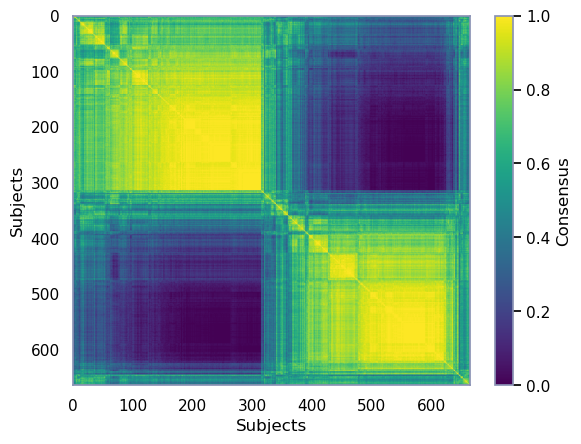

In [91]:
# Grab consensus
M = final_metrics['final_stability_SUM_MAT_full']['consensus']
M = np.asarray(M, dtype=float)

# Safety checks
assert M.ndim == 2 and M.shape[0] == M.shape[1], "Consensus must be square."
M = (M + M.T) / 2.0           # enforce symmetry (just in case)
np.fill_diagonal(M, 1.0)      # conventional

# Distance from consensus
D = 1.0 - M
dvec = squareform(D, checks=False)

# Hierarchical clustering (match your CCC linkage_method if you want)
Z = linkage(dvec, method="average")

# Leaf order and reordered matrix
order = leaves_list(Z)
M_ord = M[np.ix_(order, order)]

# Plot
plt.figure()
plt.imshow(M_ord, aspect='auto')
#plt.title("Consensus matrix (reordered by hierarchical clustering)")
plt.xlabel("Subjects")
plt.ylabel("Subjects")
plt.colorbar(label="Consensus")
plt.show()



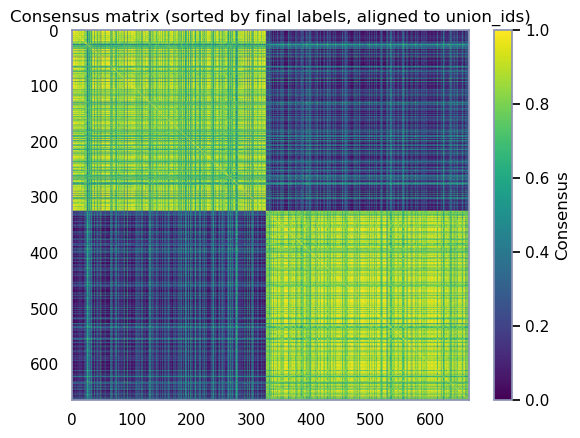

In [27]:
import numpy as np
import matplotlib.pyplot as plt

diag = final_metrics['final_stability_SUM_MAT_full']
M = np.asarray(diag['consensus'], dtype=float)
M = (M + M.T) / 2.0
np.fill_diagonal(M, 1.0)

union_ids = np.asarray(diag['union_ids'])

# --- you need the IDs that match final_labels order ---
final_labels = np.asarray(final_metrics['final_labels'])

# Replace this with the correct place where your IDs are stored:
final_ids = np.asarray(final_metrics['data']['Internalising']['src_subject_id'])
# OR: final_ids = np.asarray(final_metrics['final_ids'])  etc.

# Map id -> label
id2lab = dict(zip(final_ids, final_labels))

# Align labels to consensus matrix order
labels_aligned = np.array([id2lab[sid] for sid in union_ids])

# Now sort consensus by aligned labels
order = np.lexsort((np.arange(len(labels_aligned)), labels_aligned))
M_ord = M[np.ix_(order, order)]
labels_ord = labels_aligned[order]

plt.figure()
plt.imshow(M_ord, aspect='auto')
plt.title("Consensus matrix (sorted by final labels, aligned to union_ids)")
plt.colorbar(label="Consensus")
plt.show()

In [28]:
M = final_metrics['final_stability_SUM_MAT_full']['consensus']
M = np.asarray(M, float)
iu = np.triu_indices_from(M, k=1)
vals = M[iu]

print("fraction <0.1:", np.mean(vals < 0.1))
print("fraction >0.9:", np.mean(vals > 0.9))
print("PAC (0.1..0.9):", np.mean((vals > 0.1) & (vals < 0.9)))
print("mean:", np.mean(vals), "median:", np.median(vals))

fraction <0.1: 0.1343962315427122
fraction >0.9: 0.15227375668085877
PAC (0.1..0.9): 0.7099374943382553
mean: 0.5168834983330847 median: 0.5333333333333333


#### Matrix plots per view

Processing modality Internalising with stability metrics: CCC=0.9669822415277215, PAC=0.47881148654769456


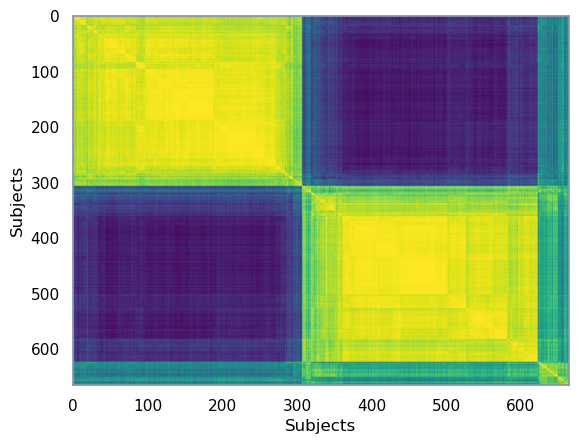

Processing modality Functioning with stability metrics: CCC=0.9744897912306606, PAC=0.45527674608207264


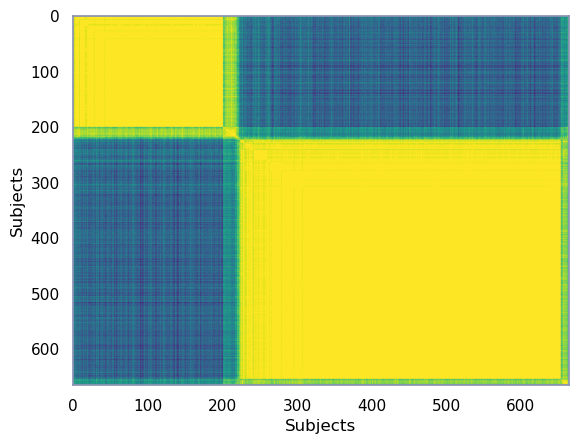

Processing modality Detachment with stability metrics: CCC=0.925747932479476, PAC=0.6104583748527946


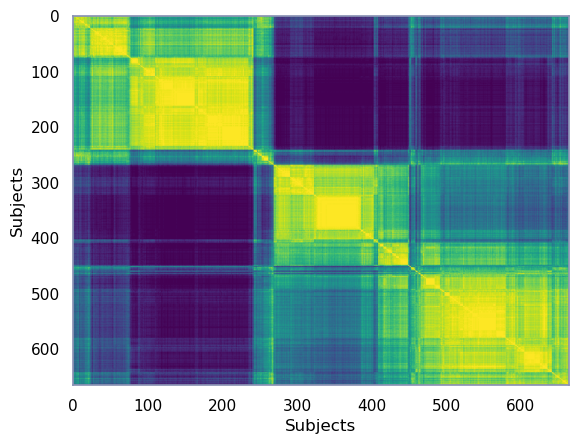

Processing modality Psychoticism with stability metrics: CCC=0.961400280862263, PAC=0.3112917836760576


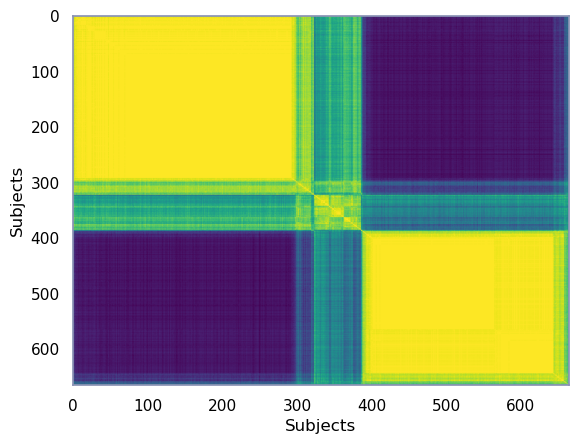

Processing modality Cognition with stability metrics: CCC=0.9146043998941764, PAC=0.5358773439623155


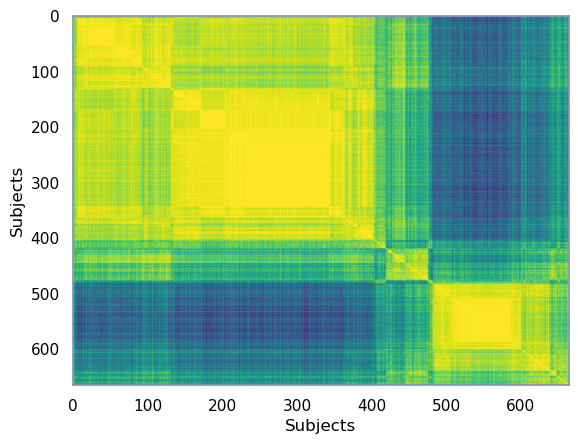

In [90]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage, leaves_list, cut_tree
from scipy.cluster import hierarchy


indiv_labels_TEST = []
for i in range(0, len(final_metrics['per_view_stabilities_SUM_MAT_full'])):
    modality = final_metrics['per_view_stabilities_SUM_MAT_full'][i]
    mod_name = list(final_metrics['data'].keys())[i]
    print(f"Processing modality {mod_name} with stability metrics: CCC={modality['CCC']}, PAC={modality['PAC']}")
    M = np.asarray(modality['consensus'], dtype=float)

    # Safety checks
    assert M.ndim == 2 and M.shape[0] == M.shape[1], "Consensus must be square."
    M = (M + M.T) / 2.0           # enforce symmetry (just in case)
    np.fill_diagonal(M, 1.0)      # conventional

    # Distance from consensus
    D = 1.0 - M
    dvec = squareform(D, checks=False)

    # Hierarchical clustering (match your CCC linkage_method if you want)
    Z = linkage(dvec, method="average")

    indiv_labels_TEST.append(mod_name)


    # Leaf order and reordered matrix
    order = leaves_list(Z)
    M_ord = M[np.ix_(order, order)]

    # Plot
    plt.figure()
    plt.imshow(M_ord, aspect='auto')
    #plt.title(f"Consensus matrix for {mod_name} (reordered by hierarchical clustering)")
    plt.xlabel("Subjects")
    plt.ylabel("Subjects")
    #plt.colorbar(label="Consensus")
    plt.show()


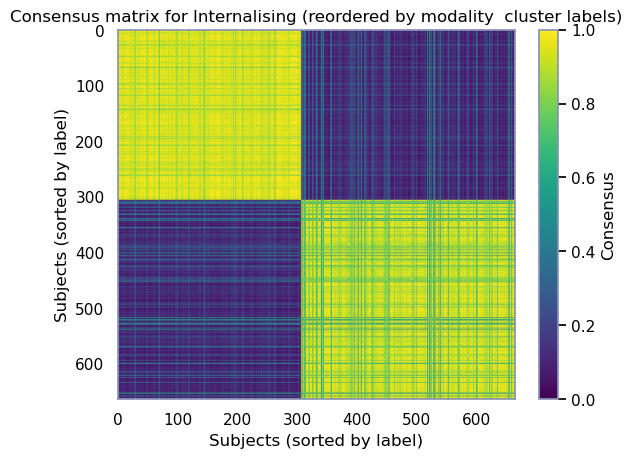

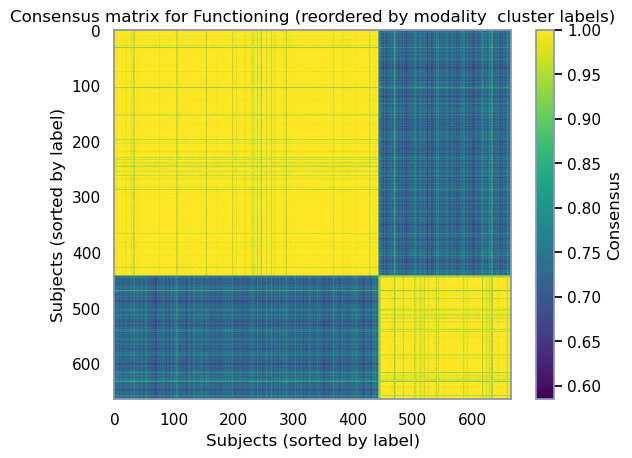

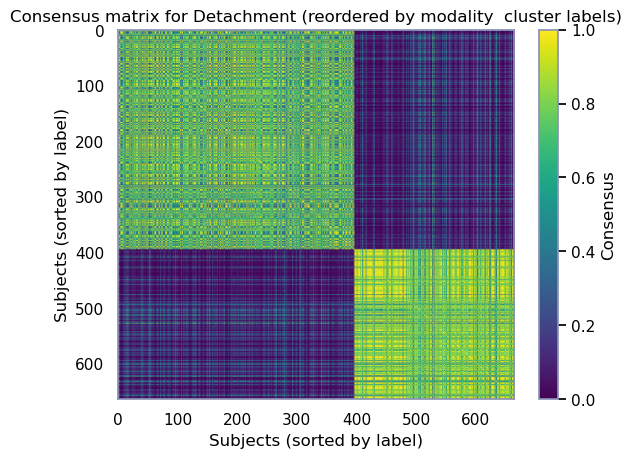

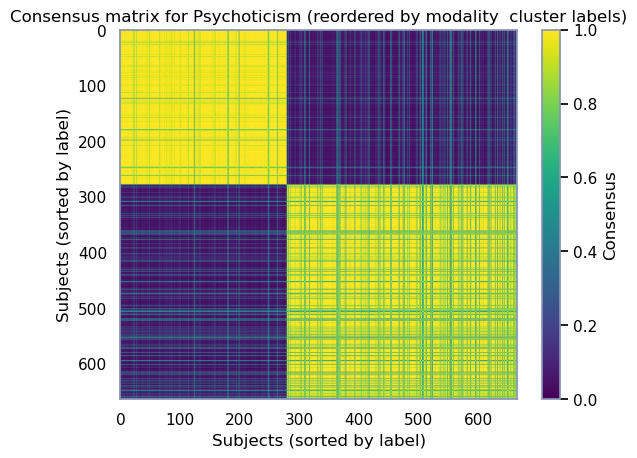

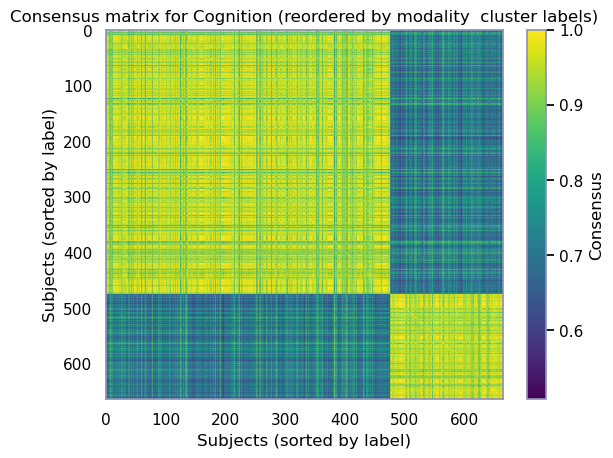

In [30]:
for i in range(0, len(final_metrics['per_view_stabilities_SUM_MAT_full'])):
    modality = final_metrics['per_view_stabilities_SUM_MAT_full'][i]
    mod_name = list(final_metrics['data'].keys())[i]
    M = np.asarray(modality['consensus'], dtype=float)
    M = (M + M.T) / 2.0
    np.fill_diagonal(M, 1.0)

    labels = final_metrics['individual_labels'][i]

    # Replace this with the correct place where your IDs are stored:
    final_ids = np.asarray(final_metrics['data'][mod_name]['src_subject_id'])

    # Map id -> label
    id2lab = dict(zip(final_ids, labels))

    # Align labels to consensus matrix order
    labels_aligned = np.array([id2lab[sid] for sid in union_ids])

    # Now sort consensus by aligned labels
    order = np.lexsort((np.arange(len(labels_aligned)), labels_aligned))
    M_ord = M[np.ix_(order, order)]
    labels_ord = labels_aligned[order]


    plt.figure()
    plt.imshow(M_ord, aspect='auto')
    plt.title(f"Consensus matrix for {mod_name} (reordered by modality  cluster labels)")
    plt.xlabel("Subjects (sorted by label)")
    plt.ylabel("Subjects (sorted by label)")
    plt.colorbar(label="Consensus")
    plt.show()

## Plot VAE results

In [31]:
%%script false --no-raise-error
#Remove this line above if you want to run the cell. This is just so that it doesn't always run.

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

# Loop over fold files

data = final_metrics['ae_res']   # dict: modality -> DataFrame / dict

for modality, results in data.items():
    print(f"Modality: {modality}")
    test_latent = data[modality]['final_latent']

    X_true = data[modality]['all_true']
    X_pred = data[modality]['all_pred']

    # -----------------------------
    # Original vs reconstructed plot
    # -----------------------------
    plt.figure(figsize=(6, 6))
    plt.scatter(X_true, X_pred, alpha=0.5)
    plt.xlabel("Original Data")
    plt.ylabel("Reconstructed Data")
    plt.title(f"Original vs. Reconstructed Data ({modality})")

    # Diagonal reference line
    min_val = min(X_true.min(), X_pred.min())
    max_val = max(X_true.max(), X_pred.max())
    plt.plot([min_val, max_val], [min_val, max_val], 'r--', linewidth=2)
    plt.tight_layout()
    plt.show()

    # -----------------------------
    # Histogram of latent variables
    # (if test_latent is 1D, this will just be that; if 2D, this is all values flattened)
    # -----------------------------
    plt.figure()
    plt.hist(test_latent, bins=np.linspace(-2, 2, 50))
    plt.title(f"Latent Distribution ({modality})")
    plt.tight_layout()
    plt.show()

    # -----------------------------
    # Pairwise scatter plots of latent dims (scatter matrix)
    # -----------------------------
    # Ensure we have a DataFrame for easy labeling
    if isinstance(test_latent, pd.DataFrame):
        latent_df = test_latent.copy()
    else:
        test_latent_arr = np.asarray(test_latent)
        # assume shape (n_samples, latent_dim)
        if test_latent_arr.ndim == 1:
            test_latent_arr = test_latent_arr.reshape(-1, 1)
        n_latent = test_latent_arr.shape[1]
        latent_df = pd.DataFrame(
            test_latent_arr,
            columns=[f"z{i}" for i in range(n_latent)]
        )

    # Scatter matrix: each latent variable against every other
    plt.figure(figsize=(8, 8))
    axes = scatter_matrix(latent_df, alpha=0.5, figsize=(8, 8), diagonal='hist')
    plt.suptitle(f"Pairwise Latent Scatter Plots ({modality})")
    plt.tight_layout()
    plt.show()

## tSNE plots

### Individual labels

  Modality: Internalising


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


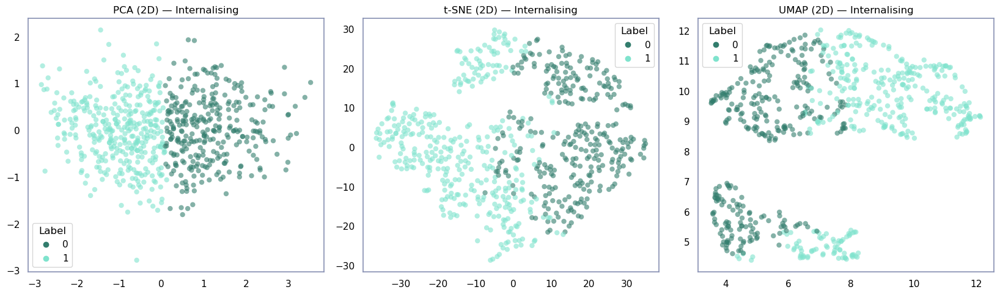

  Modality: Functioning


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


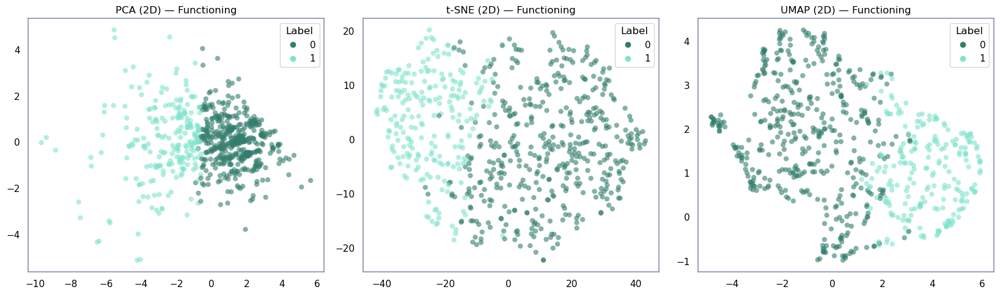

  Modality: Detachment


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


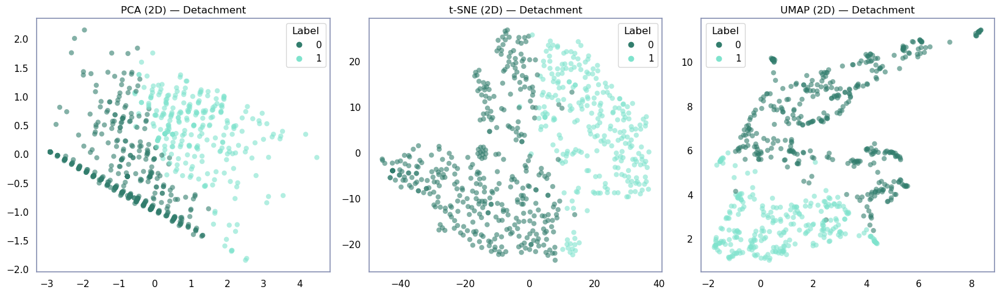

  Modality: Psychoticism


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


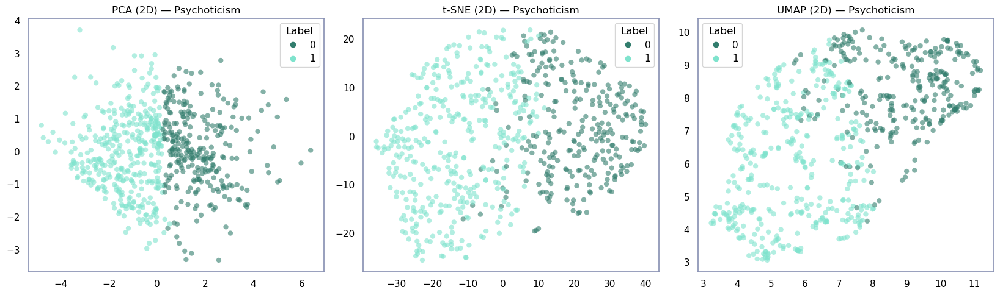

  Modality: Cognition


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


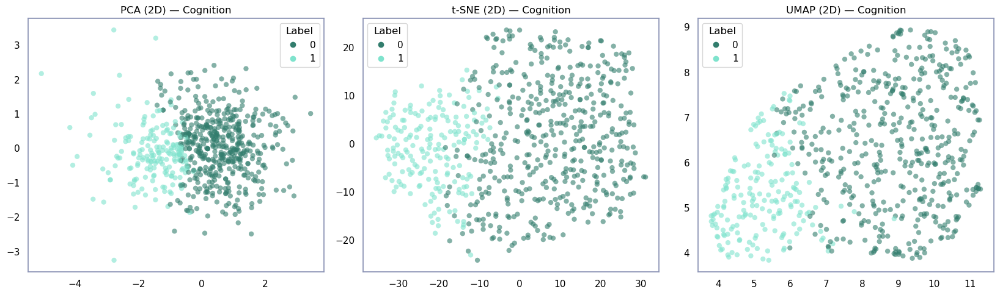

In [32]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np
import umap  # pip install umap-learn

#Create directory for final latent space plots
os.makedirs(os.path.join(plots_dir, "merged_tsne/"), exist_ok=True)

data = final_metrics['ae_res']                     # dict: modality -> DataFrame
labels_list = final_metrics['individual_labels']  # list of label vectors

modality_names = list(data.keys())

if len(labels_list) != len(modality_names):
    raise ValueError(
        f"labels_list has {len(labels_list)} items but there are "
        f"{len(modality_names)} modalities for {fold_name}."
    )

for i, modality in enumerate(modality_names):
    print(f"  Modality: {modality}")
    df = data[modality]
    X = np.asarray(df['final_latent'])
    y = np.asarray(labels_list[i])

    if len(y) != len(X):
        raise ValueError(
            f"Label vector length ({len(y)}) does not match samples ({len(X)}) "
            f"for {fold_name}, modality {modality}."
        )

    # ----- color mapping -----
    classes = np.unique(y)
    palette = sns.color_palette(n_colors=len(classes))  # <-- uses current theme palette
    color_map = {cls: palette[j] for j, cls in enumerate(classes)}
    colors = [color_map[cls] for cls in y]

    # ----- dimensionality reductions -----
    pca = PCA(n_components=2)
    pca_proj = pca.fit_transform(X)

    tsne_2d = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_proj_2d = tsne_2d.fit_transform(X)

    umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
    umap_proj_2d = umap_2d.fit_transform(X)

    # ----- plots -----
    fig = plt.figure(figsize=(22, 5))

    ax1 = fig.add_subplot(1, 4, 1)
    ax1.scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    ax1.set_title(f'PCA (2D) — {modality}')

    ax2 = fig.add_subplot(1, 4, 2)
    ax2.scatter(tsne_proj_2d[:, 0], tsne_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
    ax2.set_title(f't-SNE (2D) — {modality}')

    ax4 = fig.add_subplot(1, 4, 3)
    ax4.scatter(umap_proj_2d[:, 0], umap_proj_2d[:, 1], c=colors, alpha=0.6, edgecolors="none")
    ax4.set_title(f'UMAP (2D) — {modality}')

    # unified legend
    handles = [Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
                for cls in classes]
    for ax in [ax1, ax2, ax4]:
        ax.legend(handles=handles, title='Label', loc='best', frameon=True)

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_tsne/", f"{fold_name}_{modality}_merged_individual_tsne.png"))
    plt.show()

### Final labels

  Modality: Internalising


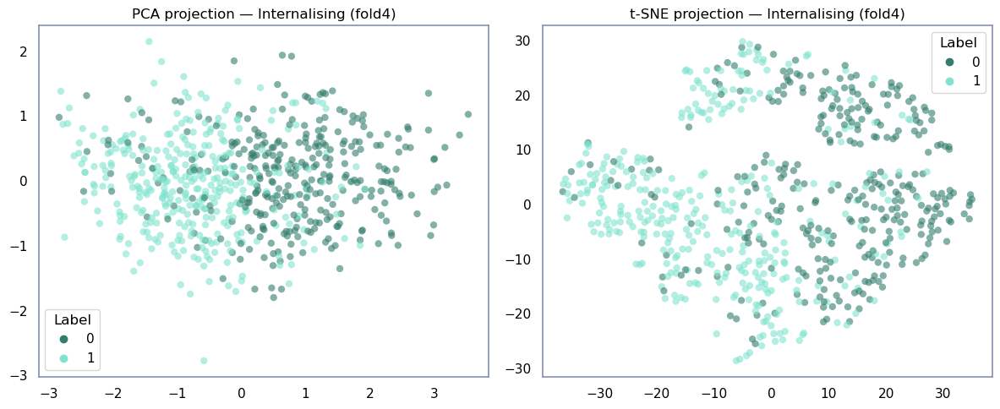

  Modality: Functioning


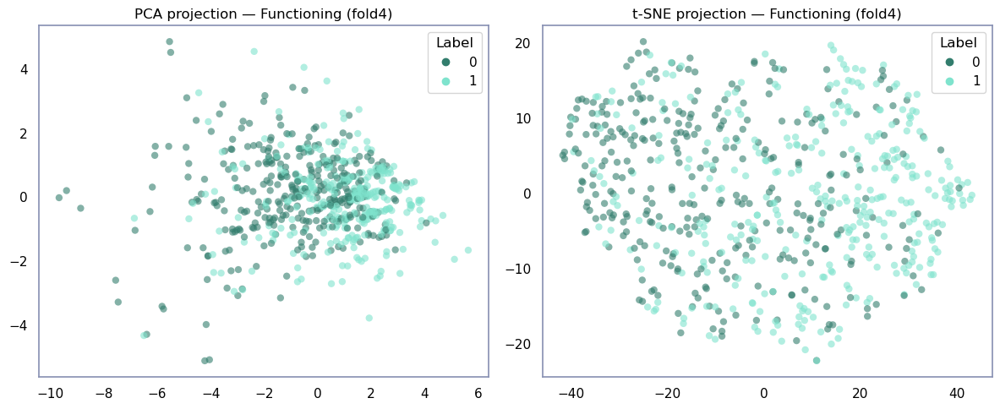

  Modality: Detachment


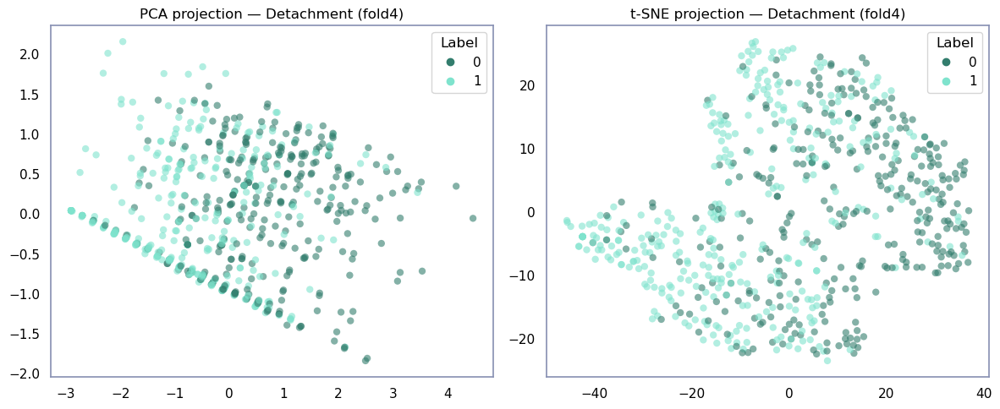

  Modality: Psychoticism


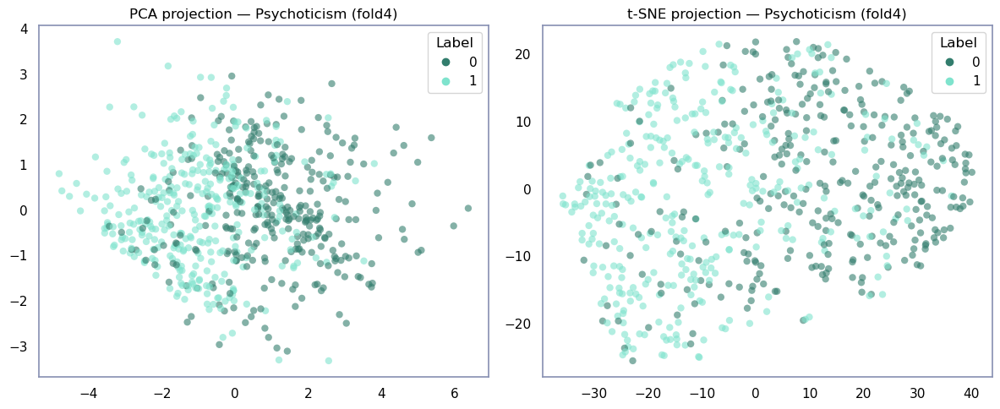

  Modality: Cognition


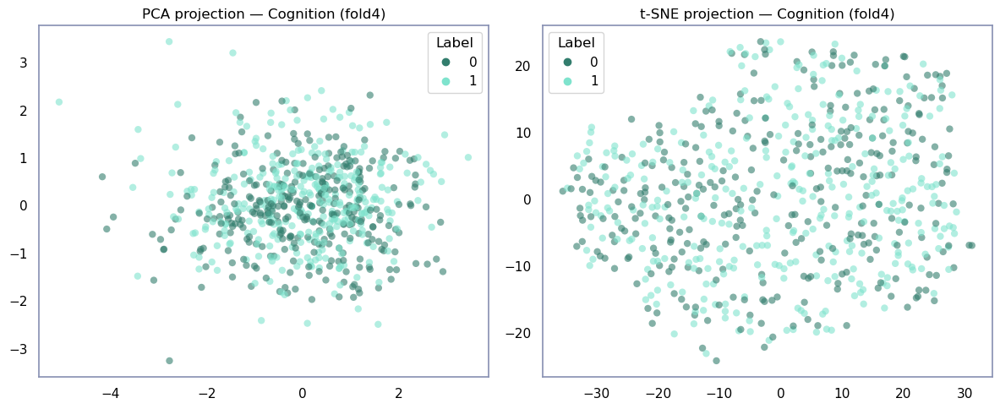

In [33]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np



data = final_metrics['ae_res']                       # dict: modality -> DataFrame
y = np.asarray(final_metrics['final_labels'])  # one label vector for the whole fold

# Build a stable color map for this fold (consistent colors across all modalities)
classes = np.unique(y)
palette = sns.color_palette(n_colors=len(classes))  # <-- uses current theme palette
color_map = {cls: palette[j] for j, cls in enumerate(classes)}
colors = [color_map[cls] for cls in y]

modality_names = list(data.keys())

for modality in modality_names:
    print(f"  Modality: {modality}")
    df = data[modality]
    X = np.asarray(df['final_latent'])

    if len(y) != len(X):
        raise ValueError(
            f"Label vector length ({len(y)}) does not match samples ({len(X)}) "
            f"for {fold_name}, modality {modality}. Ensure correct alignment."
        )

    colors = [color_map[cls] for cls in y]

    # --- Dimensionality reductions ---
    pca = PCA(n_components=2)
    pca_proj = pca.fit_transform(X)

    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_proj = tsne.fit_transform(X)

    # --- Plot side-by-side ---
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    axes[0].scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    axes[0].set_title(f'PCA projection — {modality} ({fold_name})')

    axes[1].scatter(tsne_proj[:, 0], tsne_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
    axes[1].set_title(f't-SNE projection — {modality} ({fold_name})')

    # Legend
    handles = [
        Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
        for cls in classes
    ]
    for ax in axes:
        ax.legend(handles=handles, title='Label', loc='best', frameon=True)

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_tsne/", f"{fold_name}_{modality}_merged_final_tsne.png"))
    plt.show()

### Plot final labels across modalities

/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


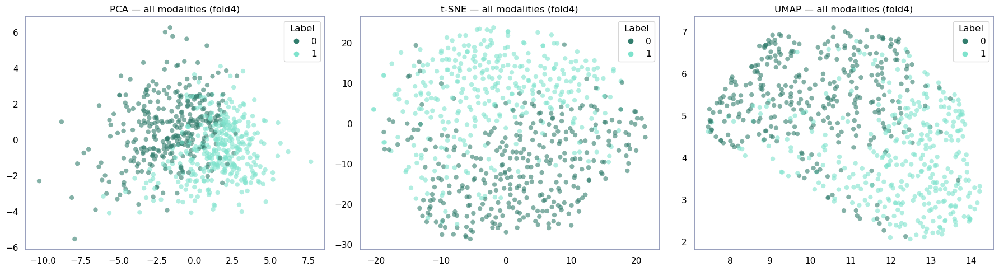

In [34]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import numpy as np


data = final_metrics['ae_res']                       # modality -> dict with 'final_latent'
y = np.asarray(final_metrics['final_labels'])  # labels aligned to subjects

modality_names = list(data.keys())
latent_blocks = []

for modality in modality_names:
    X_mod = np.asarray(data[modality]['final_latent'])
    if X_mod.shape[0] != len(y):
        raise ValueError(
            f"Label vector length ({len(y)}) != samples ({X_mod.shape[0]}) "
            f"for {fold_name}, modality {modality}"
        )
    latent_blocks.append(X_mod)

# concatenate [n_samples, sum(latent_dims)]
X_all = np.hstack(latent_blocks)

classes = np.unique(y)
palette = sns.color_palette(n_colors=len(classes))  # <-- uses current theme palette
color_map = {cls: palette[j] for j, cls in enumerate(classes)}
colors = [color_map[cls] for cls in y]

# --- PCA projection over all modalities ---
pca = PCA(n_components=2)
pca_proj = pca.fit_transform(X_all)

# --- t-SNE projection over all modalities ---
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_proj = tsne.fit_transform(X_all)

# --- UMAP projection over all modalities ---
umap_2d = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1, random_state=42)
umap_proj = umap_2d.fit_transform(X_all)

# --- Plot side-by-side ---
fig, axes = plt.subplots(1, 3, figsize=(18, 5))
axes[0].scatter(pca_proj[:, 0], pca_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
axes[0].set_title(f"PCA — all modalities ({fold_name})")

axes[1].scatter(tsne_proj[:, 0], tsne_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
axes[1].set_title(f"t-SNE — all modalities ({fold_name})")

axes[2].scatter(umap_proj[:, 0], umap_proj[:, 1], c=colors, alpha=0.6, edgecolors="none")
axes[2].set_title(f"UMAP — all modalities ({fold_name})")

handles = [
    Line2D([0], [0], marker='o', linestyle='', color=color_map[cls], label=str(cls))
    for cls in classes
]
for ax in axes:
    ax.legend(handles=handles, title='Label', loc='best', frameon=True)

plt.tight_layout()
fig.savefig(os.path.join(plots_dir, "merged_tsne/", f"merged_final_alldata_tsne.png"))
plt.show()




### Show the final quality and stability metrics

In [36]:
print('Mean quality across modalities',final_metrics['view_quality_mean'])
print('Final integrated cluster quality',final_metrics['final_quality'])
print('Mean stability across modalities',final_metrics['mean_view_stability'])
print('Final integrated cluster stability',final_metrics['final_stability'])

Mean quality across modalities 0.6792864202964995
Final integrated cluster quality 0.821526228539338
Mean stability across modalities 0.5527349191781723
Final integrated cluster stability 0.4044294954670269


## Differences features

### Differences in original features based on modality labels


=== Modality: Internalising ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: UserWarning:

The palette list has more values (30) than needed (7), which may not be intended.



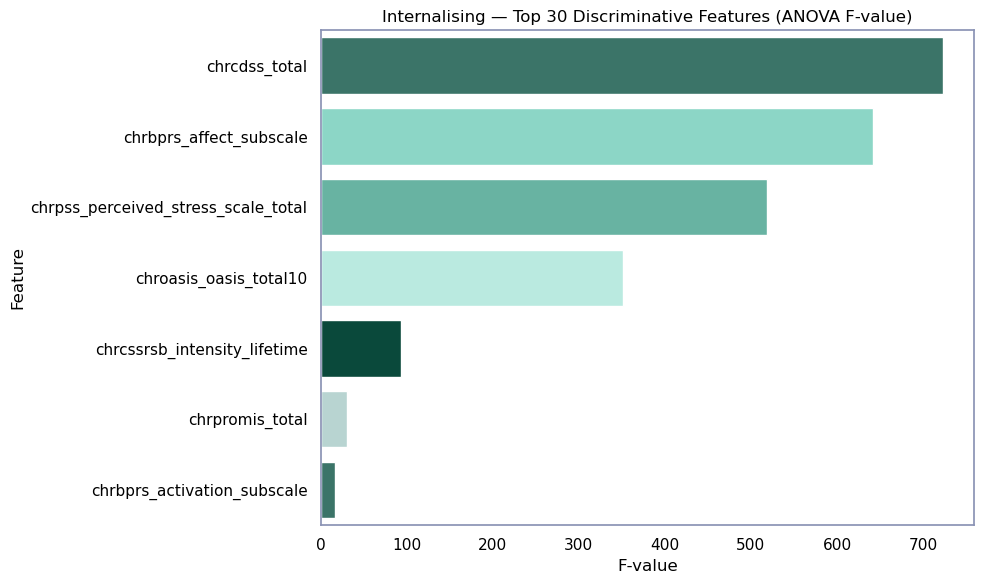

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

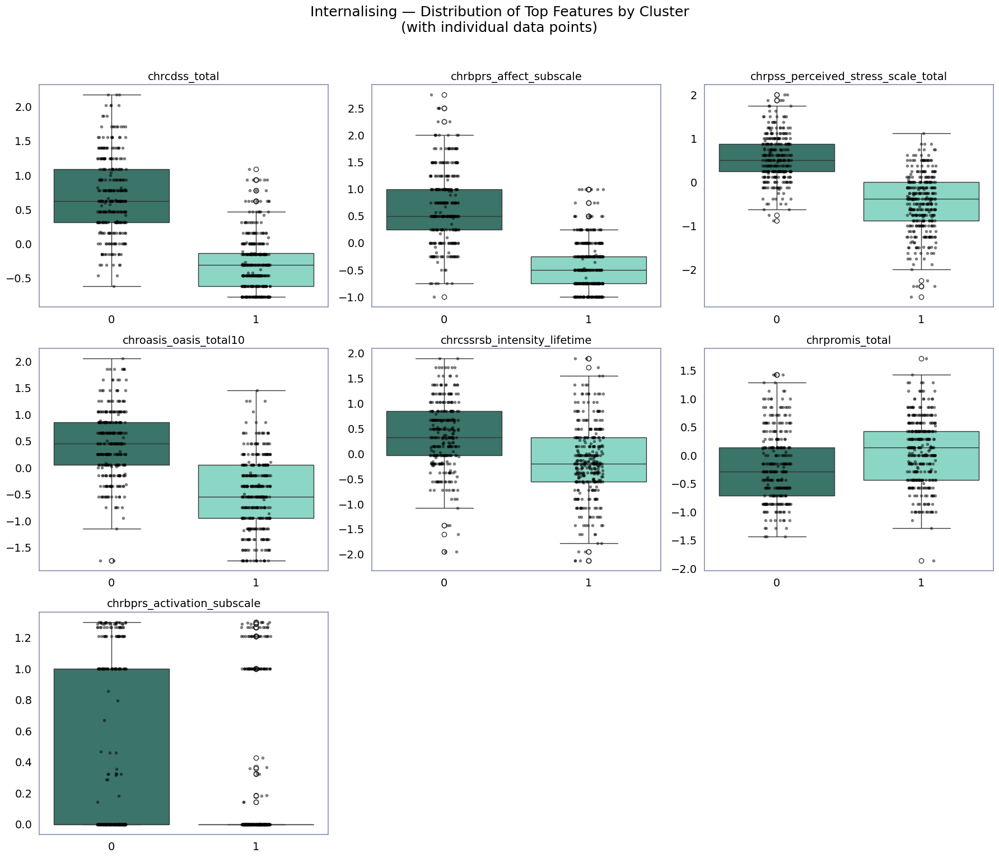


=== Modality: Functioning ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: UserWarning:

The palette list has more values (30) than needed (12), which may not be intended.



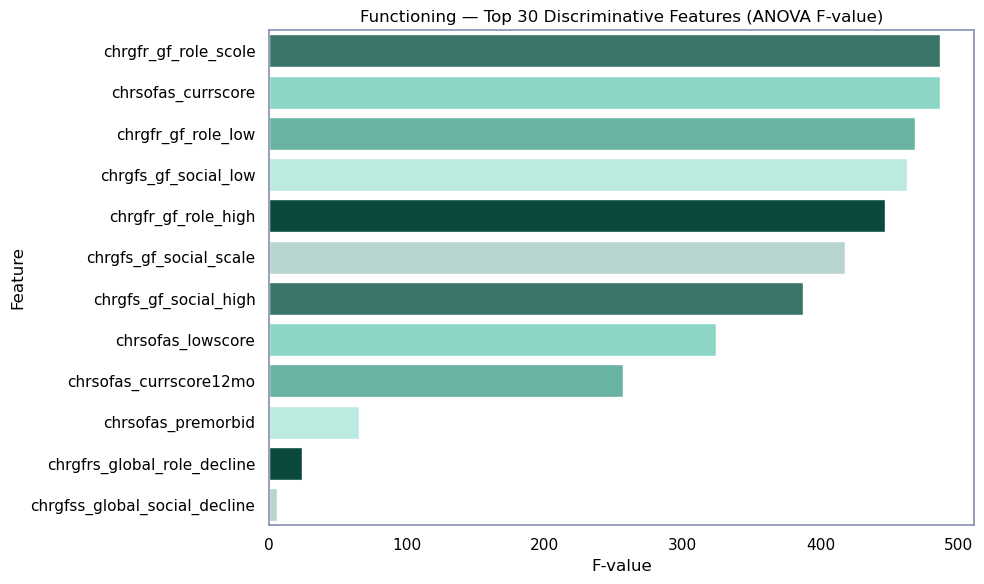

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

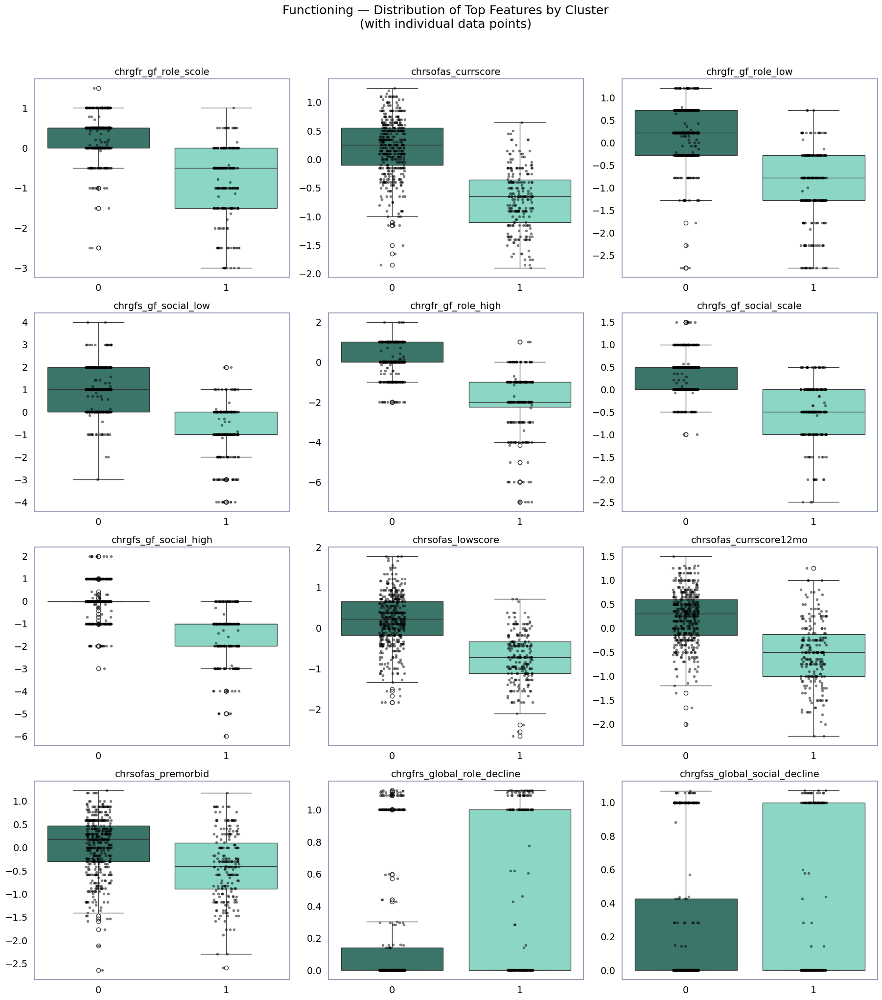


=== Modality: Detachment ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: UserWarning:

The palette list has more values (30) than needed (7), which may not be intended.



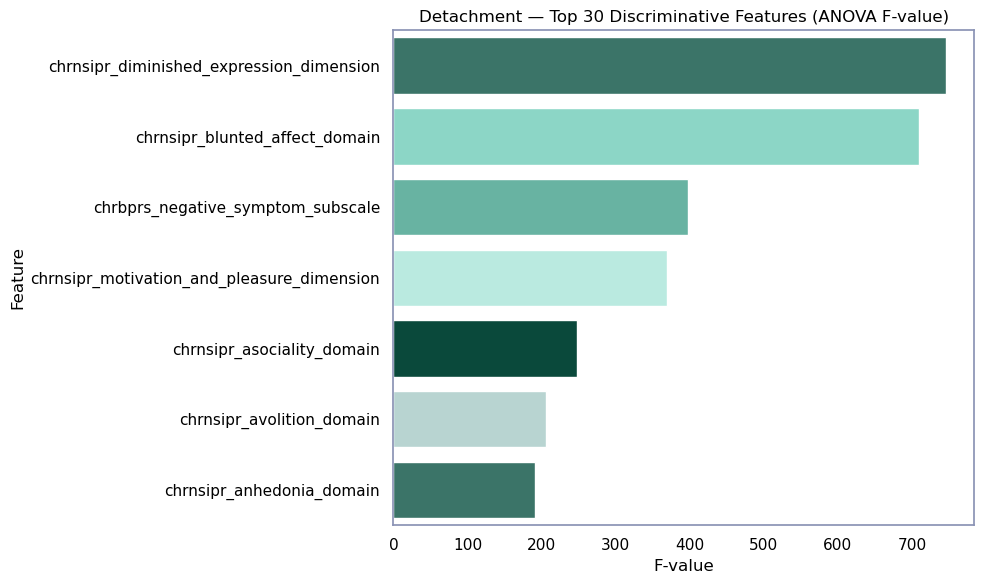

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

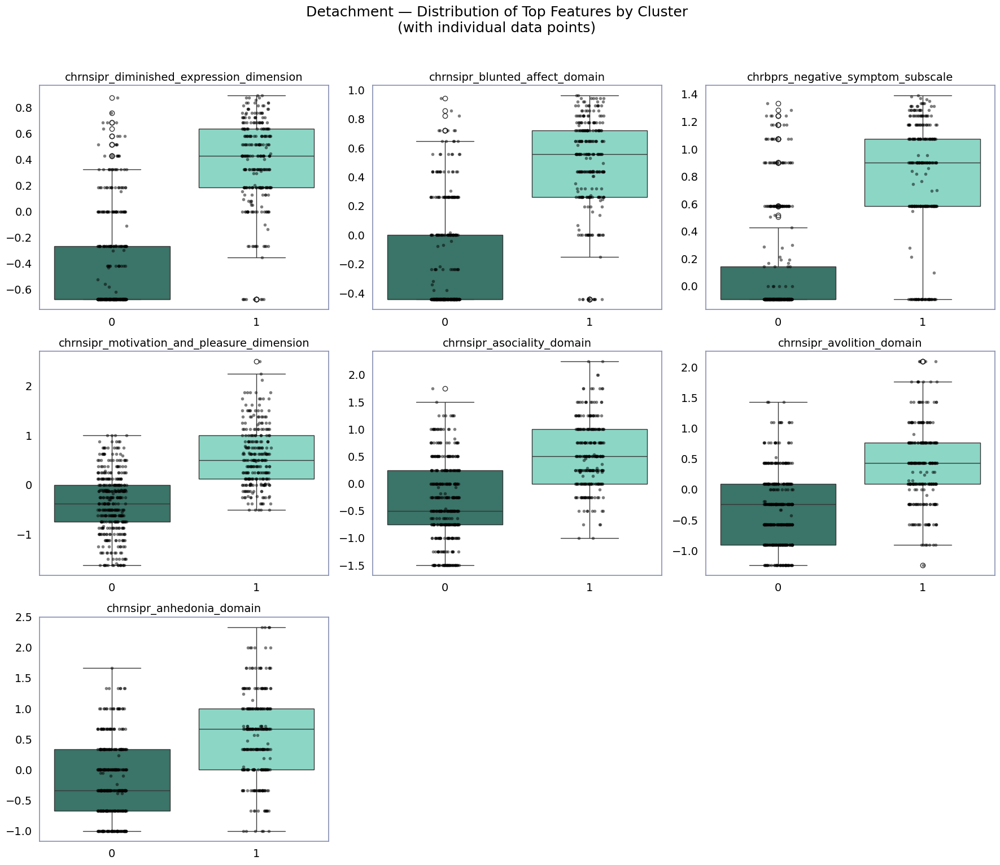


=== Modality: Psychoticism ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: UserWarning:

The palette list has more values (30) than needed (14), which may not be intended.



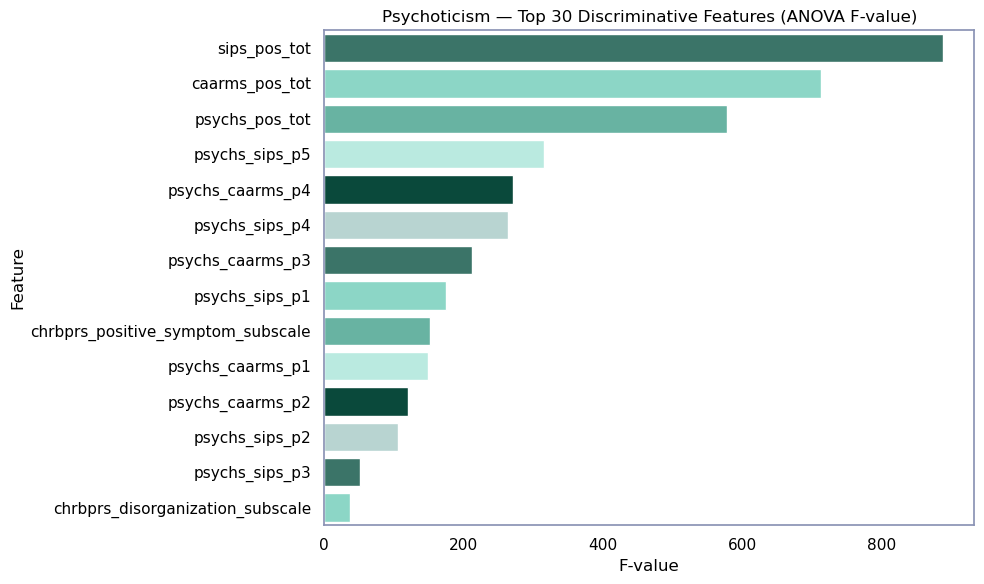

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

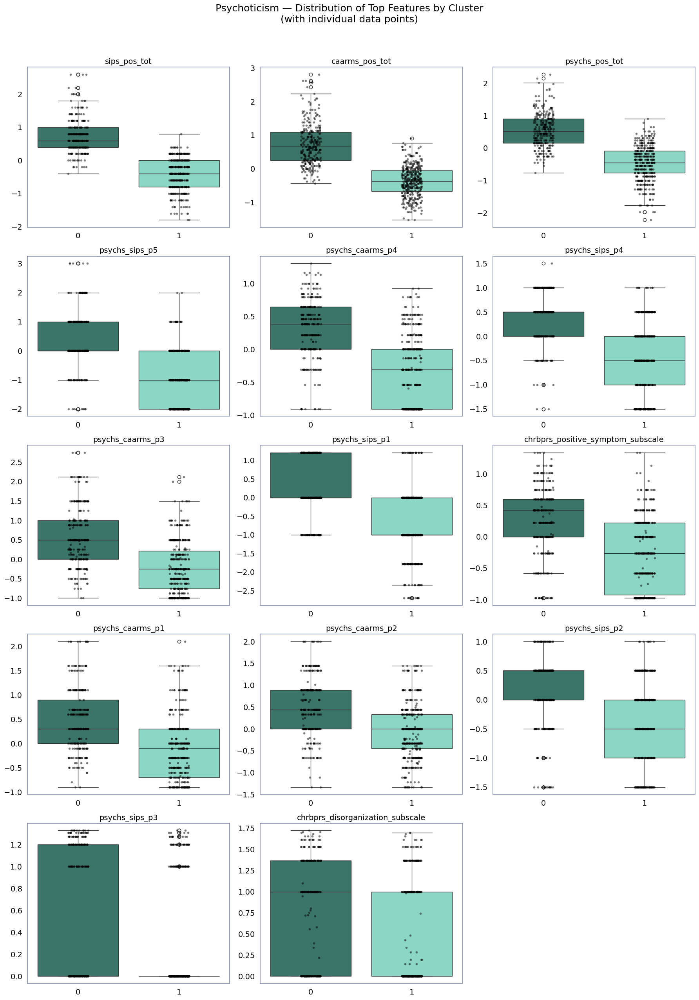


=== Modality: Cognition ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:28: UserWarning:

The palette list has more values (30) than needed (8), which may not be intended.



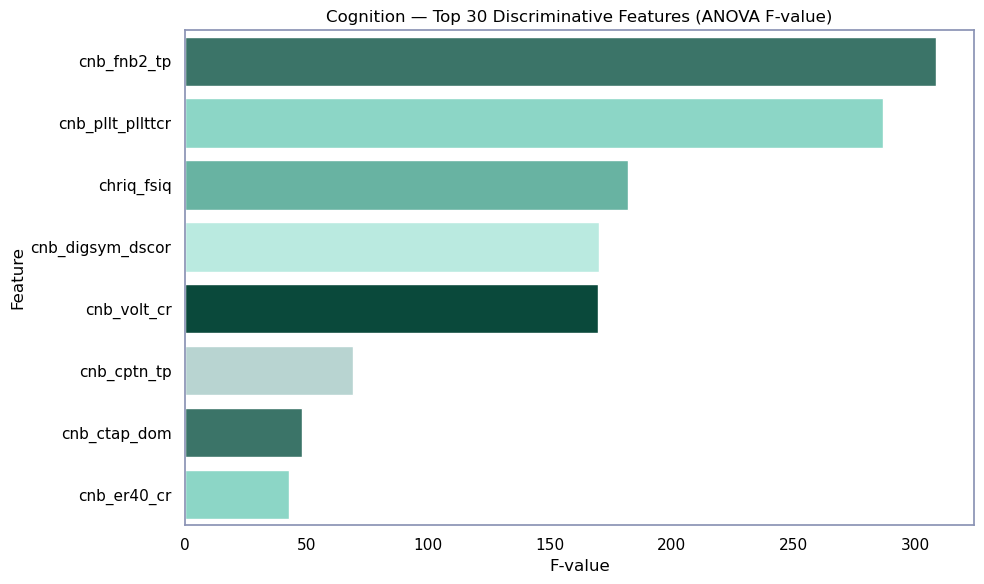

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2605700071.py:51: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

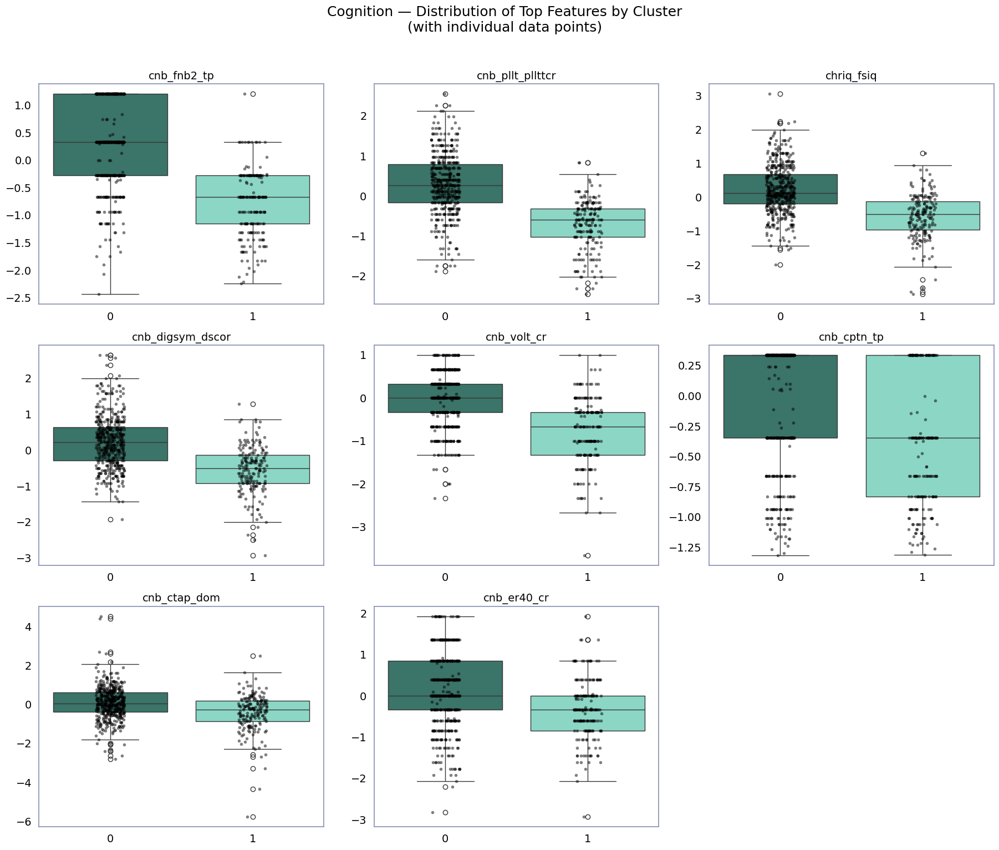

In [181]:
from sklearn.feature_selection import f_classif
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create directory for differences in original features plots
os.makedirs(os.path.join(plots_dir, "merged_feature_differences/"), exist_ok=True)

mod_num=0
for modality, df in final_metrics['data'].items():
    print(f"\n=== Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = final_metrics['individual_labels'][mod_num]
    feature_names = df.drop(columns=['src_subject_id']).columns

    # --- Feature Ranking (ANOVA F-test) ---
    f_vals, _ = f_classif(X, clusters)
    f_df = (
        pd.DataFrame({'feature': feature_names, 'f_value': f_vals})
        .sort_values('f_value', ascending=False)
    )

    # --- Barplot of Top Features ---
    top_k = 30
    plt.figure(figsize=(10, 6))
    sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
    plt.title(f"{modality} — Top {top_k} Discriminative Features (ANOVA F-value)")
    plt.xlabel("F-value")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()


    # --- Boxplots + Scatter Points of Top Features ---
    top_features = f_df['feature'].head(top_k).tolist()

    max_cols = 3
    n_feats = len(top_features)
    n_rows = int(np.ceil(n_feats / max_cols))

    fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
    axes = axes.flatten()

    cluster_order = np.unique(clusters)  # or a custom order you want
    pal = sns.color_palette(n_colors=len(cluster_order)) 

    for i, feat in enumerate(top_features):
        ax = axes[i]
        sns.boxplot(
            x=clusters, y=df[feat], palette=pal, ax=ax
        )
        sns.stripplot(
            x=clusters, y=df[feat],
            color='black', size=4, jitter=True, alpha=0.5, ax=ax
        )

        # Larger text sizes
        ax.set_title(feat, fontsize=14)
        ax.set_xlabel("", fontsize=22)
        ax.set_ylabel("", fontsize=22)
        ax.tick_params(axis='both', labelsize=14)

    # Hide unused axes
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.suptitle(
        f"{modality} — Distribution of Top Features by Cluster\n(with individual data points)",
        y=1.02, fontsize=18
    )

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_feature_differences/", f"{modality}_top_features.png"))
    plt.show()

    mod_num=mod_num+1


=== PCA Aggregated Plots — Modality: Internalising ===
PC1 EVR: 41.42%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3576366199.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




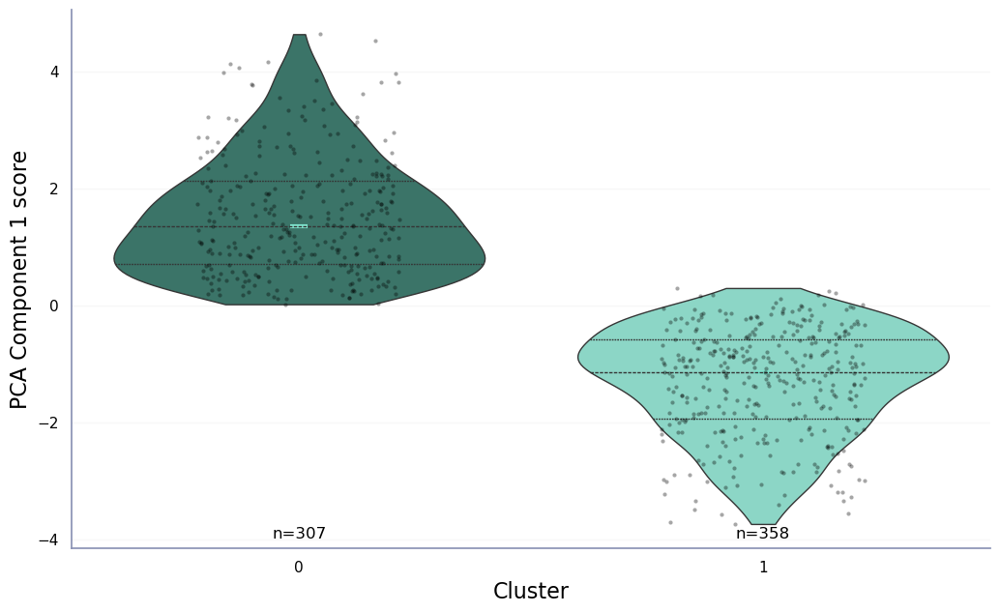

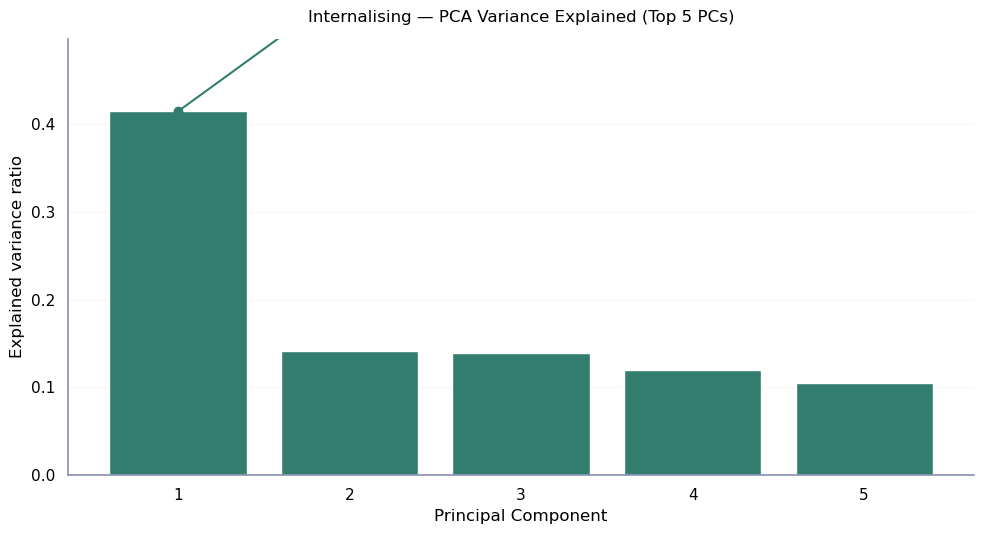

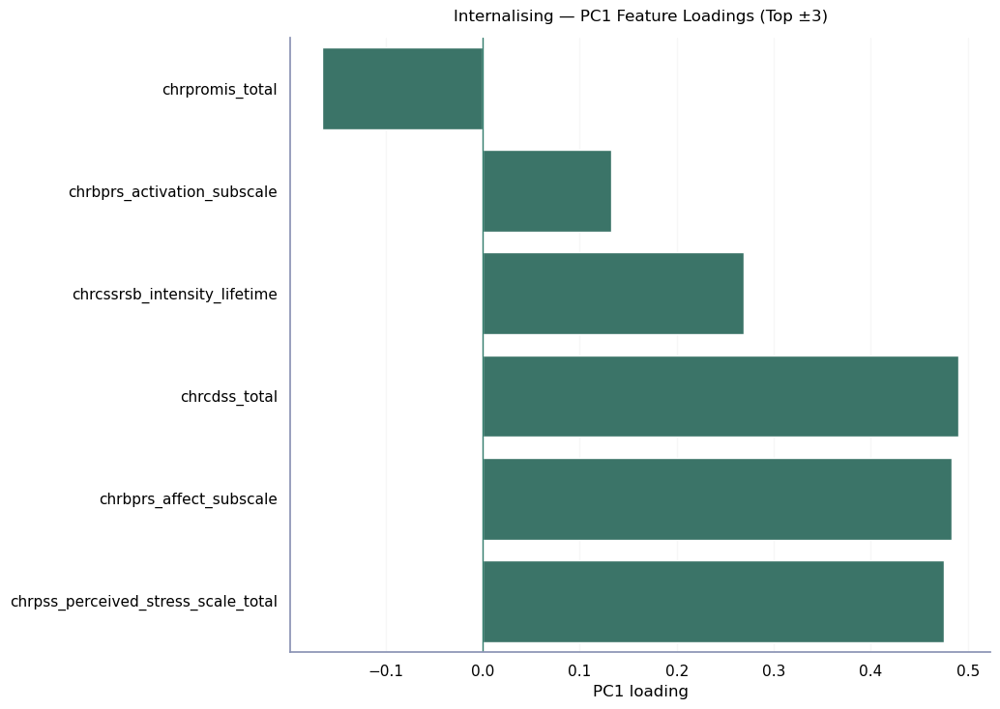


=== PCA Aggregated Plots — Modality: Functioning ===
PC1 EVR: 46.28%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3576366199.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




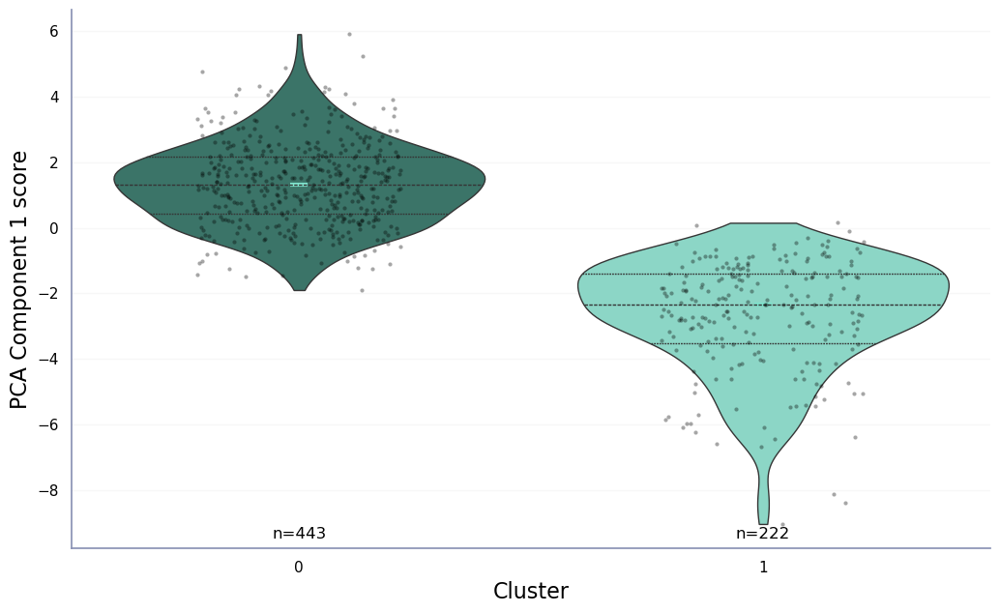

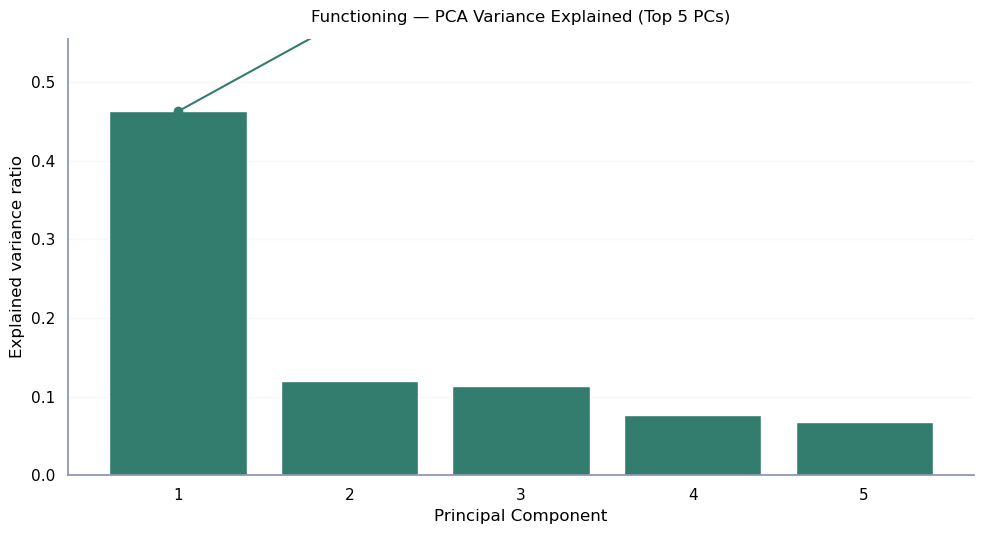

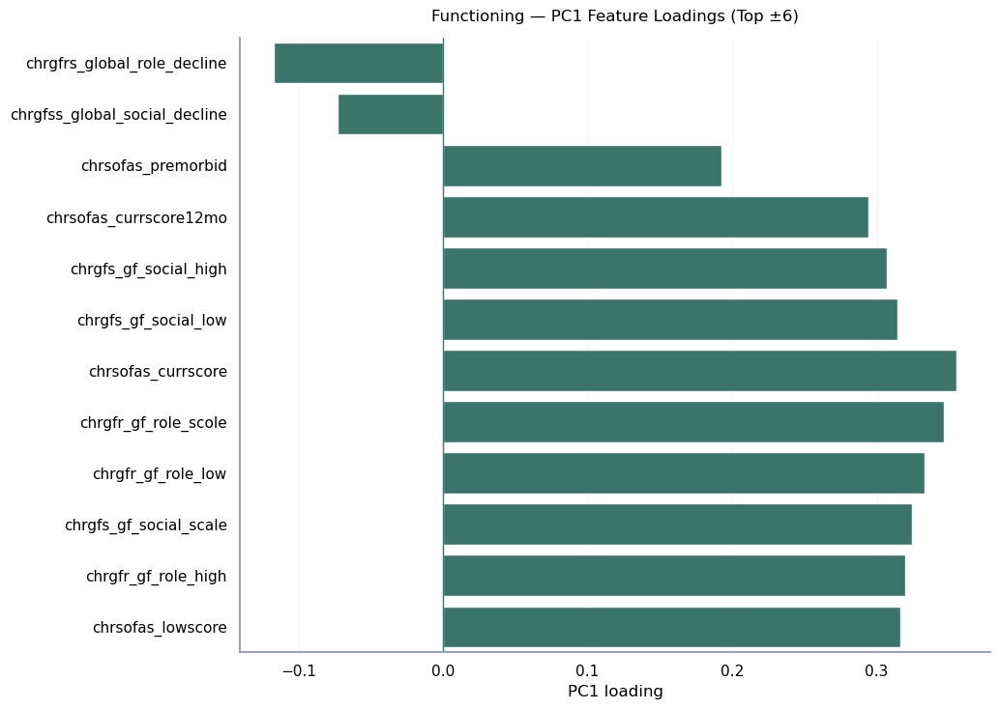


=== PCA Aggregated Plots — Modality: Detachment ===
PC1 EVR: 54.72%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3576366199.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




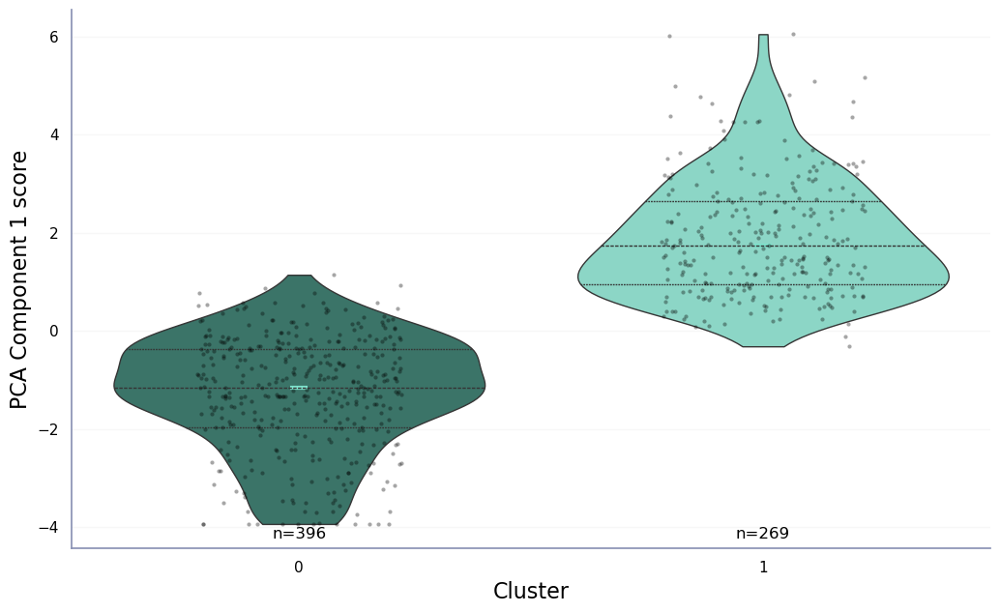

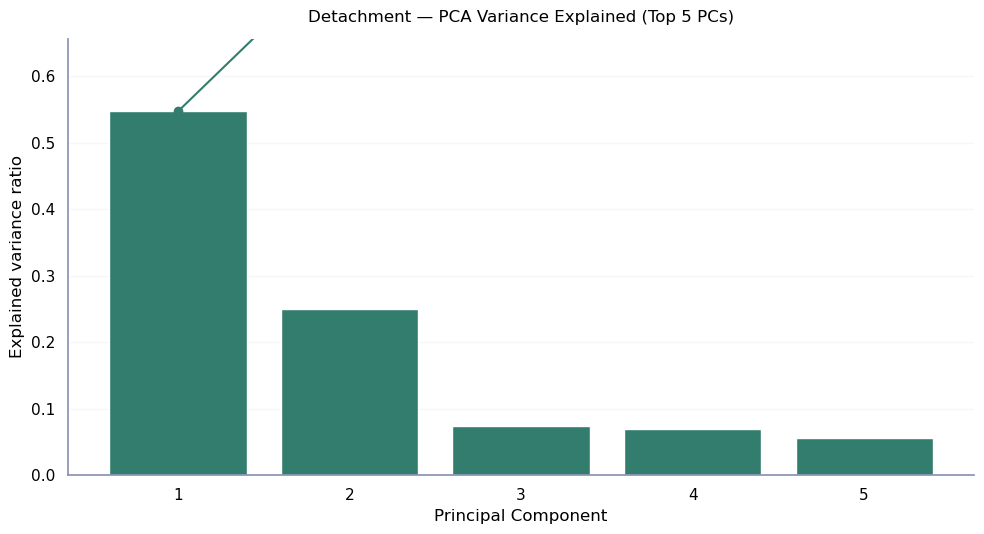

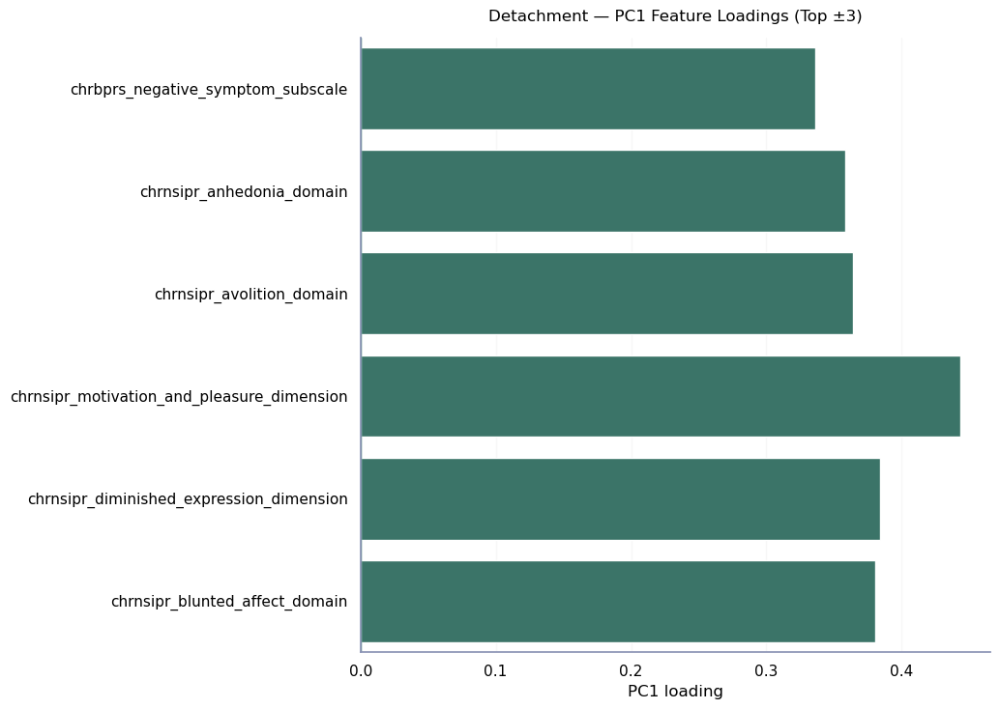


=== PCA Aggregated Plots — Modality: Psychoticism ===
PC1 EVR: 41.77%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3576366199.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




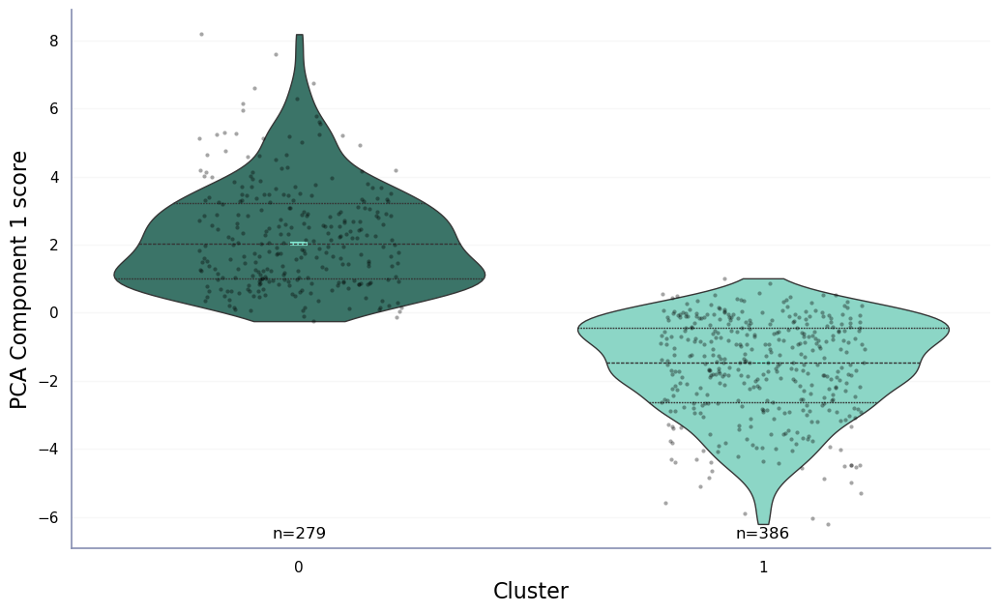

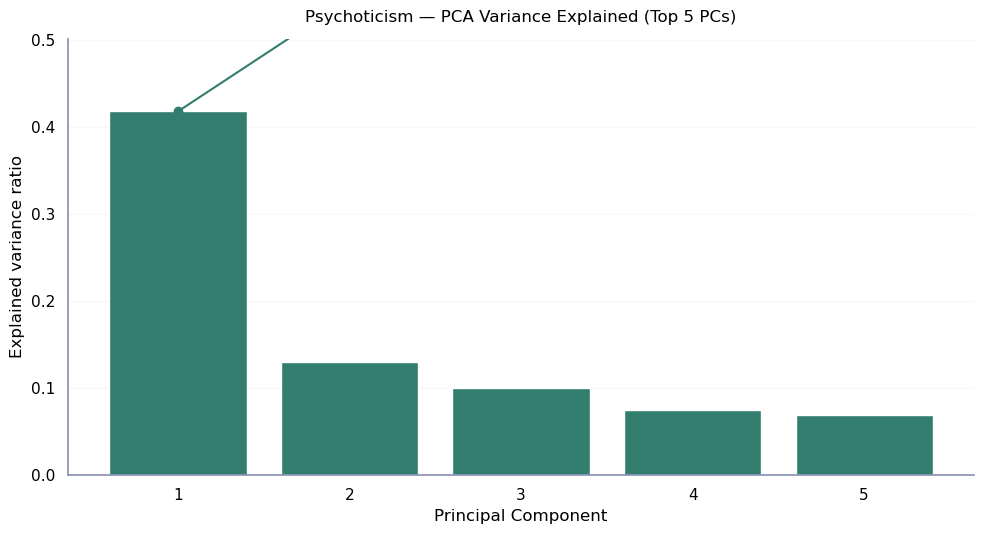

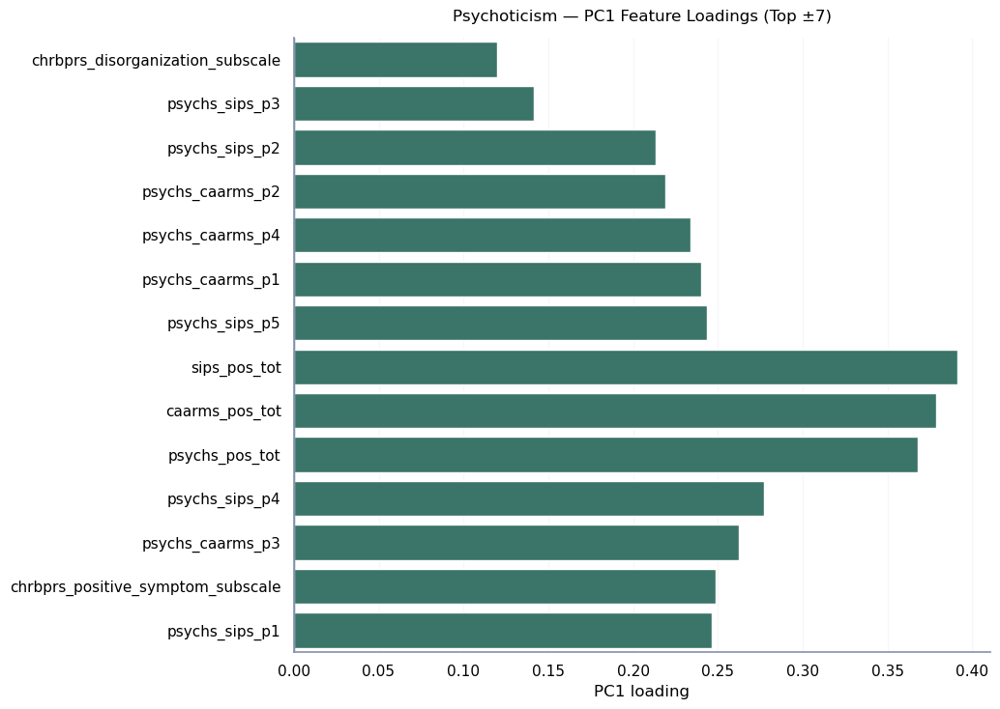


=== PCA Aggregated Plots — Modality: Cognition ===
PC1 EVR: 32.89%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3576366199.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




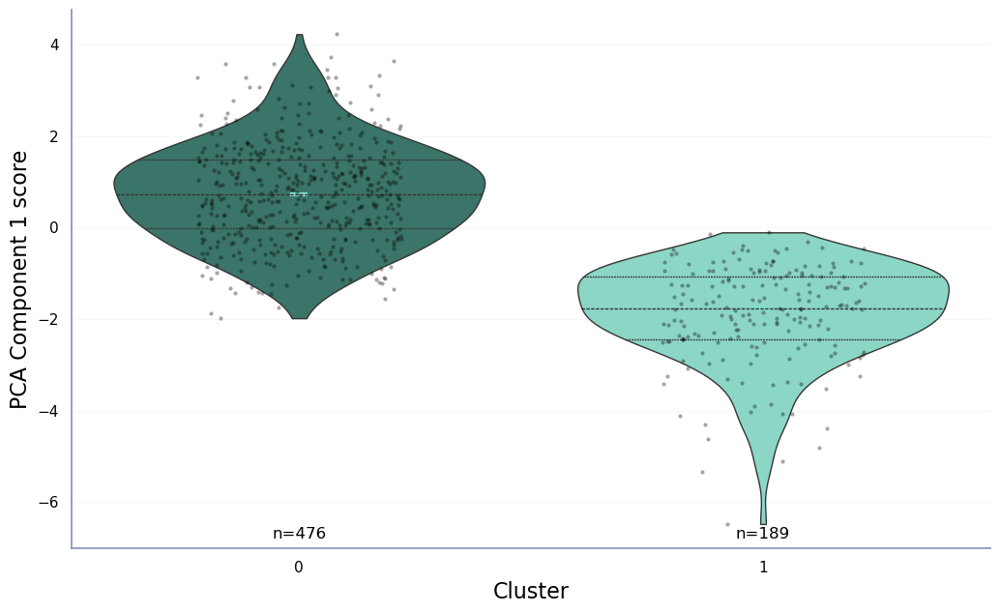

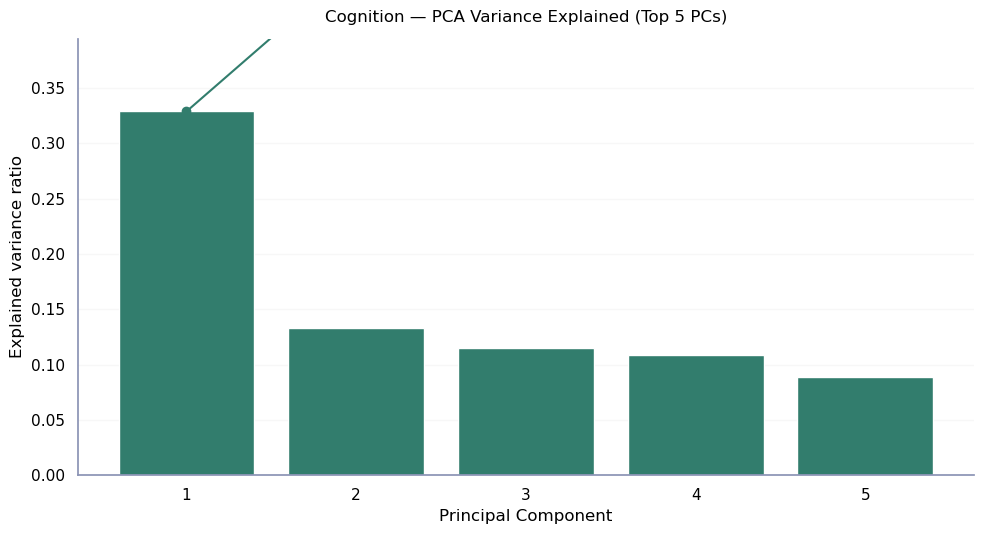

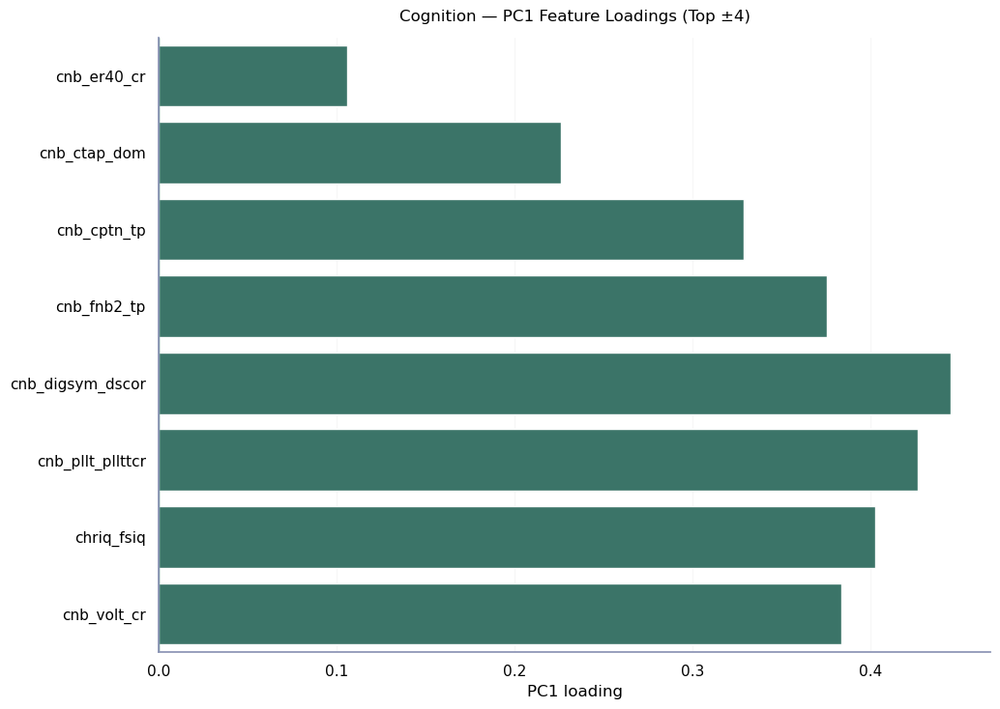

In [199]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# =========================
# PCA aggregated plots per modality + variance explained (first 5 PCs)
# - Respects your existing global theme (NO sns.set_theme here)
# - PC1 by cluster: violin (quartiles) + jitter + median marker + n labels
# - Variance plot: explained variance ratio for PC1..PC5
# - Optional: PC1 loadings (top +/- contributors)
# =========================

out_dir = os.path.join(plots_dir, "merged_feature_pca/")
os.makedirs(out_dir, exist_ok=True)

loadings_dir = os.path.join(out_dir, "pc1_loadings/")
os.makedirs(loadings_dir, exist_ok=True)

variance_dir = os.path.join(out_dir, "variance/")
os.makedirs(variance_dir, exist_ok=True)

mod_num = 0
for modality, df in final_metrics["data"].items():
    print(f"\n=== PCA Aggregated Plots — Modality: {modality} ===")

    # --- Extract X and cluster labels ---
    feature_df = df.drop(columns=["src_subject_id"])
    feature_names = feature_df.columns.to_list()

    X = feature_df.values
    clusters = np.asarray(final_metrics["individual_labels"][mod_num])

    # Stable cluster order (customize if you want a specific ordering)
    cluster_order = np.sort(pd.unique(clusters))

    # --- Standardize ---
    Xz = StandardScaler().fit_transform(X)

    # --- PCA for variance (first 5 components) ---
    n_pcs = min(5, Xz.shape[1])  # cannot exceed number of features
    pca_var = PCA(n_components=n_pcs, random_state=0)
    pca_var.fit(Xz)

    evr = pca_var.explained_variance_ratio_
    cum_evr = np.cumsum(evr)

    # --- Also compute PC scores (at least PC1) ---
    pc_scores = pca_var.transform(Xz)  # shape: (n_samples, n_pcs)
    pc1 = pc_scores[:, 0]
    evr1 = float(evr[0])
    print(f"PC1 EVR: {evr1:.2%}")

    plot_df = pd.DataFrame({"cluster": clusters, "PC1": pc1})

    # -------------------------
    # 1) PC1 by cluster (publication-ready, respects global theme)
    # -------------------------
    fig, ax = plt.subplots(figsize=(10.5, 6.5))


    sns.violinplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        palette=sns.color_palette(n_colors=len(cluster_order)),
        inner="quartile",
        cut=0,
        bw_adjust=1.0,
        linewidth=1,
        ax=ax
    )

    sns.stripplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        color="black",
        size=3,
        jitter=0.22,
        alpha=0.35,
        ax=ax
    )

    # Median marker per cluster
    medians = plot_df.groupby("cluster")["PC1"].median()
    x_positions = np.arange(len(cluster_order))
    ax.scatter(
        x=x_positions,
        y=[medians.loc[c] for c in cluster_order],
        s=180,
        marker="_",
        linewidths=3
    )

    # Annotate n per cluster near the bottom
    counts = plot_df["cluster"].value_counts()
    ymin, ymax = ax.get_ylim()
    y_annot = ymin + 0.04 * (ymax - ymin)
    for i, c in enumerate(cluster_order):
        ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="top", fontsize=12)

    ax.set_xlabel("Cluster", fontsize=16)
    ax.set_ylabel("PCA Component 1 score", fontsize=16)

    # Light grid for readability; remove if your global theme already handles grids
    ax.grid(axis="y", alpha=0.15)
    sns.despine(ax=ax)

    fig.tight_layout()
    fig.savefig(os.path.join(out_dir, f"{modality}_PC1_violin_pubready.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 2) Variance explained (PC1..PC5): bar + cumulative line
    # -------------------------
    figv, axv = plt.subplots(figsize=(10, 5.5))

    pcs_idx = np.arange(1, n_pcs + 1)
    axv.bar(pcs_idx, evr)  # uses your global matplotlib color cycle
    axv.plot(pcs_idx, cum_evr, marker="o")

    axv.set_xticks(pcs_idx)
    axv.set_xlabel("Principal Component")
    axv.set_ylabel("Explained variance ratio")
    axv.set_title(f"{modality} — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

    axv.set_ylim(0, max(0.25, evr.max() * 1.2))  # keeps plot readable if EVR is small/large
    axv.grid(axis="y", alpha=0.15)
    sns.despine(ax=axv)

    figv.tight_layout()
    figv.savefig(os.path.join(variance_dir, f"{modality}_variance_top{n_pcs}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 3) Optional: PC1 feature loadings (top +/- contributors)
    # -------------------------
    loadings = pca_var.components_[0]  # PC1 loadings
    load_df = pd.DataFrame({"feature": feature_names, "loading": loadings})

    top_n = min(15, len(feature_names) // 2) if len(feature_names) >= 2 else 1
    top_pos = load_df.sort_values("loading", ascending=False).head(top_n)
    top_neg = load_df.sort_values("loading", ascending=True).head(top_n)
    load_plot_df = pd.concat([top_neg, top_pos], axis=0)

    fig2, ax2 = plt.subplots(figsize=(10.5, 7.5))
    sns.barplot(data=load_plot_df, x="loading", y="feature", ax=ax2)
    ax2.axvline(0, linewidth=1)

    ax2.set_title(f"{modality} — PC1 Feature Loadings (Top ±{top_n})", pad=12)
    ax2.set_xlabel("PC1 loading")
    ax2.set_ylabel("")

    ax2.grid(axis="x", alpha=0.15)
    sns.despine(ax=ax2)

    fig2.tight_layout()
    fig2.savefig(os.path.join(loadings_dir, f"{modality}_PC1_loadings_top_pm{top_n}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    mod_num += 1

### Differences in original features based on final labels


=== Modality: Internalising ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: UserWarning: The palette list has more values (10) than needed (7), which may not be intended.
  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))


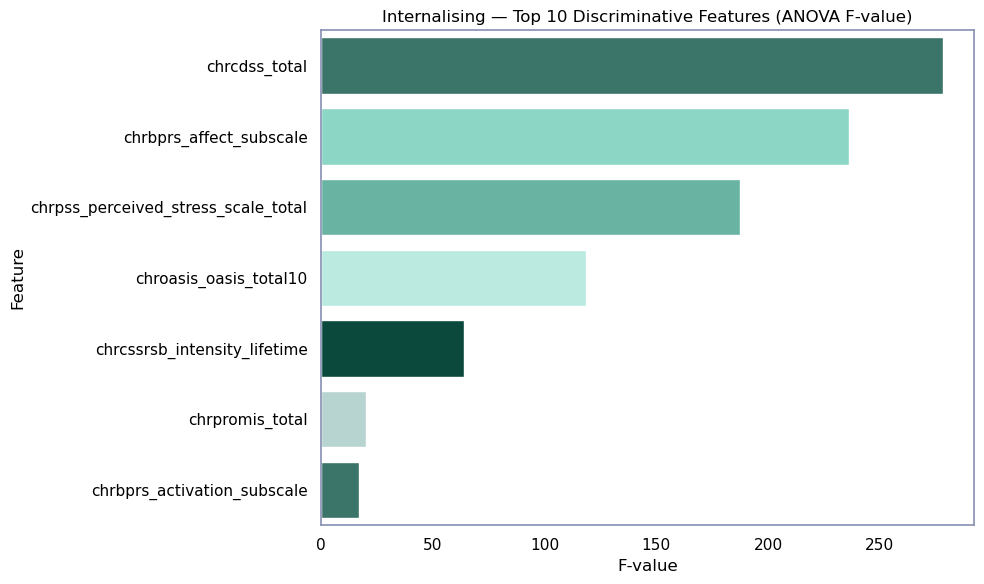

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated a

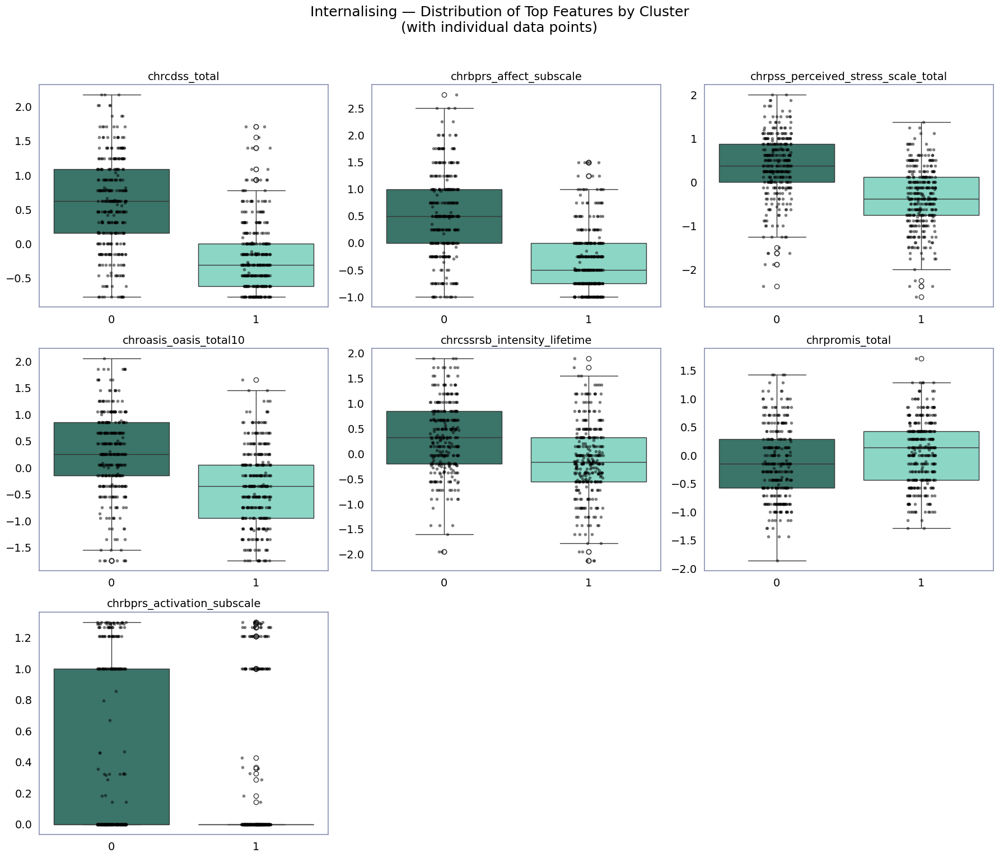


=== Modality: Functioning ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))


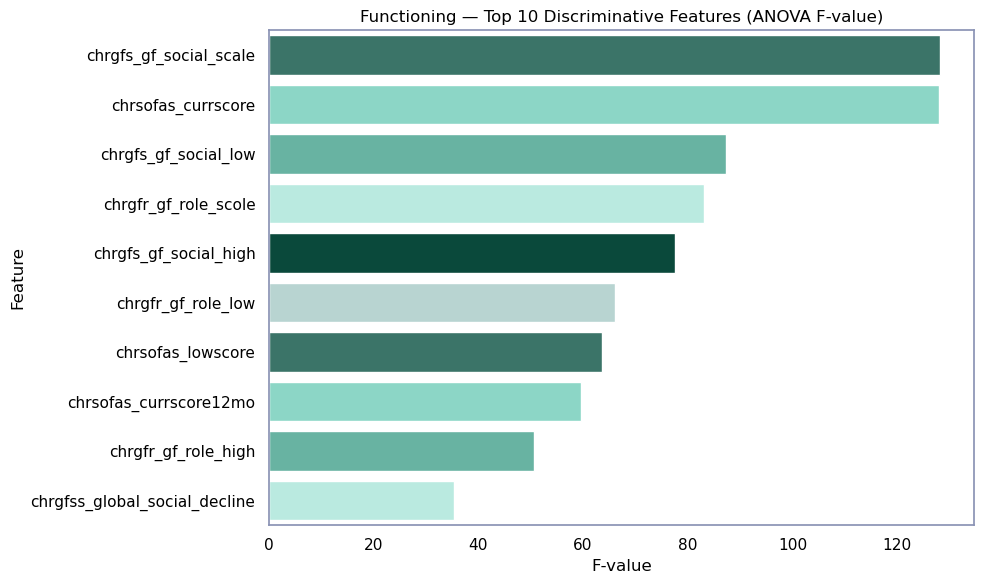

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated a

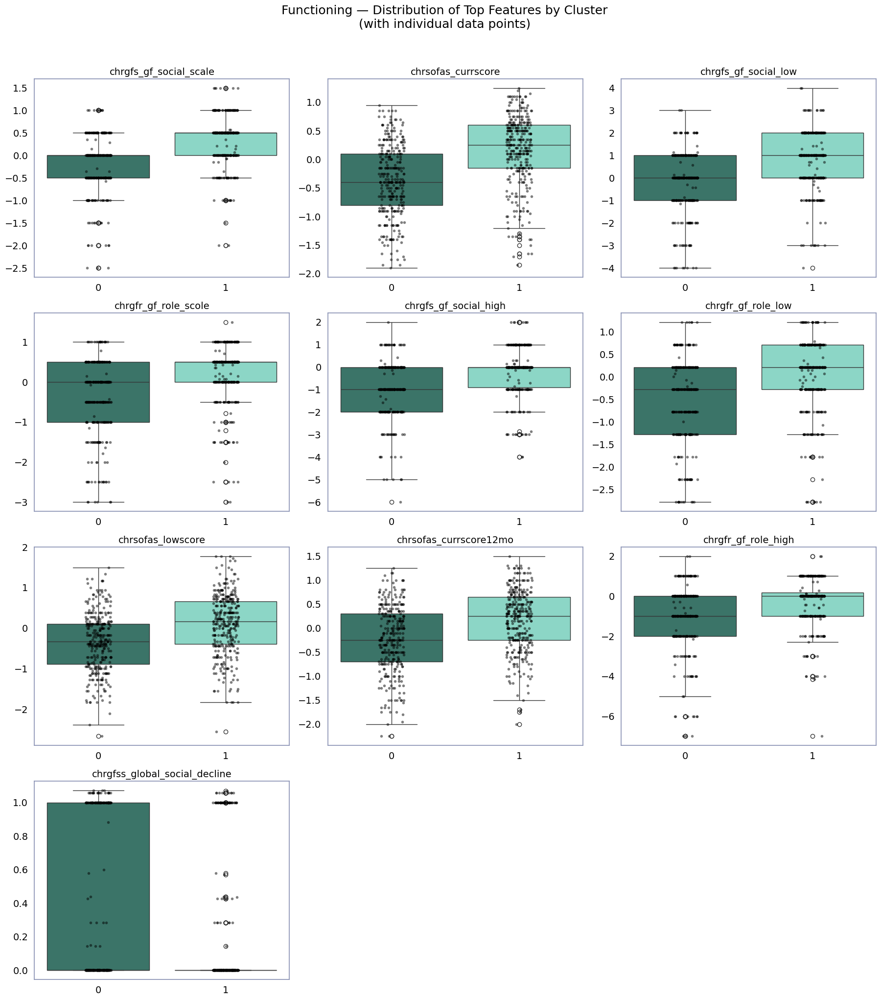


=== Modality: Detachment ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: UserWarning: The palette list has more values (10) than needed (7), which may not be intended.
  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))


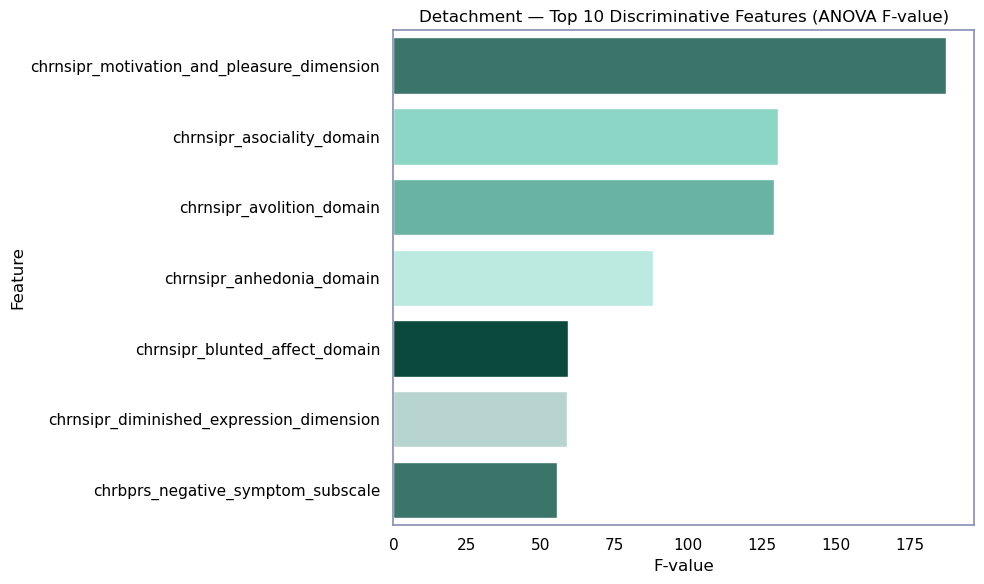

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated a

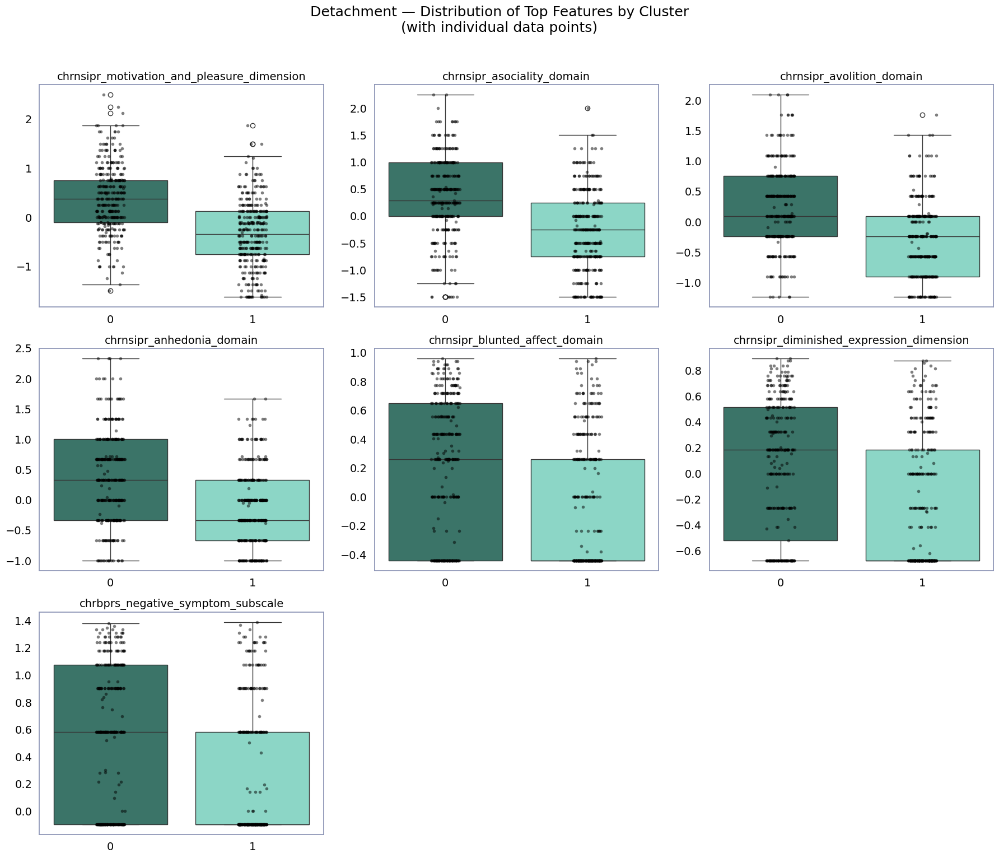


=== Modality: Psychoticism ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))


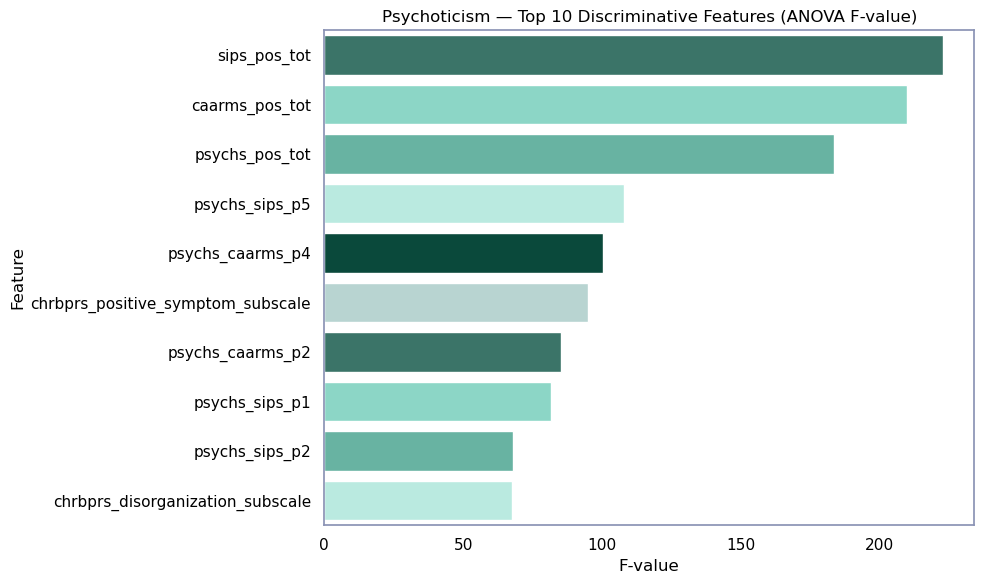

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated a

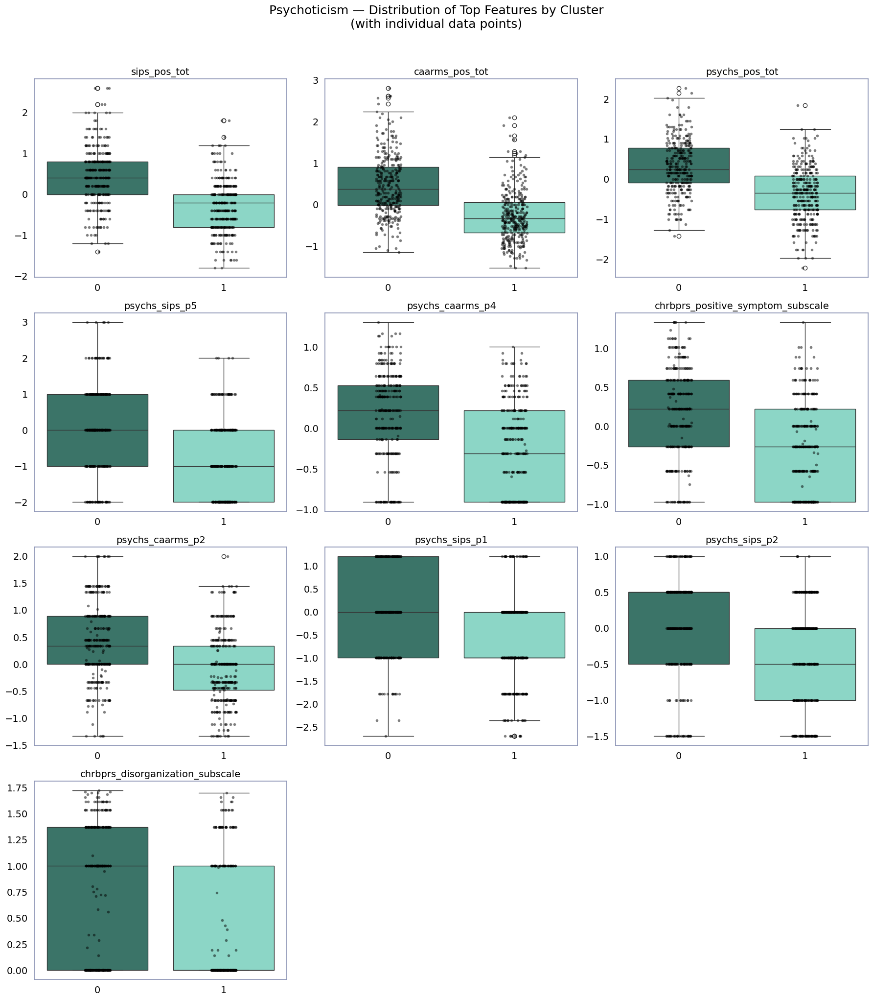


=== Modality: Cognition ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:27: UserWarning: The palette list has more values (10) than needed (8), which may not be intended.
  sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))


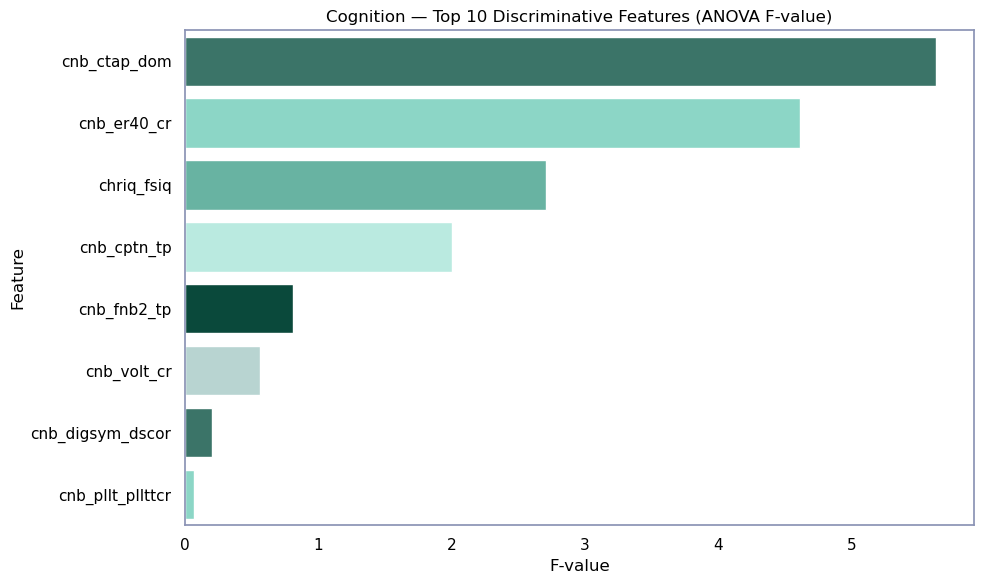

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/4201942653.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated a

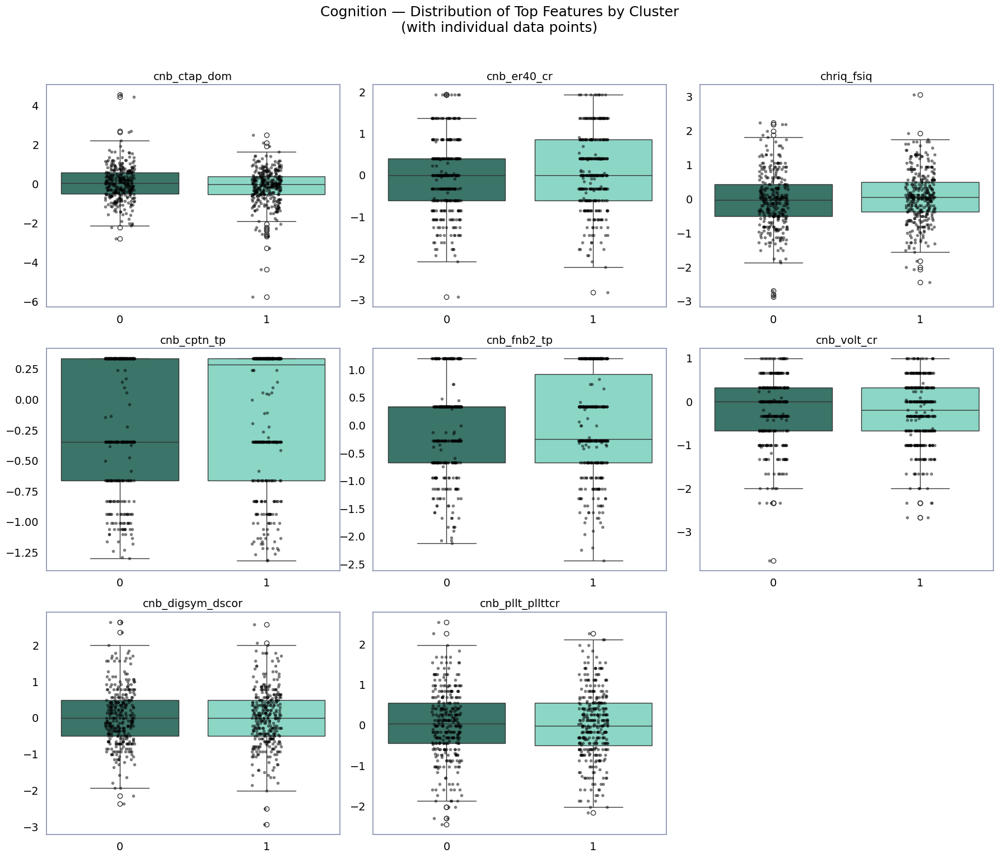

In [38]:
from sklearn.feature_selection import f_classif
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create directory for differences in original features plots
os.makedirs(os.path.join(plots_dir, "merged_feature_differences/"), exist_ok=True)

for modality, df in final_metrics['data'].items():
    print(f"\n=== Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = final_metrics['final_labels']
    feature_names = df.drop(columns=['src_subject_id']).columns

    # --- Feature Ranking (ANOVA F-test) ---
    f_vals, _ = f_classif(X, clusters)
    f_df = (
        pd.DataFrame({'feature': feature_names, 'f_value': f_vals})
        .sort_values('f_value', ascending=False)
    )

    # --- Barplot of Top Features ---
    top_k = 10
    plt.figure(figsize=(10, 6))
    sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
    plt.title(f"{modality} — Top {top_k} Discriminative Features (ANOVA F-value)")
    plt.xlabel("F-value")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()


    # --- Boxplots + Scatter Points of Top Features ---
    top_features = f_df['feature'].head(top_k).tolist()

    max_cols = 3
    n_feats = len(top_features)
    n_rows = int(np.ceil(n_feats / max_cols))

    fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
    axes = axes.flatten()

    cluster_order = np.unique(clusters)  # or a custom order you want
    pal = sns.color_palette(n_colors=len(cluster_order)) 

    for i, feat in enumerate(top_features):
        ax = axes[i]
        sns.boxplot(
            x=clusters, y=df[feat], palette=pal, ax=ax
        )
        sns.stripplot(
            x=clusters, y=df[feat],
            color='black', size=4, jitter=True, alpha=0.5, ax=ax
        )

        # Larger text sizes
        ax.set_title(feat, fontsize=14)
        ax.set_xlabel("", fontsize=22)
        ax.set_ylabel("", fontsize=22)
        ax.tick_params(axis='both', labelsize=14)

    # Hide unused axes
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.suptitle(
        f"{modality} — Distribution of Top Features by Cluster\n(with individual data points)",
        y=1.02, fontsize=18
    )

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_feature_differences/", f"{modality}_top_features.png"))
    plt.show()

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1474723528.py:79: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




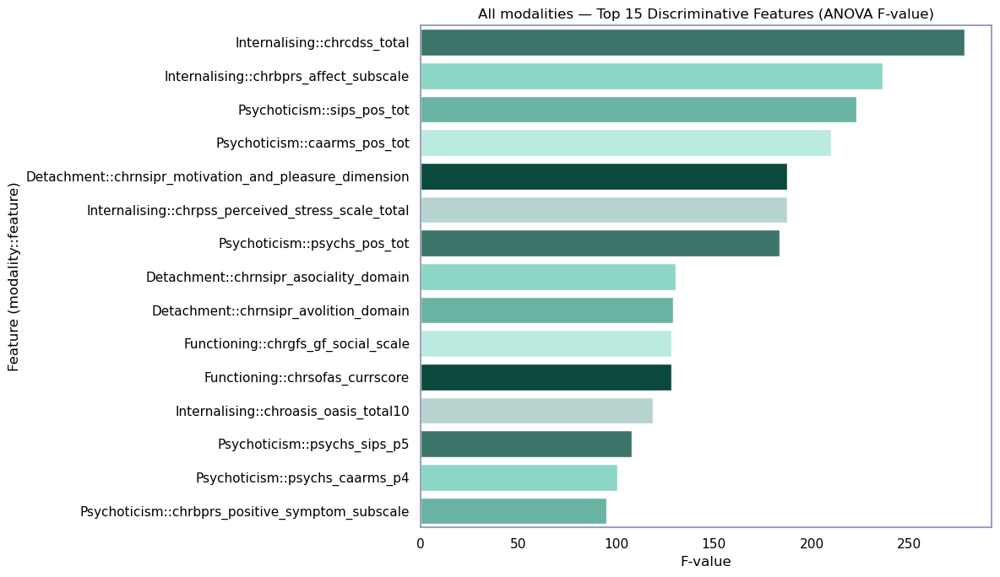

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1474723528.py:108: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1474723528.py:108: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1474723528.py:108: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1474723528.py:108: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Ass

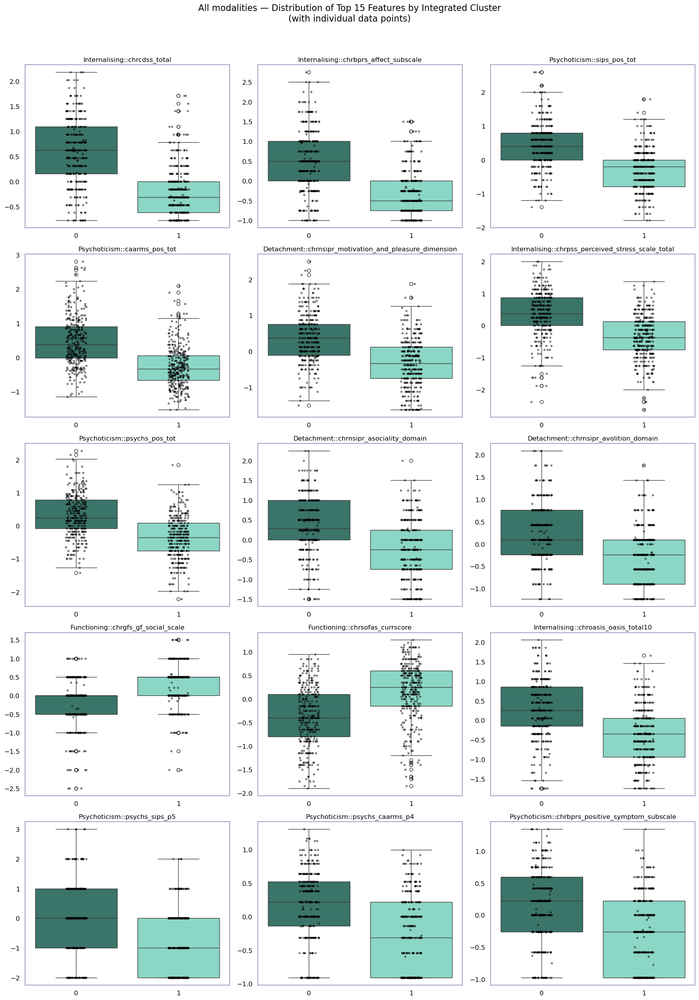

Saved:
 - /Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Results/Study_1/Temporary_results/Results_noDim_4opt_5fold_FIXED_highmut_onlyAgree_ARI_fixmin50clust_SVMall_matrixMATLAB_ensembled_onlyCHR/plots/merged_feature_differences/ALL_modalities_top_features_bar.png
 - /Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Results/Study_1/Temporary_results/Results_noDim_4opt_5fold_FIXED_highmut_onlyAgree_ARI_fixmin50clust_SVMall_matrixMATLAB_ensembled_onlyCHR/plots/merged_feature_differences/ALL_modalities_top_features_box.png


In [182]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import f_classif

# -----------------------------
# Settings
# -----------------------------
top_k = 15                    # change as you like
max_cols = 3                  # grid columns for feature distributions
out_dir = os.path.join(plots_dir, "merged_feature_differences")
os.makedirs(out_dir, exist_ok=True)

# -----------------------------
# 1) Build ONE merged feature table across ALL modalities
#    aligned by src_subject_id, with modality-prefixed feature names
# -----------------------------
# Use first modality as "reference" ordering (assumes labels align to this order)
modalities = list(final_metrics["data"].keys())
ref_mod = modalities[0]
ref_df = final_metrics["data"][ref_mod].copy()

# Keep reference subject ordering
ref_ids = ref_df["src_subject_id"].astype(str)
clusters = np.asarray(final_metrics["final_labels"])
if len(clusters) != len(ref_df):
    raise ValueError(
        f"final_labels length ({len(clusters)}) != number of subjects in reference modality "
        f"{ref_mod} ({len(ref_df)}). You likely need to align labels by src_subject_id."
    )

# Start merged dataframe with IDs
merged = pd.DataFrame({"src_subject_id": ref_ids.values})

# Add each modality's features, aligned by src_subject_id, modality-prefixed
for modality, df in final_metrics["data"].items():
    tmp = df.copy()
    tmp["src_subject_id"] = tmp["src_subject_id"].astype(str)

    # Drop duplicates and set index for alignment
    tmp = tmp.drop_duplicates("src_subject_id").set_index("src_subject_id")

    # Align to reference IDs (inner join behavior -> missing subjects become NaN)
    tmp = tmp.reindex(ref_ids.values)

    # Prefix feature names to avoid collisions across modalities
    feat_cols = tmp.columns
    tmp = tmp.rename(columns={c: f"{modality}::{c}" for c in feat_cols})

    merged = pd.concat([merged, tmp.reset_index(drop=True)], axis=1)

# Option A: drop any subjects with missing modality data (strict intersection)
merged_clean = merged.dropna(axis=0).reset_index(drop=True)

# Make sure labels match rows after dropping NaNs (keep only subjects that remain)
keep_mask = merged.notna().all(axis=1).values
clusters_clean = clusters[keep_mask]

# Feature matrix
X = merged_clean.drop(columns=["src_subject_id"]).values
feature_names = merged_clean.drop(columns=["src_subject_id"]).columns

# -----------------------------
# 2) Global feature ranking (ANOVA F-test) using integrated labels
# -----------------------------
f_vals, _ = f_classif(X, clusters_clean)
f_df = (
    pd.DataFrame({"feature": feature_names, "f_value": f_vals})
      .sort_values("f_value", ascending=False)
)

# -----------------------------
# 3) Plot: Top-K contributing features ACROSS ALL modalities
# -----------------------------
# --- Barplot of Top Features ---
plt.figure(figsize=(12, 7))
sns.barplot(
    x="f_value", y="feature",
    data=f_df.head(top_k),
    palette=sns.color_palette(n_colors=top_k)
)
plt.title(f"All modalities — Top {top_k} Discriminative Features (ANOVA F-value)")
plt.xlabel("F-value")
plt.ylabel("Feature (modality::feature)")
plt.tight_layout()
plt.savefig(os.path.join(out_dir, "ALL_modalities_top_features_bar.png"), dpi=200)
plt.show()

# --- Boxplots + Scatter Points of Top Features ---
top_features = f_df["feature"].head(top_k).tolist()

n_feats = len(top_features)
n_rows = int(np.ceil(n_feats / max_cols))
fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
axes = np.array(axes).reshape(-1)

cluster_order = np.unique(clusters_clean)
pal = sns.color_palette(n_colors=len(cluster_order))

# Build a plotting df where each feature is a column
plot_df = merged_clean.copy()
plot_df["cluster"] = clusters_clean

for i, feat in enumerate(top_features):
    ax = axes[i]
    sns.boxplot(x="cluster", y=feat, data=plot_df, palette=pal, ax=ax)
    sns.stripplot(
        x="cluster", y=feat, data=plot_df,
        color="black", size=4, jitter=True, alpha=0.5, ax=ax
    )
    ax.set_title(feat, fontsize=12)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.tick_params(axis="both", labelsize=12)

# Hide unused axes
for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.suptitle(
    f"All modalities — Distribution of Top {top_k} Features by Integrated Cluster\n(with individual data points)",
    y=1.02, fontsize=16
)
plt.tight_layout()
fig.savefig(os.path.join(out_dir, "ALL_modalities_top_features_box.png"), dpi=200, bbox_inches="tight")
plt.show()

print("Saved:")
print(" -", os.path.join(out_dir, "ALL_modalities_top_features_bar.png"))
print(" -", os.path.join(out_dir, "ALL_modalities_top_features_box.png"))


=== PCA Aggregated Plots — Modality: Internalising ===
PC1 EVR: 41.42%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/352838312.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




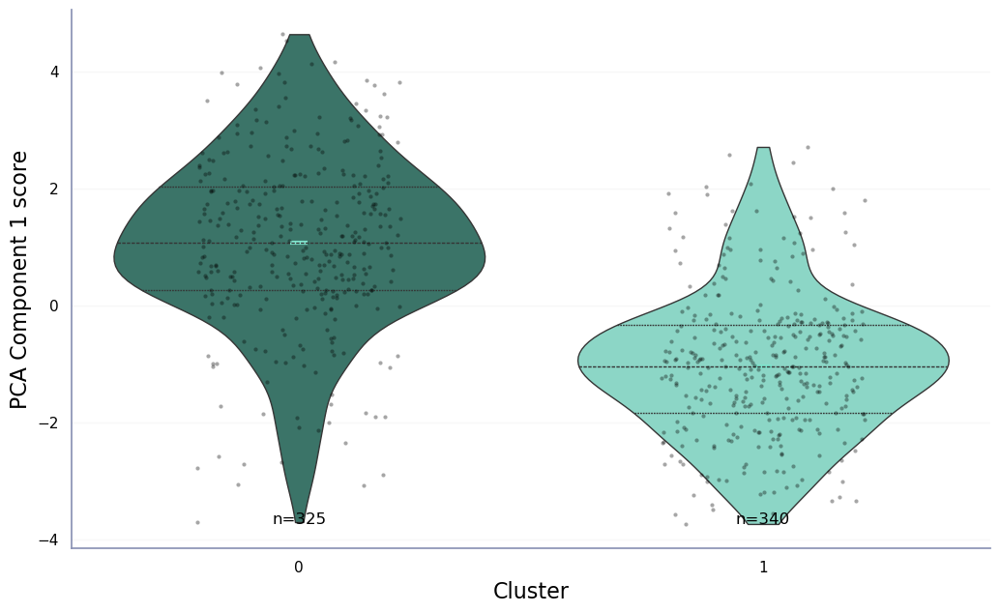

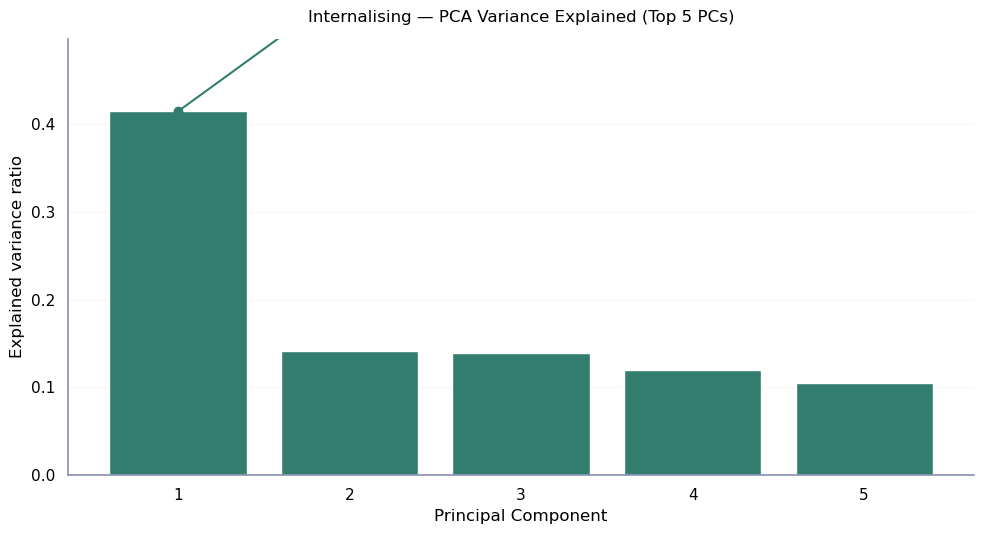

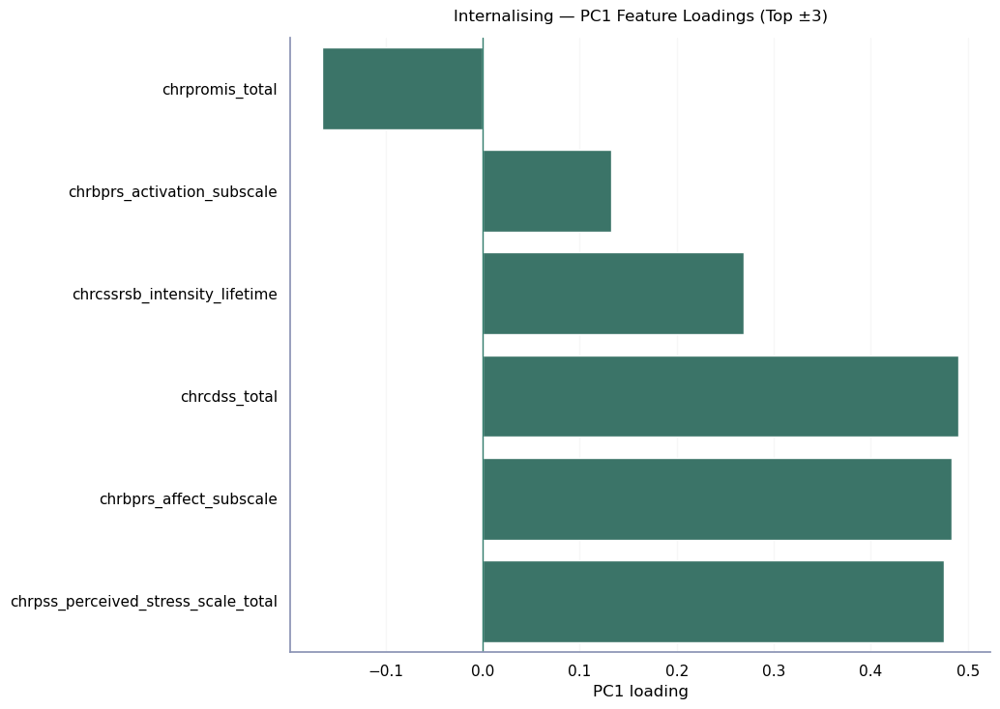


=== PCA Aggregated Plots — Modality: Functioning ===
PC1 EVR: 46.28%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/352838312.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




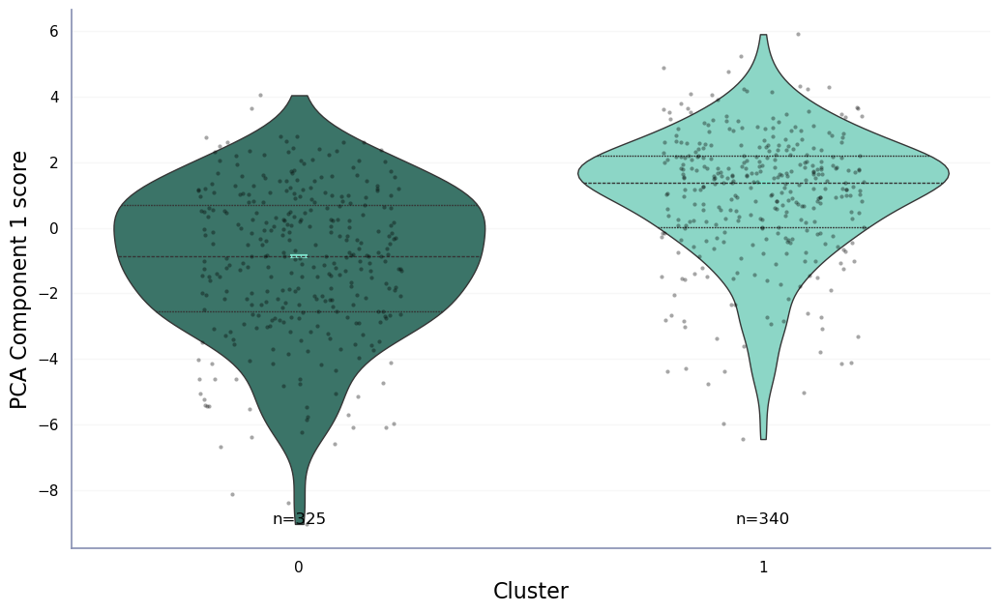

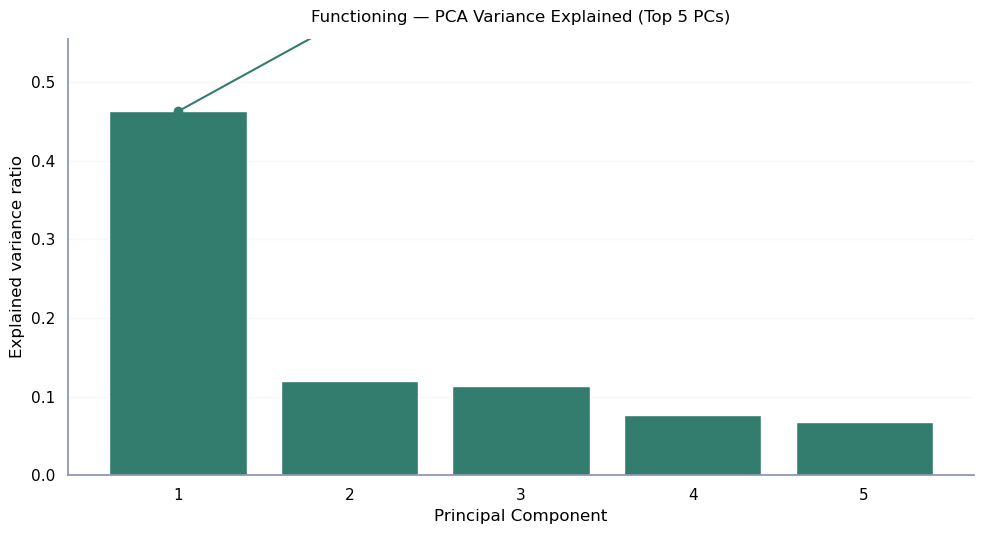

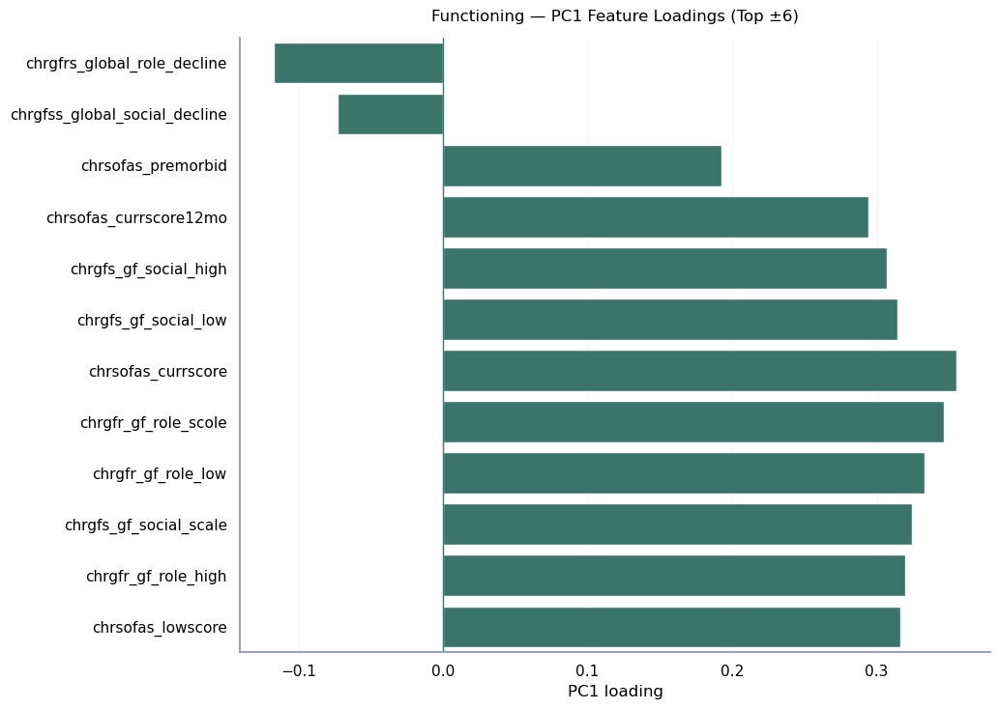


=== PCA Aggregated Plots — Modality: Detachment ===
PC1 EVR: 54.72%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/352838312.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




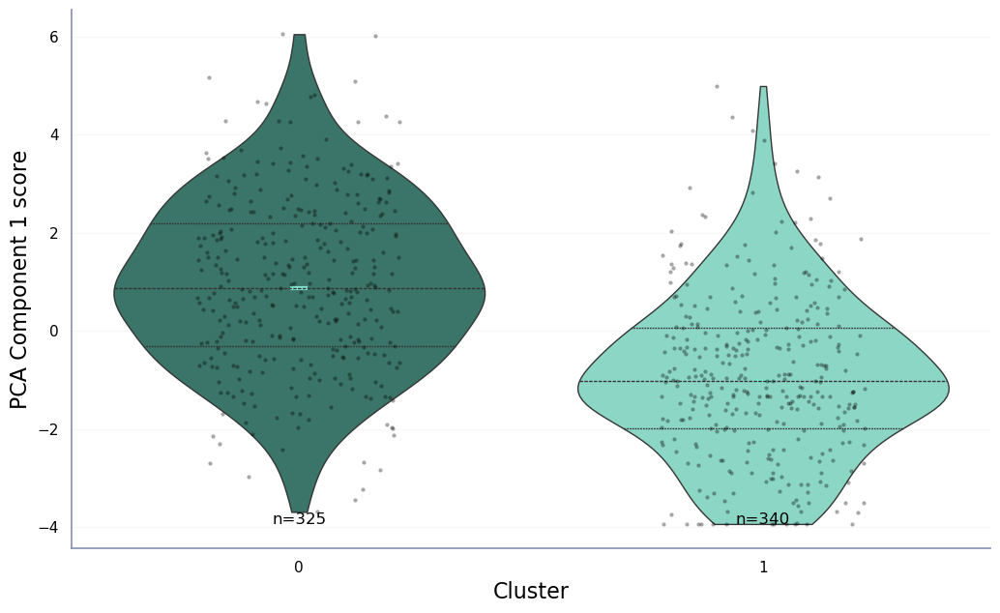

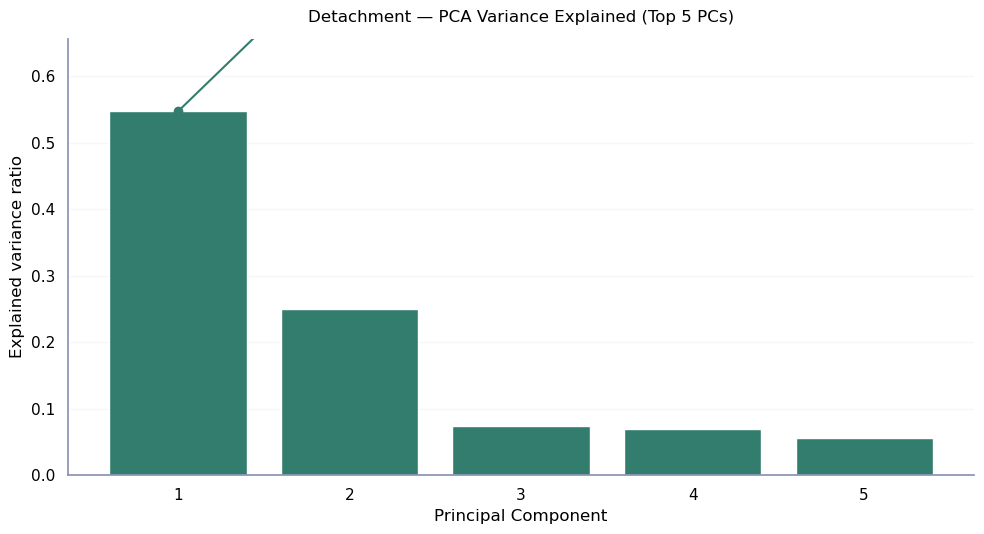

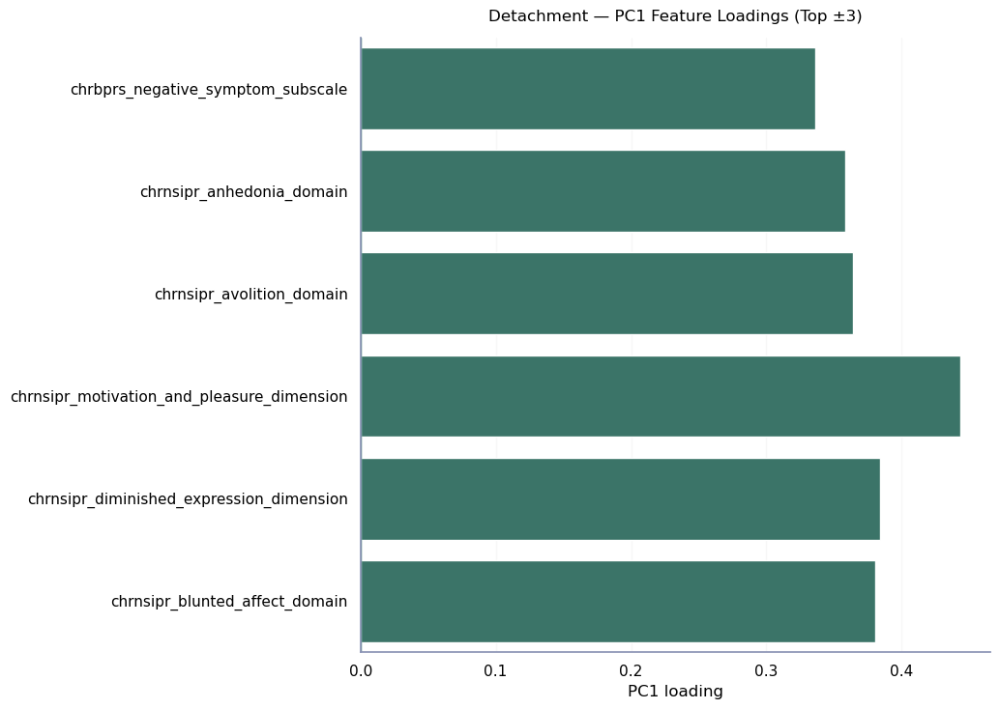


=== PCA Aggregated Plots — Modality: Psychoticism ===
PC1 EVR: 41.77%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/352838312.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




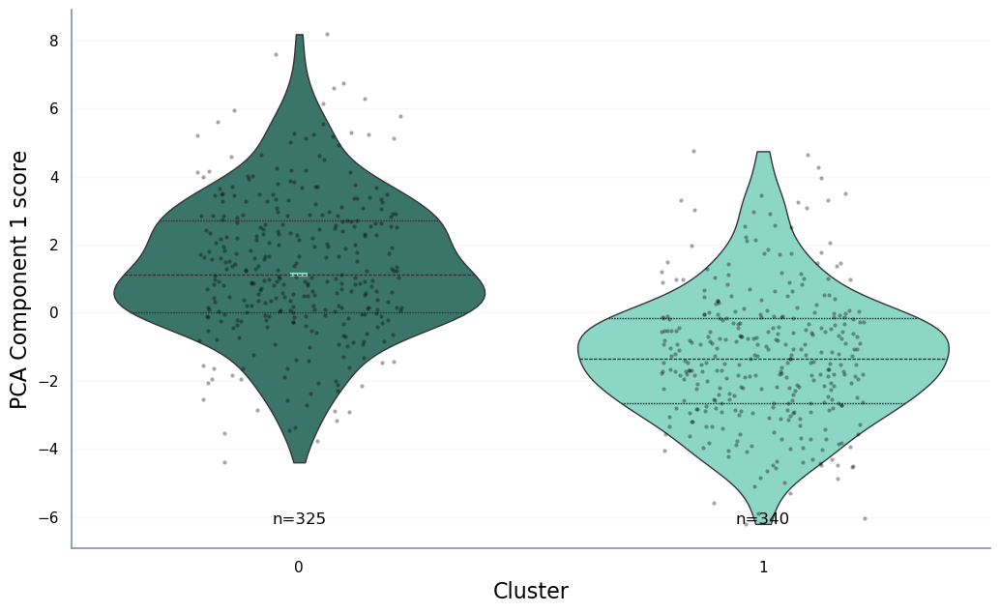

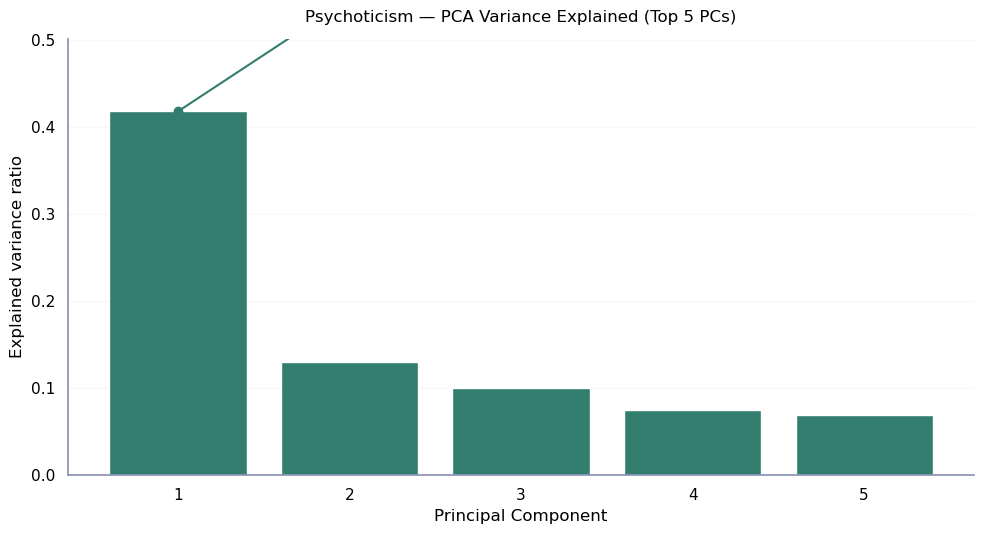

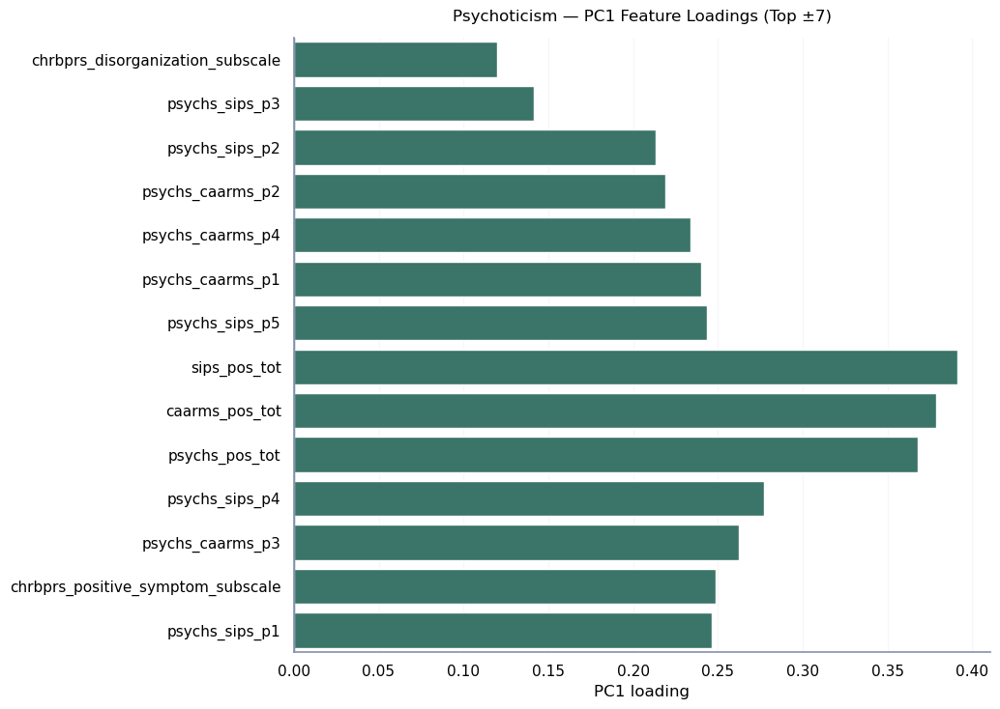


=== PCA Aggregated Plots — Modality: Cognition ===
PC1 EVR: 32.89%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/352838312.py:66: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




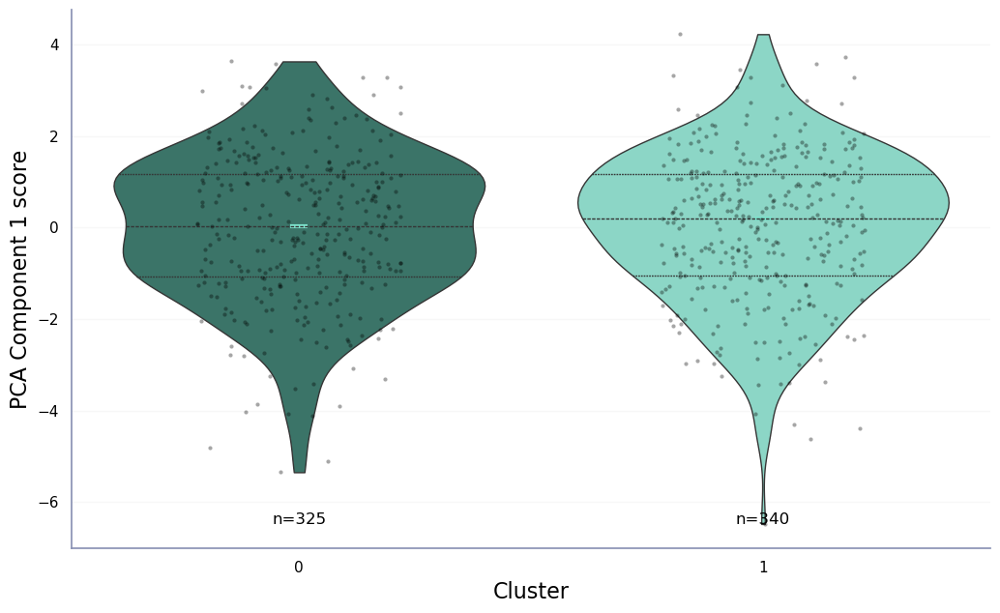

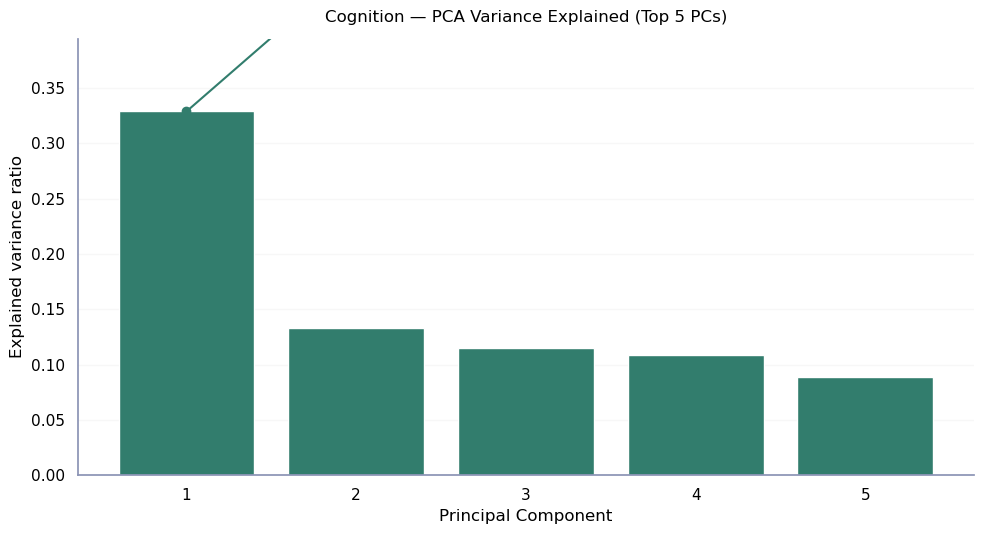

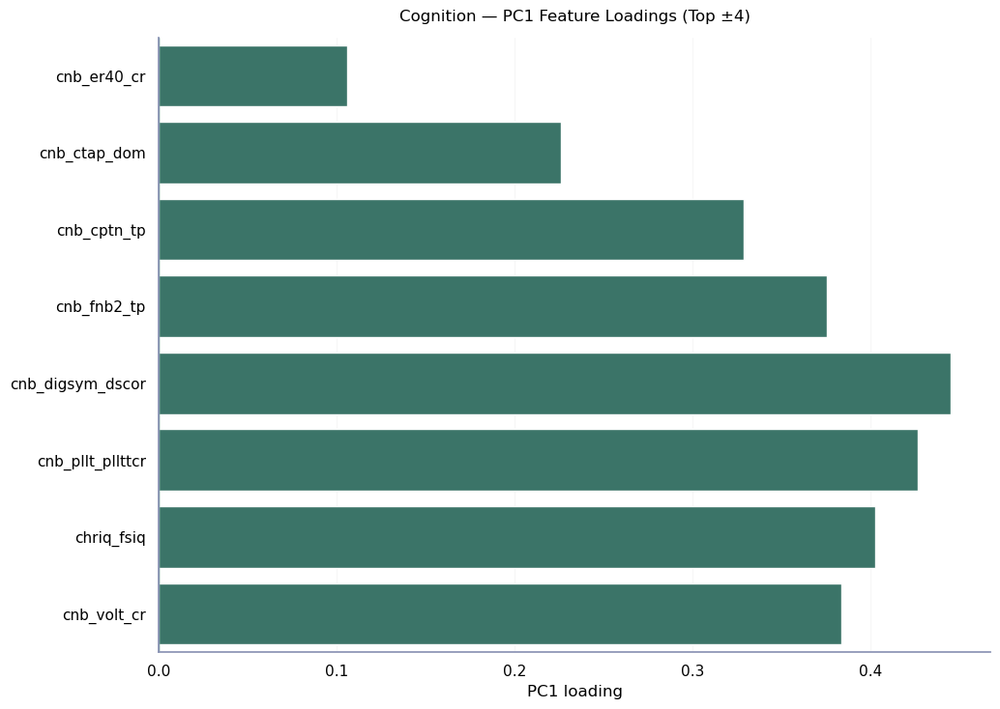

In [200]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# =========================
# PCA aggregated plots per modality + variance explained (first 5 PCs)
# - Respects your existing global theme (NO sns.set_theme here)
# - PC1 by cluster: violin (quartiles) + jitter + median marker + n labels
# - Variance plot: explained variance ratio for PC1..PC5
# - Optional: PC1 loadings (top +/- contributors)
# =========================

out_dir = os.path.join(plots_dir, "merged_feature_pca/")
os.makedirs(out_dir, exist_ok=True)

loadings_dir = os.path.join(out_dir, "pc1_loadings/")
os.makedirs(loadings_dir, exist_ok=True)

variance_dir = os.path.join(out_dir, "variance/")
os.makedirs(variance_dir, exist_ok=True)

mod_num = 0
for modality, df in final_metrics["data"].items():
    print(f"\n=== PCA Aggregated Plots — Modality: {modality} ===")

    # --- Extract X and cluster labels ---
    feature_df = df.drop(columns=["src_subject_id"])
    feature_names = feature_df.columns.to_list()

    X = feature_df.values
    clusters = np.asarray(final_metrics["final_labels"])

    # Stable cluster order (customize if you want a specific ordering)
    cluster_order = np.sort(pd.unique(clusters))

    # --- Standardize ---
    Xz = StandardScaler().fit_transform(X)

    # --- PCA for variance (first 5 components) ---
    n_pcs = min(5, Xz.shape[1])  # cannot exceed number of features
    pca_var = PCA(n_components=n_pcs, random_state=0)
    pca_var.fit(Xz)

    evr = pca_var.explained_variance_ratio_
    cum_evr = np.cumsum(evr)

    # --- Also compute PC scores (at least PC1) ---
    pc_scores = pca_var.transform(Xz)  # shape: (n_samples, n_pcs)
    pc1 = pc_scores[:, 0]
    evr1 = float(evr[0])
    print(f"PC1 EVR: {evr1:.2%}")

    plot_df = pd.DataFrame({"cluster": clusters, "PC1": pc1})

    # -------------------------
    # 1) PC1 by cluster (publication-ready, respects global theme)
    # -------------------------
    fig, ax = plt.subplots(figsize=(10.5, 6.5))


    sns.violinplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        palette=sns.color_palette(n_colors=len(cluster_order)),
        inner="quartile",
        cut=0,
        bw_adjust=1.0,
        linewidth=1,
        ax=ax
    )

    sns.stripplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        color="black",
        size=3,
        jitter=0.22,
        alpha=0.35,
        ax=ax
    )

    # Median marker per cluster
    medians = plot_df.groupby("cluster")["PC1"].median()
    x_positions = np.arange(len(cluster_order))
    ax.scatter(
        x=x_positions,
        y=[medians.loc[c] for c in cluster_order],
        s=180,
        marker="_",
        linewidths=3
    )

    # Annotate n per cluster near the bottom
    counts = plot_df["cluster"].value_counts()
    ymin, ymax = ax.get_ylim()
    y_annot = ymin + 0.04 * (ymax - ymin)
    for i, c in enumerate(cluster_order):
        ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="bottom", fontsize=12)

    ax.set_xlabel("Cluster", fontsize=16)
    ax.set_ylabel("PCA Component 1 score", fontsize=16)

    # Light grid for readability; remove if your global theme already handles grids
    ax.grid(axis="y", alpha=0.15)
    sns.despine(ax=ax)

    fig.tight_layout()
    fig.savefig(os.path.join(out_dir, f"{modality}_PC1_violin_pubready.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 2) Variance explained (PC1..PC5): bar + cumulative line
    # -------------------------
    figv, axv = plt.subplots(figsize=(10, 5.5))

    pcs_idx = np.arange(1, n_pcs + 1)
    axv.bar(pcs_idx, evr)  # uses your global matplotlib color cycle
    axv.plot(pcs_idx, cum_evr, marker="o")

    axv.set_xticks(pcs_idx)
    axv.set_xlabel("Principal Component")
    axv.set_ylabel("Explained variance ratio")
    axv.set_title(f"{modality} — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

    axv.set_ylim(0, max(0.25, evr.max() * 1.2))  # keeps plot readable if EVR is small/large
    axv.grid(axis="y", alpha=0.15)
    sns.despine(ax=axv)

    figv.tight_layout()
    figv.savefig(os.path.join(variance_dir, f"{modality}_variance_top{n_pcs}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 3) Optional: PC1 feature loadings (top +/- contributors)
    # -------------------------
    loadings = pca_var.components_[0]  # PC1 loadings
    load_df = pd.DataFrame({"feature": feature_names, "loading": loadings})

    top_n = min(15, len(feature_names) // 2) if len(feature_names) >= 2 else 1
    top_pos = load_df.sort_values("loading", ascending=False).head(top_n)
    top_neg = load_df.sort_values("loading", ascending=True).head(top_n)
    load_plot_df = pd.concat([top_neg, top_pos], axis=0)

    fig2, ax2 = plt.subplots(figsize=(10.5, 7.5))
    sns.barplot(data=load_plot_df, x="loading", y="feature", ax=ax2)
    ax2.axvline(0, linewidth=1)

    ax2.set_title(f"{modality} — PC1 Feature Loadings (Top ±{top_n})", pad=12)
    ax2.set_xlabel("PC1 loading")
    ax2.set_ylabel("")

    ax2.grid(axis="x", alpha=0.15)
    sns.despine(ax=ax2)

    fig2.tight_layout()
    fig2.savefig(os.path.join(loadings_dir, f"{modality}_PC1_loadings_top_pm{top_n}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    mod_num += 1

[GLOBAL PCA] Subjects after inner-join across modalities: 665
[GLOBAL PCA] Total merged features: 48
[GLOBAL PCA] PC1 EVR: 19.49%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2542030944.py:90: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




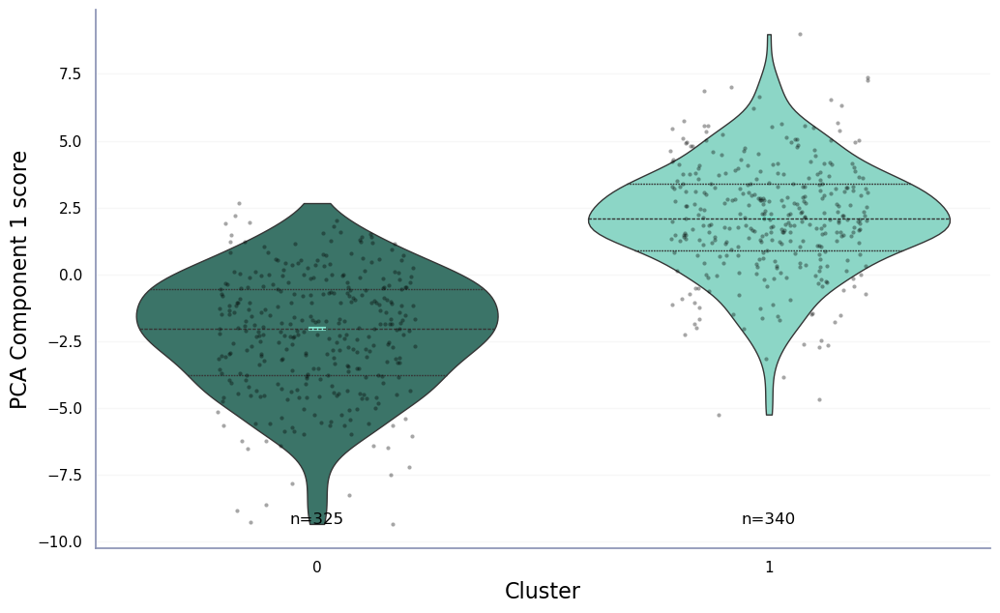

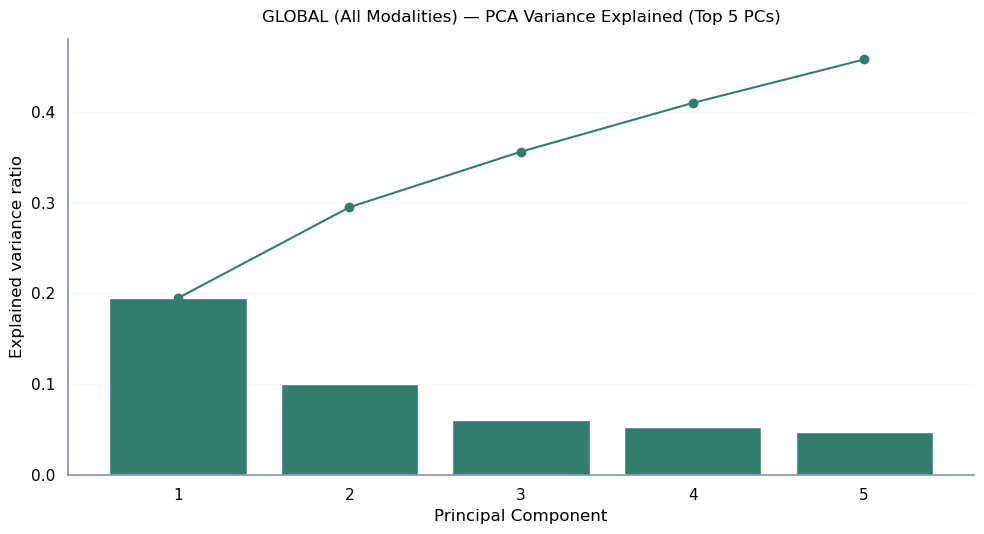

In [209]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# ==========================================================
# GLOBAL PCA (ALL modalities merged) -> PC1 by final clusters
# - Merges modalities on src_subject_id (inner-join by default)
# - Standardizes all features
# - PCA -> PC1
# - Publication-ready violin (quartiles) + jitter + median + n
# - Also saves a variance plot (top 5 PCs) for the merged space
# ==========================================================

global_out_dir = os.path.join(plots_dir, "global_pca_all_modalities/")
os.makedirs(global_out_dir, exist_ok=True)

# ---- 1) Merge all modalities into one wide dataframe ----
dfs = []
for modality, df in final_metrics["data"].items():
    tmp = df.copy()

    # Prefix feature names with modality to avoid collisions
    feat_cols = [c for c in tmp.columns if c != "src_subject_id"]
    tmp = tmp.rename(columns={c: f"{modality}__{c}" for c in feat_cols})

    dfs.append(tmp)

# Inner join across modalities by subject id (keeps subjects present in ALL modalities)
merged = dfs[0]
for d in dfs[1:]:
    merged = merged.merge(d, on="src_subject_id", how="inner")

print(f"[GLOBAL PCA] Subjects after inner-join across modalities: {merged.shape[0]}")
print(f"[GLOBAL PCA] Total merged features: {merged.shape[1] - 1}")

# ---- 2) Align final labels to the merged subject IDs ----
clusters = np.asarray(final_metrics["final_labels"])

# If your final_labels are already in the same row-order as each modality df,
# then this should match the *intersection* order only if you kept the same subjects.
# Safest is to align by subject ID if you have a mapping.
#
# Try to auto-detect a mapping dict if provided:
label_map = final_metrics.get("final_labels_by_subject_id", None)

if label_map is not None:
    # label_map should be {src_subject_id: label}
    merged_clusters = merged["src_subject_id"].map(label_map).to_numpy()
    if np.any(pd.isna(merged_clusters)):
        raise ValueError("Some merged subjects are missing labels in final_labels_by_subject_id.")
else:
    # Fallback: assume labels are already aligned to the rows of EACH modality df.
    # This is ONLY safe if all modality dfs share the same subject order and
    # inner-joining didn't change it. If you see mismatches, create label_map above.
    if len(clusters) != merged.shape[0]:
        raise ValueError(
            f"final_labels length ({len(clusters)}) != merged subjects ({merged.shape[0]}). "
            "Provide final_metrics['final_labels_by_subject_id'] to align labels safely."
        )
    merged_clusters = clusters

# ---- 3) PCA on all features ----
X = merged.drop(columns=["src_subject_id"]).values

# Standardize before PCA
Xz = StandardScaler().fit_transform(X)

# Fit PCA (enough components to report variance for first 5, but at least 2 if possible)
n_pcs = min(5, Xz.shape[1])
pca = PCA(n_components=n_pcs, random_state=0)
scores = pca.fit_transform(Xz)

pc1 = scores[:, 0]
evr = pca.explained_variance_ratio_
cum_evr = np.cumsum(evr)

print(f"[GLOBAL PCA] PC1 EVR: {evr[0]:.2%}")

# ---- 4) Plot PC1 by cluster (global / all modalities) ----
plot_df = pd.DataFrame({"cluster": merged_clusters, "PC1": pc1})
cluster_order = np.sort(pd.unique(plot_df["cluster"]))

fig, ax = plt.subplots(figsize=(10.5, 6.5))

sns.violinplot(
    data=plot_df,
    x="cluster",
    y="PC1",
    order=cluster_order,
    palette=sns.color_palette(n_colors=len(cluster_order)),
    inner="quartile",
    cut=0,
    bw_adjust=1.0,
    linewidth=1,
    ax=ax
)

sns.stripplot(
    data=plot_df,
    x="cluster",
    y="PC1",
    order=cluster_order,
    color="black",
    size=3,
    jitter=0.22,
    alpha=0.35,
    ax=ax
)

# Median marker per cluster
medians = plot_df.groupby("cluster")["PC1"].median()
x_positions = np.arange(len(cluster_order))
ax.scatter(
    x=x_positions,
    y=[medians.loc[c] for c in cluster_order],
    s=180,
    marker="_",
    linewidths=3
)

# Annotate n per cluster near bottom
counts = plot_df["cluster"].value_counts()
ymin, ymax = ax.get_ylim()
y_annot = ymin + 0.04 * (ymax - ymin)
for i, c in enumerate(cluster_order):
    ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="bottom", fontsize=12)

ax.set_xlabel("Cluster", fontsize=16)
ax.set_ylabel("PCA Component 1 score", fontsize=16)
ax.grid(axis="y", alpha=0.15)
sns.despine(ax=ax)

fig.tight_layout()
fig.savefig(os.path.join(global_out_dir, "GLOBAL_all_modalities_PC1_violin.png"), dpi=300, bbox_inches="tight")
plt.show()

# ---- 5) Variance explained plot (Top PCs) ----
figv, axv = plt.subplots(figsize=(10, 5.5))
pcs_idx = np.arange(1, n_pcs + 1)

axv.bar(pcs_idx, evr)
axv.plot(pcs_idx, cum_evr, marker="o")

axv.set_xticks(pcs_idx)
axv.set_xlabel("Principal Component")
axv.set_ylabel("Explained variance ratio")
axv.set_title(f"GLOBAL (All Modalities) — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

axv.grid(axis="y", alpha=0.15)
sns.despine(ax=axv)

figv.tight_layout()
figv.savefig(os.path.join(global_out_dir, f"GLOBAL_all_modalities_variance_top{n_pcs}.png"),
             dpi=300, bbox_inches="tight")
plt.show()

### Differences categorical with individual labels


=== Analyzing categorical differences for modality: Internalising ===
✅ Merged clusters for 665 subjects (out of 825 total).


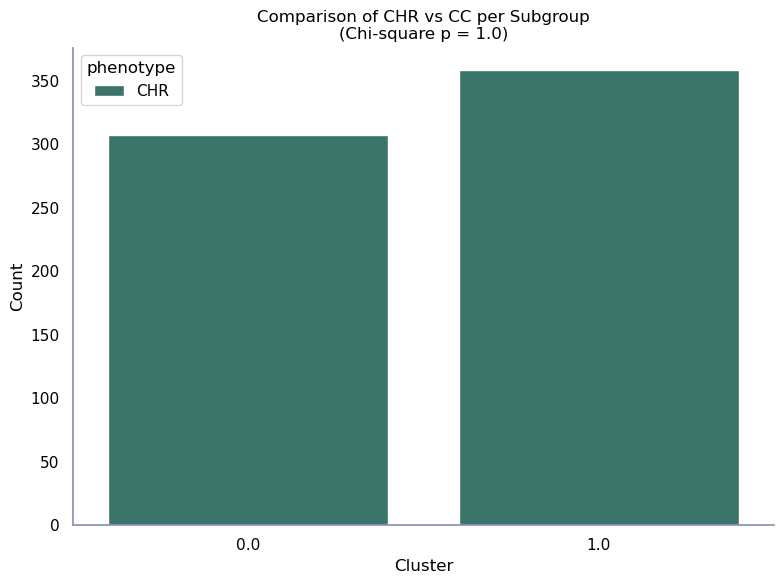

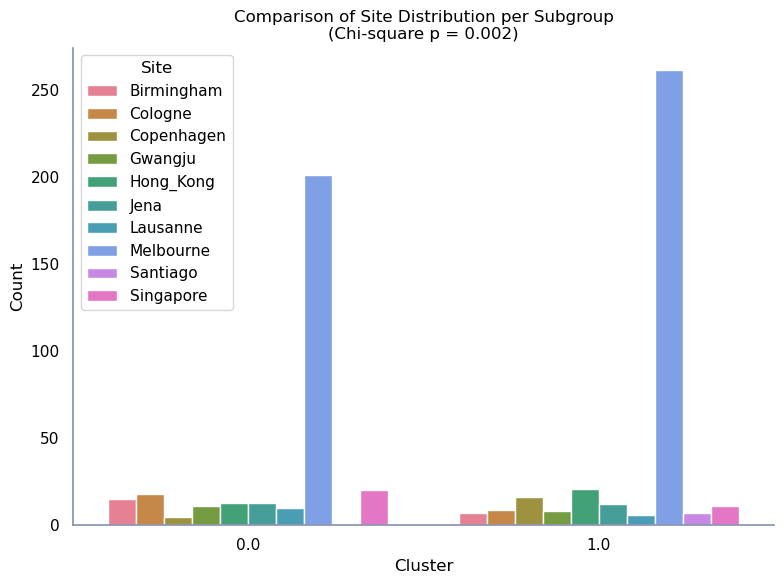

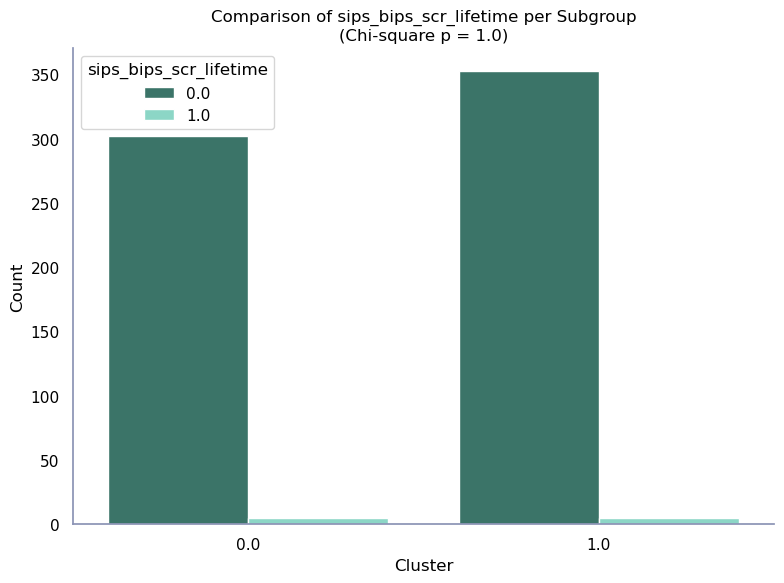

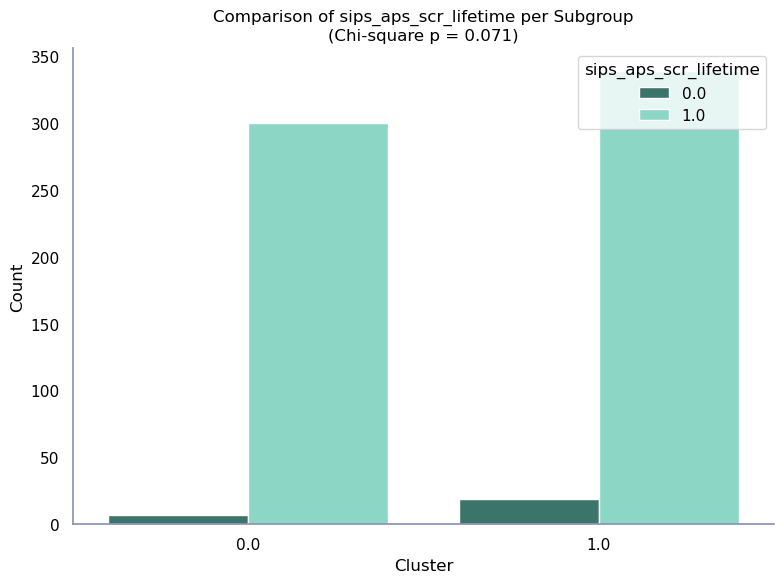

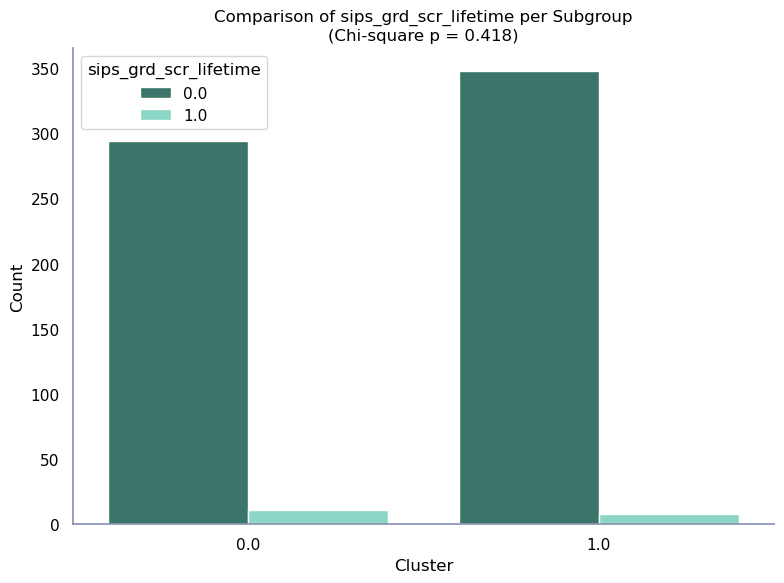


=== Analyzing categorical differences for modality: Functioning ===
✅ Merged clusters for 665 subjects (out of 825 total).


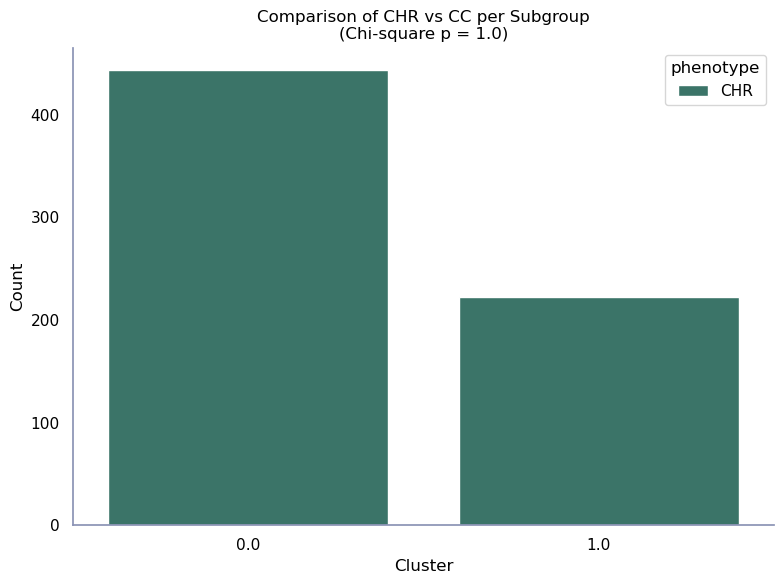

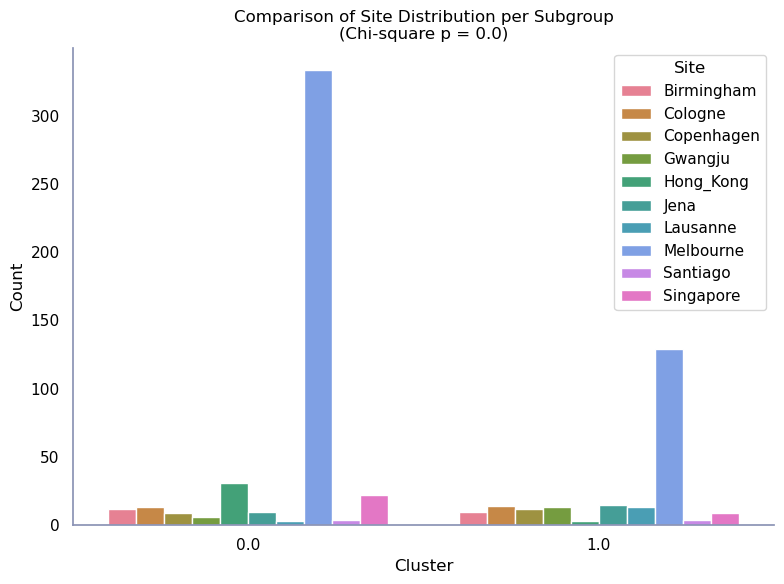

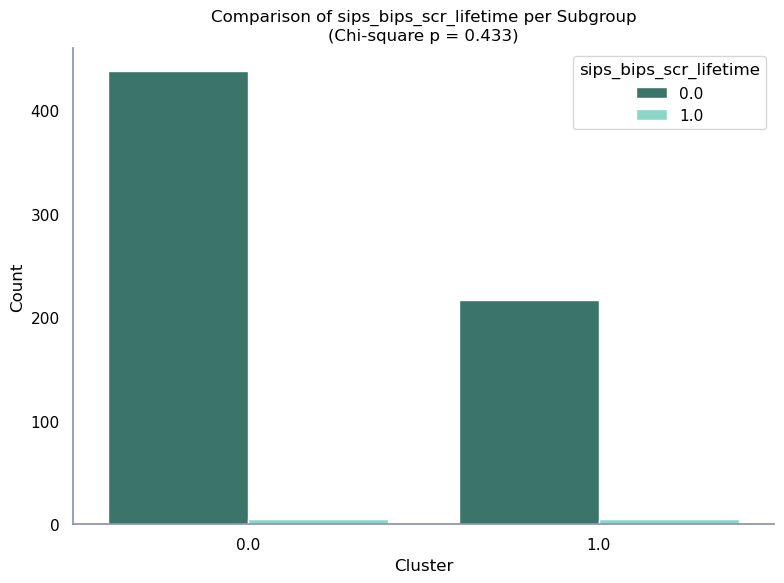

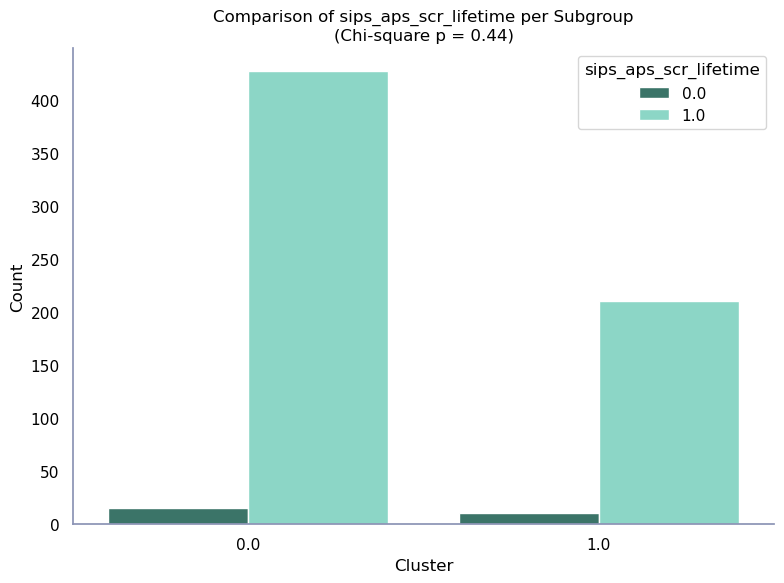

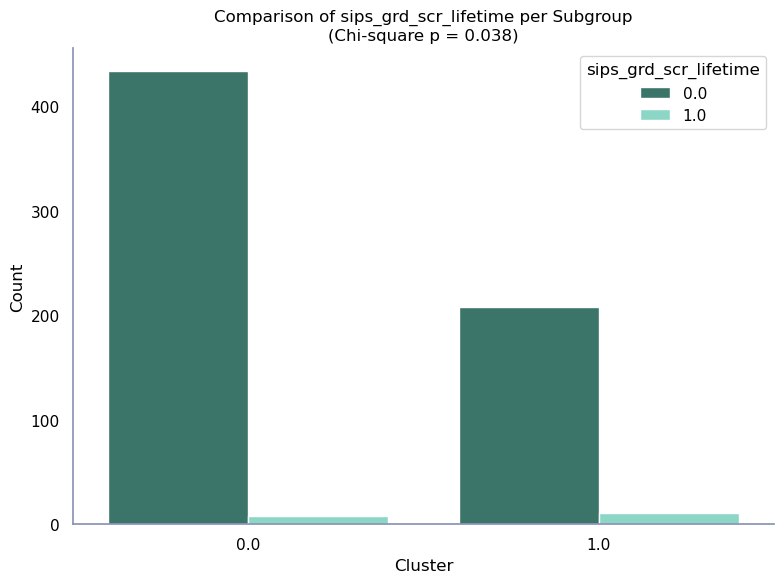


=== Analyzing categorical differences for modality: Detachment ===
✅ Merged clusters for 665 subjects (out of 825 total).


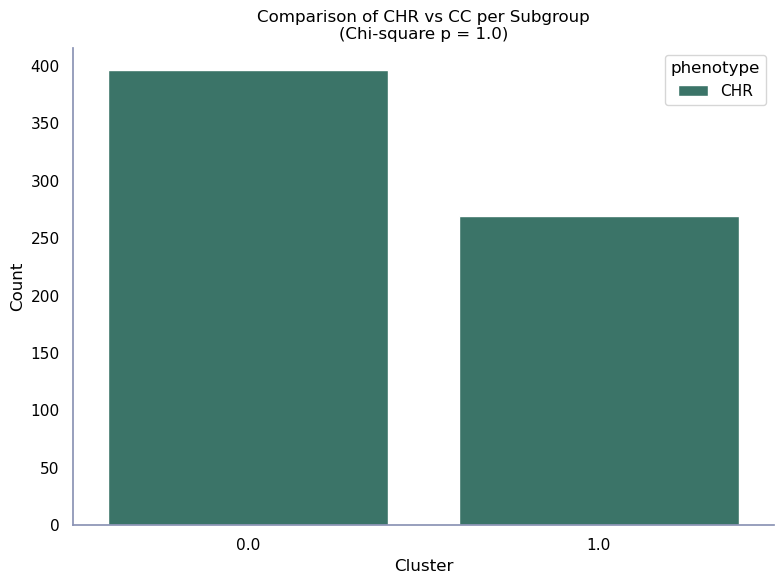

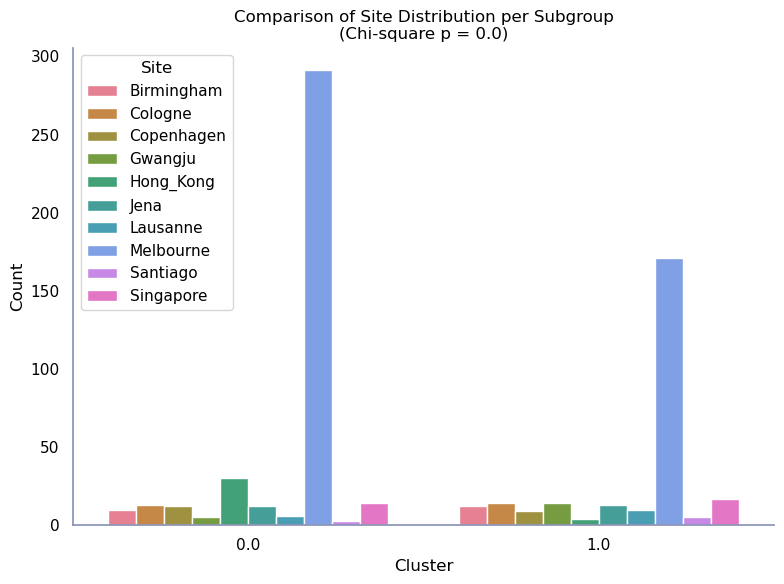

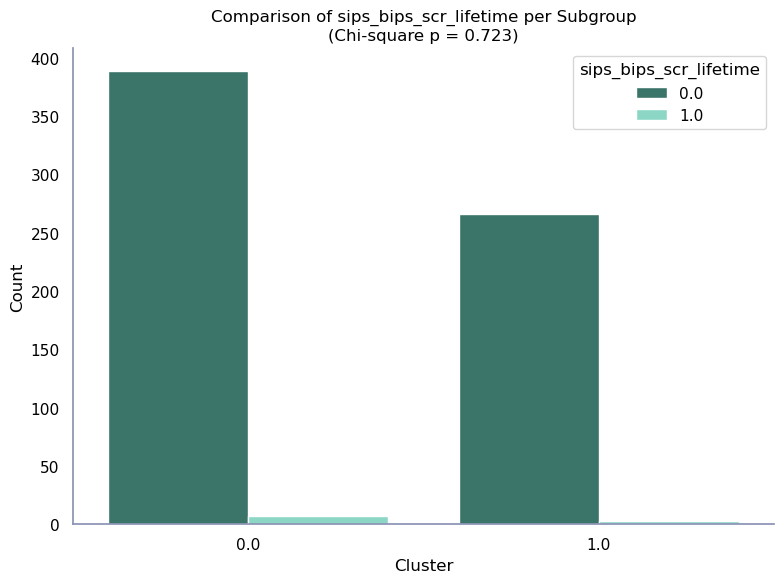

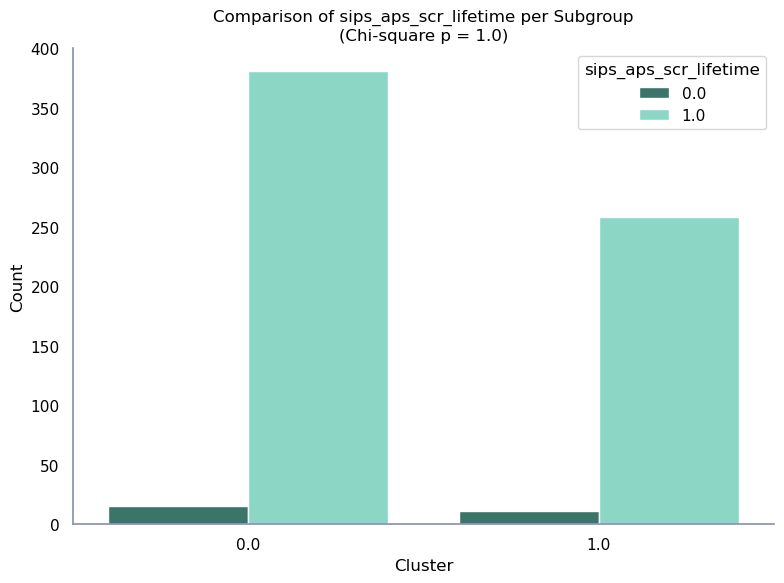

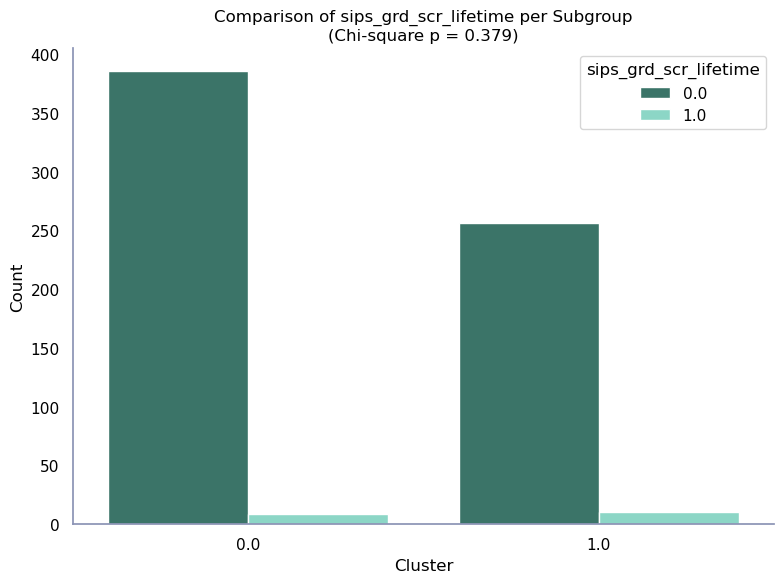


=== Analyzing categorical differences for modality: Psychoticism ===
✅ Merged clusters for 665 subjects (out of 825 total).


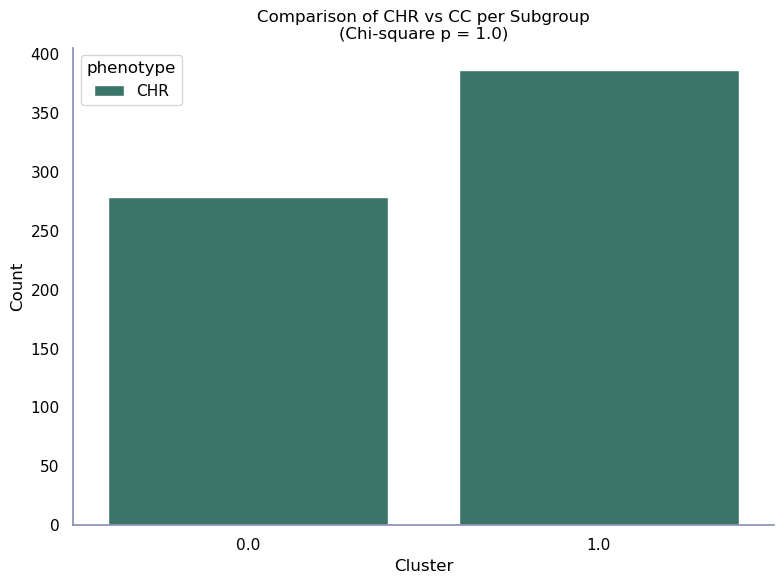

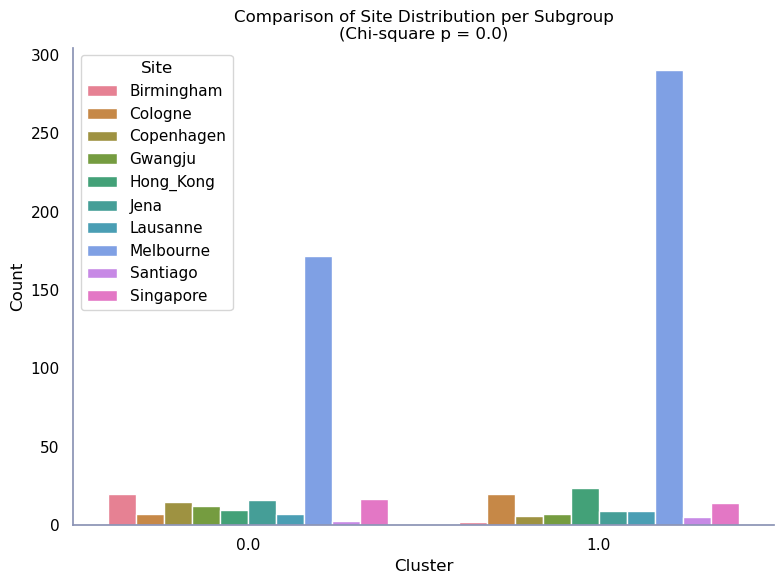

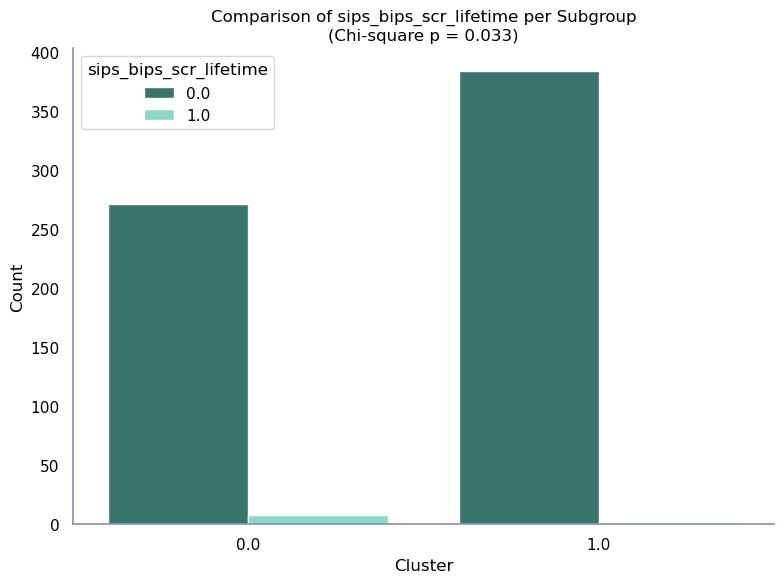

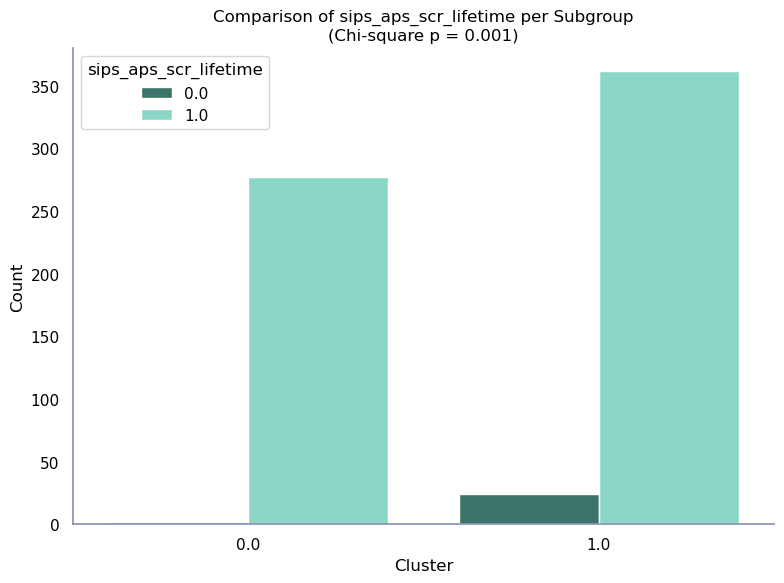

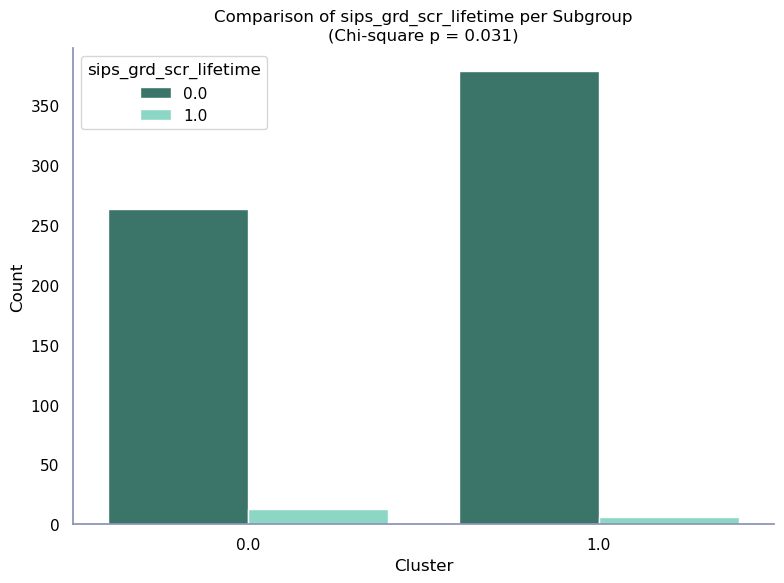


=== Analyzing categorical differences for modality: Cognition ===
✅ Merged clusters for 665 subjects (out of 825 total).


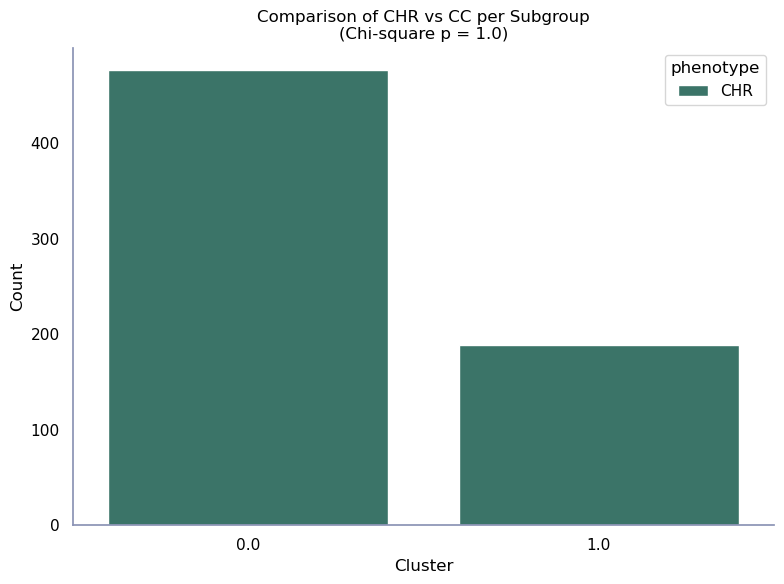

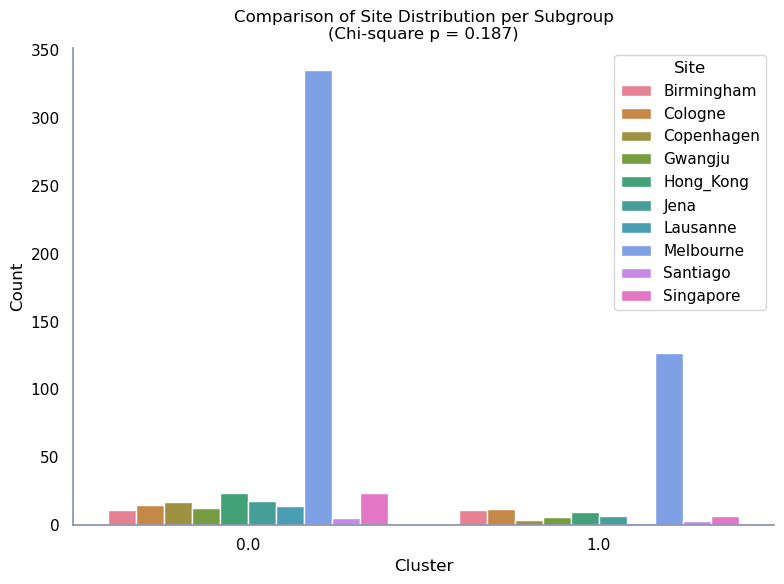

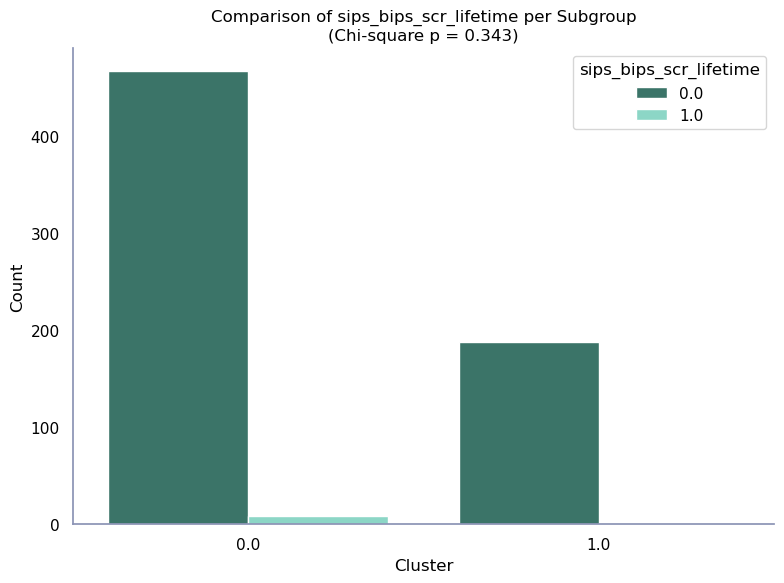

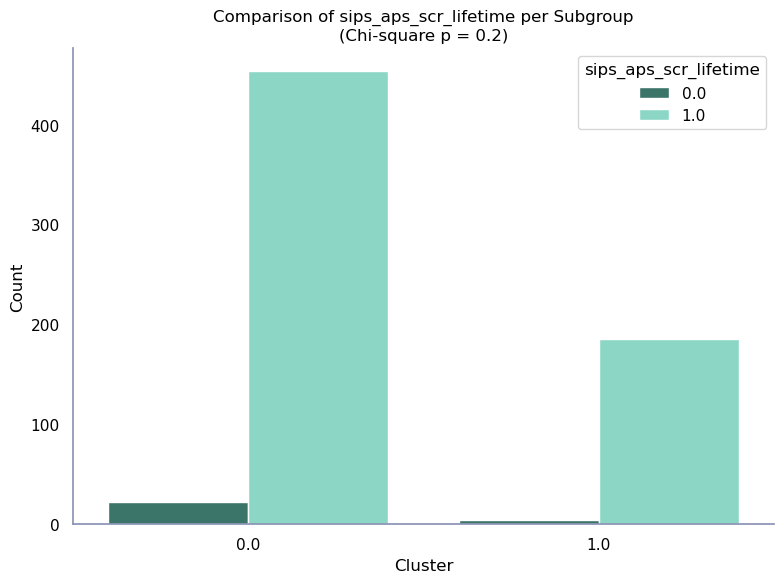

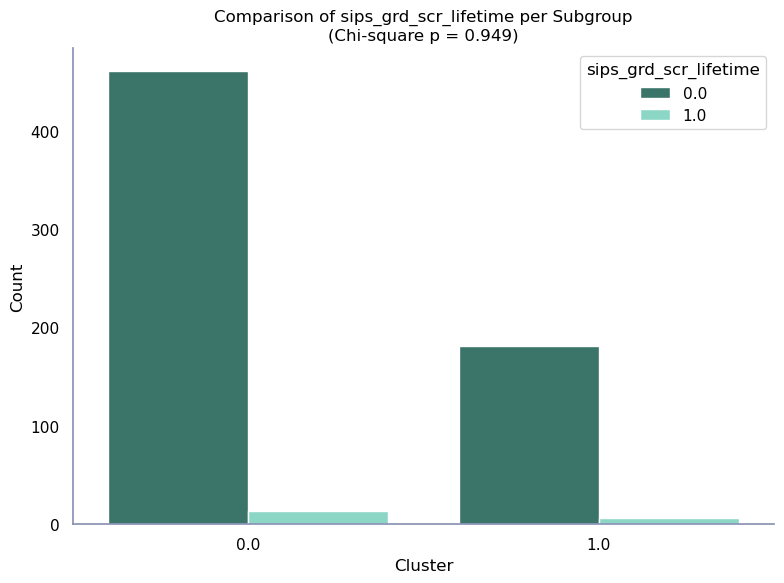

In [39]:
def add_metadata_and_clusters(final_metrics, data_full, mod_num):
    """
    Merge cluster labels into full metadata DataFrame using src_subject_id
    from the actual training data stored in fold_metrics['data'].
    This ensures correct alignment even when not all train_ids were clustered.
    """
    clusters = pd.Series(final_metrics['individual_labels'][mod_num])

    # Get the first modality’s dataframe — all have the same subject order
    modality_dfs = final_metrics.get('data', {})
    if not modality_dfs:
        raise ValueError("final_metrics['data'] is empty; cannot extract subject IDs.")
    
    # Use the src_subject_id column from the first available modality
    first_modality = list(modality_dfs.keys())[0]
    subj_ids = modality_dfs[first_modality]['src_subject_id'].reset_index(drop=True)
    
    # Sanity check: should match cluster array length
    if len(subj_ids) != len(clusters):
        print(f"⚠️ Mismatch: {len(subj_ids)} subject IDs vs {len(clusters)} cluster labels.")
        min_len = min(len(subj_ids), len(clusters))
        subj_ids = subj_ids.iloc[:min_len]
        clusters = clusters.iloc[:min_len]
        print(f"Trimmed both to {min_len} entries to align.")

    # Build cluster mapping dataframe
    cluster_df = pd.DataFrame({
        'src_subject_id': subj_ids,
        'Cluster': clusters
    })

    # Merge back into full metadata
    merged = pd.merge(data_full, cluster_df, on='src_subject_id', how='left')

    print(f"✅ Merged clusters for {merged['Cluster'].notna().sum()} subjects (out of {len(merged)} total).")
    return merged

def chi_square_comparison(df, group_col, label_col, title_prefix):
    """
    Perform chi-square test and plot grouped bar chart.
    """
    # Drop missing values
    df = df.dropna(subset=[group_col, label_col])

    # Make a copy for plotting / stats so we can safely relabel
    df_plot = df.copy()

    # Rename 'HC' -> 'CC' only for phenotype (for plotting and stats)
    if label_col == 'phenotype':
        df_plot[label_col] = df_plot[label_col].replace({'HC': 'CC'})

    # 1. Summarize counts
    summary_df = (
        df_plot.groupby([group_col, label_col])
        .size()
        .reset_index(name='n')
    )

    # 2. Chi-square test
    tbl = pd.crosstab(df_plot[group_col], df_plot[label_col])
    chi2, pval, dof, expected = chi2_contingency(tbl)
    pval = round(pval, 3)

    # 3. Grouped bar chart
    plt.figure(figsize=(8, 6))
    sns.barplot(
        data=summary_df,
        x=group_col,
        y='n',
        hue=label_col,
        dodge=True
    )
    plt.title(f"{title_prefix}\n(Chi-square p = {pval})")
    plt.xlabel("Cluster")
    plt.ylabel("Count")
    sns.despine()
    plt.tight_layout()
    plt.show()

mod_num = 0
for modality in final_metrics['data'].keys():
    print(f"\n=== Analyzing categorical differences for modality: {modality} ===")

    # Merge cluster labels into full data
    df = add_metadata_and_clusters(final_metrics, discovery_data, mod_num)

    # Compare by phenotype (CHR vs CC)
    if 'phenotype' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='phenotype',
            title_prefix=f"Comparison of CHR vs CC per Subgroup",
        )

    # Compare by site
    if 'Site' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='Site',
            title_prefix=f"Comparison of Site Distribution per Subgroup",
        )

    # Optional: extend for other categorical variables
    for col in ['sips_bips_scr_lifetime', 'sips_aps_scr_lifetime', 'sips_grd_scr_lifetime']:
        if col in df.columns:
            chi_square_comparison(
                df=df,
                group_col='Cluster',
                label_col=col,
                title_prefix=f"Comparison of {col} per Subgroup",
            )
    mod_num = mod_num + 1




### Differences categorical with final labels

✅ Merged clusters for 665 subjects (out of 825 total).


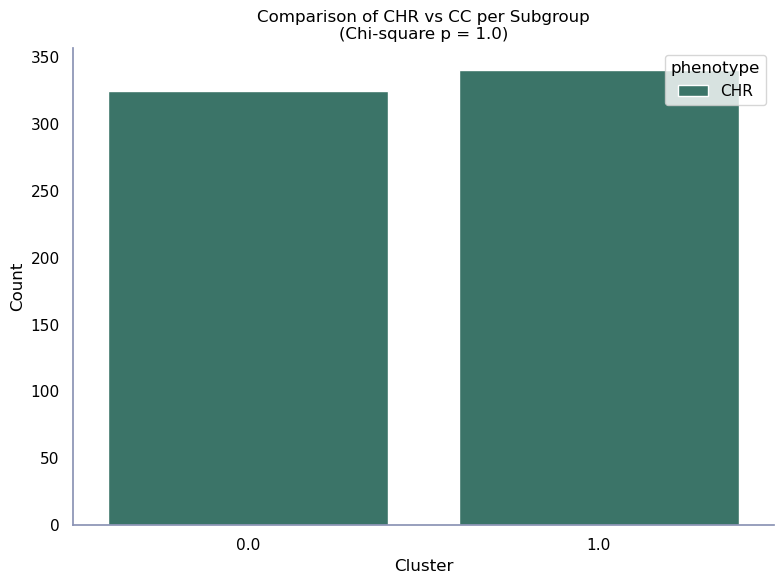


Cluster summary for Comparison of CHR vs CC per Subgroup
   Cluster  Size  CHR_percentage
0      0.0   325           100.0
1      1.0   340           100.0

------------------------------------------------------------


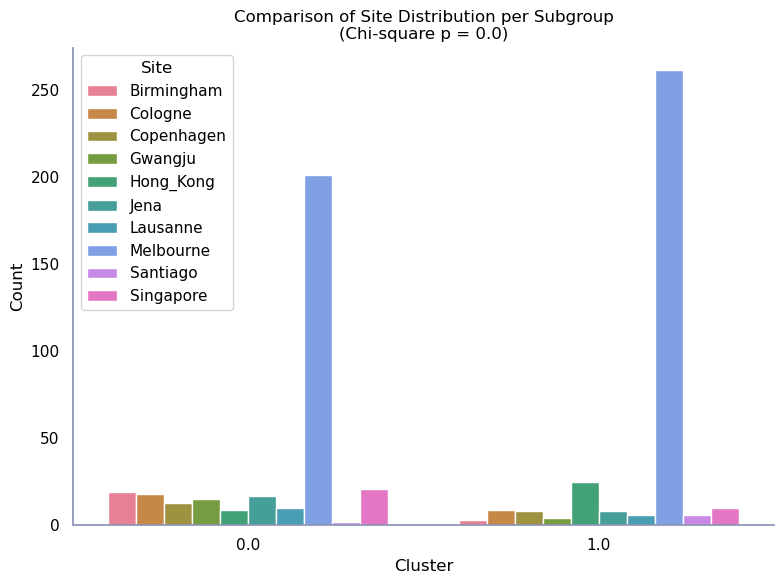


Cluster summary for Comparison of Site Distribution per Subgroup
   Cluster  Size CHR_percentage
0      0.0   325           None
1      1.0   340           None

------------------------------------------------------------


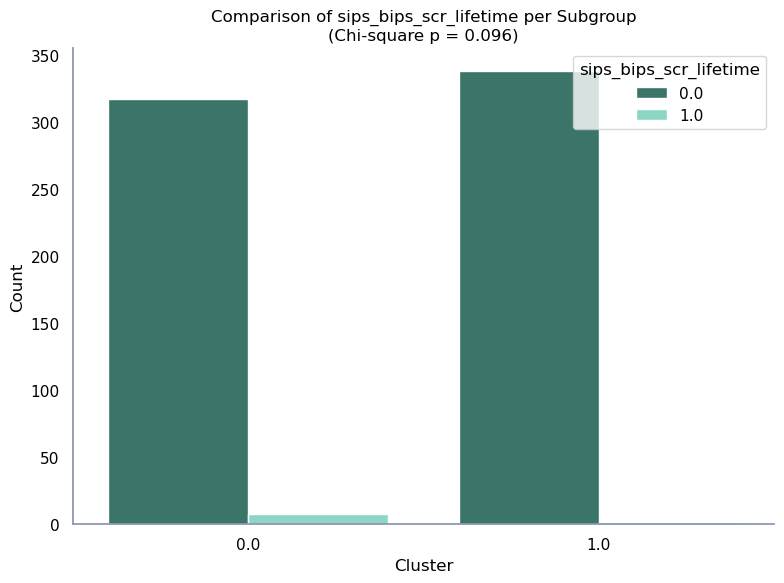


Cluster summary for Comparison of sips_bips_scr_lifetime per Subgroup
   Cluster  Size CHR_percentage
0      0.0   325           None
1      1.0   340           None

------------------------------------------------------------


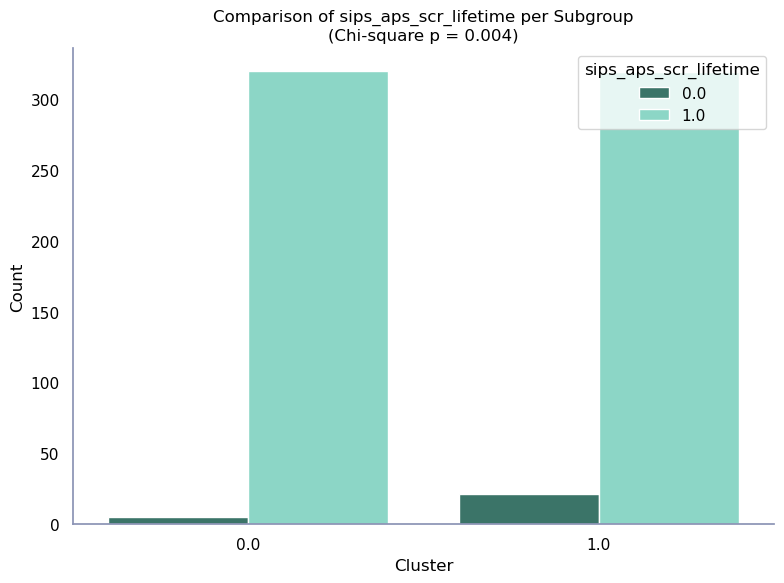


Cluster summary for Comparison of sips_aps_scr_lifetime per Subgroup
   Cluster  Size CHR_percentage
0      0.0   325           None
1      1.0   340           None

------------------------------------------------------------


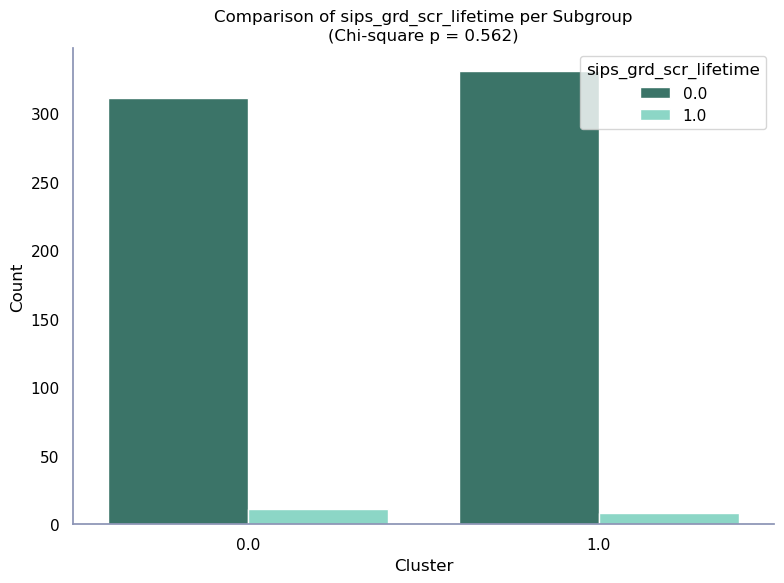


Cluster summary for Comparison of sips_grd_scr_lifetime per Subgroup
   Cluster  Size CHR_percentage
0      0.0   322           None
1      1.0   339           None

------------------------------------------------------------


In [40]:
## Create directory for categorical differences plots
os.makedirs(os.path.join(plots_dir, "merged_cat_diff/"), exist_ok=True)

def add_metadata_and_clusters(final_metrics, data_full):
    """
    Merge cluster labels into full metadata DataFrame using src_subject_id
    from the actual training data stored in fold_metrics['data'].
    This ensures correct alignment even when not all train_ids were clustered.
    """
    clusters = pd.Series(final_metrics['final_labels'])

    # Get the first modality’s dataframe — all have the same subject order
    modality_dfs = final_metrics.get('data', {})
    if not modality_dfs:
        raise ValueError("final_metrics['data'] is empty; cannot extract subject IDs.")
    
    # Use the src_subject_id column from the first available modality
    first_modality = list(modality_dfs.keys())[0]
    subj_ids = modality_dfs[first_modality]['src_subject_id'].reset_index(drop=True)
    
    # Sanity check: should match cluster array length
    if len(subj_ids) != len(clusters):
        print(f"⚠️ Mismatch: {len(subj_ids)} subject IDs vs {len(clusters)} cluster labels.")
        min_len = min(len(subj_ids), len(clusters))
        subj_ids = subj_ids.iloc[:min_len]
        clusters = clusters.iloc[:min_len]
        print(f"Trimmed both to {min_len} entries to align.")

    # Build cluster mapping dataframe
    cluster_df = pd.DataFrame({
        'src_subject_id': subj_ids,
        'Cluster': clusters
    })

    # Merge back into full metadata
    merged = pd.merge(data_full, cluster_df, on='src_subject_id', how='left')

    print(f"✅ Merged clusters for {merged['Cluster'].notna().sum()} subjects (out of {len(merged)} total).")
    return merged


def chi_square_comparison(df, group_col, label_col, title_prefix, save_path):
    """
    Perform chi-square test and plot grouped bar chart.
    """
    # Drop missing values
    df = df.dropna(subset=[group_col, label_col])

    # Make a copy for plotting / stats so we can safely relabel
    df_plot = df.copy()

    # Rename 'HC' -> 'CC' only for phenotype (for plotting and stats)
    if label_col == 'phenotype':
        df_plot[label_col] = df_plot[label_col].replace({'HC': 'CC'})

    # 1. Summarize counts
    summary_df = (
        df_plot.groupby([group_col, label_col])
        .size()
        .reset_index(name='n')
    )

    # 2. Chi-square test
    tbl = pd.crosstab(df_plot[group_col], df_plot[label_col])
    chi2, pval, dof, expected = chi2_contingency(tbl)
    pval = round(pval, 3)

    # 3. Grouped bar chart
    plt.figure(figsize=(8, 6))
    sns.barplot(
        data=summary_df,
        x=group_col,
        y='n',
        hue=label_col,
        dodge=True
    )
    plt.title(f"{title_prefix}\n(Chi-square p = {pval})")
    plt.xlabel("Cluster")
    plt.ylabel("Count")
    sns.despine()
    plt.tight_layout()
    plt.savefig(save_path, dpi=1000)
    plt.show()

    # 4. Cluster summary (including CHR percentage if relevant)
    cluster_summary = (
        df_plot.groupby(group_col)
        .agg(
            Size=(group_col, 'size'),
            CHR_percentage=(
                label_col,
                lambda x: (x.eq('CHR').sum() / len(x)) * 100
                if 'CHR' in x.values else None
            )
        )
        .reset_index()
        .sort_values(group_col)
    )
    print(f"\nCluster summary for {title_prefix}")
    print(cluster_summary)
    print("\n" + "-"*60)


# Merge cluster labels into full data
df = add_metadata_and_clusters(final_metrics, discovery_data)

# Compare by phenotype (CHR vs CC)
if 'phenotype' in df.columns:
    chi_square_comparison(
        df=df,
        group_col='Cluster',
        label_col='phenotype',
        title_prefix=f"Comparison of CHR vs CC per Subgroup",
        save_path=os.path.join(plots_dir,'merged_cat_diff/', f"merged_CHR_vs_HC.png")
    )

# Compare by site
if 'Site' in df.columns:
    chi_square_comparison(
        df=df,
        group_col='Cluster',
        label_col='Site',
        title_prefix=f"Comparison of Site Distribution per Subgroup",
        save_path=os.path.join(plots_dir,'merged_cat_diff/', f"merged_Site_by_subgroup.png")
    )

# Optional: extend for other categorical variables
for col in ['sips_bips_scr_lifetime', 'sips_aps_scr_lifetime', 'sips_grd_scr_lifetime']:
    if col in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col=col,
            title_prefix=f"Comparison of {col} per Subgroup",
            save_path=os.path.join(plots_dir,'merged_cat_diff/', f"merged_{col}_by_subgroup.png")
        )





## Overlap between simple cluster and final labels from algorithm

In [41]:
simple_labels = labels_all_k[1]
df = df_all_simple


# Calculate mean score per cluster
cluster_means = {}
for cluster in np.unique(simple_labels):
    cluster_means[cluster] = df.drop(columns=['src_subject_id']).mean().mean()

# Determine which cluster is 'high' and which is 'low'
sorted_clusters = sorted(cluster_means, key=cluster_means.get, reverse=True)
high_cluster = sorted_clusters[0]
low_cluster = sorted_clusters[1]

new_simple_labels = ['low_severity' if lbl == low_cluster else 'high_severity' for lbl in simple_labels]


final_labels_comp = final_metrics["final_labels"]
# Calculate mean score per cluster
cluster_means = {}
for cluster in np.unique(final_labels_comp):
    cluster_means[cluster] = df.drop(columns=['src_subject_id']).mean().mean()

# Determine which cluster is 'high' and which is 'low'
sorted_clusters = sorted(cluster_means, key=cluster_means.get, reverse=True)
high_cluster = sorted_clusters[0]
low_cluster = sorted_clusters[1]

new_final_labels = ['low_severity' if lbl == low_cluster else 'high_severity' for lbl in final_labels_comp]


NameError: name 'labels_all_k' is not defined

In [ ]:
ct = pd.crosstab(
    pd.Series(new_simple_labels, name='simple_labels'),
    pd.Series(new_final_labels, name='final_labels')
)

print(f"Contingency Table between simple and final labels:\n{ct}\n")

#Row-normalized: P(final | simple)
ct_row = ct.div(ct.sum(axis=1), axis=0).fillna(0)
print(f"Row-normalized contingency table (P(final | simple)):\n{ct_row}\n")


## Overlap between modalities (in labels)

In [43]:
# Rename labels for clarity
# The cluster with generally high scores should be called 'high' and the cluster with generally low scores should be called 'low' for all modalities

new_labels_list = []
modality_names = list(final_metrics["data"].keys())
for i, modality in enumerate(modality_names):
    print(f"Processing modality: {modality}")

    labels = final_metrics['individual_labels'][i]
    df = final_metrics['data'][modality]

    # Skip for modality if num_cluster<2
    if len(np.unique(labels)) < 2:
        continue
    
    # Calculate mean score per cluster
    cluster_means = {}
    for cluster in np.unique(labels):
        cluster_means[cluster] = df.drop(columns=['src_subject_id']).mean().mean()

    # Determine which cluster is 'high' and which is 'low'
    sorted_clusters = sorted(cluster_means, key=cluster_means.get, reverse=True)
    high_cluster = sorted_clusters[0]
    low_cluster = sorted_clusters[1]
    
    if modality == "Functioning" or modality == "Cognition":
        # For Functioning, reverse the assignment
        new_labels = ['low_severity' if lbl == high_cluster else 'high_severity' for lbl in labels]
    else:
        # Create new labels
        new_labels = ['high_severity' if lbl == high_cluster else 'low_severity' for lbl in labels]

    new_labels_list.append(new_labels)


Processing modality: Internalising
Processing modality: Functioning
Processing modality: Detachment
Processing modality: Psychoticism
Processing modality: Cognition


/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  styles["linewidth"].fillna(1, inplace=True)
/Users/jentemeijer/Library/r-miniconda-arm64/envs/multiview_env/lib/python3.13/site-packages/upsetplot/plotting.py:796: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never w

{'matrix': <Axes: >,
 'shading': <Axes: >,
 'totals': <Axes: >,
 'intersections': <Axes: ylabel='Intersection size'>}

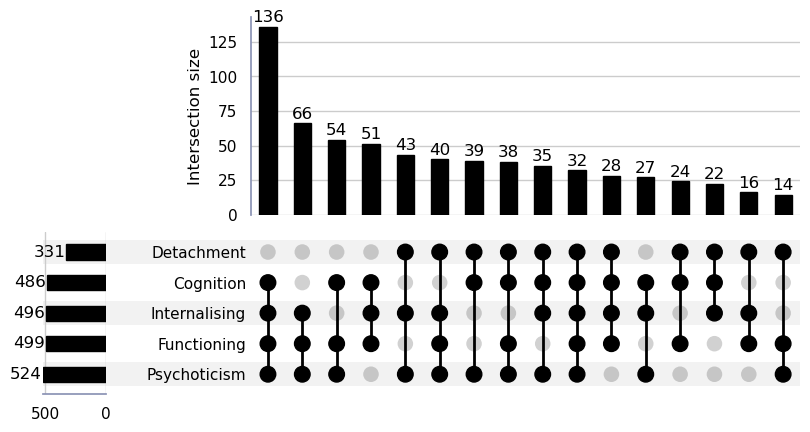

In [44]:
# pip install upsetplot pandas matplotlib
from collections import Counter
import pandas as pd
from upsetplot import UpSet

modality_names = list(final_metrics["data"].keys())

labels = new_labels_list
M = len(labels)
N = len(labels[0])
assert all(len(x) == N for x in labels)

# majority label per sample
majority = [Counter(labels[m][k] for m in range(M)).most_common(1)[0][0] for k in range(N)]

# boolean matrix: modality agrees with majority?
agree = pd.DataFrame({f"{modality_names[m]}"    : [labels[m][k] == majority[k] for k in range(N)] for m in range(M)})

# UpSet expects a MultiIndex of booleans
counts = agree.value_counts()
UpSet(counts, show_counts=True, sort_by="cardinality").plot()

In [45]:
import pandas as pd

labels = new_labels_list
M = len(labels)
N = len(labels[0])

all_agree = sum(len({labels[m][k] for m in range(M)}) == 1 for k in range(N))
print("All-4 agree:", all_agree, "/", N, "=", all_agree / N)

# 1 means full agreement, 2 means split (high vs low), since only two labels exist
unique_per_sample = [len({labels[m][k] for m in range(M)}) for k in range(N)]
print("Unique-labels-per-sample distribution:")
print(pd.Series(unique_per_sample).value_counts().sort_index())

All-4 agree: 32 / 665 = 0.0481203007518797
Unique-labels-per-sample distribution:
1     32
2    633
Name: count, dtype: int64


               Internalising  Functioning  Detachment  Psychoticism  Cognition
Internalising       1.000000     0.613534    0.406015      0.606015   0.518797
Functioning         0.613534     1.000000    0.329323      0.604511   0.610526
Detachment          0.406015     0.329323    1.000000      0.439098   0.427068
Psychoticism        0.606015     0.604511    0.439098      1.000000   0.566917
Cognition           0.518797     0.610526    0.427068      0.566917   1.000000


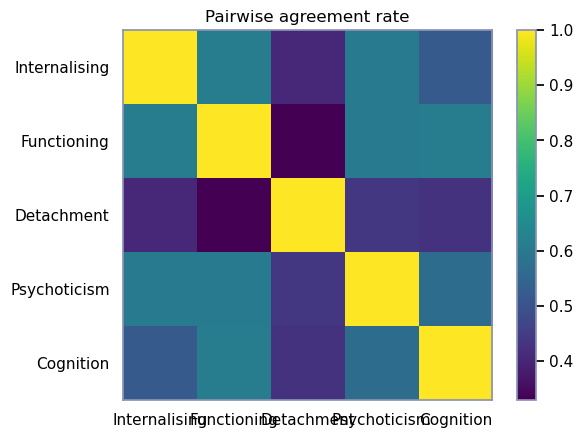

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

labels = new_labels_list
modality_names = list(final_metrics["data"].keys())

names = modality_names
N = len(labels[0])

mat = np.zeros((len(labels), len(labels)), dtype=float)
for i in range(len(labels)):
    for j in range(len(labels)):
        mat[i, j] = sum(labels[i][k] == labels[j][k] for k in range(N)) / N

df = pd.DataFrame(mat, index=names, columns=names)
print(df)

plt.figure()
plt.imshow(df.values)
plt.xticks(range(len(names)), names)
plt.yticks(range(len(names)), names)
plt.title("Pairwise agreement rate")
plt.colorbar()
plt.show()

In [47]:

final = final_metrics["final_labels"]
mods = new_labels_list  # list of 4 lists, length 665 each


assert all(len(m) == len(final) for m in mods)

for name, m in zip(names, mods):
    ct = pd.crosstab(
        pd.Series(m, name=f"{name}_label"),
        pd.Series(final, name="final_label")
    )
    print(f"\n=== {name}: counts (rows=mod label, cols=final label) ===")
    print(ct)

    # Row-normalized: P(final | modality_label)
    ct_row = ct.div(ct.sum(axis=1), axis=0).fillna(0)
    print(f"\n=== {name}: row-normalized (P(final | mod label)) ===")
    print(ct_row.round(3))


=== Internalising: counts (rows=mod label, cols=final label) ===
final_label            0    1
Internalising_label          
high_severity        259   48
low_severity          66  292

=== Internalising: row-normalized (P(final | mod label)) ===
final_label              0      1
Internalising_label              
high_severity        0.844  0.156
low_severity         0.184  0.816

=== Functioning: counts (rows=mod label, cols=final label) ===
final_label          0    1
Functioning_label          
high_severity      166   56
low_severity       159  284

=== Functioning: row-normalized (P(final | mod label)) ===
final_label            0      1
Functioning_label              
high_severity      0.748  0.252
low_severity       0.359  0.641

=== Detachment: counts (rows=mod label, cols=final label) ===
final_label         0    1
Detachment_label          
high_severity     122  274
low_severity      203   66

=== Detachment: row-normalized (P(final | mod label)) ===
final_label           

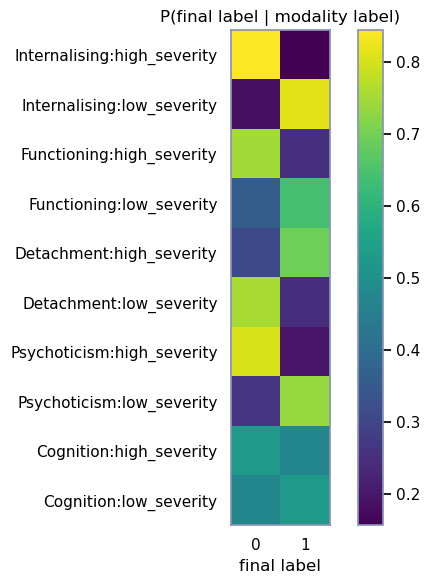

In [48]:
import pandas as pd
import matplotlib.pyplot as plt

final = pd.Series(final_metrics["final_labels"], name="final")
mods = new_labels_list

rows = []
for name, m in zip(names, mods):
    m = pd.Series(m, name="mod")
    ct = pd.crosstab(m, final, normalize="index").fillna(0)  # P(final | mod_label)
    # make rows like "mod0:0", "mod0:1"
    for mod_label in ct.index:
        rowname = f"{name}:{mod_label}"
        rows.append(pd.Series(ct.loc[mod_label], name=rowname))

mat = pd.DataFrame(rows)  # rows=modality:label, cols=final labels

plt.figure(figsize=(6, 6))
plt.imshow(mat.values)
plt.xticks(range(mat.shape[1]), mat.columns)
plt.yticks(range(mat.shape[0]), mat.index)
plt.title("P(final label | modality label)")
plt.xlabel("final label")
plt.colorbar()
plt.tight_layout()
plt.show()

In [49]:

final = pd.Series(final_metrics["final_labels"], name="final")
mods = [pd.Series(m, name=f"mod{i}") for i, m in enumerate(new_labels_list)]
df = pd.concat([final] + mods, axis=1)

mod_names = names

for col in df.columns[1:]:
    # distribution of modality labels within each final label
    dist = pd.crosstab(df["final"], df[col], normalize="index")
    name = mod_names[df.columns.get_loc(col)-1]
    print(f"\n=== {name}: distribution of {col} within each final label (rows sum to 1) ===")
    print(dist.round(3))


=== Internalising: distribution of mod0 within each final label (rows sum to 1) ===
mod0   high_severity  low_severity
final                             
0              0.797         0.203
1              0.141         0.859

=== Functioning: distribution of mod1 within each final label (rows sum to 1) ===
mod1   high_severity  low_severity
final                             
0              0.511         0.489
1              0.165         0.835

=== Detachment: distribution of mod2 within each final label (rows sum to 1) ===
mod2   high_severity  low_severity
final                             
0              0.375         0.625
1              0.806         0.194

=== Psychoticism: distribution of mod3 within each final label (rows sum to 1) ===
mod3   high_severity  low_severity
final                             
0              0.689         0.311
1              0.162         0.838

=== Cognition: distribution of mod4 within each final label (rows sum to 1) ===
mod4   high_severity  low

In [50]:
new_labels_by_modality = {}
modality_names = list(final_metrics["data"].keys())

for i, modality in enumerate(modality_names):
    labels = final_metrics['individual_labels'][i]
    df = final_metrics['data'][modality]

    if len(np.unique(labels)) < 2:
        continue

    cluster_means = {}
    for cluster in np.unique(labels):
        cluster_means[cluster] = df.drop(columns=['src_subject_id']).mean().mean()

    sorted_clusters = sorted(cluster_means, key=cluster_means.get, reverse=True)
    high_cluster = sorted_clusters[0]
    low_cluster = sorted_clusters[1]

    if modality in ("Functioning", "Cognition"):
        new_labels = ['low_severity' if lbl == high_cluster else 'high_severity' for lbl in labels]
    else:
        new_labels = ['high_severity' if lbl == high_cluster else 'low_severity' for lbl in labels]

    new_labels_by_modality[modality] = new_labels

In [51]:
# pip install plotly pandas
import pandas as pd
import plotly.graph_objects as go

def alluvial_sankey_force_high_top(
    labels_by_modality: dict,
    final_labels,
    stage_order: list,
    final_name="final",
    high_token="high_severity",
    low_token="low_severity",
    final_order="auto",         # "auto" or explicit list like ["1","0"] / ["1.0","0.0"]
    arrangement="snap",         # "fixed" (strict) or "snap" (often looks straighter)
    high_y=0.10,
    low_y=0.90,
    other_y=0.50,
    node_pad=22,
    node_thickness=18,
    width=1400,
    height=650,
    title="All modalities → final (alluvial Sankey)",
):
    # Build DataFrame in explicit order
    df = pd.DataFrame({stage: labels_by_modality[stage] for stage in stage_order})
    df[final_name] = list(final_labels)

    # stringify for safety
    for c in stage_order + [final_name]:
        df[c] = df[c].astype(str)

    hi_tok = str(high_token).strip().lower()
    lo_tok = str(low_token).strip().lower()
    def norm(s): return str(s).strip().lower()

    stages = stage_order + [final_name]

    # Link counts between adjacent stages
    link_frames = []
    for a, b in zip(stages[:-1], stages[1:]):
        counts = (
            df.groupby([a, b])
              .size()
              .reset_index(name="count")
              .sort_values("count", ascending=False)
        )
        counts["src_stage"] = a
        counts["tgt_stage"] = b
        link_frames.append(counts)
    all_links = pd.concat(link_frames, ignore_index=True)

    # Decide final node order
    if final_order == "auto":
        prev_stage = stages[-2]
        incoming = all_links[all_links["tgt_stage"] == final_name].copy()
        if not incoming.empty:
            incoming["src_is_high"] = incoming[prev_stage].map(norm).str.contains(hi_tok)
            high_flow = incoming[incoming["src_is_high"]].groupby(final_name)["count"].sum()
            final_vals = sorted(df[final_name].unique(), key=lambda x: float(high_flow.get(x, 0)), reverse=True)
        else:
            final_vals = sorted(df[final_name].unique())
    elif isinstance(final_order, list):
        final_vals = [str(x) for x in final_order]
    else:
        final_vals = sorted(df[final_name].unique())

    # Nodes
    nodes = []
    node_index = {}
    node_x, node_y = [], []

    # More horizontal spacing naturally reduces “arciness”
    stage_x = {s: (i / (len(stages) - 1)) if len(stages) > 1 else 0.5 for i, s in enumerate(stages)}

    def y_for(stage, label_str):
        n = norm(label_str)
        if hi_tok in n:
            return high_y
        if lo_tok in n:
            return low_y
        if stage == final_name and len(final_vals) >= 2:
            return high_y if label_str == final_vals[0] else low_y
        return other_y

    def add_node(stage, label_str):
        key = (stage, label_str)
        if key in node_index:
            return node_index[key]
        idx = len(nodes)
        node_index[key] = idx
        nodes.append(f"{stage}:{label_str}")
        node_x.append(stage_x[stage])
        node_y.append(y_for(stage, label_str))
        return idx

    # Pre-add nodes in stable order (high then low by y)
    for stage in stage_order:
        for lab in sorted(df[stage].unique(), key=lambda x: y_for(stage, x)):
            add_node(stage, lab)
    for lab in final_vals:
        add_node(final_name, lab)

    # Links
    sources, targets, values = [], [], []
    for _, row in all_links.iterrows():
        a = row["src_stage"]
        b = row["tgt_stage"]
        src_lab = row[a]
        tgt_lab = row[b]
        c = int(row["count"])
        sources.append(add_node(a, src_lab))
        targets.append(add_node(b, tgt_lab))
        values.append(c)

    fig = go.Figure(go.Sankey(
        arrangement=arrangement,
        node=dict(
            label=nodes,
            x=node_x,
            y=node_y,
            pad=node_pad,
            thickness=node_thickness,
        ),
        link=dict(source=sources, target=targets, value=values),
    ))

    fig.update_layout(
        title=dict(text=title, x=0.5, xanchor="center", y=0.98, yanchor="top"),
        font_size=12,
        width=width,
        height=height,
        margin=dict(t=110, l=20, r=20, b=110),  # <- prevents title overlap
    )
    fig.show()

In [52]:

stage_order = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]  # example reorder


alluvial_sankey_force_high_top(
    labels_by_modality=new_labels_by_modality,
    final_labels=final_metrics["final_labels"],
    stage_order=stage_order,
    arrangement="snap",
    high_token = "low_severity",
    low_token = "high_severity",
    high_y=0.08,
    low_y=0.92,
    node_thickness=12,          # ↓ thinner nodes
    node_pad=40,                # ↓ tighter vertical spacing requirement
    width=1000,
    height=400,
    title="All modalities → final (alluvial Sankey)",
)



In [53]:
import pandas as pd

stage_order = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]

# Pick subject_id vector from one modality (must share row order with labels)
subject_ids = final_metrics["data"][stage_order[0]]["src_subject_id"].astype(str).reset_index(drop=True)

# Build the path dataframe
df_paths = pd.DataFrame({"src_subject_id": subject_ids})
for stage in stage_order:
    df_paths[stage] = pd.Series(new_labels_by_modality[stage]).astype(str).reset_index(drop=True)

df_paths["final"] = pd.Series(final_metrics["final_labels"]).astype(str).reset_index(drop=True)

# Sanity checks
N = len(df_paths)
assert all(len(new_labels_by_modality[s]) == N for s in stage_order), "Label lengths don't match subject_ids length"
assert len(final_metrics["final_labels"]) == N, "Final labels length doesn't match subject_ids length"

df_paths.head()

,src_subject_id,Psychoticism,Detachment,Internalising,Functioning,Cognition,final
0,BM73097,low_severity,low_severity,high_severity,low_severity,low_severity,0
1,BM89694,high_severity,high_severity,high_severity,high_severity,low_severity,0
2,BM97411,high_severity,low_severity,low_severity,high_severity,low_severity,0
3,BM13122,high_severity,low_severity,high_severity,high_severity,low_severity,0
4,BM84422,high_severity,low_severity,low_severity,high_severity,high_severity,0


In [163]:
def summarize_streams(df_paths, stage_order, top_k=20, sample_ids=10):
    group_cols = stage_order + ["final"]
    total = len(df_paths)

    g = (df_paths
         .groupby(group_cols, dropna=False)
         .agg(
             n=("src_subject_id", "size"),
             example_ids=("src_subject_id", lambda x: list(x.head(sample_ids))),
         )
         .reset_index()
        )

    g["pct"] = (g["n"] / total * 100).round(2)

    # A readable "stream label"
    def make_stream_label(row):
        parts = [f"{c}={row[c]}" for c in stage_order] + [f"final={row['final']}"]
        return " → ".join(parts)

    g["stream"] = g.apply(make_stream_label, axis=1)

    g = g.sort_values("n", ascending=False).head(top_k)

    # Reorder columns nicely
    cols = ["n", "pct", "stream", "example_ids"] + stage_order + ["final"]
    return g[cols]

stream_summary = summarize_streams(df_paths, stage_order, top_k=100, sample_ids=12)
stream_summary

,n,pct,stream,example_ids,Psychoticism,Detachment,Internalising,Functioning,Cognition,final
30,114,17.14,Psychoticism=low_severity → Detachment=high_se...,"[ME10092, ME11046, ME53129, ME41045, ME06154, ...",low_severity,high_severity,low_severity,low_severity,low_severity,1
10,37,5.56,Psychoticism=high_severity → Detachment=high_s...,"[ME54434, ME54628, ME99125, ME97527, ME45207, ...",high_severity,high_severity,low_severity,low_severity,low_severity,1
26,36,5.41,Psychoticism=low_severity → Detachment=high_se...,"[ME04934, ME61146, ME86586, ME96923, ME17767, ...",low_severity,high_severity,high_severity,low_severity,low_severity,1
34,34,5.11,Psychoticism=low_severity → Detachment=low_sev...,"[BM73097, ME25689, ME46801, ME03435, ME31319, ...",low_severity,low_severity,high_severity,low_severity,low_severity,0
29,34,5.11,Psychoticism=low_severity → Detachment=high_se...,"[ME83306, ME65542, ME53830, ME20990, ME20306, ...",low_severity,high_severity,low_severity,low_severity,high_severity,1
12,32,4.81,Psychoticism=high_severity → Detachment=low_se...,"[BM13122, ME79913, ME37430, ME63950, ME12339, ...",high_severity,low_severity,high_severity,high_severity,low_severity,0
3,32,4.81,Psychoticism=high_severity → Detachment=high_s...,"[ME21588, ME25984, ME55038, ME29980, ME37529, ...",high_severity,high_severity,high_severity,low_severity,low_severity,0
42,24,3.61,Psychoticism=low_severity → Detachment=low_sev...,"[ME21922, ME84344, ME59951, ME35604, ME85443, ...",low_severity,low_severity,low_severity,low_severity,low_severity,1
1,24,3.61,Psychoticism=high_severity → Detachment=high_s...,"[BM89694, ME03013, ME06748, ME23108, ME54606, ...",high_severity,high_severity,high_severity,high_severity,low_severity,0
11,22,3.31,Psychoticism=high_severity → Detachment=low_se...,"[BM13227, CP88631, ME53735, GW09340, JE42307, ...",high_severity,low_severity,high_severity,high_severity,high_severity,0


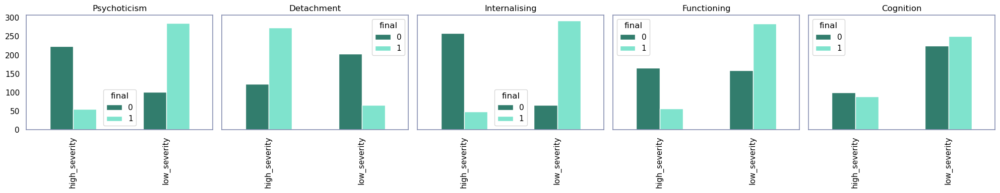

In [55]:
import pandas as pd
import matplotlib.pyplot as plt

stages = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]
df = df_paths.copy()

fig, axes = plt.subplots(1, len(stages), figsize=(4*len(stages), 4), sharey=True)
for ax, s in zip(axes, stages):
    ct = pd.crosstab(df[s], df["final"])
    ct.plot(kind="bar", ax=ax)
    ax.set_title(s)
    ax.set_xlabel("")
    ax.legend(title="final")
plt.tight_layout()
plt.show()

In [56]:
import pandas as pd
import plotly.graph_objects as go
import plotly.io as pio
import os

pio.renderers.default = "notebook_connected"

def parcats_low_on_top_with_gap_keep_final_numeric(
    new_labels_by_modality: dict,
    final_labels,
    stage_order,
    final_name="final",

    # --- Controls vertical order in each modality axis ---
    top_token="low_severity",
    bottom_token="high_severity",

    # --- Controls ribbon colors for the FINAL groups (top-like vs bottom-like final) ---
    color_for_top_final="#005341",
    color_for_bottom_final="#B3D9D5",

    width=1500,
    height=950,
    title="Parallel categories (top_token on top; final kept as 0/1)",

    # --- Final ordering controls ---
    infer_final_order_from_last_stage=True,  # infer which final value is top-like by alignment with top_token in last stage
    invert_final=False,                      # <-- NEW: swap which final value is treated as top vs bottom (0<->1)
    final_top_value=None,                    # <-- NEW: explicitly set which final value goes on top (overrides inference)
    final_bottom_value=None,                 # <-- NEW: explicitly set which final value goes on bottom (overrides inference)

    # --- Gap control ---
    add_gap_in_final=True,  # whether to add a spacer category in the final axis
    gap_weight=0.5,        # relative weight of the spacer category (0.

    # --- Saving ---
    save_file_name="Parcats.pdf",
    plots_dir=None,  # if provided, saves into this folder
):
    """
    Notes:
    - 'top_token'/'bottom_token' determine category vertical order for ALL modality axes.
    - Final axis order can be:
        A) explicitly set via final_top_value/final_bottom_value (highest priority)
        B) inferred via alignment with top_token in last stage (if infer_final_order_from_last_stage=True)
        C) fallback to sorted unique values
    - invert_final=True swaps the chosen top/bottom final values AFTER A/B/C, and colors follow accordingly.
    """

    # ----------------------------
    # 1) Build per-person dataframe
    # ----------------------------
    df = pd.DataFrame({s: pd.Series(new_labels_by_modality[s]).astype(str) for s in stage_order})
    df[final_name] = pd.Series(final_labels).astype(str)

    # ----------------------------
    # 2) Normalize modality labels into exactly {top_token, bottom_token} when possible
    # ----------------------------
    def canonicalize_label(x: str) -> str:
        x = str(x).strip()
        xl = x.lower().replace(" ", "_")

        top_l = str(top_token).strip().lower().replace(" ", "_")
        bot_l = str(bottom_token).strip().lower().replace(" ", "_")

        # Match against the provided tokens
        if top_l and top_l in xl:
            return str(top_token)
        if bot_l and bot_l in xl:
            return str(bottom_token)

        # Backward-compatible fallback for common low/high severity variants
        if ("low" in xl) and ("severity" in xl):
            return str(top_token) if ("low" in top_l) else "low_severity"
        if ("high" in xl) and ("severity" in xl):
            return str(bottom_token) if ("high" in bot_l) else "high_severity"

        return x

    for s in stage_order:
        df[s] = df[s].map(canonicalize_label)

    # ----------------------------
    # 3) Aggregate identical paths and compute counts
    # ----------------------------
    group_cols = stage_order + [final_name]
    agg = df.groupby(group_cols).size().reset_index(name="count")

    # Ensure final is string (keeps 0/1 as "0"/"1")
    agg[final_name] = agg[final_name].astype(str)

    # ----------------------------
    # 4) Determine which final value is TOP vs BOTTOM (and the final axis order)
    # ----------------------------
    final_vals = sorted(agg[final_name].unique())

    top_like_final = None
    bottom_like_final = None

    # (A) Explicit override (highest priority)
    if final_top_value is not None and final_bottom_value is not None:
        top_like_final = str(final_top_value)
        bottom_like_final = str(final_bottom_value)

    # (B) Infer from last stage alignment with top_token
    elif len(final_vals) == 2 and infer_final_order_from_last_stage:
        last_stage = stage_order[-1]
        top_rate = (
            agg.assign(is_top_last=agg[last_stage].astype(str).eq(str(top_token)))
               .groupby(final_name)
               .apply(lambda g: (g["count"] * g["is_top_last"]).sum() / g["count"].sum())
        )
        top_like_final = str(top_rate.sort_values(ascending=False).index[0])
        bottom_like_final = str([v for v in final_vals if str(v) != top_like_final][0])

    # (C) Fallback: use sorted order
    else:
        if len(final_vals) >= 1:
            top_like_final = str(final_vals[0])
        if len(final_vals) >= 2:
            bottom_like_final = str(final_vals[1])

    # Apply invert_final AFTER selection/inference/override
    if invert_final and top_like_final is not None and bottom_like_final is not None:
        top_like_final, bottom_like_final = bottom_like_final, top_like_final

    # Final axis ordering (top -> bottom)
    if top_like_final is not None and bottom_like_final is not None:
        final_order = [top_like_final, bottom_like_final]
    else:
        final_order = [str(v) for v in final_vals]

    # ----------------------------
    # 5) Category orders for the modality axes
    # ----------------------------
    severity_order = [str(top_token), str(bottom_token)]

    # ----------------------------
    # 6) Build dimensions with explicit category order
    # ----------------------------


    SPACER = "  "  # use a normal visible-safe token (reliable renderer)

    # Add one dummy row where everything is spacer, with tiny count
    dummy = {c: SPACER for c in group_cols}
    dummy["count"] = gap_weight
    agg = pd.concat([agg, pd.DataFrame([dummy])], ignore_index=True)

    # Category orders
    # Severity axes: top_token on top, bottom_token on bottom
    severity_order = [str(top_token), SPACER, str(bottom_token)]
    if add_gap_in_final and len(final_order) >= 2:
        final_category_order = [final_order[0], SPACER, final_order[1]]
    else:
        final_category_order = final_order

    # ----------------------------
    # 4) Build dimensions with explicit category order (forces low on top)
    # ----------------------------
    dimensions = []
    for s in stage_order:
        dimensions.append(
            dict(
                label=s,
                values=agg[s],
                categoryorder="array",
                categoryarray=severity_order,
            )
        )

    dimensions.append(
        dict(
            label=final_name,
            values=agg[final_name],
            categoryorder="array",
            categoryarray=final_category_order,
        )
    )

    # ----------------------------
    # 7) Colors follow TOP/BOTTOM final selection (and swap automatically if invert_final=True)
    # ----------------------------
    color_map = {}
    if top_like_final is not None:
        color_map[str(top_like_final)] = color_for_top_final
    if bottom_like_final is not None:
        color_map[str(bottom_like_final)] = color_for_bottom_final

    line_colors = agg[final_name].map(color_map).fillna("rgba(0,0,0,0)").tolist()

    # ----------------------------
    # 8) Plot + legend
    # ----------------------------
    fig = go.Figure()

    fig.add_trace(
        go.Parcats(
            dimensions=dimensions,
            counts=agg["count"],
            line=dict(color=line_colors),
            arrangement="freeform",
        )
    )

    # Legend reflects what was actually used
    if top_like_final is not None:
        fig.add_trace(
            go.Scatter(
                x=[None], y=[None],
                mode="markers",
                marker=dict(size=12, color=color_for_top_final),
                name=f"{final_name} = {top_like_final} (TOP)",
                showlegend=True,
                hoverinfo="skip",
            )
        )
    if bottom_like_final is not None:
        fig.add_trace(
            go.Scatter(
                x=[None], y=[None],
                mode="markers",
                marker=dict(size=12, color=color_for_bottom_final),
                name=f"{final_name} = {bottom_like_final} (BOTTOM)",
                showlegend=True,
                hoverinfo="skip",
            )
        )

    fig.update_layout(
        title=title,
        width=width,
        height=height,
        margin=dict(t=80, l=40, r=40, b=80),
        legend=dict(
            title=f"Ribbon color = {final_name} (top vs bottom)",
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="left",
            x=0.0
        ),
    )

    fig.update_xaxes(visible=False, showticklabels=False, showgrid=False, zeroline=False)
    fig.update_yaxes(visible=False, showticklabels=False, showgrid=False, zeroline=False)

    fig.show()

    if plots_dir is not None and save_file_name:
        fig.write_image(os.path.join(plots_dir, save_file_name), scale=2)

In [57]:
stage_order = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]

parcats_low_on_top_with_gap_keep_final_numeric(
    new_labels_by_modality=new_labels_by_modality,
    final_labels=final_metrics["final_labels"],
    stage_order=["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"],
    final_name="final",
    top_token="high_severity",          # now HIGH is on top
    bottom_token="low_severity",
    invert_final=False,
    color_for_top_final="#005341",      # top-like final ribbons
    color_for_bottom_final="#B3D9D5",   # bottom-like final ribbons
    add_gap_in_final=True,
    gap_weight=20,
    plots_dir=plots_dir,
    save_file_name = "Parcats_by_final.pdf"
)



/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3605646250.py:111: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## SVM results

### Final labels

#### Accuracy

In [58]:
for metric in final_metrics['svm_results']['mean_metrics']:
    print(f"SVM Mean {metric}: {final_metrics['svm_results']['mean_metrics'][metric]}")


SVM Mean accuracy: 0.8766917293233082
SVM Mean balanced_accuracy: 0.8767647058823529
SVM Mean precision: 0.8771043887722308
SVM Mean recall: 0.8767647058823529
SVM Mean roc_auc: 0.9490045248868778


#### Uncertainty

In [59]:
final_metrics['svm_results']['oof_uncertainty']

,index,y_true,y_pred,confidence,entropy,margin
0,3,0,0,0.999912,0.000912,6.892287
1,9,1,0,0.769138,0.540315,0.947606
2,13,1,1,0.902262,0.320084,1.555787
3,24,0,0,0.879761,0.367400,1.522748
4,27,0,0,0.963405,0.156967,2.481482
...,...,...,...,...,...,...
660,649,0,0,0.997494,0.017510,2.351055
661,651,1,1,0.942319,0.220537,1.047706
662,656,1,1,0.579457,0.680467,0.090572
663,659,1,1,0.722517,0.590560,0.337453


In [60]:
# Find most confident mistakes 
df = final_metrics['svm_results']['oof_uncertainty'] 

df_bad = df[(df["y_true"] != df["y_pred"]) & (df["confidence"] > 0.9)]
df_bad.sort_values("confidence", ascending=False).head(20)

,index,y_true,y_pred,confidence,entropy,margin
598,323,1,0,0.990275,0.054734,1.826000
628,512,0,1,0.976496,0.111379,1.409362
658,638,0,1,0.975687,0.114379,1.395938
446,283,0,1,0.967896,0.141983,1.329687
261,648,1,0,0.965710,0.149352,2.808694
354,444,1,0,0.931056,0.250900,1.096656
358,489,1,0,0.920226,0.278217,1.031893
96,468,0,1,0.915102,0.290571,1.669062
390,632,1,0,0.914972,0.290880,1.003330
557,135,1,0,0.908710,0.305511,0.922387


In [61]:
# Find most uncertain predictions
df_uncertain = df.sort_values(["confidence", "entropy"], ascending=[True, False])
df_uncertain.head(20)

,index,y_true,y_pred,confidence,entropy,margin
20,109,1,0,0.500000,0.693147,0.077896
141,41,0,0,0.500000,0.693147,0.062260
364,503,1,0,0.500000,0.693147,0.029300
328,339,0,0,0.505251,0.693092,0.035588
235,500,1,0,0.505631,0.693084,0.044099
70,362,0,0,0.508132,0.693015,0.044026
404,14,0,0,0.508720,0.692995,0.008748
578,238,1,0,0.511454,0.692885,0.050683
178,212,0,0,0.512082,0.692855,0.101893
60,299,1,0,0.512132,0.692853,0.032324


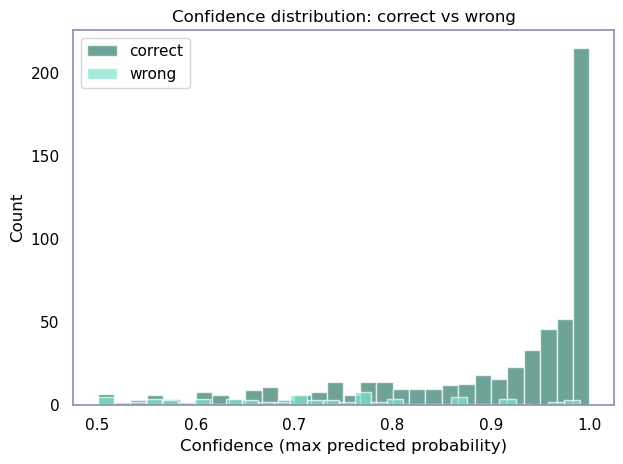

In [62]:
correct = df["y_true"] == df["y_pred"]

plt.figure()
plt.hist(df.loc[correct, "confidence"].dropna(), bins=30, alpha=0.7, label="correct")
plt.hist(df.loc[~correct, "confidence"].dropna(), bins=30, alpha=0.7, label="wrong")
plt.xlabel("Confidence (max predicted probability)")
plt.ylabel("Count")
plt.title("Confidence distribution: correct vs wrong")
plt.legend()
plt.tight_layout()
plt.show()

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2071701079.py:7: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



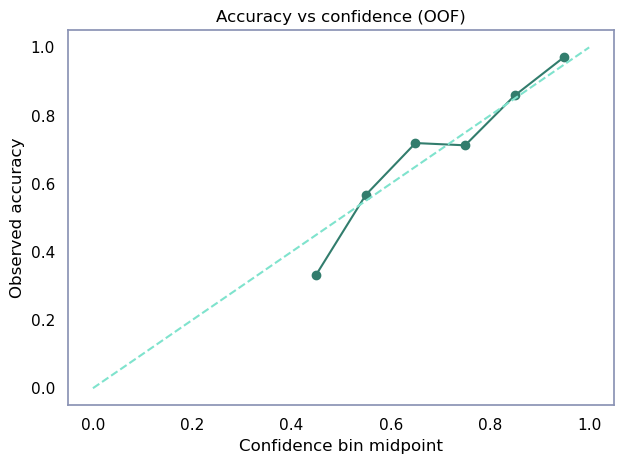

          bin  bin_mid  accuracy    n
0  (0.4, 0.5]     0.45  0.333333    3
1  (0.5, 0.6]     0.55  0.567568   37
2  (0.6, 0.7]     0.65  0.719298   57
3  (0.7, 0.8]     0.75  0.712644   87
4  (0.8, 0.9]     0.85  0.858824   85
5  (0.9, 1.0]     0.95  0.972222  396


In [63]:
df2 = df.dropna(subset=["confidence"]).copy()
bins = np.linspace(0, 1, 11)

df2["bin"] = pd.cut(df2["confidence"], bins=bins, include_lowest=True)
grp = df2.groupby("bin", observed=True)

acc = grp.apply(lambda g: (g["y_true"] == g["y_pred"]).mean())
cnt = grp.size()

# Midpoints only for bins that exist
x = np.array([interval.mid for interval in acc.index])

plt.figure()
plt.plot(x, acc.values, marker="o")
plt.plot([0, 1], [0, 1], linestyle="--")
plt.xlabel("Confidence bin midpoint")
plt.ylabel("Observed accuracy")
plt.title("Accuracy vs confidence (OOF)")
plt.tight_layout()
plt.show()

print(pd.DataFrame({"bin": acc.index.astype(str), "bin_mid": x, "accuracy": acc.values, "n": cnt.values}))

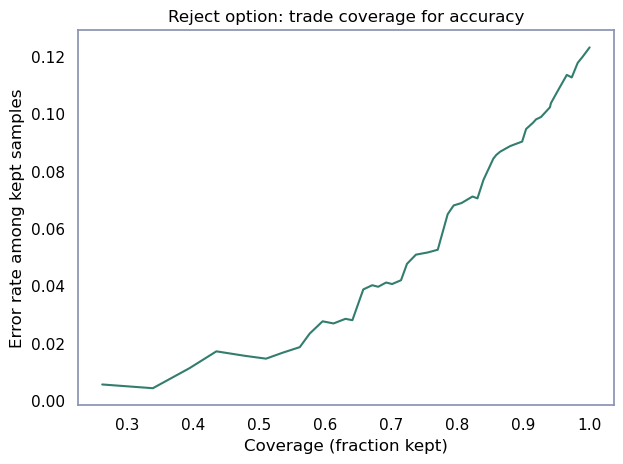

In [64]:
df2 = df.dropna(subset=["confidence"]).copy()
df2["correct"] = (df2["y_true"] == df2["y_pred"]).astype(int)

thresholds = np.linspace(0, 1, 101)
coverage = []
error_rate = []

for t in thresholds:
    kept = df2[df2["confidence"] >= t]
    if len(kept) == 0:
        coverage.append(0.0)
        error_rate.append(np.nan)
        continue
    coverage.append(len(kept) / len(df2))
    error_rate.append(1 - kept["correct"].mean())

plt.figure()
plt.plot(coverage, error_rate)
plt.xlabel("Coverage (fraction kept)")
plt.ylabel("Error rate among kept samples")
plt.title("Reject option: trade coverage for accuracy")
plt.tight_layout()
plt.show()

#### Variable contribution

In [65]:

meta_svm = final_metrics['svm_results']['feature_importance_meta']
print(f"Model information: {meta_svm}")

feat_imp_mean = final_metrics['svm_results']['feature_importance_mean']
feat_imp_std  = final_metrics['svm_results']['feature_importance_std']

# If loaded from packed results (dict), convert to Series
if isinstance(feat_imp_mean, dict):
    feat_imp_mean = pd.Series(feat_imp_mean, dtype=float)
if isinstance(feat_imp_std, dict):
    feat_imp_std = pd.Series(feat_imp_std, dtype=float)

# Build tidy table
df_imp = (
    pd.DataFrame({
        "feature": feat_imp_mean.index,
        "importance_mean": feat_imp_mean.values,
        "importance_std": feat_imp_std.reindex(feat_imp_mean.index).values if feat_imp_std is not None else None,
    })
    .sort_values("importance_mean", ascending=False)
    .reset_index(drop=True)
)

df_imp.head(20)

Model information: {'method': 'linear_coef', 'kernel': 'linear'}


,feature,importance_mean,importance_std
0,chrbprs_affect_subscale,0.322429,0.397963
1,chrcdss_total,0.254613,0.320132
2,chrpss_perceived_stress_scale_total,0.187052,0.247839
3,chrnsipr_diminished_expression_dimension,0.181290,0.238475
4,chrnsipr_asociality_domain,0.175695,0.239432
5,chroasis_oasis_total10,0.153217,0.206327
6,sips_pos_tot,0.152254,0.204977
7,psychs_sips_p5,0.129157,0.151591
8,psychs_caarms_p4,0.121766,0.169168
9,chrnsipr_blunted_affect_domain,0.113925,0.151935


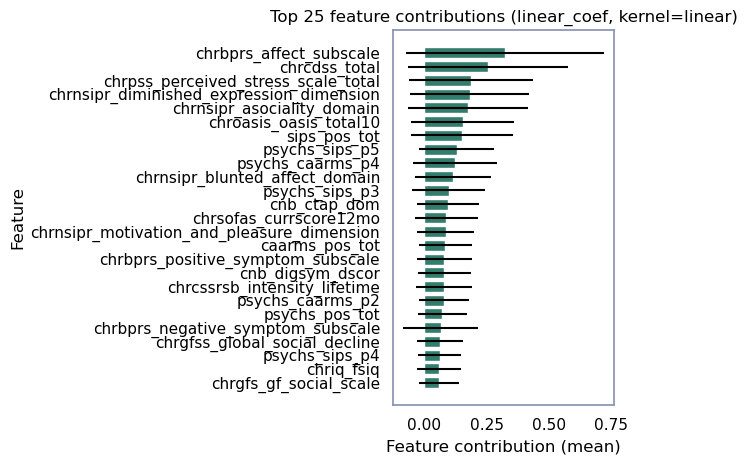

In [66]:
import matplotlib.pyplot as plt

top_n = 25
plot_df = df_imp.head(top_n).iloc[::-1]  # reverse for nice ordering

plt.figure()
plt.barh(plot_df["feature"], plot_df["importance_mean"],
         xerr=plot_df["importance_std"] if "importance_std" in plot_df else None)
plt.xlabel("Feature contribution (mean)")
plt.ylabel("Feature")
plt.title(f"Top {top_n} feature contributions ({meta_svm.get('method','')}, kernel={meta_svm.get('kernel','')})")
plt.tight_layout()
plt.show()

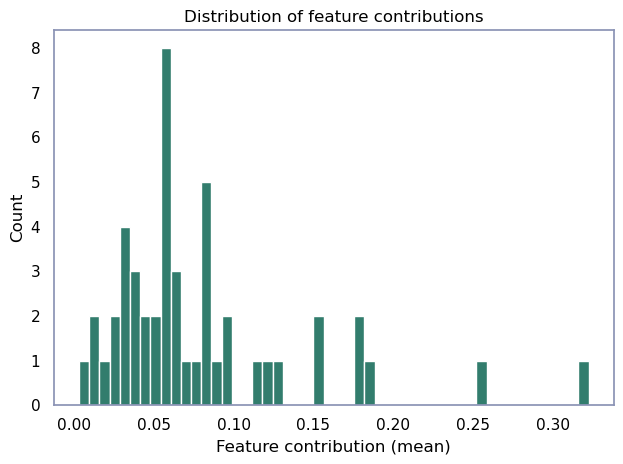

In [67]:
plt.figure()
plt.hist(df_imp["importance_mean"].values, bins=50)
plt.xlabel("Feature contribution (mean)")
plt.ylabel("Count")
plt.title("Distribution of feature contributions")
plt.tight_layout()
plt.show()

### Individual labels

#### Accuracy

In [68]:
modality_names = list(final_metrics["data"].keys())
svm_results = final_metrics.get("svm_results_modalities", [])

for mod_name, res in zip(modality_names, svm_results):
    print(f"SVM results for modality: {mod_name}")

    mean_metrics = (res or {}).get("mean_metrics")
    if mean_metrics:
        for metric, value in mean_metrics.items():
            print(f"SVM Mean {metric}: {value}")
    else:
        print("SVM Mean metrics: None")

    print()  # empty line between modalities

SVM results for modality: Internalising
SVM Mean accuracy: 0.9909774436090226
SVM Mean balanced_accuracy: 0.990915300546448
SVM Mean precision: 0.9909676466792792
SVM Mean recall: 0.990915300546448
SVM Mean roc_auc: 0.9997267759562842

SVM results for modality: Functioning
SVM Mean accuracy: 0.9789473684210526
SVM Mean balanced_accuracy: 0.9796725683804335
SVM Mean precision: 0.9734884128325365
SVM Mean recall: 0.9796725683804335
SVM Mean roc_auc: 0.9980195210532289

SVM results for modality: Detachment
SVM Mean accuracy: 0.974436090225564
SVM Mean balanced_accuracy: 0.976754571026723
SVM Mean precision: 0.9711628283996705
SVM Mean recall: 0.976754571026723
SVM Mean roc_auc: 0.9989211315447285

SVM results for modality: Psychoticism
SVM Mean accuracy: 0.9804511278195489
SVM Mean balanced_accuracy: 0.9787012987012987
SVM Mean precision: 0.9819203153432736
SVM Mean recall: 0.9787012987012987
SVM Mean roc_auc: 0.9986078207506779

SVM results for modality: Cognition
SVM Mean accuracy: 0.94

#### Uncertainty

SVM results for modality: Internalising
No confident mistakes found for modality Internalising.
     index  y_true  y_pred  confidence   entropy    margin
244    529       0       0    0.511457  0.692885  0.101544
529    659       1       1    0.511670  0.692875  0.052959
334    341       1       0    0.515982  0.692636  0.064356
360    442       0       0    0.525329  0.691863  0.073540
380    564       1       0    0.534669  0.690741  0.082739
453    281       1       1    0.548019  0.688528  0.203416
649    577       1       0    0.552885  0.687543  0.331422
282    101       0       1    0.555361  0.687005  0.005749
344    373       0       0    0.566632  0.684241  0.114538
116    588       0       0    0.569519  0.683450  0.399269


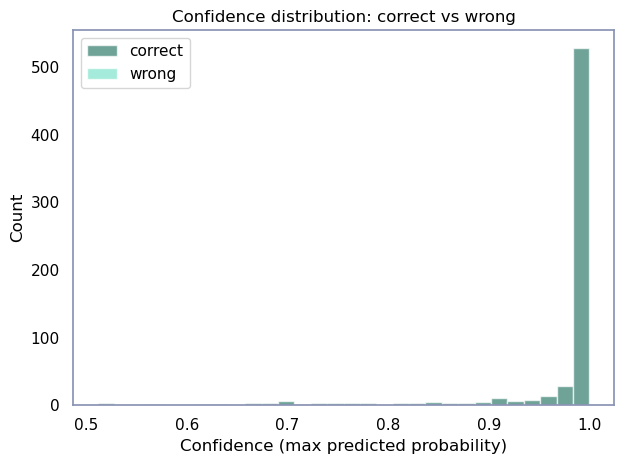

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2447095193.py:38: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



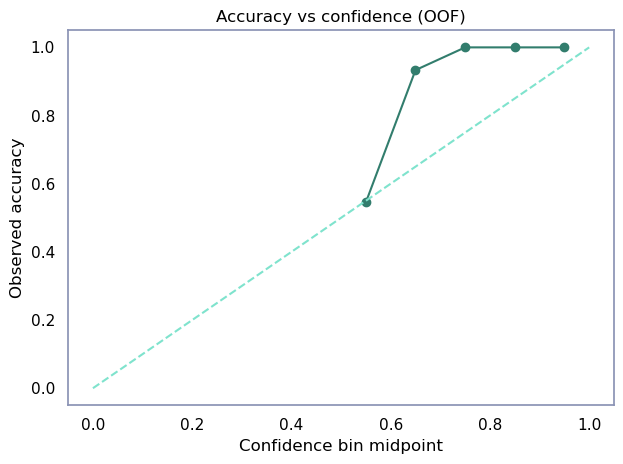

          bin  bin_mid  accuracy    n
0  (0.5, 0.6]     0.55  0.545455   11
1  (0.6, 0.7]     0.65  0.933333   15
2  (0.7, 0.8]     0.75  1.000000   20
3  (0.8, 0.9]     0.85  1.000000   23
4  (0.9, 1.0]     0.95  1.000000  596


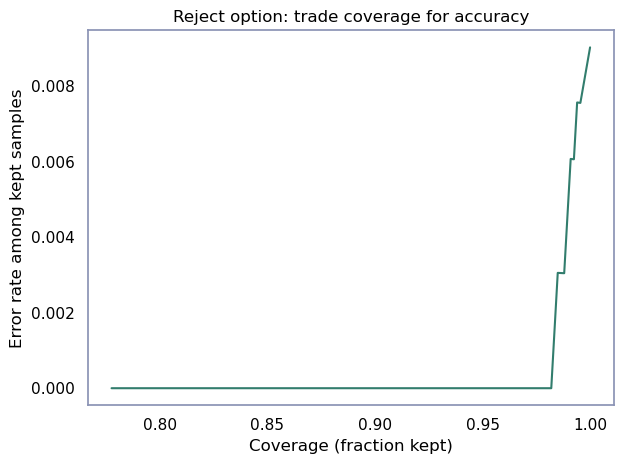

SVM results for modality: Functioning
No confident mistakes found for modality Functioning.
     index  y_true  y_pred  confidence   entropy    margin
385    579       1       1    0.500000  0.693147  0.445420
572    188       1       1    0.510303  0.692935  0.376479
135      6       1       0    0.511711  0.692873  0.000907
310    243       1       1    0.512871  0.692816  0.537914
582    258       1       1    0.524161  0.691979  0.332512
615    416       0       1    0.535584  0.690613  0.296162
536     22       0       1    0.536331  0.690505  0.293781
366    485       1       1    0.537963  0.690262  0.705224
185    252       0       1    0.540174  0.689916  0.092071
407     56       1       1    0.543834  0.689299  0.346094


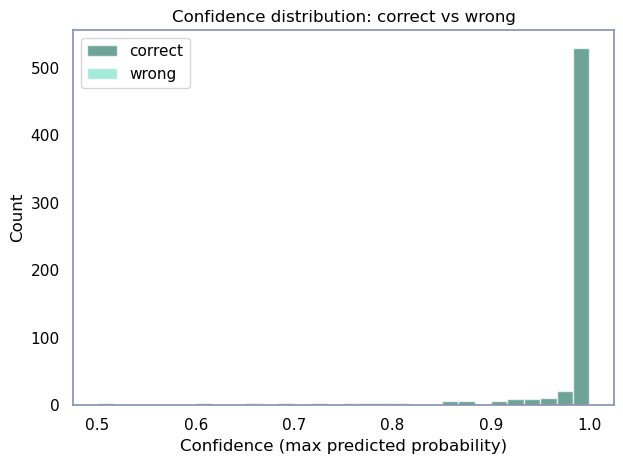

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2447095193.py:38: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



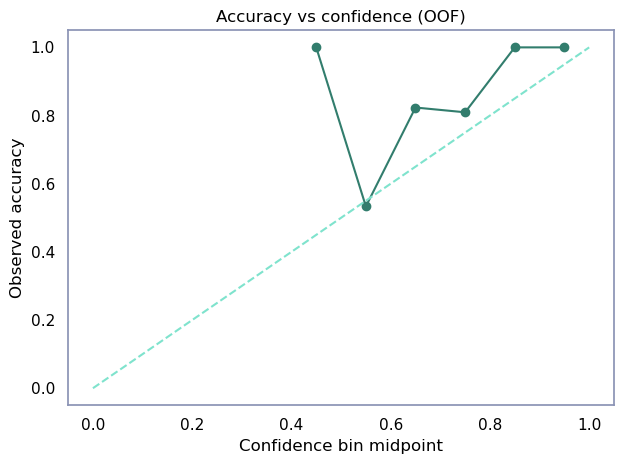

          bin  bin_mid  accuracy    n
0  (0.4, 0.5]     0.45  1.000000    1
1  (0.5, 0.6]     0.55  0.533333   15
2  (0.6, 0.7]     0.65  0.823529   17
3  (0.7, 0.8]     0.75  0.809524   21
4  (0.8, 0.9]     0.85  1.000000   23
5  (0.9, 1.0]     0.95  1.000000  588


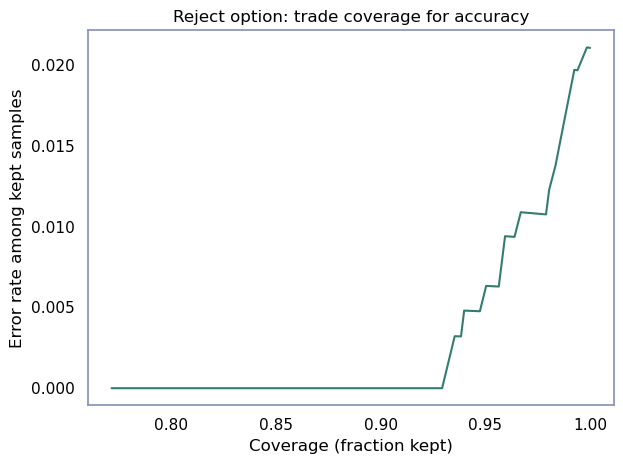

SVM results for modality: Detachment
     index  y_true  y_pred  confidence  entropy    margin
325    261       1       0    0.923687  0.26967  0.786646
     index  y_true  y_pred  confidence   entropy    margin
336    313       1       1    0.500000  0.693147  0.202308
371    520       0       1    0.514516  0.692726  0.221135
15      76       0       1    0.522689  0.692117  0.226283
332    303       0       1    0.538587  0.690166  0.259248
179    240       1       1    0.543395  0.689376  0.187263
192    326       0       1    0.560546  0.685798  0.077772
38     185       0       1    0.598091  0.673778  0.014208
101    502       0       1    0.599471  0.673226  0.359817
661    638       0       1    0.603521  0.671558  0.185883
65     322       1       0    0.607418  0.669889  0.003028


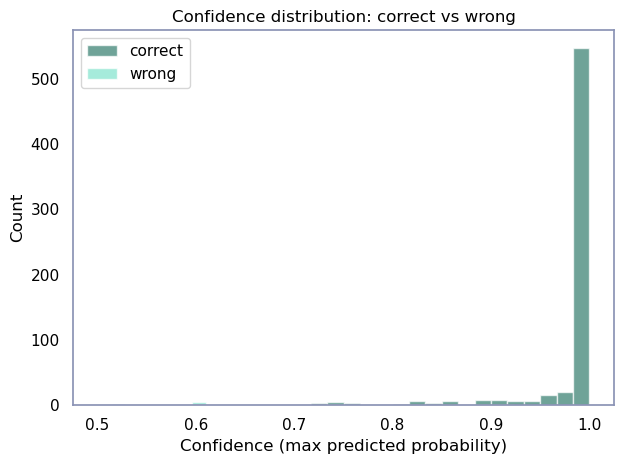

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2447095193.py:38: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



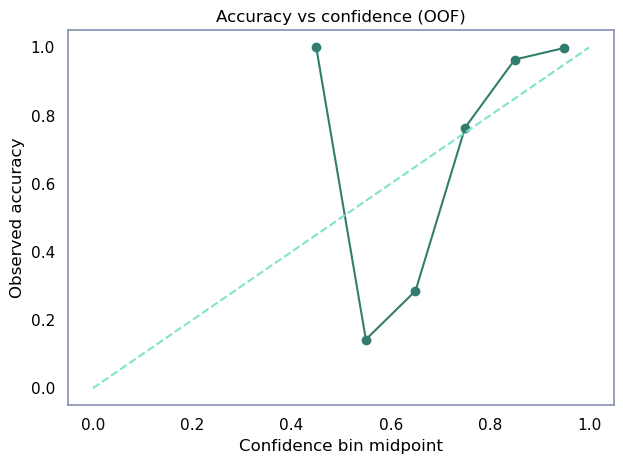

          bin  bin_mid  accuracy    n
0  (0.4, 0.5]     0.45  1.000000    1
1  (0.5, 0.6]     0.55  0.142857    7
2  (0.6, 0.7]     0.65  0.285714    7
3  (0.7, 0.8]     0.75  0.764706   17
4  (0.8, 0.9]     0.85  0.964286   28
5  (0.9, 1.0]     0.95  0.998347  605


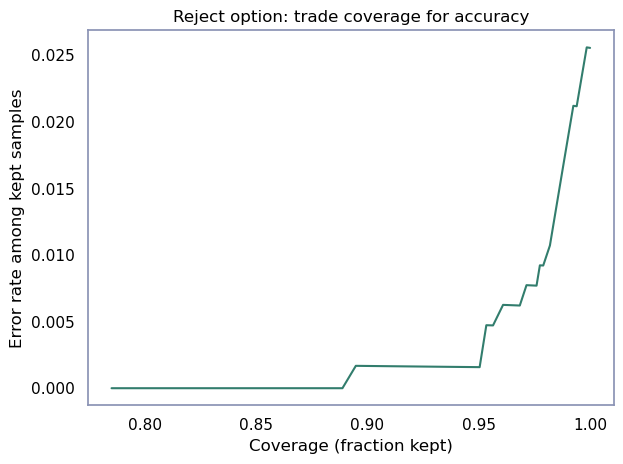

SVM results for modality: Psychoticism
No confident mistakes found for modality Psychoticism.
     index  y_true  y_pred  confidence   entropy    margin
34     138       0       0    0.500000  0.693147  0.126322
662    654       1       0    0.511022  0.692904  0.383029
71     342       0       0    0.515202  0.692685  0.157621
304    239       0       0    0.533987  0.690835  0.126185
391    613       0       1    0.550100  0.688119  0.000070
486    453       0       1    0.558298  0.686334  0.039833
317    294       0       1    0.580279  0.680202  0.045613
457    315       0       0    0.587802  0.677649  0.149252
211    361       1       0    0.592842  0.675807  0.004693
346    412       0       1    0.607819  0.669714  0.087144


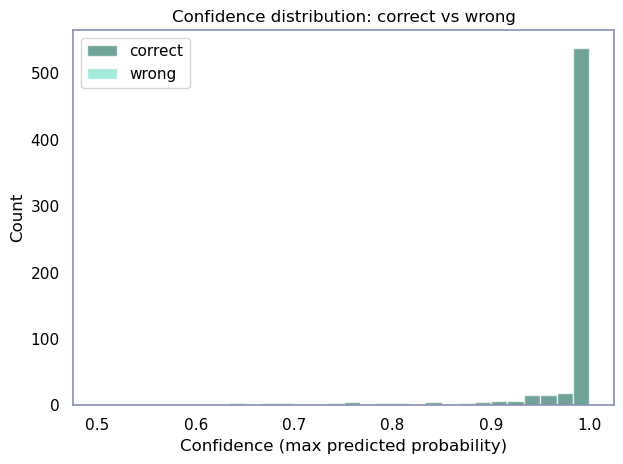

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2447095193.py:38: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



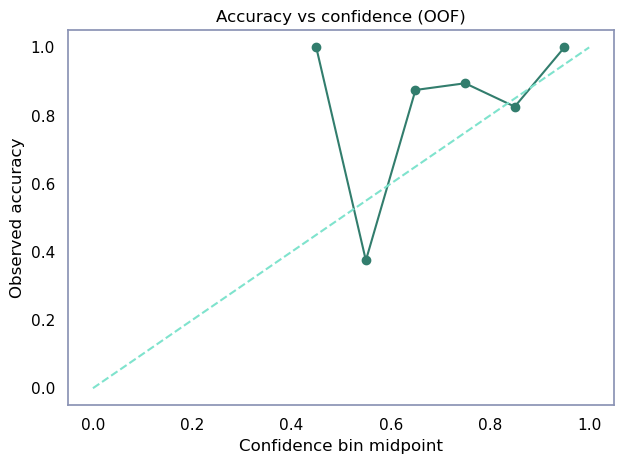

          bin  bin_mid  accuracy    n
0  (0.4, 0.5]     0.45  1.000000    1
1  (0.5, 0.6]     0.55  0.375000    8
2  (0.6, 0.7]     0.65  0.875000   16
3  (0.7, 0.8]     0.75  0.894737   19
4  (0.8, 0.9]     0.85  0.826087   23
5  (0.9, 1.0]     0.95  1.000000  598


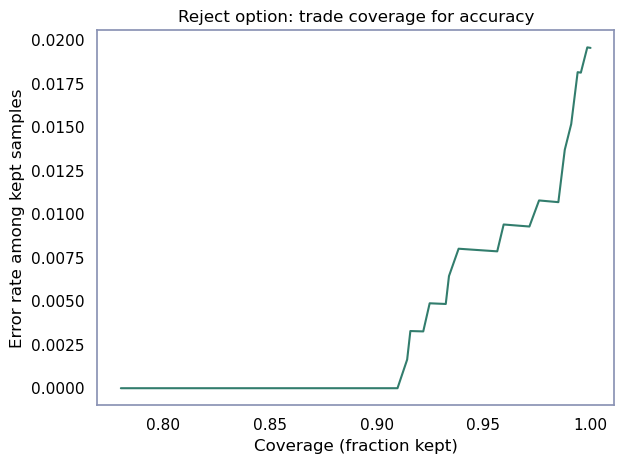

SVM results for modality: Cognition
     index  y_true  y_pred  confidence   entropy    margin
18      72       0       1    0.918201  0.283141  3.039758
85     438       0       1    0.974575  0.118462  4.201624
100    511       0       1    0.963261  0.157438  3.842384
176    229       1       0    0.909510  0.303669  1.062963
     index  y_true  y_pred  confidence   entropy    margin
527    636       0       1    0.500000  0.693147  0.979760
221    423       0       1    0.509060  0.692983  0.093965
448    286       1       1    0.516986  0.692570  0.924043
468    375       0       1    0.527903  0.691589  0.876387
517    592       1       1    0.527930  0.691586  0.876270
510    569       0       1    0.529241  0.691436  0.870540
351    451       0       1    0.532327  0.691056  0.308257
406     67       1       1    0.534488  0.690766  0.847576
46     184       1       1    0.552733  0.687575  0.555790
89     458       0       1    0.563831  0.684976  0.998159


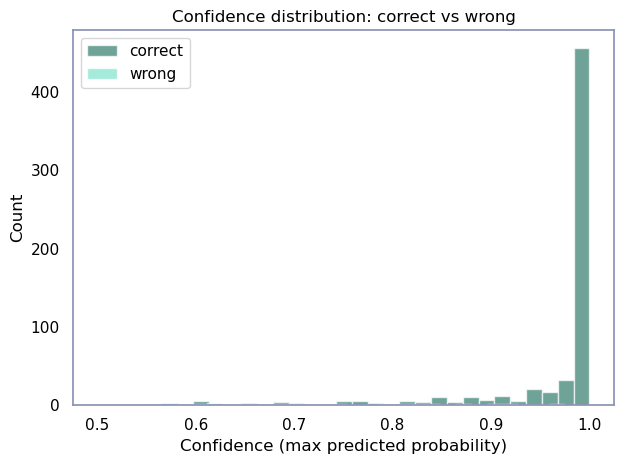

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2447095193.py:38: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



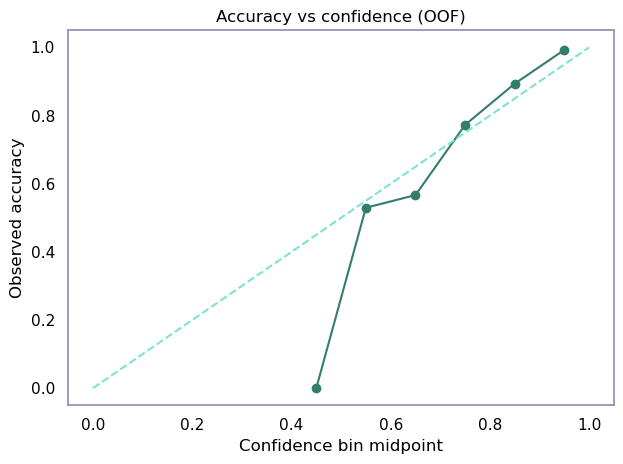

          bin  bin_mid  accuracy    n
0  (0.4, 0.5]     0.45  0.000000    1
1  (0.5, 0.6]     0.55  0.529412   17
2  (0.6, 0.7]     0.65  0.566667   30
3  (0.7, 0.8]     0.75  0.772727   22
4  (0.8, 0.9]     0.85  0.893617   47
5  (0.9, 1.0]     0.95  0.992701  548


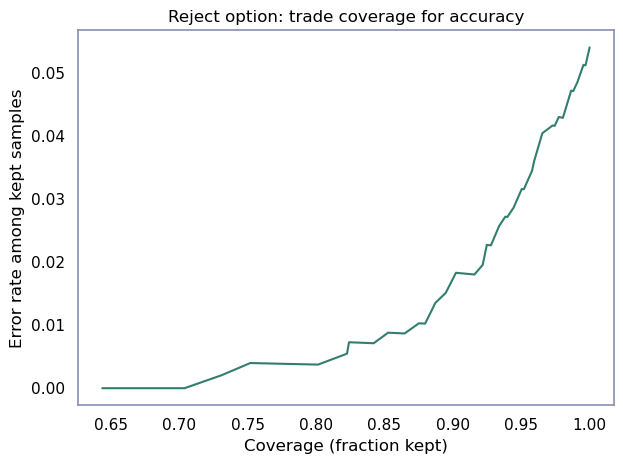

In [69]:
for mod_name, res in zip(modality_names, svm_results):
    print(f"SVM results for modality: {mod_name}")

    oof_uncertainty_mod = (res or {}).get("oof_uncertainty")

    # Find most confident mistakes 
    df = oof_uncertainty_mod

    df_bad = df[(df["y_true"] != df["y_pred"]) & (df["confidence"] > 0.9)]
    df_bad.sort_values("confidence", ascending=False).head(20)
    if df_bad is None or df_bad.empty:
        print(f"No confident mistakes found for modality {mod_name}.")
    else:
        print(df_bad)

    # Find most uncertain predictions
    df_uncertain = df.sort_values(["confidence", "entropy"], ascending=[True, False])
    print(df_uncertain.head(10))

    correct = df["y_true"] == df["y_pred"]

    plt.figure()
    plt.hist(df.loc[correct, "confidence"].dropna(), bins=30, alpha=0.7, label="correct")
    plt.hist(df.loc[~correct, "confidence"].dropna(), bins=30, alpha=0.7, label="wrong")
    plt.xlabel("Confidence (max predicted probability)")
    plt.ylabel("Count")
    plt.title("Confidence distribution: correct vs wrong")
    plt.legend()
    plt.tight_layout()
    plt.show()

    df2 = df.dropna(subset=["confidence"]).copy()
    bins = np.linspace(0, 1, 11)

    df2["bin"] = pd.cut(df2["confidence"], bins=bins, include_lowest=True)
    grp = df2.groupby("bin", observed=True)

    acc = grp.apply(lambda g: (g["y_true"] == g["y_pred"]).mean())
    cnt = grp.size()

    # Midpoints only for bins that exist
    x = np.array([interval.mid for interval in acc.index])

    plt.figure()
    plt.plot(x, acc.values, marker="o")
    plt.plot([0, 1], [0, 1], linestyle="--")
    plt.xlabel("Confidence bin midpoint")
    plt.ylabel("Observed accuracy")
    plt.title("Accuracy vs confidence (OOF)")
    plt.tight_layout()
    plt.show()

    print(pd.DataFrame({"bin": acc.index.astype(str), "bin_mid": x, "accuracy": acc.values, "n": cnt.values}))

    df2 = df.dropna(subset=["confidence"]).copy()
    df2["correct"] = (df2["y_true"] == df2["y_pred"]).astype(int)

    thresholds = np.linspace(0, 1, 101)
    coverage = []
    error_rate = []

    for t in thresholds:
        kept = df2[df2["confidence"] >= t]
        if len(kept) == 0:
            coverage.append(0.0)
            error_rate.append(np.nan)
            continue
        coverage.append(len(kept) / len(df2))
        error_rate.append(1 - kept["correct"].mean())

    plt.figure()
    plt.plot(coverage, error_rate)
    plt.xlabel("Coverage (fraction kept)")
    plt.ylabel("Error rate among kept samples")
    plt.title("Reject option: trade coverage for accuracy")
    plt.tight_layout()
    plt.show()




#### Variable contribution

SVM results for modality: Internalising
Model information: {'method': 'linear_coef', 'kernel': 'linear'}


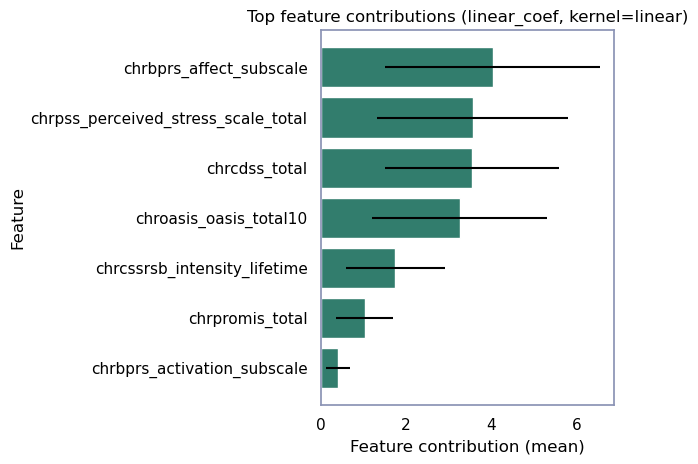

SVM results for modality: Functioning
Model information: {'method': 'linear_coef', 'kernel': 'linear'}


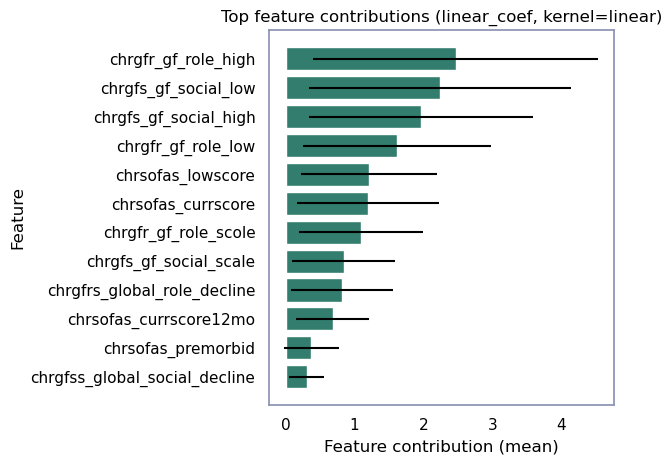

SVM results for modality: Detachment
Model information: {'method': 'permutation_importance', 'kernel': 'rbf'}


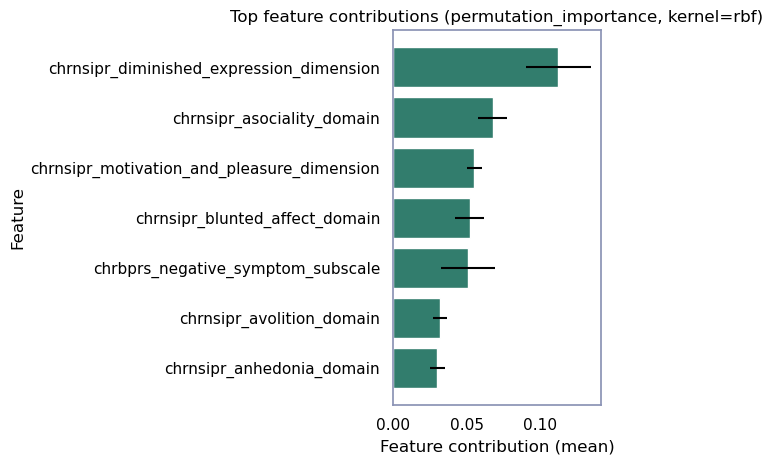

SVM results for modality: Psychoticism
Model information: {'method': 'linear_coef', 'kernel': 'linear'}


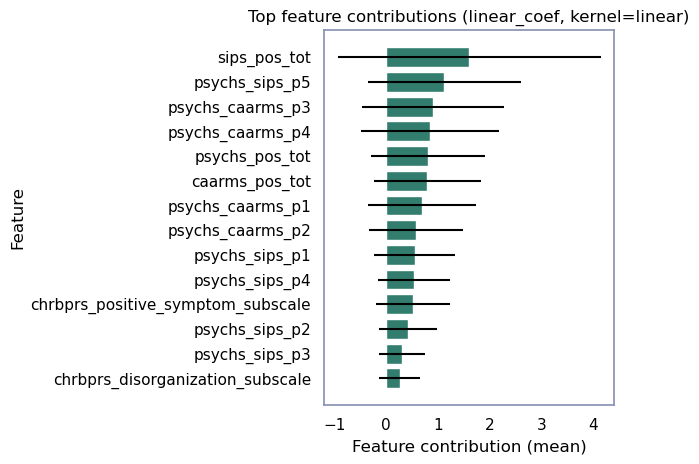

SVM results for modality: Cognition
Model information: {'method': 'linear_coef', 'kernel': 'linear'}


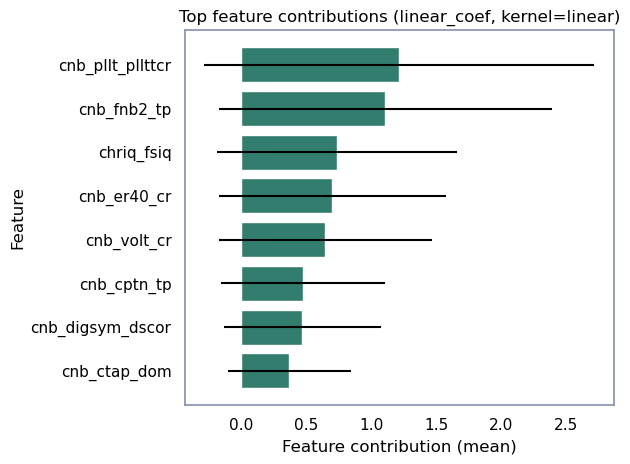

In [157]:
for mod_name, res in zip(modality_names, svm_results):
    print(f"SVM results for modality: {mod_name}")

    oof_uncertainty_mod = (res or {}).get("oof_uncertainty")
    feat_imp_mean = (res or {}).get("feature_importance_mean")
    feat_imp_std  = (res or {}).get("feature_importance_std")
    meta_svm = (res or {}).get("feature_importance_meta")       

    print(f"Model information: {meta_svm}")


    # If loaded from packed results (dict), convert to Series
    if isinstance(feat_imp_mean, dict):
        feat_imp_mean = pd.Series(feat_imp_mean, dtype=float)
    if isinstance(feat_imp_std, dict):
        feat_imp_std = pd.Series(feat_imp_std, dtype=float)

    # Build tidy table
    df_imp = (
        pd.DataFrame({
            "feature": feat_imp_mean.index,
            "importance_mean": feat_imp_mean.values,
            "importance_std": feat_imp_std.reindex(feat_imp_mean.index).values if feat_imp_std is not None else None,
        })
        .sort_values("importance_mean", ascending=False)
        .reset_index(drop=True)
    )

    top_n = 25
    plot_df = df_imp.head(top_n).iloc[::-1]  # reverse for nice ordering

    plt.figure()
    plt.barh(plot_df["feature"], plot_df["importance_mean"],
            xerr=plot_df["importance_std"] if "importance_std" in plot_df else None)
    plt.xlabel(f"Feature contribution (mean)")
    plt.ylabel("Feature")
    plt.title(f"Top feature contributions ({meta_svm.get('method','')}, kernel={meta_svm.get('kernel','')})")
    plt.tight_layout()
    plt.show()

    

# Apply to test set

## Prepare data

In [136]:
# Only keep relevant modalities
modalities_keep = ["Psychoticism", "Detachment", "Functioning", "Internalising", "Cognition"]

vars_to_keep = meta["ElementName"][meta["Modality"].isin(modalities_keep)].tolist()
# Filter the data if the columns are present in cleaned_discovery. Also include src_subject_id
vars_to_keep.append("src_subject_id")
vars_to_keep.append("phenotype")
cleaned_test = cleaned_test[cleaned_test.columns.intersection(vars_to_keep)]

## Apply SVM models

Get the test data

In [137]:
Test_df = pd.read_csv(
    "/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Data/cleaned_test_data.csv"
)

Apply preprocessing

In [138]:
def preprocessing(df,
                  meta,
                  subject_id_column='src_subject_id',
                  col_threshold=0.5, row_threshold=0.5,
                  skew_threshold=0.75,
                  scaler_type='robust',
                  modalities=['Internalising', 'Functioning', 'Cognition', 'Detachment', 'Psychoticism'],
                  impute_parea=False):
   """
    Preprocess the data by removing high missing data, applying power transformation, dummy coding, scaling, and imputing.
    
    Parameters:
    - df: DataFrame containing the data.
    - meta: Metadata DataFrame.
    - subject_id_column: Column name for subject IDs.
    - col_threshold: Threshold for column missing data.
    - row_threshold: Threshold for row missing data.
    - skew_threshold: Threshold for skewness in data.
    - scaler_type: Type of scaler to use ('robust' or 'standard').
    
    Returns:
    - dict_final: Dictionary containing processed modalities.
    """
   
   
   df_transformed = auto_power_transform(df, skew_threshold = skew_threshold) # Apply power transformation when data is skewed. 


   df_dummy = dummy_code(df_transformed)

   df_scaled = scale_diverse_data(df_dummy, subject_id_column=subject_id_column, scaler_type = scaler_type) # Scale data with robust scaler
   modal_dict = extract_modalities(meta, df_scaled) # Split data into modalities based on meta
   modal_dict_clean = {modality: modal_dict[modality] for modality in modalities if modality in modal_dict}



   # Reattach subject ID column to each modality so downstream steps include it
   for mod in modal_dict_clean:
       modal_dict_clean[mod][subject_id_column] = df_scaled[subject_id_column].loc[modal_dict_clean[mod].index]

   
   if impute_parea is False:
        # Identify any subjects who are entirely missing in any modality, then drop them from all modalities
        subjects_to_drop = set()
        for modality, df_mod in modal_dict_clean.items():
            # Exclude subject ID column when checking
            data_only = df_mod.drop(columns=[subject_id_column]) if subject_id_column in df_mod.columns else df_mod
            # Mask rows where all data columns are NaN
            missing_mask = data_only.isna().all(axis=1)
            if missing_mask.any():
                # Collect subject IDs to drop
                missing_ids = df_mod.loc[missing_mask, subject_id_column]
                subjects_to_drop.update(missing_ids.tolist())
        if subjects_to_drop:
            warnings.warn(
                f"Dropping {len(subjects_to_drop)} participants missing a full modality across all views: {subjects_to_drop}"
            )
            # Remove those subjects from every modality
            for modality in modal_dict_clean:
                df2 = modal_dict_clean[modality]
                modal_dict_clean[modality] = (
                    df2[~df2[subject_id_column].isin(subjects_to_drop)]
                    .reset_index(drop=True)
                )

   dict_imputed = impute_data(modal_dict_clean, subject_id_column=subject_id_column) # Impute missing data in each modality using KNN imputation
   dict_final = scale_data(dict_imputed, subject_id_column=subject_id_column, scaler_type=scaler_type) # Scale data in each modality with robust scaler
   
   # --- Canonical reindex across modalities ---
   id_col = subject_id_column
   mods = [m for m in modalities if m in dict_final]
   id_lists = {m: dict_final[m][id_col].tolist() for m in mods}
   # Sanity check: all views must have identical ID order after imputation and scaling
   # subjects present in all views
   shared = set.intersection(*(set(v) for v in id_lists.values()))
   # preserve order from the first modality in `modalities`
   canonical = [sid for sid in id_lists[mods[0]] if sid in shared]
   
   for m in mods:
       dfm = dict_final[m]
       dict_final[m] = (
           dfm[dfm[id_col].isin(shared)]
           .set_index(id_col)
           .loc[canonical]
           .reset_index()
       )

   # sanity: all views must now have identical ID order
   for m in mods[1:]:
    assert dict_final[m][id_col].tolist() == dict_final[mods[0]][id_col].tolist(), \
        f"Subject-ID order mismatch between {mods[0]} and {m}"

   
   # Build subject-ID list for each modality after imputation and scaling
   subject_id_list = []
   for mod in modalities:
       if mod in dict_final and subject_id_column in dict_final[mod]:
           subject_id_list.append(dict_final[mod][subject_id_column].tolist())
       else:
           subject_id_list.append([])
   ae_data = convert_data_for_vae(dict_final, subject_id_column=subject_id_column)

   return ae_data, subject_id_list, dict_final

In [139]:
from Scripts_full_pipeline.Utils import *
#from Scripts_full_pipeline.full_pipeline import preprocessing

# Set parameters
subject_id_column = 'src_subject_id'
col_threshold = 0.5
row_threshold = 0.5
skew_threshold = 0.75
scaler_type = 'robust'  # Options: 'standard', 'minmax', 'robust'
modalities = list(final_metrics["data"].keys())


In [140]:
ae_data, subject_id_list, dict_final = preprocessing(
    Test_df, meta,
    subject_id_column=subject_id_column,
    col_threshold=col_threshold,
    row_threshold=row_threshold,
    skew_threshold=skew_threshold,
    scaler_type=scaler_type,
    modalities=modalities
)

# Assert identical subject order across modalities after preprocessing
base_ids = dict_final[modalities[0]][subject_id_column].tolist()
for m in modalities[1:]:
    assert dict_final[m][subject_id_column].tolist() == base_ids, \
        f"Subject-ID order mismatch between {modalities[0]} and {m} after preprocessing"


# Build VAE-like output from the fully preprocessed & scaled per-modality dataframes
# Drop the subject ID column and convert to float32 arrays, preserving row order
subj_col = subject_id_column
ae_res = {}
for mod in modalities:
    df_mod = dict_final[mod]
    X = df_mod.drop(columns=[subj_col]) if subj_col in df_mod.columns else df_mod
    X = X.to_numpy(dtype=np.float32, copy=True)
    ae_res[mod] = {"final_latent": X}

X_test_list = []
for mod in modalities:
    df_mod = dict_final[mod]
    X_mod = df_mod.drop(columns=[subject_id_column], errors='ignore')
    X_test_list.append(X_mod.reset_index(drop=True))
X_test = pd.concat(X_test_list, axis=1)

Skipping modality 'Brain_injury' - No valid variables found in data.


/Users/jentemeijer/Library/CloudStorage/OneDrive-Personal/OneDrive/PhD/Code/MultiCluster/Scripts_full_pipeline/Utils.py:1988: UserWarning:

Dropping 82 participants missing a full modality across all views: {'LA09341', 'SI27497', 'SI44035', 'LA46385', 'KC44035', 'HA35728', 'BI42557', 'MT43021', 'YA52218', 'SF38115', 'PI41113', 'YA85770', 'MA31422', 'NL42349', 'SH12886', 'BI34174', 'LA75752', 'BI30617', 'LA17657', 'CM22411', 'WU63324', 'YA99991', 'YA09116', 'OR45299', 'SF59721', 'CM26340', 'SH20158', 'LA06072', 'YA09572', 'OR02778', 'YA25805', 'NN13465', 'NL39827', 'MU06978', 'LA51716', 'LA07509', 'LA74720', 'SF62798', 'YA42560', 'SF09932', 'MT41962', 'NL40763', 'WU32565', 'NC26157', 'SF03788', 'SD47687', 'SD50971', 'WU40382', 'MT26211', 'SF66249', 'SH06201', 'YA35286', 'YA37917', 'HA38669', 'YA97771', 'WU34757', 'UR18410', 'HA34435', 'SH02411', 'PA18500', 'SF59593', 'LA34845', 'BI19401', 'MT43671', 'BI44749', 'HA37148', 'NN36118', 'BI35251', 'PV49905', 'PV53732', 'NC18079', 'NL39100', 

Run model

In [141]:
svm_final = final_metrics['svm_final_model']
svm_modalities = final_metrics['svm_final_models_modalities']

Integrated clusters

In [142]:
import pandas as pd
import numpy as np

svm_final = final_metrics["svm_final_model"]

# IMPORTANT: align columns to training feature order
feat = final_metrics.get("svm_feature_names", None)
if feat is not None and isinstance(X_test, pd.DataFrame):
    X_test_aligned = X_test.reindex(columns=feat, fill_value=0.0)
else:
    X_test_aligned = X_test

y_pred, proba, confidence, entropy, margin = svm_predict_with_uncertainty(svm_final, X_test_aligned)

pred_final = pd.DataFrame({
    "y_pred": y_pred,
    "confidence": confidence,
    "entropy": entropy,
    "margin": margin,
})

# Optional: add per-class probabilities (nice for debugging)
if proba is not None:
    proba_df = pd.DataFrame(proba, columns=[f"p_{c}" for c in svm_final.classes_])
    pred_final = pd.concat([pred_final, proba_df], axis=1)

pred_final.head(10)

labels_test_final = pred_final["y_pred"].to_numpy()


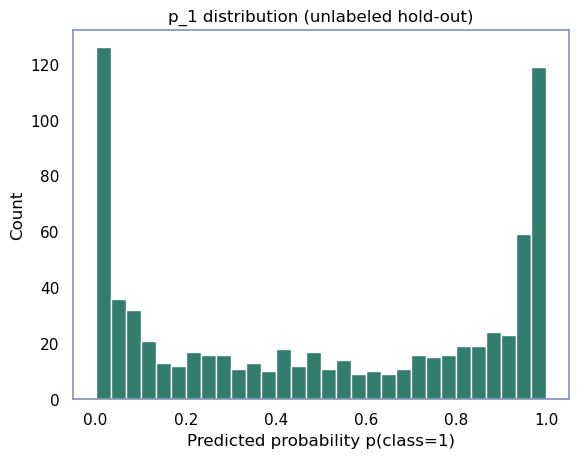

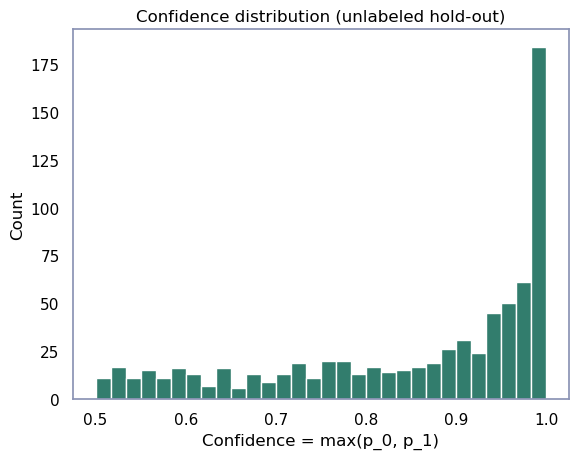

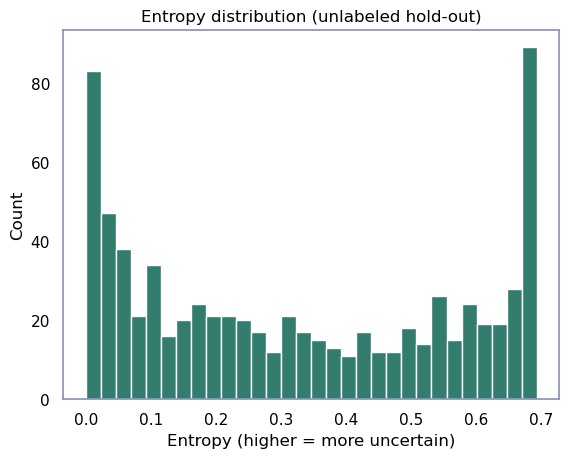

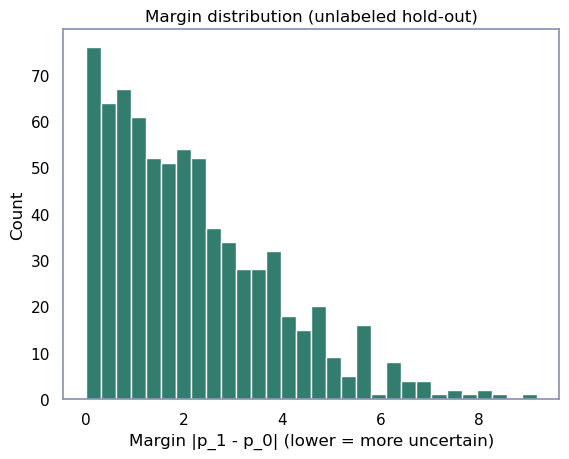

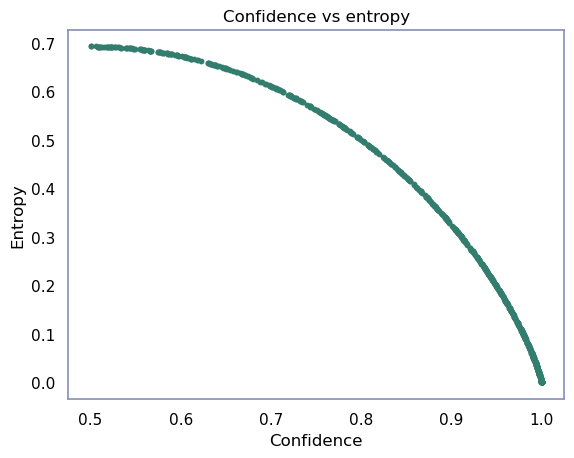

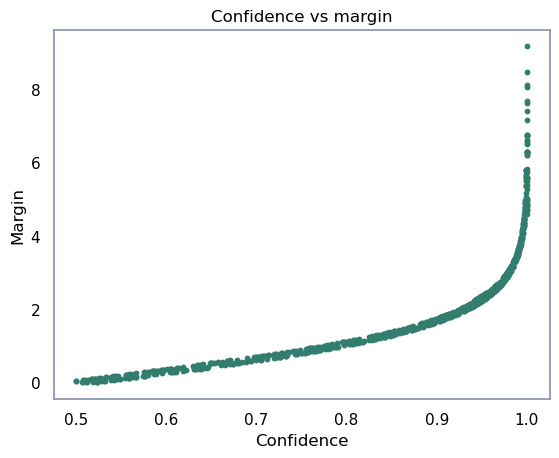


=== Summary (unlabeled) ===
N = 744
Confidence mean=0.852, median=0.913, min=0.500, max=1.000
Fraction with confidence ≥ 0.6: 0.891
Fraction with confidence ≥ 0.7: 0.805
Fraction with confidence ≥ 0.8: 0.676
Fraction with confidence ≥ 0.9: 0.531
Fraction with confidence ≥ 0.95: 0.397
Fraction with confidence ≥ 0.99: 0.200

Lowest confidence (top 10):


,y_pred,confidence,entropy,margin,p_0,p_1
689,0,0.500000,0.693147,0.058516,0.500000,0.500000
556,0,0.500000,0.693147,0.049377,0.500000,0.500000
564,0,0.506111,0.693072,0.025436,0.493889,0.506111
490,0,0.507729,0.693028,0.020412,0.492271,0.507729
499,0,0.507966,0.693020,0.069136,0.507966,0.492034
165,0,0.508633,0.692998,0.071209,0.508633,0.491367
541,0,0.510288,0.692935,0.076346,0.510288,0.489712
379,0,0.510576,0.692923,0.011573,0.489424,0.510576
436,0,0.511967,0.692861,0.007251,0.488033,0.511967
12,0,0.513368,0.692790,0.085915,0.513368,0.486632



Highest entropy (top 10):


,y_pred,confidence,entropy,margin,p_0,p_1
556,0,0.500000,0.693147,0.049377,0.500000,0.500000
689,0,0.500000,0.693147,0.058516,0.500000,0.500000
564,0,0.506111,0.693072,0.025436,0.493889,0.506111
490,0,0.507729,0.693028,0.020412,0.492271,0.507729
499,0,0.507966,0.693020,0.069136,0.507966,0.492034
165,0,0.508633,0.692998,0.071209,0.508633,0.491367
541,0,0.510288,0.692935,0.076346,0.510288,0.489712
379,0,0.510576,0.692923,0.011573,0.489424,0.510576
436,0,0.511967,0.692861,0.007251,0.488033,0.511967
12,0,0.513368,0.692790,0.085915,0.513368,0.486632



Lowest margin (top 10):


,y_pred,confidence,entropy,margin,p_0,p_1
436,0,0.511967,0.692861,0.007251,0.488033,0.511967
379,0,0.510576,0.692923,0.011573,0.489424,0.510576
132,1,0.519066,0.692420,0.014805,0.480934,0.519066
490,0,0.507729,0.693028,0.020412,0.492271,0.507729
564,0,0.506111,0.693072,0.025436,0.493889,0.506111
307,1,0.522785,0.692108,0.026367,0.477215,0.522785
347,1,0.523053,0.692084,0.027197,0.476947,0.523053
516,1,0.523212,0.692069,0.027694,0.476788,0.523212
219,1,0.527751,0.691606,0.041812,0.472249,0.527751
556,0,0.500000,0.693147,0.049377,0.500000,0.500000


In [143]:
import numpy as np
import matplotlib.pyplot as plt

# pred_final: DataFrame with columns
# ['y_pred', 'confidence', 'entropy', 'margin', 'p_0', 'p_1']

df = pred_final.copy()

# --- (Optional) sanity / recompute checks ---
# If you want to ensure these are consistent with p_0/p_1, uncomment:
# df["confidence_chk"] = np.maximum(df["p_0"], df["p_1"])
# df["margin_chk"] = np.abs(df["p_1"] - df["p_0"])
# eps = 1e-12
# df["entropy_chk"] = -(df["p_0"] * np.log(df["p_0"] + eps) + df["p_1"] * np.log(df["p_1"] + eps))

# --- 1) Histograms ---
plt.figure()
plt.hist(df["p_1"].astype(float), bins=30)
plt.xlabel("Predicted probability p(class=1)")
plt.ylabel("Count")
plt.title("p_1 distribution (unlabeled hold-out)")
plt.show()

plt.figure()
plt.hist(df["confidence"].astype(float), bins=30)
plt.xlabel("Confidence = max(p_0, p_1)")
plt.ylabel("Count")
plt.title("Confidence distribution (unlabeled hold-out)")
plt.show()

plt.figure()
plt.hist(df["entropy"].astype(float), bins=30)
plt.xlabel("Entropy (higher = more uncertain)")
plt.ylabel("Count")
plt.title("Entropy distribution (unlabeled hold-out)")
plt.show()

plt.figure()
plt.hist(df["margin"].astype(float), bins=30)
plt.xlabel("Margin |p_1 - p_0| (lower = more uncertain)")
plt.ylabel("Count")
plt.title("Margin distribution (unlabeled hold-out)")
plt.show()

# --- 2) Scatter plots ---
plt.figure()
plt.scatter(df["confidence"].astype(float), df["entropy"].astype(float), s=10)
plt.xlabel("Confidence")
plt.ylabel("Entropy")
plt.title("Confidence vs entropy")
plt.show()

plt.figure()
plt.scatter(df["confidence"].astype(float), df["margin"].astype(float), s=10)
plt.xlabel("Confidence")
plt.ylabel("Margin")
plt.title("Confidence vs margin")
plt.show()

# --- 3) Quick numeric summaries (handy for write-up) ---
conf = df["confidence"].astype(float).to_numpy()
print("\n=== Summary (unlabeled) ===")
print(f"N = {len(df)}")
print(f"Confidence mean={conf.mean():.3f}, median={np.median(conf):.3f}, min={conf.min():.3f}, max={conf.max():.3f}")
for thr in [0.6, 0.7, 0.8, 0.9, 0.95, 0.99]:
    print(f"Fraction with confidence ≥ {thr}: {(conf >= thr).mean():.3f}")

# --- 4) Show most-uncertain rows for manual inspection ---
# (lowest confidence, highest entropy, lowest margin)
print("\nLowest confidence (top 10):")
display(df.sort_values("confidence", ascending=True).head(10))

print("\nHighest entropy (top 10):")
display(df.sort_values("entropy", ascending=False).head(10))

print("\nLowest margin (top 10):")
display(df.sort_values("margin", ascending=True).head(10))

Individual modalities

In [144]:
svm_modalities = final_metrics["svm_final_models_modalities"]
subject_id_column = 'src_subject_id'  # or your local variable

pred_modalities = {}
labels_test_modalities = []

feat_mods = final_metrics.get("svm_feature_names_modalities", [None]*len(modalities))

for i, mod in enumerate(modalities):
    model_mod = svm_modalities[i]
    if model_mod is None:
        print(f"Skipping SVM prediction for modality {mod} due to lack of trained model.")
        pred_modalities[mod] = None
        continue

    df_mod = dict_final[mod]
    X_mod = df_mod.drop(columns=[subject_id_column], errors="ignore")

    # Align to training feature order for this modality model
    feat_i = feat_mods[i] if feat_mods is not None else None
    if feat_i is not None and isinstance(X_mod, pd.DataFrame):
        X_mod_aligned = X_mod.reindex(columns=feat_i, fill_value=0.0)
    else:
        X_mod_aligned = X_mod

    y_pred, proba, confidence, entropy, margin = svm_predict_with_uncertainty(model_mod, X_mod_aligned)

    out = pd.DataFrame({
        "y_pred": y_pred,
        "confidence": confidence,
        "entropy": entropy,
        "margin": margin,
    })

    if proba is not None:
        proba_df = pd.DataFrame(proba, columns=[f"p_{c}" for c in model_mod.classes_])
        out = pd.concat([out, proba_df], axis=1)

    pred_modalities[mod] = out

    labels_test_modalities.append(y_pred)


In [145]:
pred_modalities

{'Internalising':      y_pred  confidence       entropy     margin           p_0           p_1
 0         1    1.000000  2.766111e-11  23.491070  3.000001e-14  1.000000e+00
 1         1    1.000000  1.105776e-10  13.603315  4.060936e-12  1.000000e+00
 2         1    1.000000  2.766111e-11  27.854783  3.000001e-14  1.000000e+00
 3         1    1.000000  2.827173e-11  14.527091  6.407573e-13  1.000000e+00
 4         1    0.860649  4.037838e-01   1.752146  1.393511e-01  8.606489e-01
 ..      ...         ...           ...        ...           ...           ...
 739       0    1.000000  1.711810e-06  31.952424  9.999999e-01  1.000000e-07
 740       0    1.000000  3.270836e-06  15.506648  9.999998e-01  1.990825e-07
 741       0    1.000000  1.711810e-06  31.769002  9.999999e-01  1.000000e-07
 742       0    0.999288  5.869775e-03   7.320362  9.992883e-01  7.117043e-04
 743       1    0.999995  6.247920e-05   6.618154  4.709771e-06  9.999953e-01
 
 [744 rows x 6 columns],
 'Functioning':     



=== Diagnostics for modality: Internalising ===


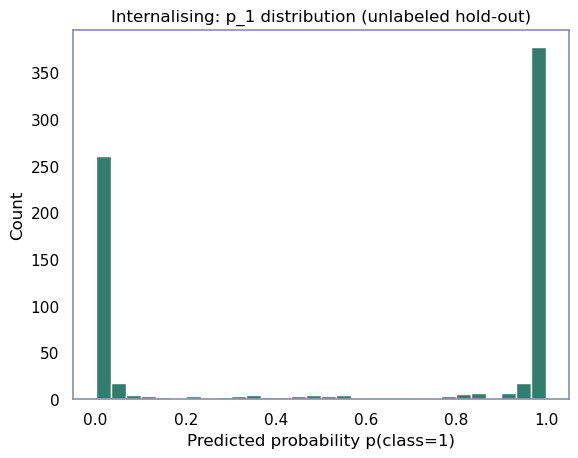

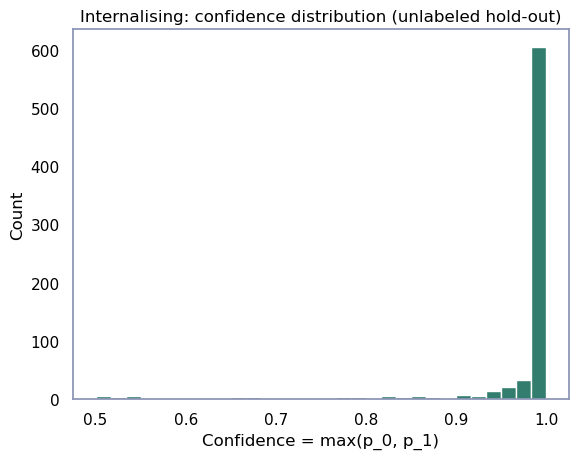

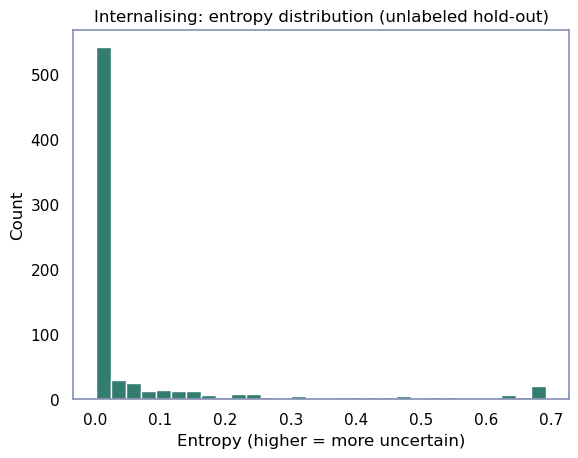

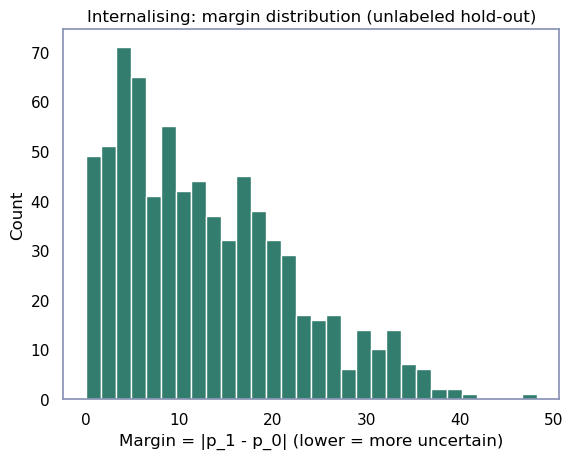

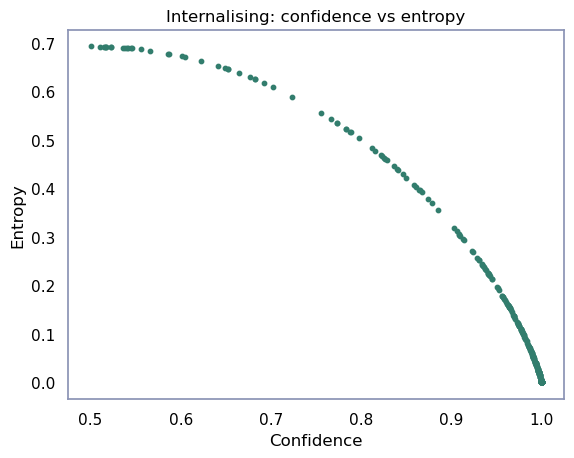

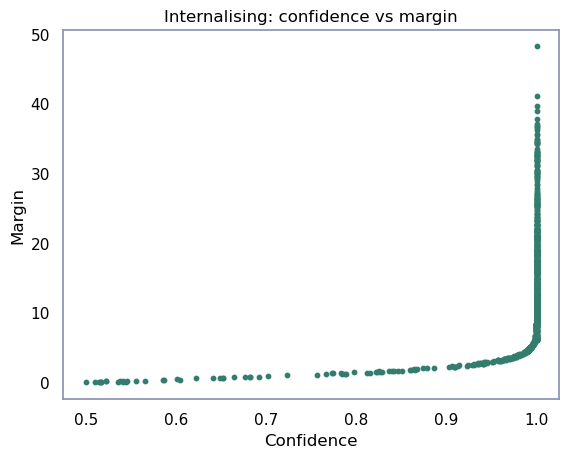


=== Internalising: most uncertain examples ===

Lowest confidence:


,y_pred,confidence,entropy,margin,p_0,p_1
176,0,0.500000,0.693147,0.079908,0.500000,0.500000
88,0,0.510682,0.692919,0.025697,0.489318,0.510682
625,0,0.514757,0.692712,0.009376,0.485243,0.514757
49,0,0.515576,0.692662,0.130816,0.515576,0.484424
79,0,0.516509,0.692602,0.134555,0.516509,0.483491
670,1,0.517174,0.692557,0.000303,0.482826,0.517174
240,0,0.522371,0.692146,0.158056,0.522371,0.477629
402,0,0.522512,0.692133,0.158622,0.522512,0.477488
117,1,0.535629,0.690606,0.074327,0.464371,0.535629
22,0,0.538400,0.690195,0.222508,0.538400,0.461600



Lowest margin:


,y_pred,confidence,entropy,margin,p_0,p_1
670,1,0.517174,0.692557,0.000303,0.482826,0.517174
625,0,0.514757,0.692712,0.009376,0.485243,0.514757
88,0,0.510682,0.692919,0.025697,0.489318,0.510682
117,1,0.535629,0.690606,0.074327,0.464371,0.535629
176,0,0.500000,0.693147,0.079908,0.500000,0.500000
71,1,0.541219,0.689745,0.096792,0.458781,0.541219
67,1,0.544714,0.689143,0.110843,0.455286,0.544714
49,0,0.515576,0.692662,0.130816,0.515576,0.484424
79,0,0.516509,0.692602,0.134555,0.516509,0.483491
105,1,0.555320,0.687014,0.153535,0.444680,0.555320



Highest entropy:


,y_pred,confidence,entropy,margin,p_0,p_1
176,0,0.500000,0.693147,0.079908,0.500000,0.500000
88,0,0.510682,0.692919,0.025697,0.489318,0.510682
625,0,0.514757,0.692712,0.009376,0.485243,0.514757
49,0,0.515576,0.692662,0.130816,0.515576,0.484424
79,0,0.516509,0.692602,0.134555,0.516509,0.483491
670,1,0.517174,0.692557,0.000303,0.482826,0.517174
240,0,0.522371,0.692146,0.158056,0.522371,0.477629
402,0,0.522512,0.692133,0.158622,0.522512,0.477488
117,1,0.535629,0.690606,0.074327,0.464371,0.535629
22,0,0.538400,0.690195,0.222508,0.538400,0.461600




=== Diagnostics for modality: Functioning ===


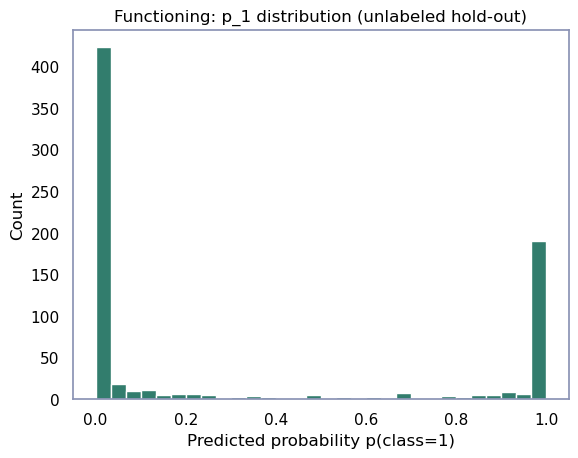

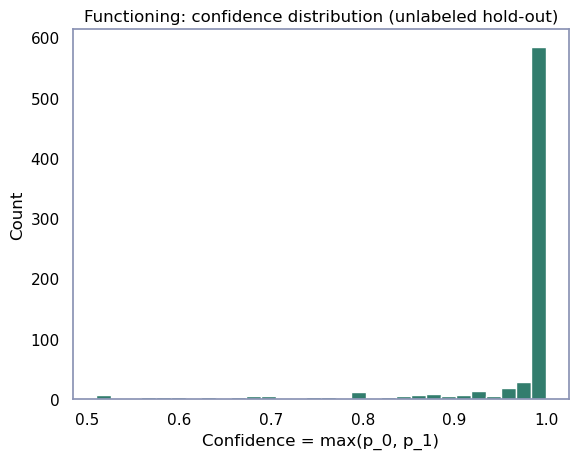

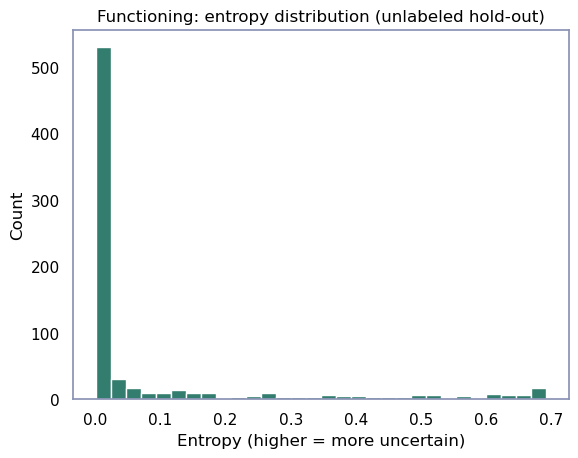

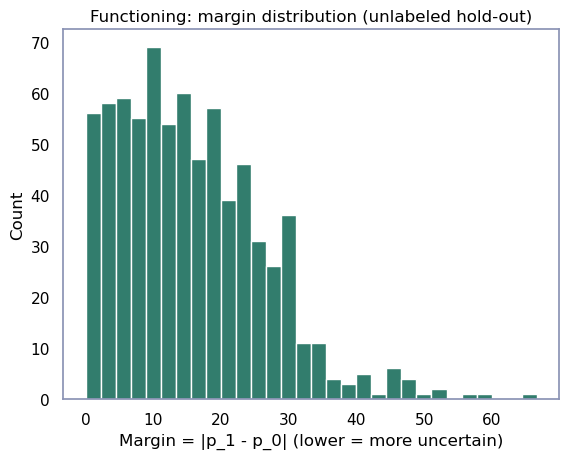

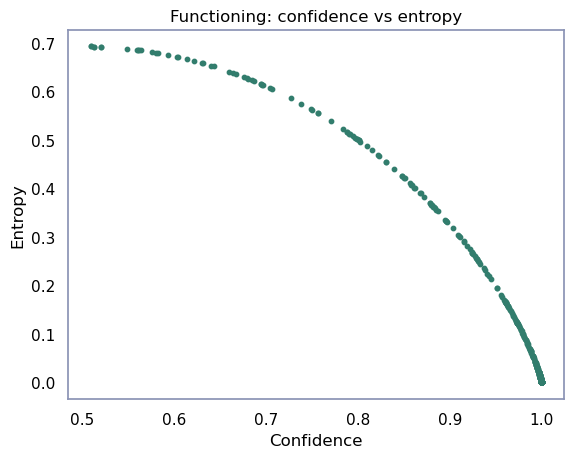

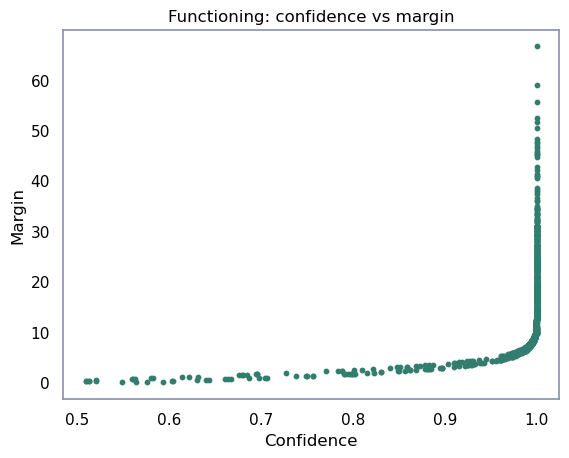


=== Functioning: most uncertain examples ===

Lowest confidence:


,y_pred,confidence,entropy,margin,p_0,p_1
189,1,0.508916,0.692988,0.328174,0.508916,0.491084
171,1,0.509516,0.692966,0.324533,0.509516,0.490484
727,1,0.512014,0.692858,0.309371,0.512014,0.487986
315,1,0.512814,0.692819,0.304510,0.512814,0.487186
533,1,0.520226,0.692329,0.259483,0.520226,0.479774
257,1,0.520441,0.692311,0.506375,0.479559,0.520441
682,1,0.548270,0.688480,0.088238,0.548270,0.451730
213,1,0.559343,0.686087,0.743410,0.440657,0.559343
176,1,0.560613,0.685781,0.751166,0.439387,0.560613
95,1,0.562088,0.685417,0.760182,0.437912,0.562088



Lowest margin:


,y_pred,confidence,entropy,margin,p_0,p_1
103,0,0.564112,0.684904,0.009596,0.564112,0.435888
424,0,0.576072,0.681528,0.084276,0.576072,0.423928
682,1,0.548270,0.688480,0.088238,0.548270,0.451730
538,0,0.592949,0.675767,0.191231,0.592949,0.407051
125,0,0.602864,0.671833,0.255106,0.602864,0.397136
533,1,0.520226,0.692329,0.259483,0.520226,0.479774
375,0,0.603683,0.671490,0.260427,0.603683,0.396317
315,1,0.512814,0.692819,0.304510,0.512814,0.487186
727,1,0.512014,0.692858,0.309371,0.512014,0.487986
171,1,0.509516,0.692966,0.324533,0.509516,0.490484



Highest entropy:


,y_pred,confidence,entropy,margin,p_0,p_1
189,1,0.508916,0.692988,0.328174,0.508916,0.491084
171,1,0.509516,0.692966,0.324533,0.509516,0.490484
727,1,0.512014,0.692858,0.309371,0.512014,0.487986
315,1,0.512814,0.692819,0.304510,0.512814,0.487186
533,1,0.520226,0.692329,0.259483,0.520226,0.479774
257,1,0.520441,0.692311,0.506375,0.479559,0.520441
682,1,0.548270,0.688480,0.088238,0.548270,0.451730
213,1,0.559343,0.686087,0.743410,0.440657,0.559343
176,1,0.560613,0.685781,0.751166,0.439387,0.560613
95,1,0.562088,0.685417,0.760182,0.437912,0.562088




=== Diagnostics for modality: Detachment ===


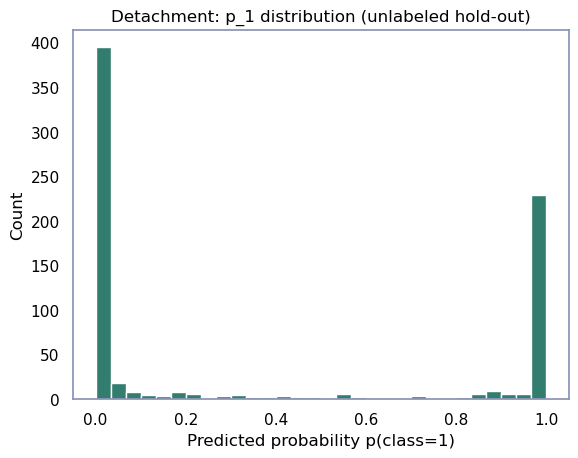

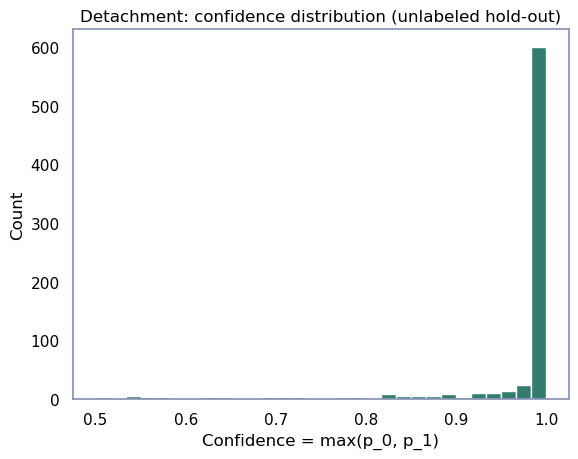

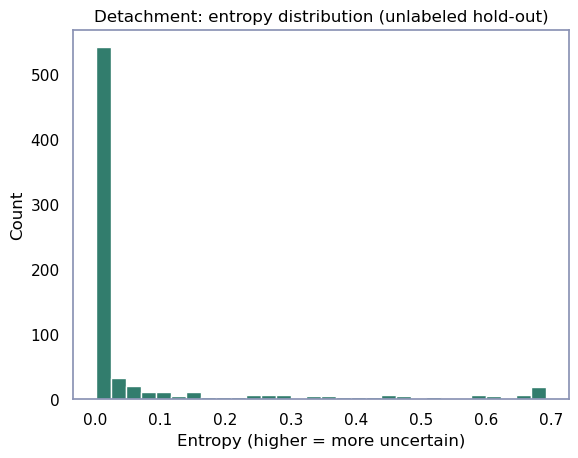

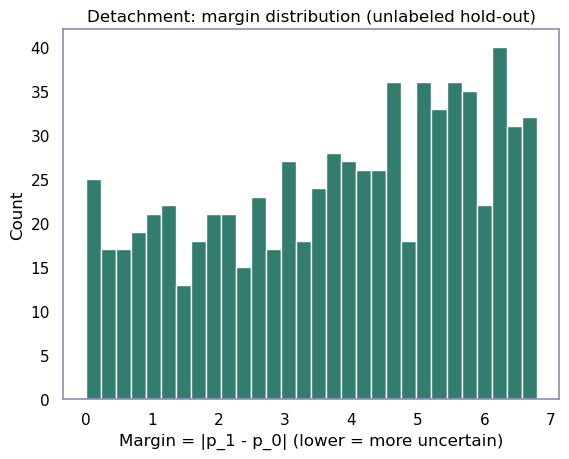

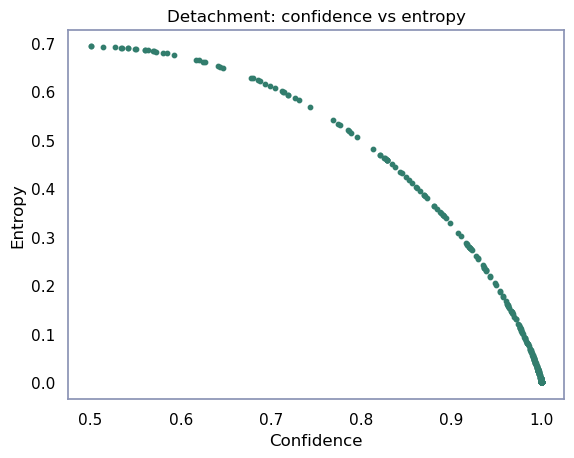

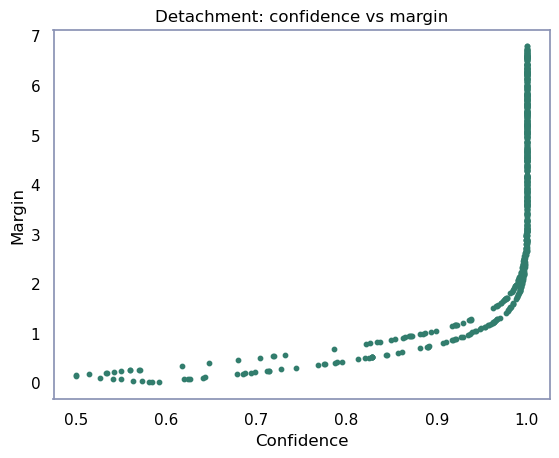


=== Detachment: most uncertain examples ===

Lowest confidence:


,y_pred,confidence,entropy,margin,p_0,p_1
51,1,0.500000,0.693147,0.141583,0.500000,0.500000
231,1,0.500000,0.693147,0.144338,0.500000,0.500000
346,1,0.514070,0.692751,0.166923,0.485930,0.514070
470,1,0.527098,0.691678,0.098452,0.527098,0.472902
627,1,0.533518,0.690899,0.199302,0.466482,0.533518
59,1,0.534428,0.690775,0.200818,0.465572,0.534428
628,1,0.540968,0.689787,0.075268,0.540968,0.459032
450,1,0.541728,0.689661,0.212998,0.458272,0.541728
670,1,0.549445,0.688250,0.061027,0.549445,0.450555
282,1,0.550127,0.688113,0.227026,0.449873,0.550127



Lowest margin:


,y_pred,confidence,entropy,margin,p_0,p_1
647,1,0.584434,0.678821,0.001315,0.584434,0.415566
143,1,0.580420,0.680156,0.008265,0.580420,0.419580
133,0,0.592367,0.675986,0.012514,0.592367,0.407633
681,1,0.572870,0.682489,0.021255,0.572870,0.427130
609,1,0.563290,0.685114,0.037608,0.563290,0.436710
670,1,0.549445,0.688250,0.061027,0.549445,0.450555
600,0,0.619771,0.664176,0.061446,0.619771,0.380229
374,0,0.624118,0.662012,0.069399,0.624118,0.375882
147,0,0.626859,0.660606,0.074446,0.626859,0.373141
628,1,0.540968,0.689787,0.075268,0.540968,0.459032



Highest entropy:


,y_pred,confidence,entropy,margin,p_0,p_1
51,1,0.500000,0.693147,0.141583,0.500000,0.500000
231,1,0.500000,0.693147,0.144338,0.500000,0.500000
346,1,0.514070,0.692751,0.166923,0.485930,0.514070
470,1,0.527098,0.691678,0.098452,0.527098,0.472902
627,1,0.533518,0.690899,0.199302,0.466482,0.533518
59,1,0.534428,0.690775,0.200818,0.465572,0.534428
628,1,0.540968,0.689787,0.075268,0.540968,0.459032
450,1,0.541728,0.689661,0.212998,0.458272,0.541728
670,1,0.549445,0.688250,0.061027,0.549445,0.450555
282,1,0.550127,0.688113,0.227026,0.449873,0.550127




=== Diagnostics for modality: Psychoticism ===


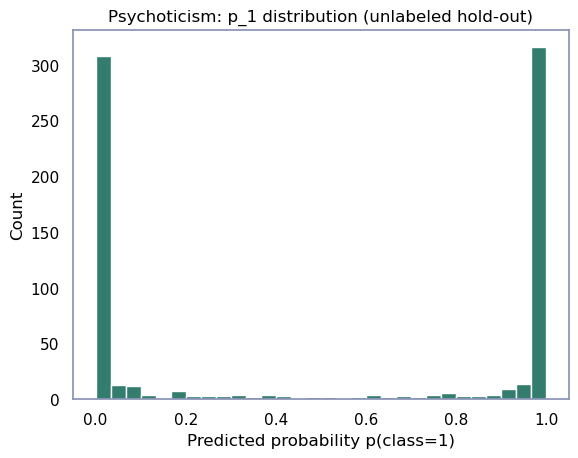

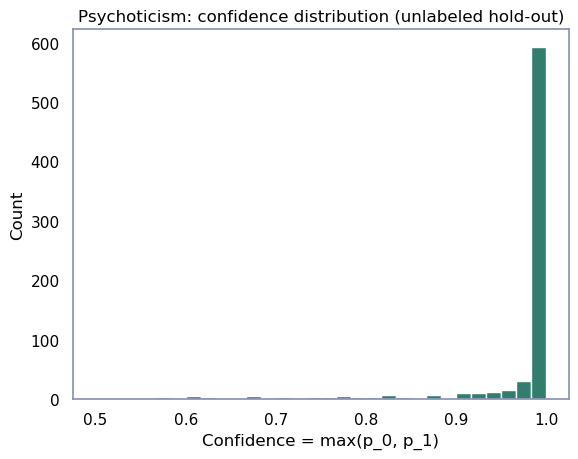

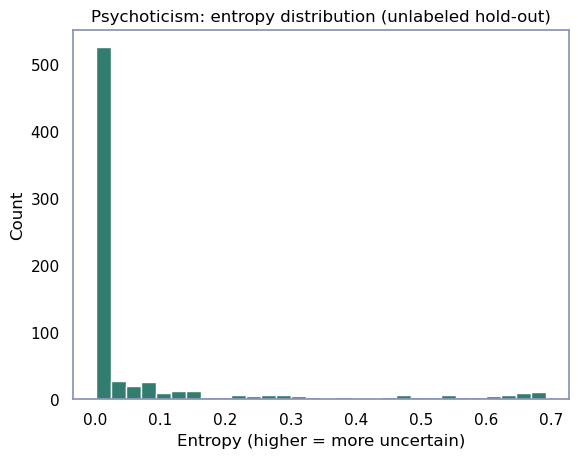

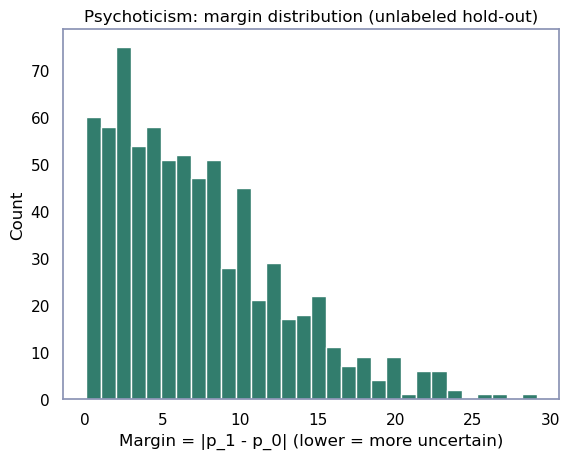

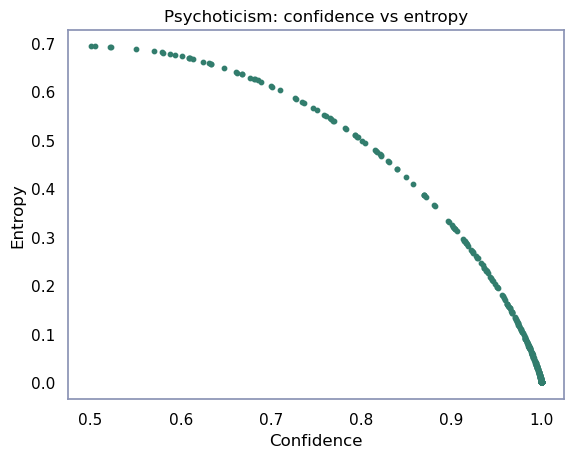

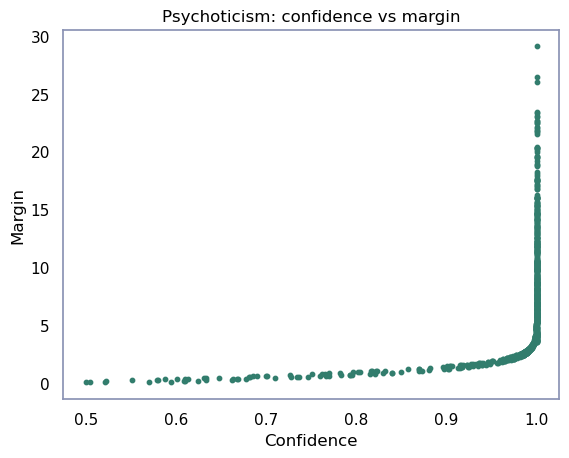


=== Psychoticism: most uncertain examples ===

Lowest confidence:


,y_pred,confidence,entropy,margin,p_0,p_1
593,0,0.500000,0.693147,0.099836,0.500000,0.500000
556,0,0.505068,0.693096,0.089188,0.494932,0.505068
269,0,0.521818,0.692195,0.048785,0.478182,0.521818
584,0,0.521992,0.692180,0.154452,0.521992,0.478008
366,0,0.550725,0.687992,0.224208,0.550725,0.449275
49,1,0.570059,0.683298,0.068073,0.429941,0.570059
473,0,0.578704,0.680707,0.293316,0.578704,0.421296
105,0,0.579965,0.680303,0.296472,0.579965,0.420035
465,0,0.588241,0.677492,0.317296,0.588241,0.411759
386,1,0.594012,0.675365,0.126246,0.405988,0.594012



Lowest margin:


,y_pred,confidence,entropy,margin,p_0,p_1
269,0,0.521818,0.692195,0.048785,0.478182,0.521818
49,1,0.570059,0.683298,0.068073,0.429941,0.570059
556,0,0.505068,0.693096,0.089188,0.494932,0.505068
593,0,0.500000,0.693147,0.099836,0.500000,0.500000
386,1,0.594012,0.675365,0.126246,0.405988,0.594012
584,0,0.521992,0.692180,0.154452,0.521992,0.478008
292,1,0.608784,0.669289,0.162049,0.391216,0.608784
439,1,0.609511,0.668966,0.163808,0.390489,0.609511
275,1,0.624325,0.661907,0.199563,0.375675,0.624325
535,1,0.633031,0.657323,0.220487,0.366969,0.633031



Highest entropy:


,y_pred,confidence,entropy,margin,p_0,p_1
593,0,0.500000,0.693147,0.099836,0.500000,0.500000
556,0,0.505068,0.693096,0.089188,0.494932,0.505068
269,0,0.521818,0.692195,0.048785,0.478182,0.521818
584,0,0.521992,0.692180,0.154452,0.521992,0.478008
366,0,0.550725,0.687992,0.224208,0.550725,0.449275
49,1,0.570059,0.683298,0.068073,0.429941,0.570059
473,0,0.578704,0.680707,0.293316,0.578704,0.421296
105,0,0.579965,0.680303,0.296472,0.579965,0.420035
465,0,0.588241,0.677492,0.317296,0.588241,0.411759
386,1,0.594012,0.675365,0.126246,0.405988,0.594012




=== Diagnostics for modality: Cognition ===


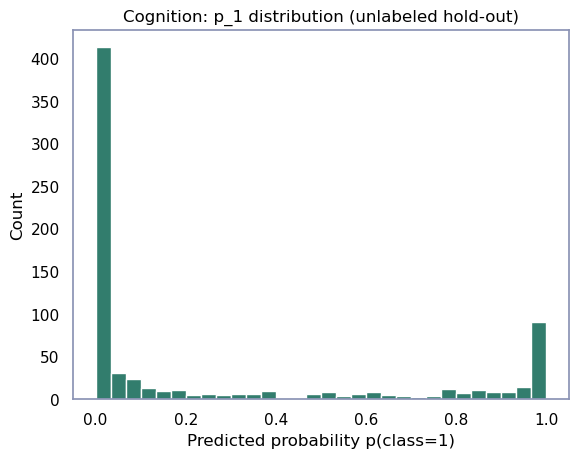

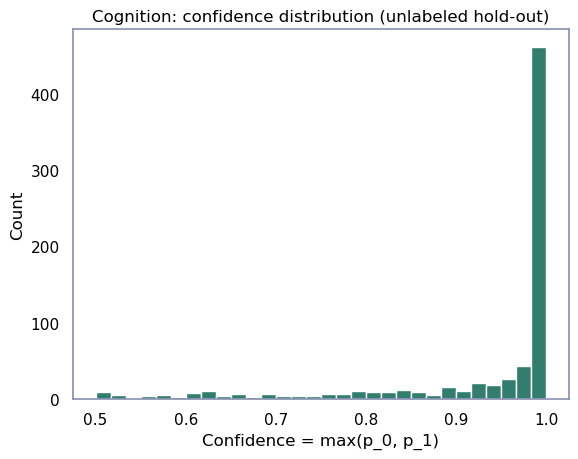

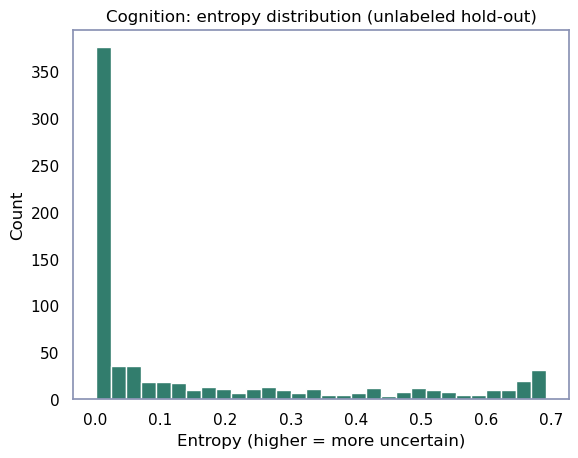

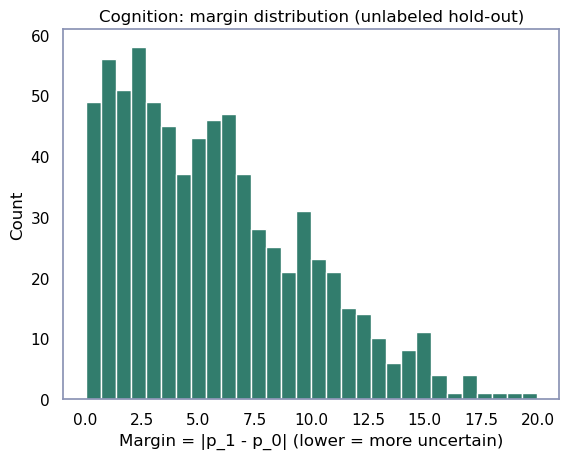

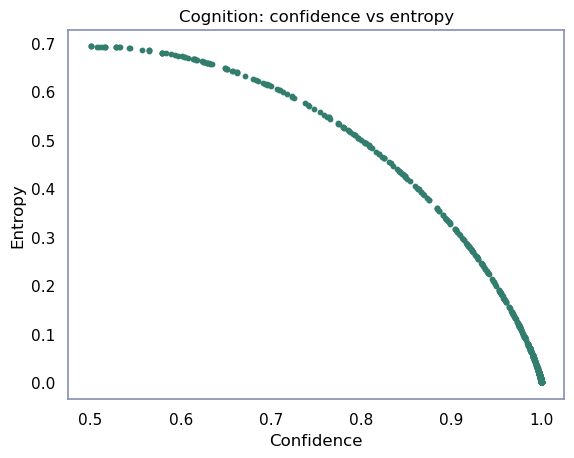

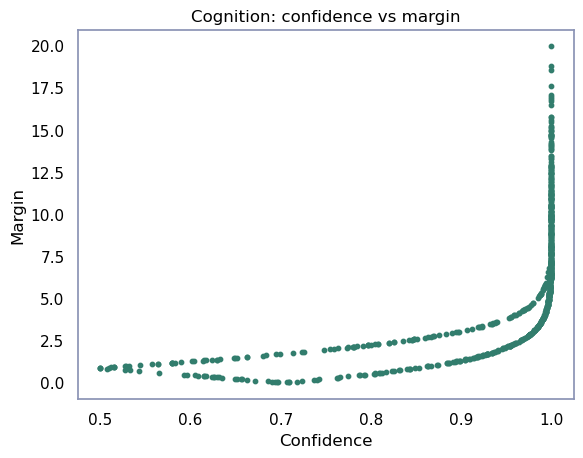


=== Cognition: most uncertain examples ===

Lowest confidence:


,y_pred,confidence,entropy,margin,p_0,p_1
260,1,0.500000,0.693147,0.854528,0.500000,0.500000
607,1,0.500000,0.693147,0.866325,0.500000,0.500000
597,1,0.500000,0.693147,0.863427,0.500000,0.500000
411,1,0.507505,0.693035,0.831622,0.507505,0.492495
391,1,0.509185,0.692978,0.898237,0.490815,0.509185
701,1,0.512082,0.692855,0.909801,0.487918,0.512082
187,1,0.515464,0.692669,0.923308,0.484536,0.515464
655,1,0.515464,0.692669,0.923308,0.484536,0.515464
133,1,0.515464,0.692669,0.923308,0.484536,0.515464
20,1,0.527572,0.691626,0.971702,0.472428,0.527572



Lowest margin:


,y_pred,confidence,entropy,margin,p_0,p_1
548,0,0.707169,0.604667,0.018071,0.707169,0.292831
171,0,0.709332,0.602749,0.028515,0.709332,0.290668
575,0,0.709431,0.602661,0.028992,0.709431,0.290569
185,1,0.697206,0.613213,0.029463,0.697206,0.302794
545,1,0.695751,0.614421,0.036331,0.695751,0.304249
202,1,0.693770,0.616051,0.045650,0.693770,0.306230
660,1,0.690660,0.618572,0.060218,0.690660,0.309340
454,0,0.717572,0.595232,0.068731,0.717572,0.282428
219,1,0.685814,0.622409,0.082747,0.685814,0.314186
164,0,0.723210,0.589896,0.096656,0.723210,0.276790



Highest entropy:


,y_pred,confidence,entropy,margin,p_0,p_1
597,1,0.500000,0.693147,0.863427,0.500000,0.500000
607,1,0.500000,0.693147,0.866325,0.500000,0.500000
260,1,0.500000,0.693147,0.854528,0.500000,0.500000
411,1,0.507505,0.693035,0.831622,0.507505,0.492495
391,1,0.509185,0.692978,0.898237,0.490815,0.509185
701,1,0.512082,0.692855,0.909801,0.487918,0.512082
187,1,0.515464,0.692669,0.923308,0.484536,0.515464
133,1,0.515464,0.692669,0.923308,0.484536,0.515464
655,1,0.515464,0.692669,0.923308,0.484536,0.515464
20,1,0.527572,0.691626,0.971702,0.472428,0.527572


In [158]:
import numpy as np
import matplotlib.pyplot as plt

def plot_pred_modality(df, name):
    """
    Plots confidence/uncertainty diagnostics for a single modality DataFrame.
    Expected columns (any subset is ok): p_0, p_1, confidence, entropy, margin
    """
    cols = set(df.columns)

    # Compute missing fields if probabilities exist
    if {"p_0", "p_1"}.issubset(cols):
        p0 = df["p_0"].astype(float).to_numpy()
        p1 = df["p_1"].astype(float).to_numpy()

        if "confidence" not in cols:
            df = df.copy()
            df["confidence"] = np.maximum(p0, p1)

        if "margin" not in cols:
            df = df.copy()
            df["margin"] = np.abs(p1 - p0)

        if "entropy" not in cols:
            df = df.copy()
            eps = 1e-12
            df["entropy"] = -(p0 * np.log(p0 + eps) + p1 * np.log(p1 + eps))

    # Helper to plot a histogram if column exists
    def hist_if_exists(col, bins=30, xlabel=None):
        if col in df.columns:
            plt.figure()
            plt.hist(df[col].dropna().astype(float), bins=bins)
            plt.xlabel(xlabel or col)
            plt.ylabel("Count")
            plt.title(f"{name}: {col} distribution (unlabeled hold-out)")
            plt.show()

    # 1) Histograms
    hist_if_exists("p_1", xlabel="Predicted probability p(class=1)")
    hist_if_exists("confidence", xlabel="Confidence = max(p_0, p_1)")
    hist_if_exists("entropy", xlabel="Entropy (higher = more uncertain)")
    hist_if_exists("margin", xlabel="Margin = |p_1 - p_0| (lower = more uncertain)")

    # 2) Scatter plots that are often informative
    if ("confidence" in df.columns) and ("entropy" in df.columns):
        plt.figure()
        plt.scatter(df["confidence"].astype(float), df["entropy"].astype(float), s=10)
        plt.xlabel("Confidence")
        plt.ylabel("Entropy")
        plt.title(f"{name}: confidence vs entropy")
        plt.show()

    if ("confidence" in df.columns) and ("margin" in df.columns):
        plt.figure()
        plt.scatter(df["confidence"].astype(float), df["margin"].astype(float), s=10)
        plt.xlabel("Confidence")
        plt.ylabel("Margin")
        plt.title(f"{name}: confidence vs margin")
        plt.show()

    # 3) Print “most uncertain” cases (lowest confidence / lowest margin / highest entropy)
    # (useful for manual review)
    print(f"\n=== {name}: most uncertain examples ===")

    if "confidence" in df.columns:
        print("\nLowest confidence:")
        display(df.sort_values("confidence", ascending=True).head(10))

    if "margin" in df.columns:
        print("\nLowest margin:")
        display(df.sort_values("margin", ascending=True).head(10))

    if "entropy" in df.columns:
        print("\nHighest entropy:")
        display(df.sort_values("entropy", ascending=False).head(10))


# ---- Run for your pred_modalities dict ----
for modality_name, modality_df in pred_modalities.items():
    print(f"\n\n=== Diagnostics for modality: {modality_name} ===")
    plot_pred_modality(modality_df, modality_name)

## Visualise test labels

### Differences in original variables - individual labels


=== Modality: Internalising ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: UserWarning:

The palette list has more values (10) than needed (7), which may not be intended.



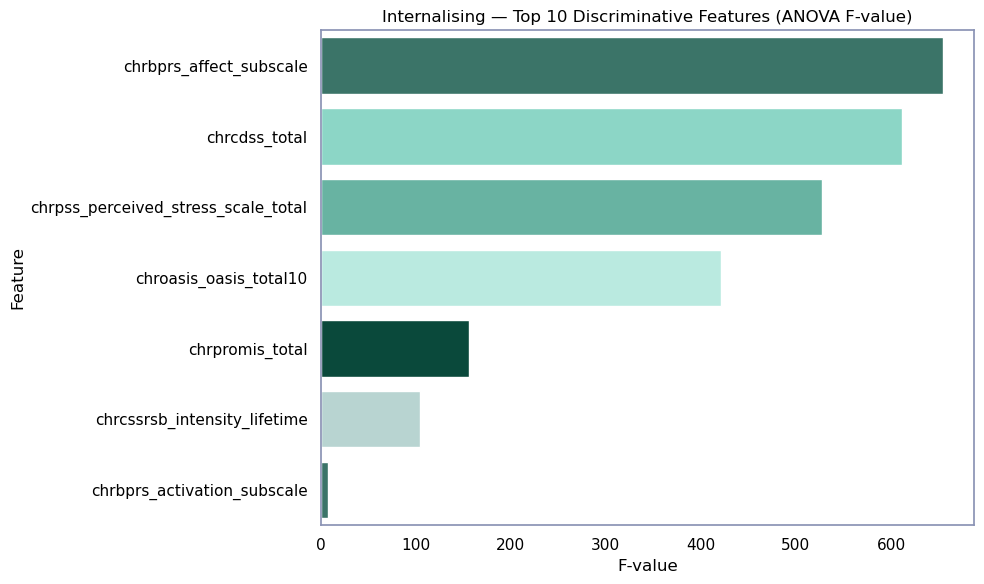

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

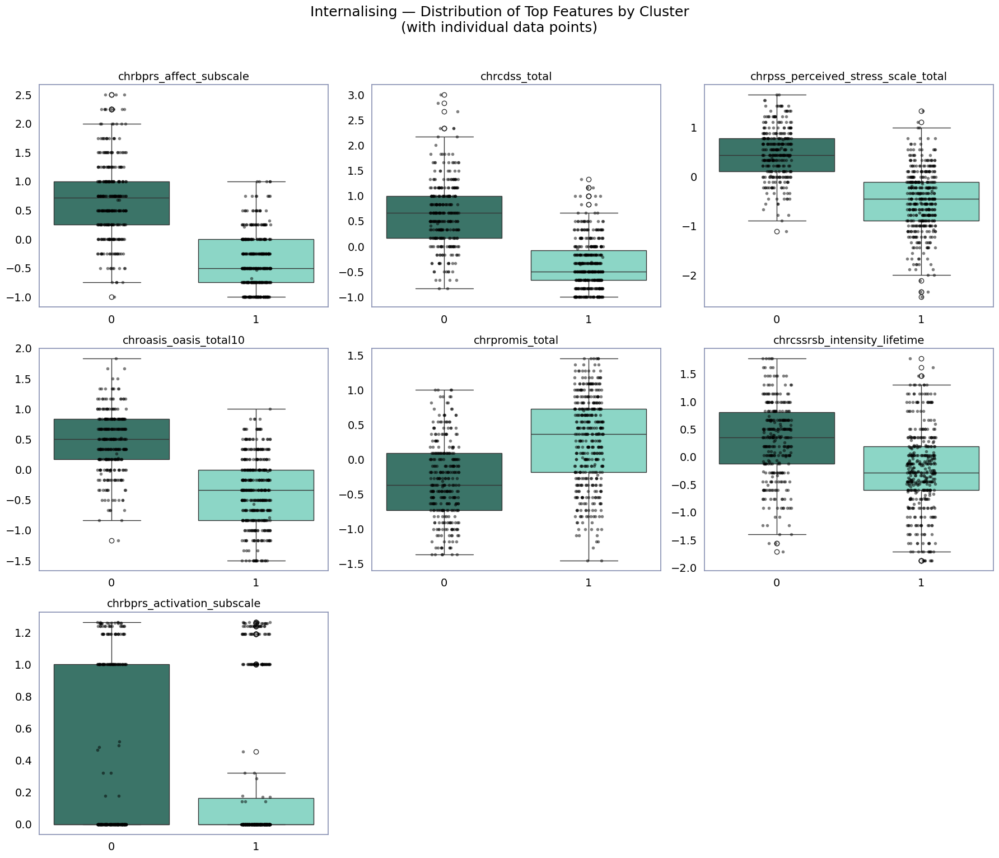


=== Modality: Functioning ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




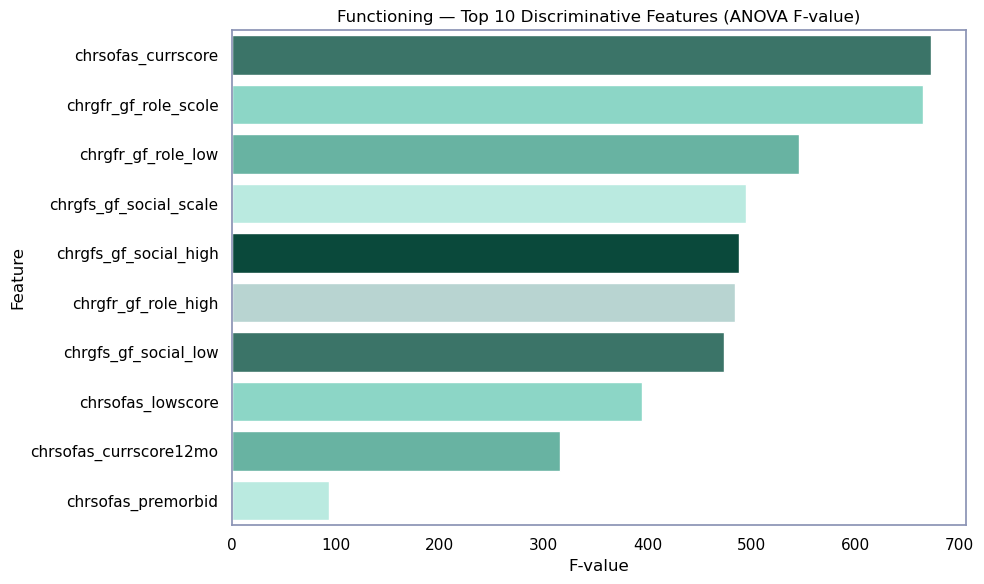

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

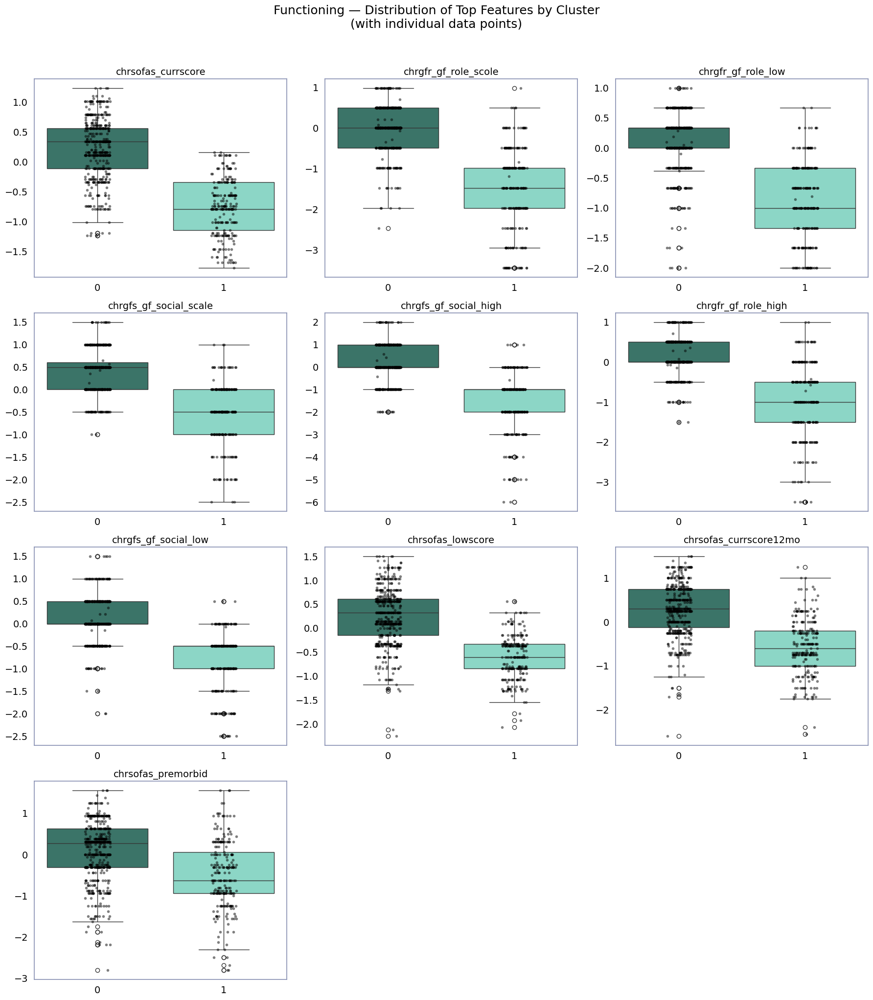


=== Modality: Detachment ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: UserWarning:

The palette list has more values (10) than needed (7), which may not be intended.



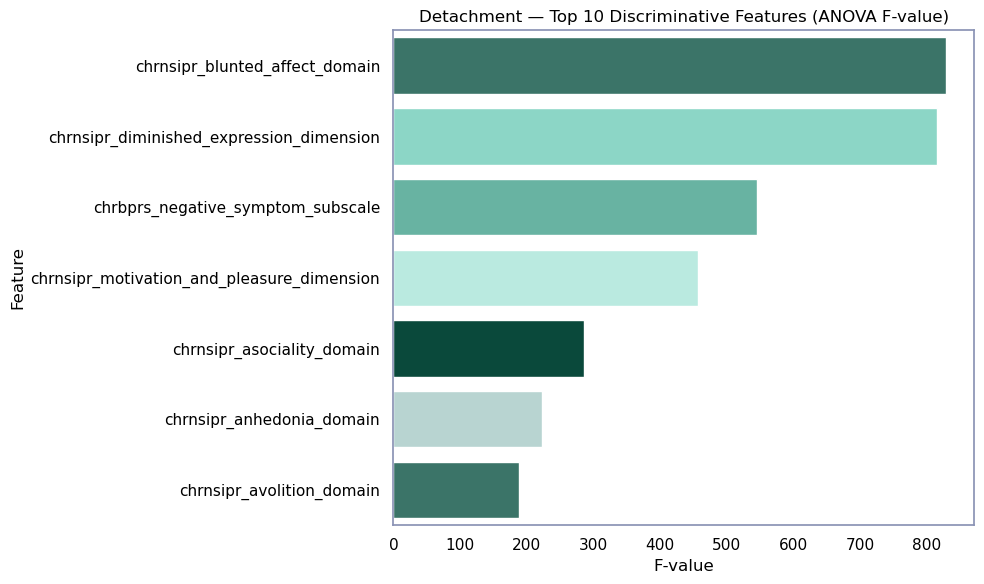

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

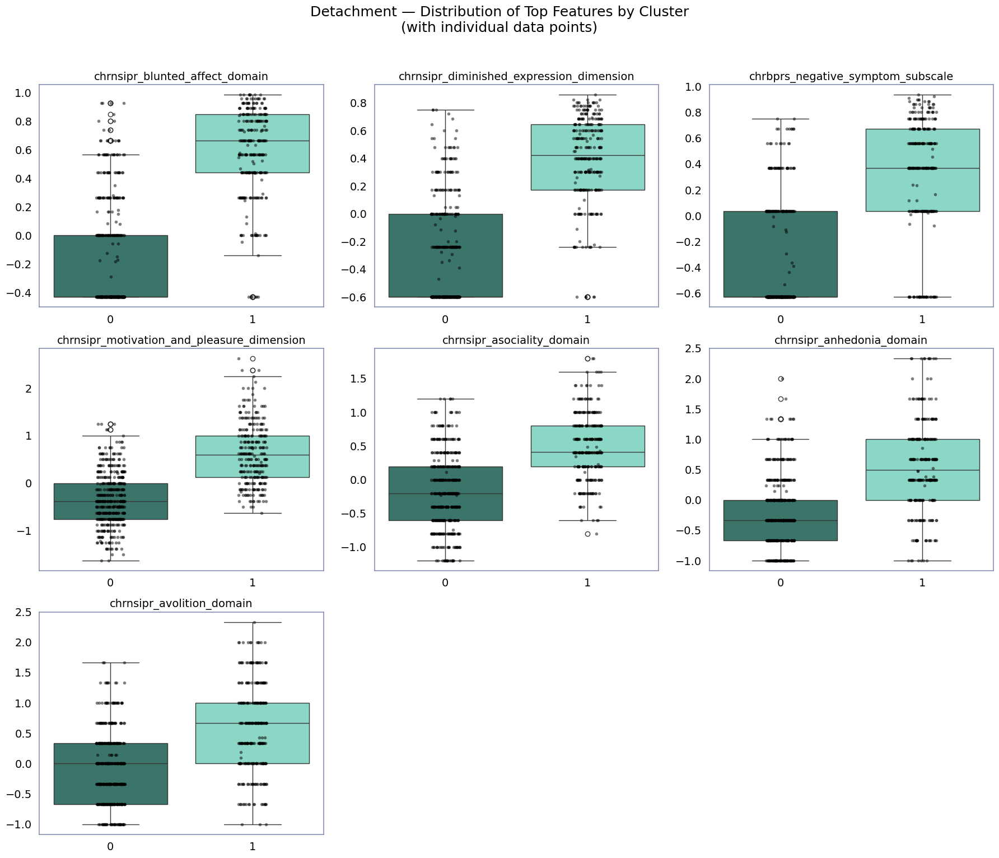


=== Modality: Psychoticism ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




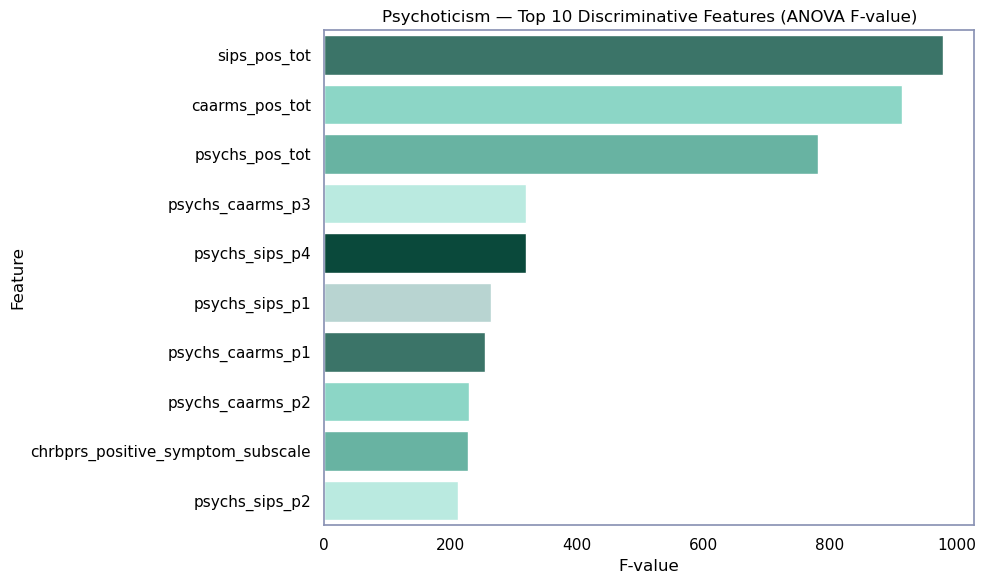

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

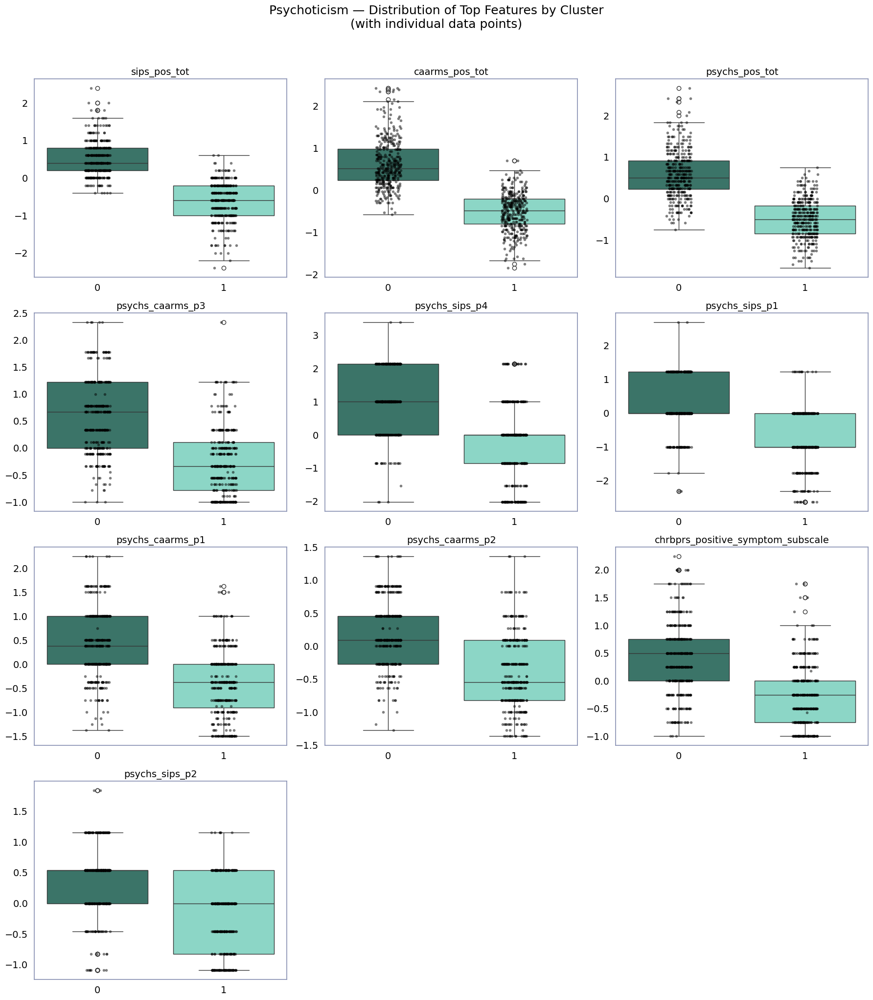


=== Modality: Cognition ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:29: UserWarning:

The palette list has more values (10) than needed (8), which may not be intended.



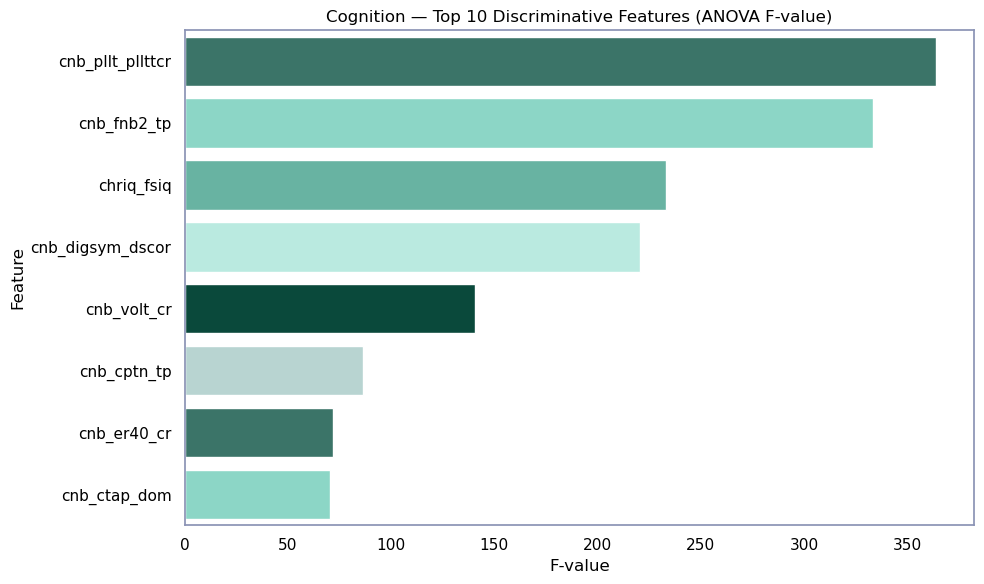

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3435960107.py:49: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

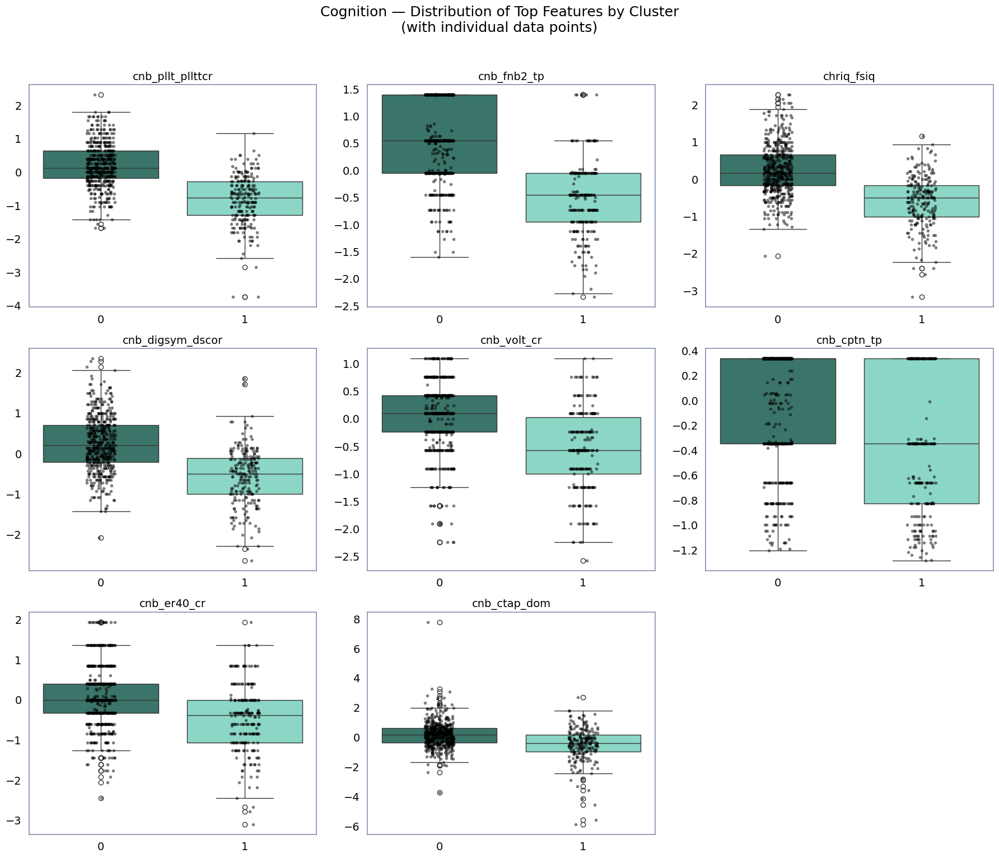

In [159]:
from sklearn.feature_selection import f_classif
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create directory for differences in original features plots
os.makedirs(os.path.join(plots_dir, "merged_feature_differences/"), exist_ok=True)

mod_num=0
for modality, df in dict_final.items():

    print(f"\n=== Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = labels_test_modalities[mod_num]
    feature_names = df.drop(columns=['src_subject_id']).columns

    # --- Feature Ranking (ANOVA F-test) ---
    f_vals, _ = f_classif(X, clusters)
    f_df = (
        pd.DataFrame({'feature': feature_names, 'f_value': f_vals})
        .sort_values('f_value', ascending=False)
    )

    # --- Barplot of Top Features ---
    top_k = 10
    plt.figure(figsize=(10, 6))
    sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
    plt.title(f"{modality} — Top {top_k} Discriminative Features (ANOVA F-value)")
    plt.xlabel("F-value")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()


    # --- Boxplots + Scatter Points of Top Features ---
    top_features = f_df['feature'].head(top_k).tolist()

    max_cols = 3
    n_feats = len(top_features)
    n_rows = int(np.ceil(n_feats / max_cols))

    fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
    axes = axes.flatten()

    for i, feat in enumerate(top_features):
        ax = axes[i]
        sns.boxplot(
            x=clusters, y=df[feat],
            palette=sns.color_palette(n_colors=len(np.unique(clusters))), ax=ax
        )
        sns.stripplot(
            x=clusters, y=df[feat],
            color='black', size=4, jitter=True, alpha=0.5, ax=ax
        )

        # Larger text sizes
        ax.set_title(feat, fontsize=14)
        ax.set_xlabel("", fontsize=22)
        ax.set_ylabel("", fontsize=22)
        ax.tick_params(axis='both', labelsize=14)

    # Hide unused axes
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.suptitle(
        f"{modality} — Distribution of Top Features by Cluster\n(with individual data points)",
        y=1.02, fontsize=18
    )

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_feature_differences/", f"{modality}_top_features.png"))
    plt.show()

    mod_num=mod_num+1


=== PCA Aggregated Plots test sample — Modality: Internalising ===
PC1 EVR: 44.36%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3731838037.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




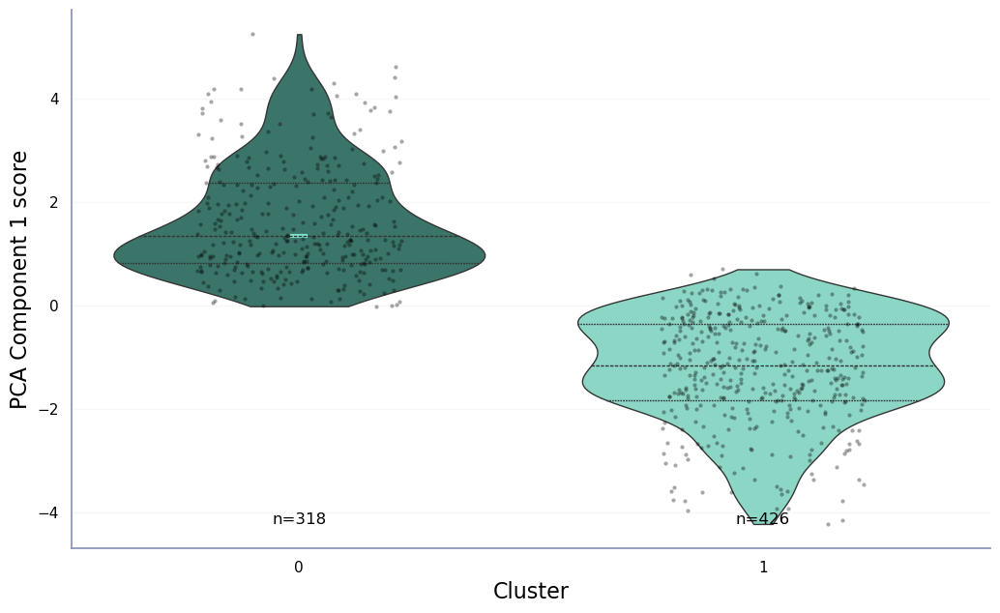

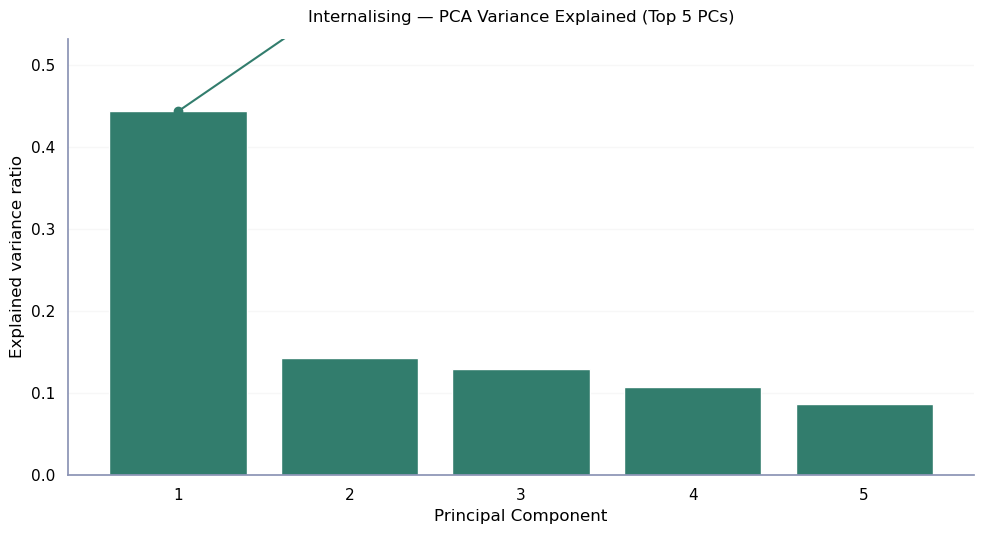

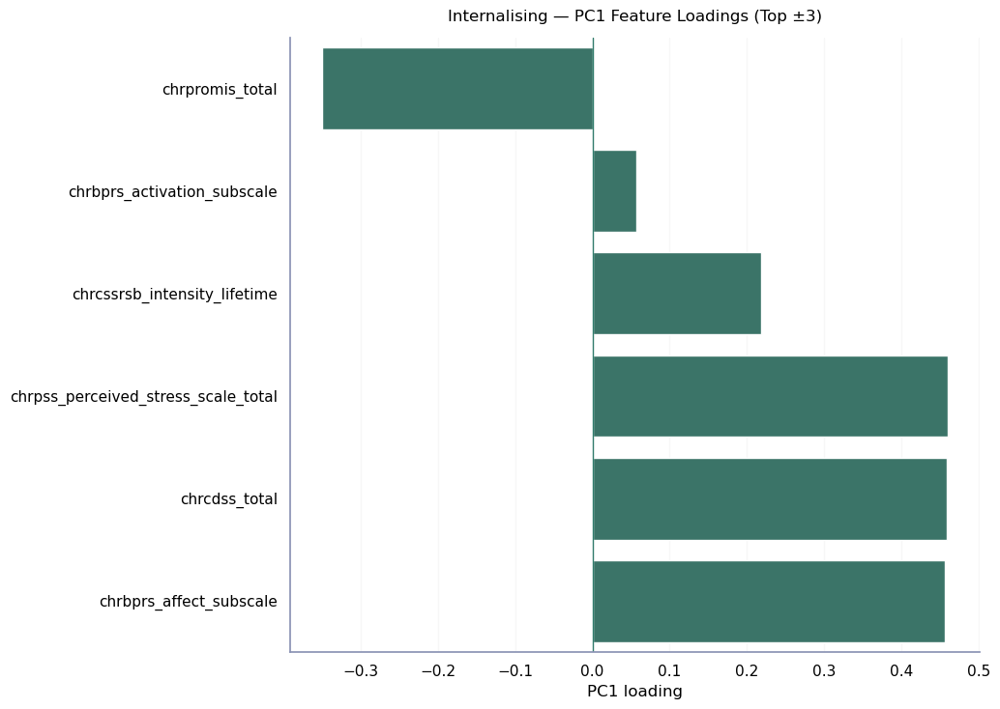


=== PCA Aggregated Plots test sample — Modality: Functioning ===
PC1 EVR: 47.86%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3731838037.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




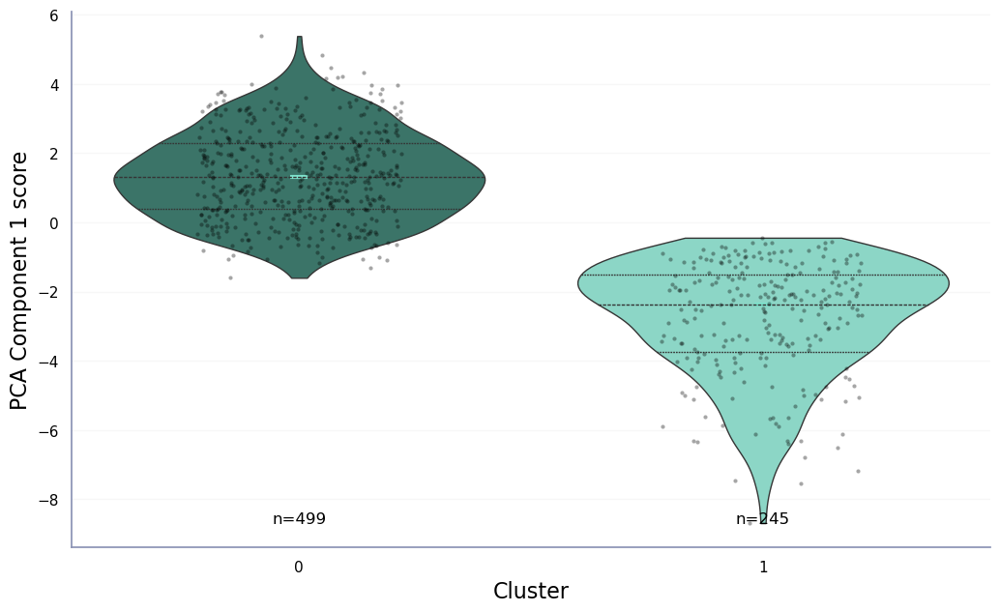

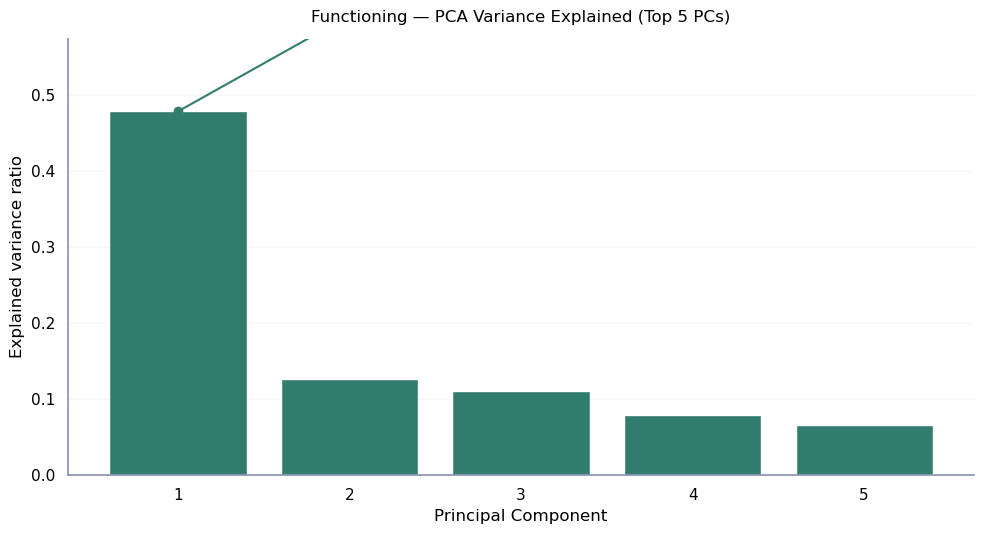

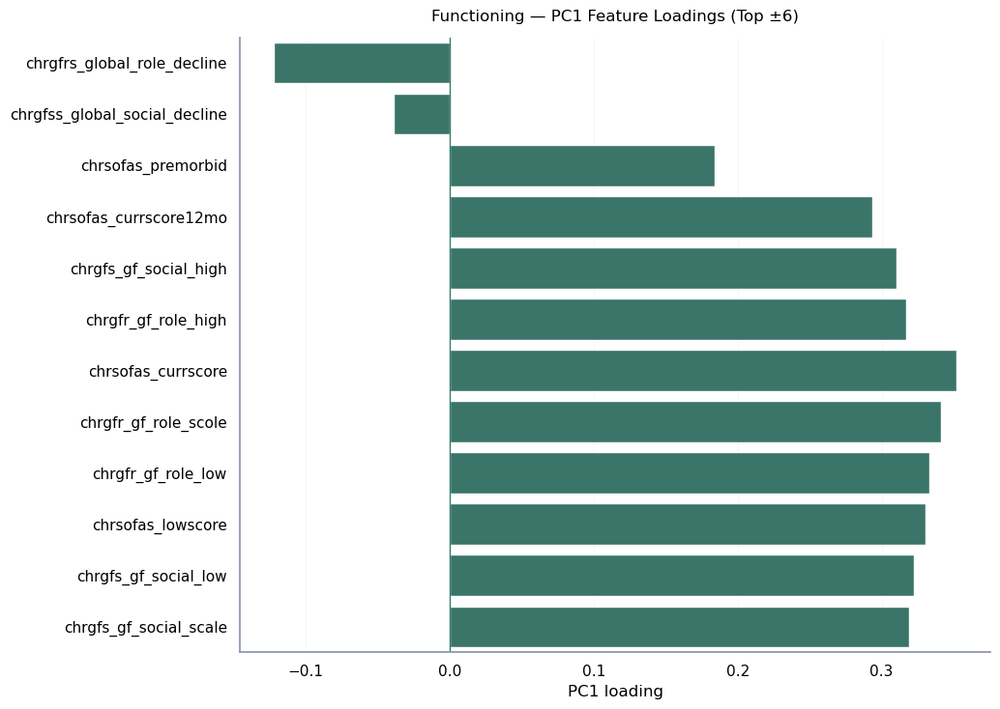


=== PCA Aggregated Plots test sample — Modality: Detachment ===
PC1 EVR: 54.40%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3731838037.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




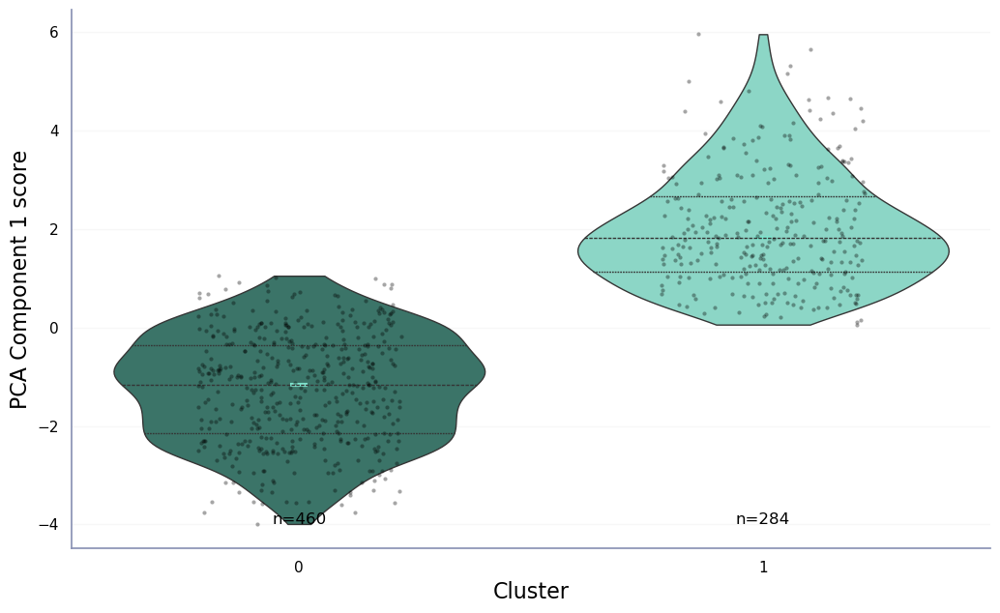

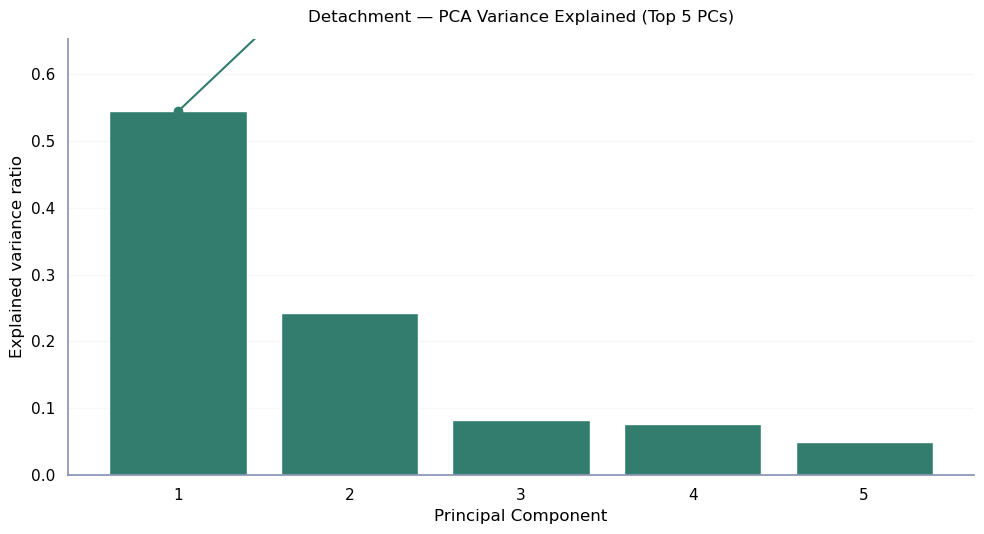

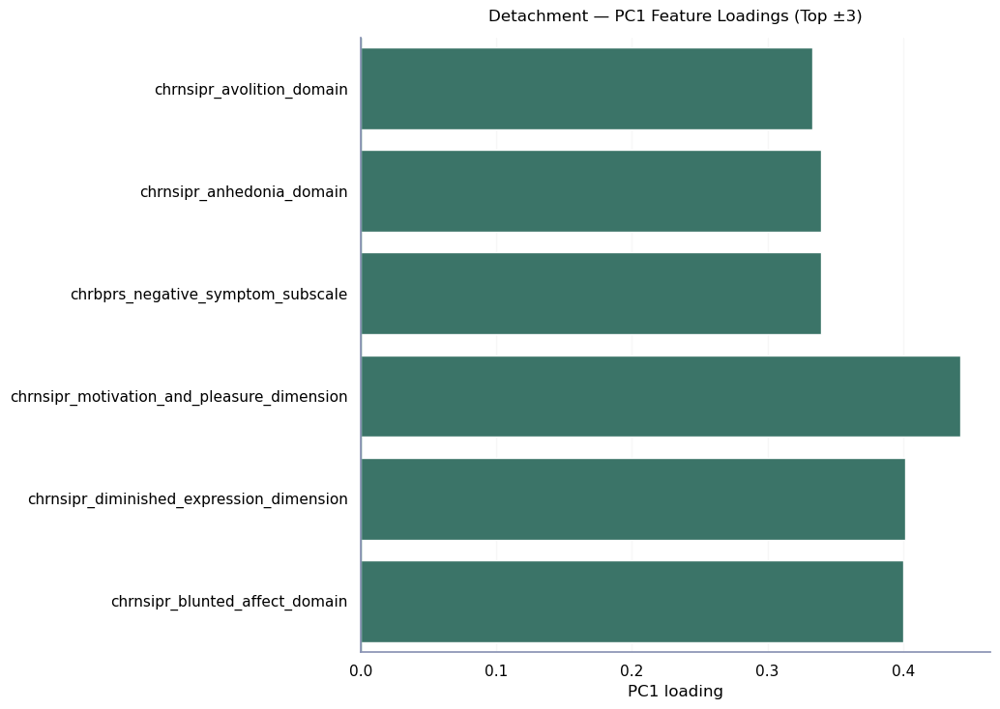


=== PCA Aggregated Plots test sample — Modality: Psychoticism ===
PC1 EVR: 42.78%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3731838037.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




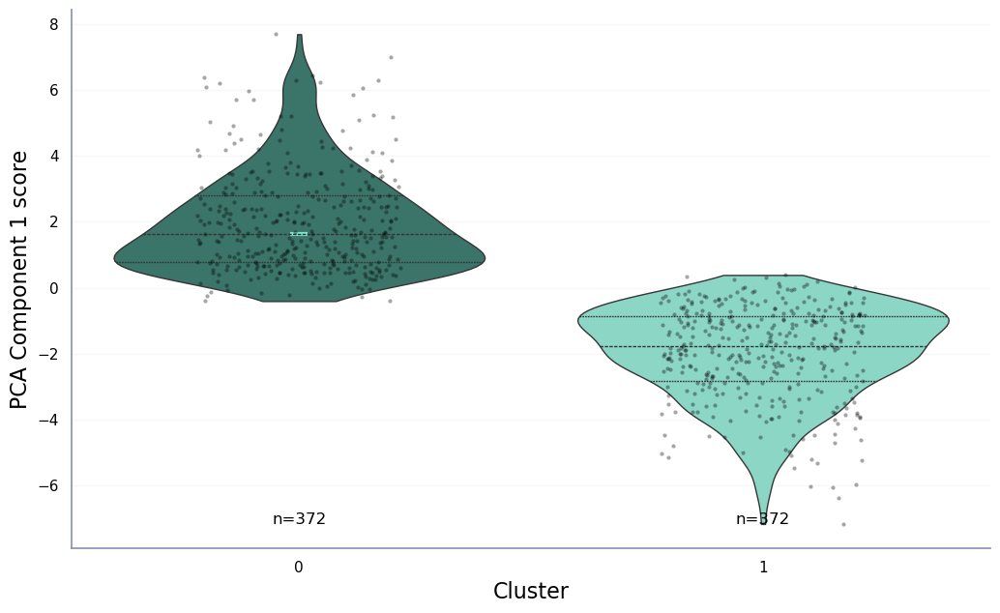

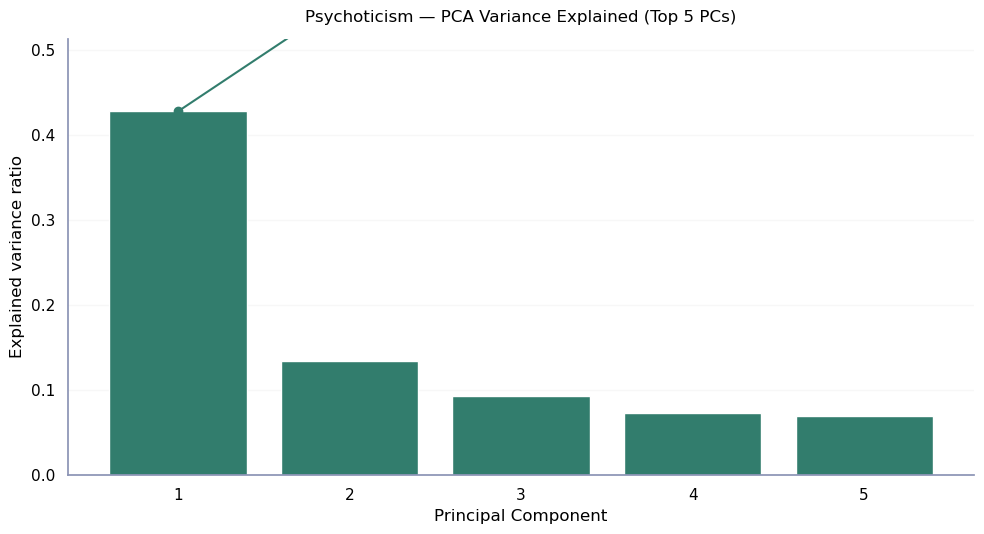

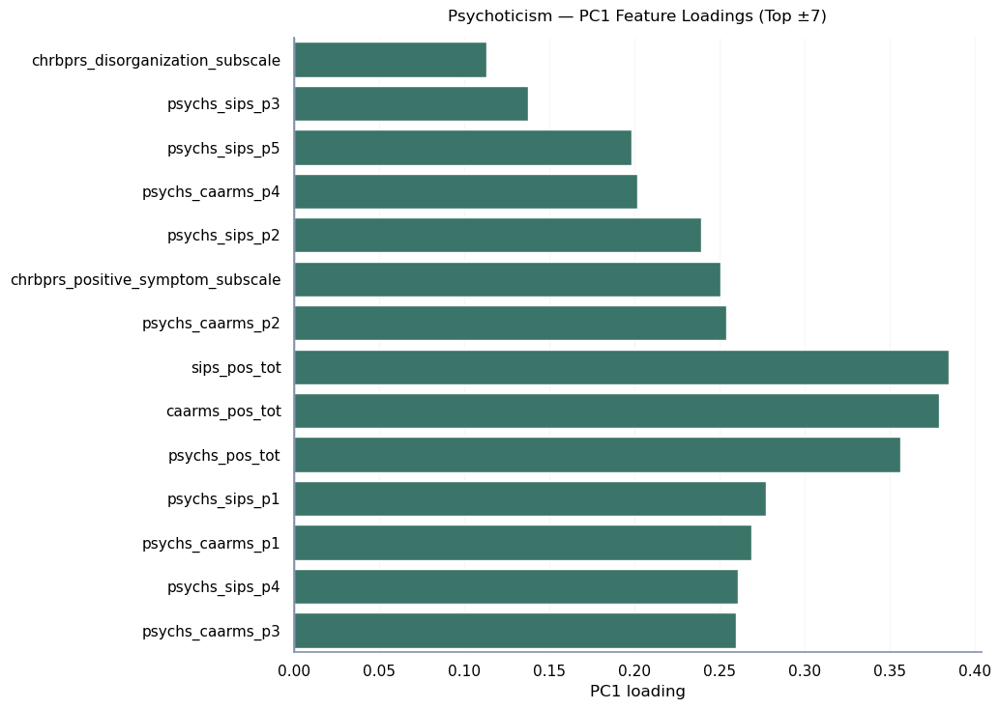


=== PCA Aggregated Plots test sample — Modality: Cognition ===
PC1 EVR: 33.56%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3731838037.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




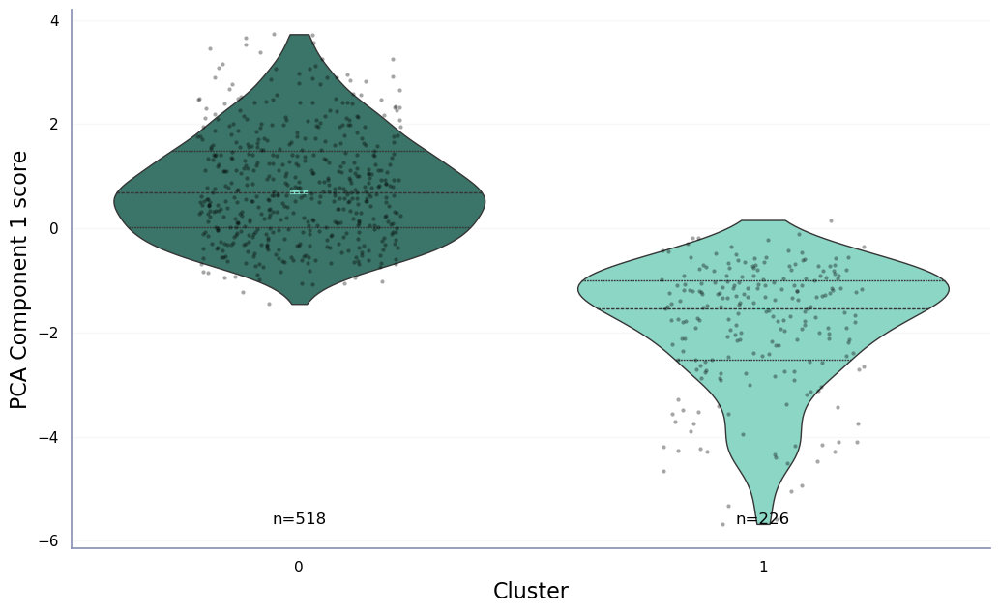

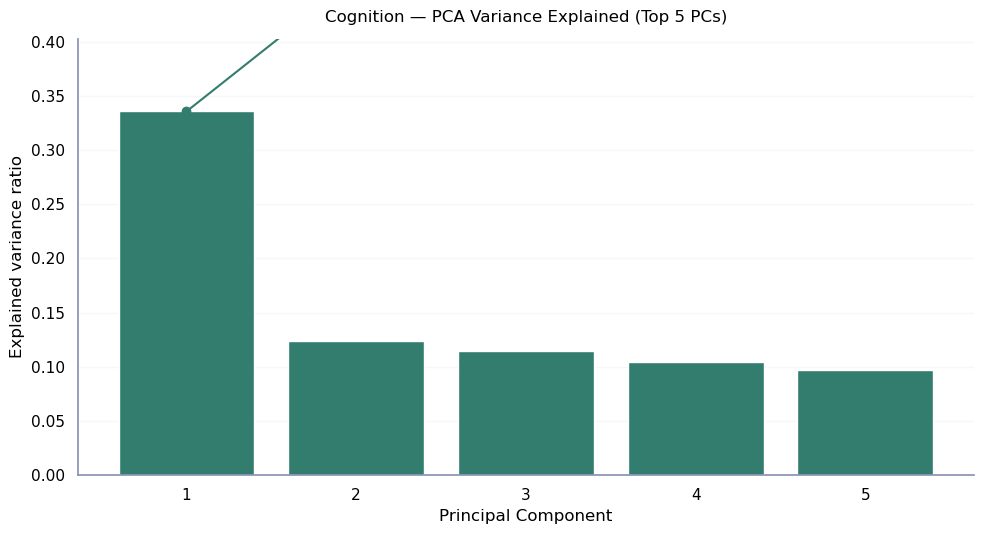

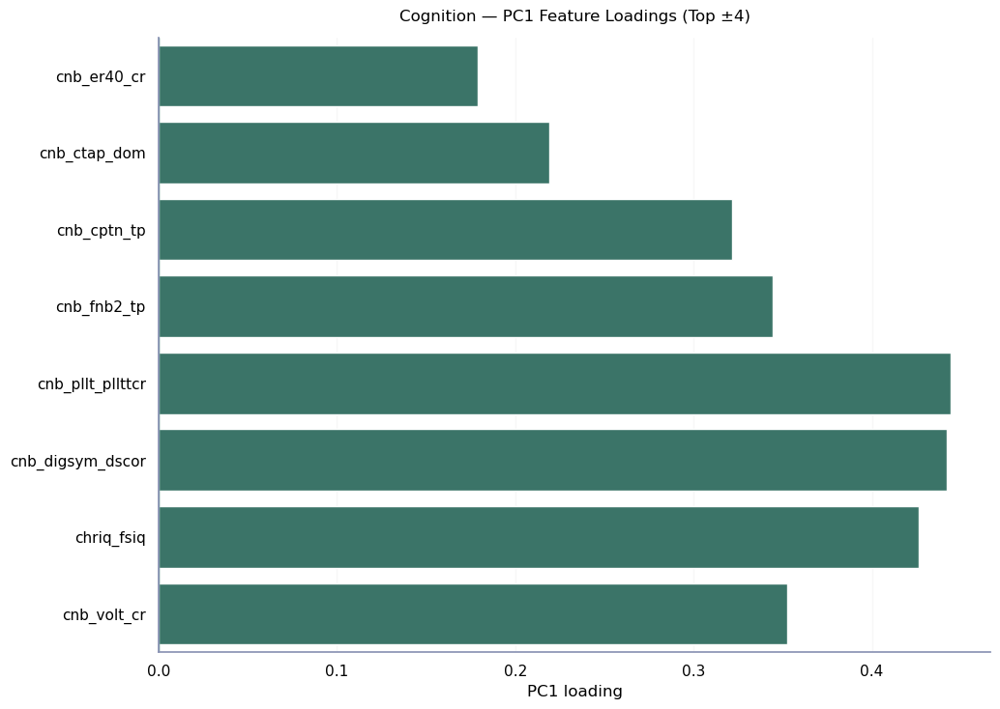

In [202]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# =========================
# PCA aggregated plots per modality + variance explained (first 5 PCs)
# - Respects your existing global theme (NO sns.set_theme here)
# - PC1 by cluster: violin (quartiles) + jitter + median marker + n labels
# - Variance plot: explained variance ratio for PC1..PC5
# - Optional: PC1 loadings (top +/- contributors)
# =========================

out_dir = os.path.join(plots_dir, "merged_feature_pca/")
os.makedirs(out_dir, exist_ok=True)

loadings_dir = os.path.join(out_dir, "pc1_loadings/")
os.makedirs(loadings_dir, exist_ok=True)

variance_dir = os.path.join(out_dir, "variance/")
os.makedirs(variance_dir, exist_ok=True)

mod_num = 0
for modality, df in dict_final.items():
    print(f"\n=== PCA Aggregated Plots test sample — Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = labels_test_modalities[mod_num]
    feature_names = df.drop(columns=['src_subject_id']).columns

    # Stable cluster order (customize if you want a specific ordering)
    cluster_order = np.sort(pd.unique(clusters))

    # --- Standardize ---
    Xz = StandardScaler().fit_transform(X)

    # --- PCA for variance (first 5 components) ---
    n_pcs = min(5, Xz.shape[1])  # cannot exceed number of features
    pca_var = PCA(n_components=n_pcs, random_state=0)
    pca_var.fit(Xz)

    evr = pca_var.explained_variance_ratio_
    cum_evr = np.cumsum(evr)

    # --- Also compute PC scores (at least PC1) ---
    pc_scores = pca_var.transform(Xz)  # shape: (n_samples, n_pcs)
    pc1 = pc_scores[:, 0]
    evr1 = float(evr[0])
    print(f"PC1 EVR: {evr1:.2%}")

    plot_df = pd.DataFrame({"cluster": clusters, "PC1": pc1})

    # -------------------------
    # 1) PC1 by cluster (publication-ready, respects global theme)
    # -------------------------
    fig, ax = plt.subplots(figsize=(10.5, 6.5))


    sns.violinplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        palette=sns.color_palette(n_colors=len(cluster_order)),
        inner="quartile",
        cut=0,
        bw_adjust=1.0,
        linewidth=1,
        ax=ax
    )

    sns.stripplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        color="black",
        size=3,
        jitter=0.22,
        alpha=0.35,
        ax=ax
    )

    # Median marker per cluster
    medians = plot_df.groupby("cluster")["PC1"].median()
    x_positions = np.arange(len(cluster_order))
    ax.scatter(
        x=x_positions,
        y=[medians.loc[c] for c in cluster_order],
        s=180,
        marker="_",
        linewidths=3
    )

    # Annotate n per cluster near the bottom
    counts = plot_df["cluster"].value_counts()
    ymin, ymax = ax.get_ylim()
    y_annot = ymin + 0.04 * (ymax - ymin)
    for i, c in enumerate(cluster_order):
        ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="bottom", fontsize=12)

    ax.set_xlabel("Cluster", fontsize=16)
    ax.set_ylabel("PCA Component 1 score", fontsize=16)

    # Light grid for readability; remove if your global theme already handles grids
    ax.grid(axis="y", alpha=0.15)
    sns.despine(ax=ax)

    fig.tight_layout()
    fig.savefig(os.path.join(out_dir, f"{modality}_PC1_violin_pubready.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 2) Variance explained (PC1..PC5): bar + cumulative line
    # -------------------------
    figv, axv = plt.subplots(figsize=(10, 5.5))

    pcs_idx = np.arange(1, n_pcs + 1)
    axv.bar(pcs_idx, evr)  # uses your global matplotlib color cycle
    axv.plot(pcs_idx, cum_evr, marker="o")

    axv.set_xticks(pcs_idx)
    axv.set_xlabel("Principal Component")
    axv.set_ylabel("Explained variance ratio")
    axv.set_title(f"{modality} — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

    axv.set_ylim(0, max(0.25, evr.max() * 1.2))  # keeps plot readable if EVR is small/large
    axv.grid(axis="y", alpha=0.15)
    sns.despine(ax=axv)

    figv.tight_layout()
    figv.savefig(os.path.join(variance_dir, f"{modality}_variance_top{n_pcs}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 3) Optional: PC1 feature loadings (top +/- contributors)
    # -------------------------
    loadings = pca_var.components_[0]  # PC1 loadings
    load_df = pd.DataFrame({"feature": feature_names, "loading": loadings})

    top_n = min(15, len(feature_names) // 2) if len(feature_names) >= 2 else 1
    top_pos = load_df.sort_values("loading", ascending=False).head(top_n)
    top_neg = load_df.sort_values("loading", ascending=True).head(top_n)
    load_plot_df = pd.concat([top_neg, top_pos], axis=0)

    fig2, ax2 = plt.subplots(figsize=(10.5, 7.5))
    sns.barplot(data=load_plot_df, x="loading", y="feature", ax=ax2)
    ax2.axvline(0, linewidth=1)

    ax2.set_title(f"{modality} — PC1 Feature Loadings (Top ±{top_n})", pad=12)
    ax2.set_xlabel("PC1 loading")
    ax2.set_ylabel("")

    ax2.grid(axis="x", alpha=0.15)
    sns.despine(ax=ax2)

    fig2.tight_layout()
    fig2.savefig(os.path.join(loadings_dir, f"{modality}_PC1_loadings_top_pm{top_n}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    mod_num += 1

### Differences in original variables - final labels


=== Modality: Internalising ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: UserWarning:

The palette list has more values (10) than needed (7), which may not be intended.



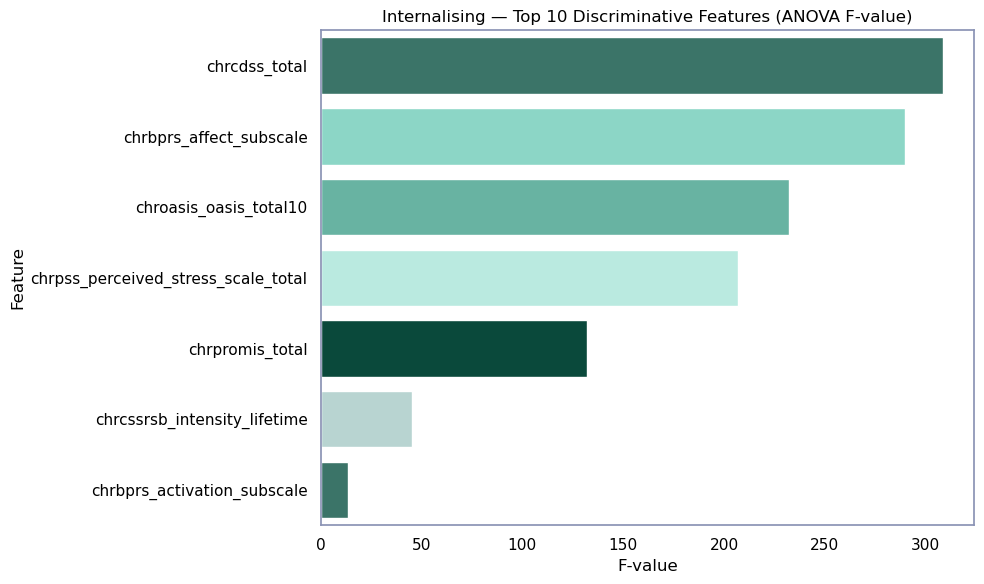

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

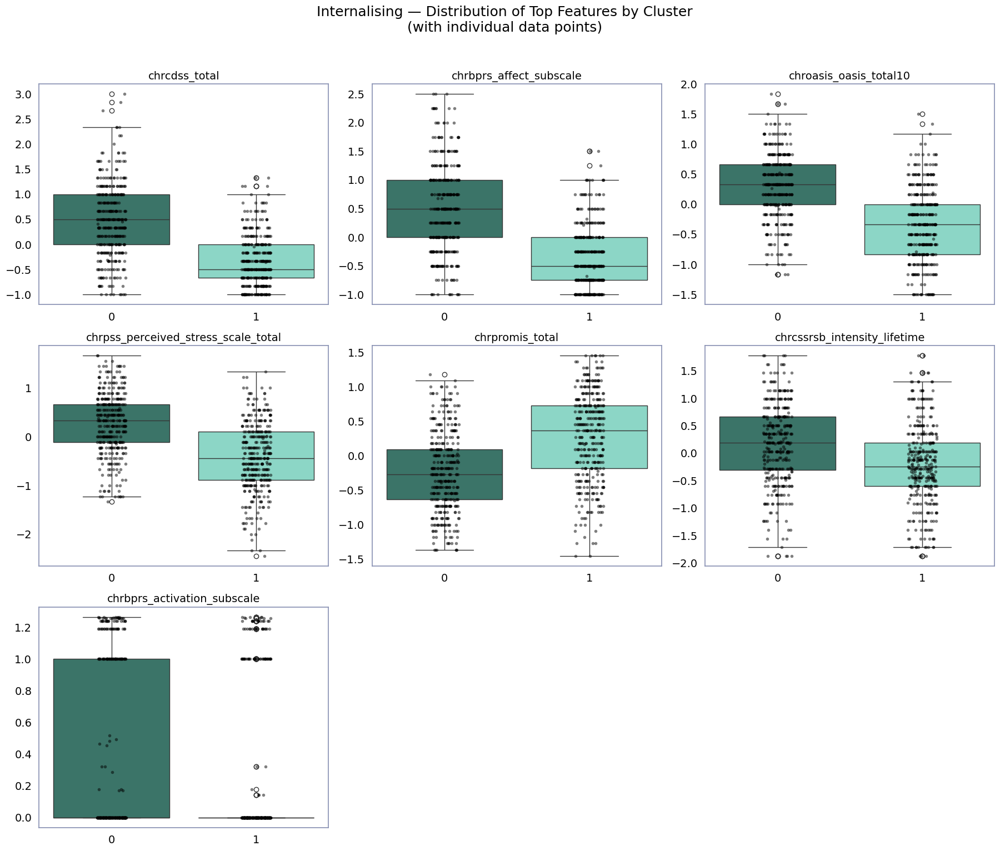


=== Modality: Functioning ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




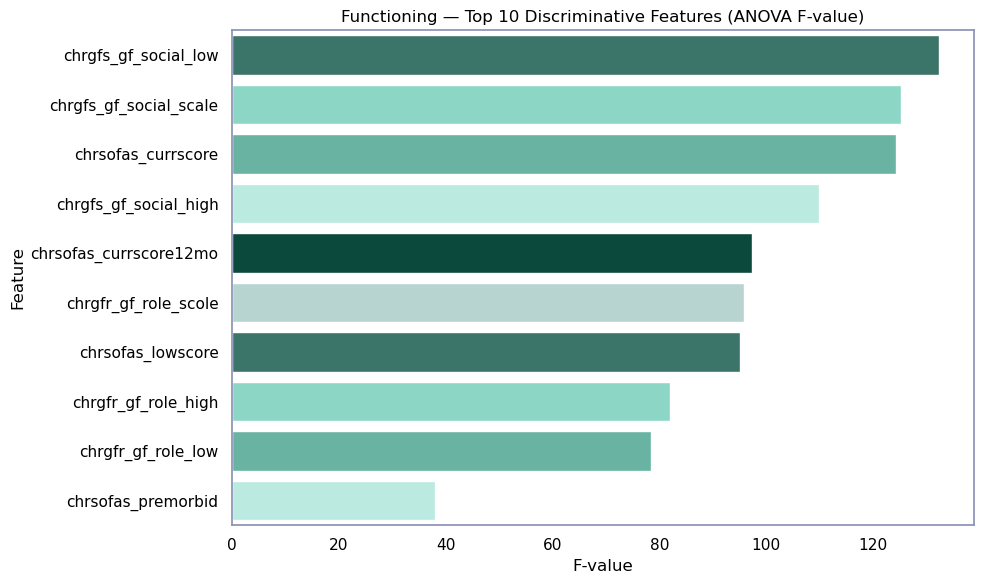

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

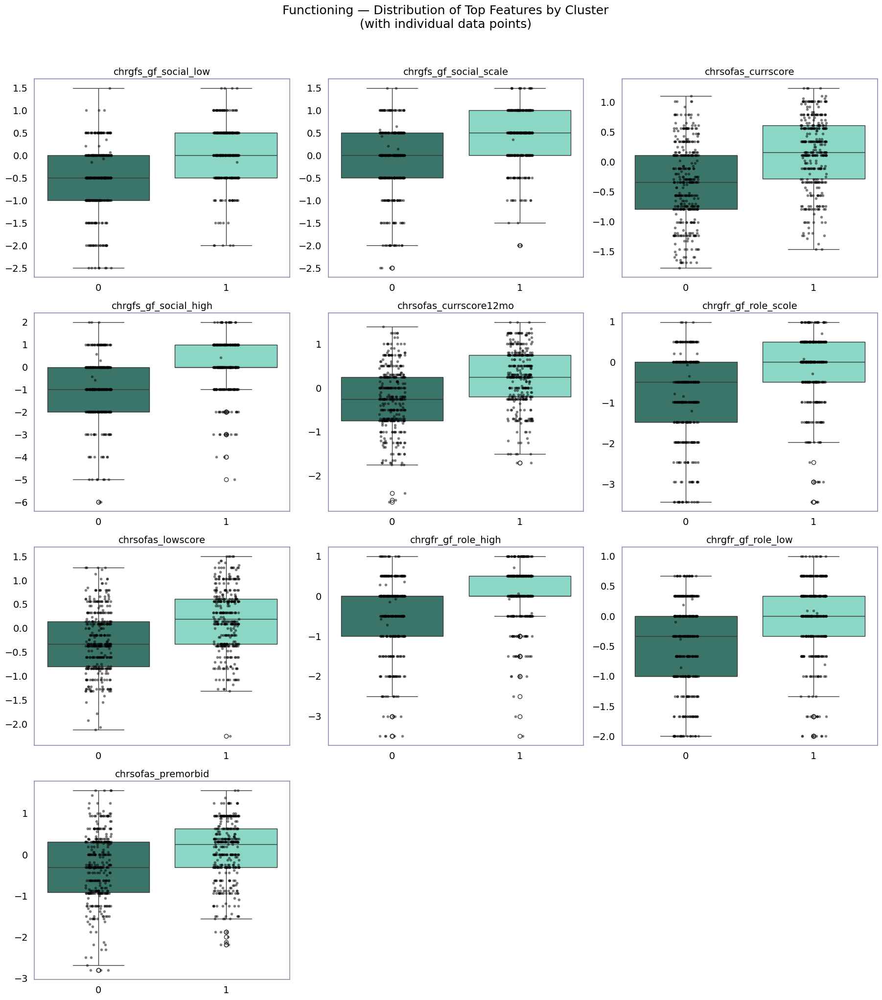


=== Modality: Detachment ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: UserWarning:

The palette list has more values (10) than needed (7), which may not be intended.



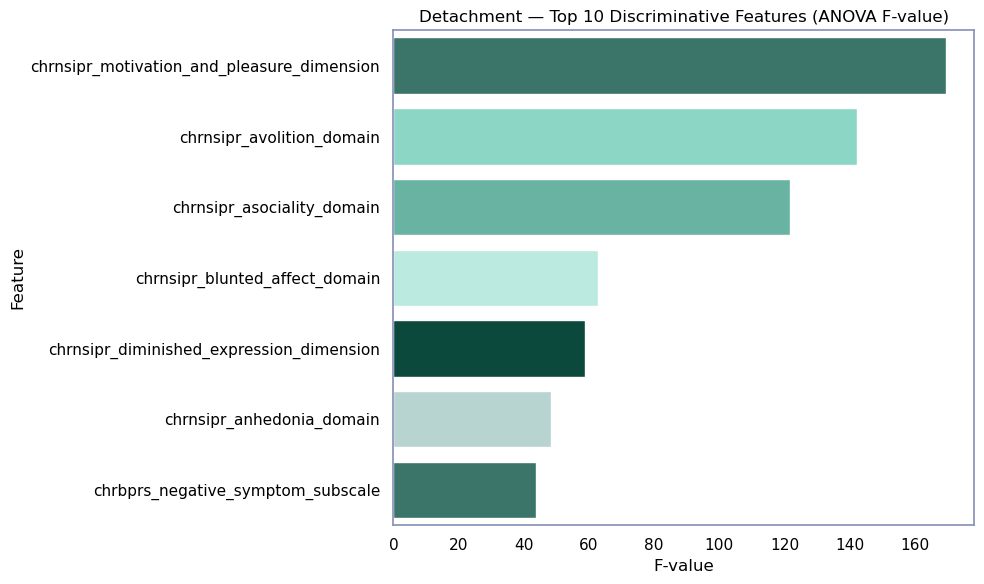

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

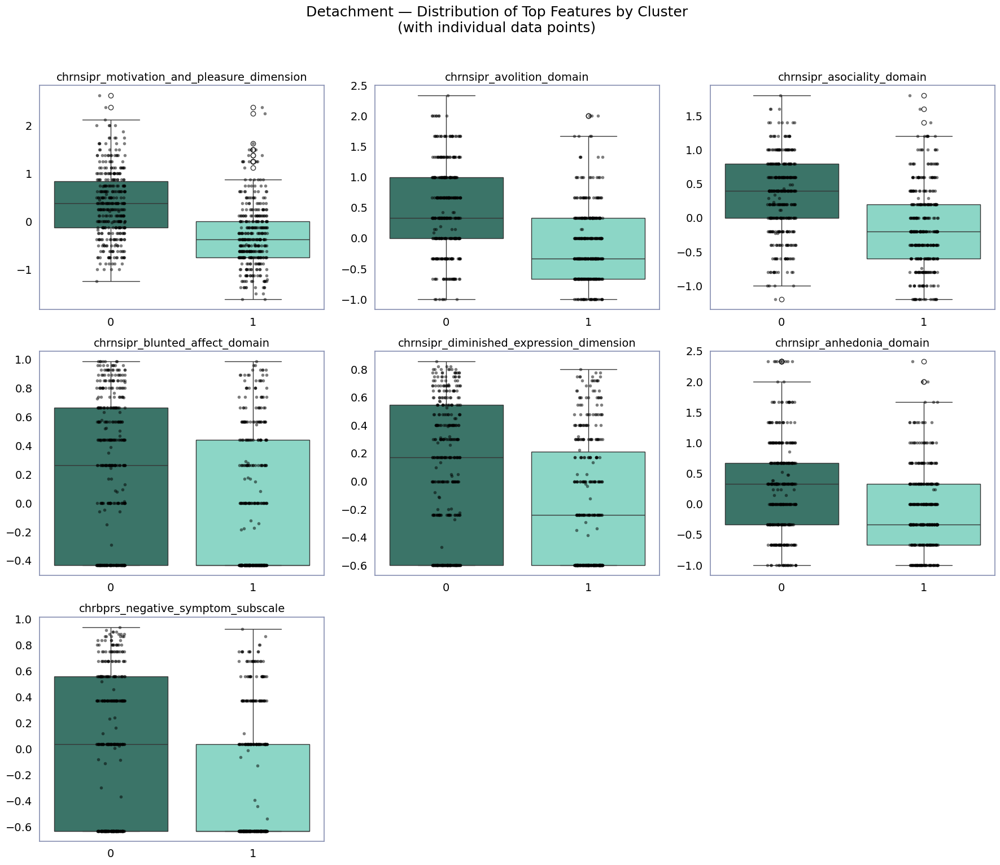


=== Modality: Psychoticism ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




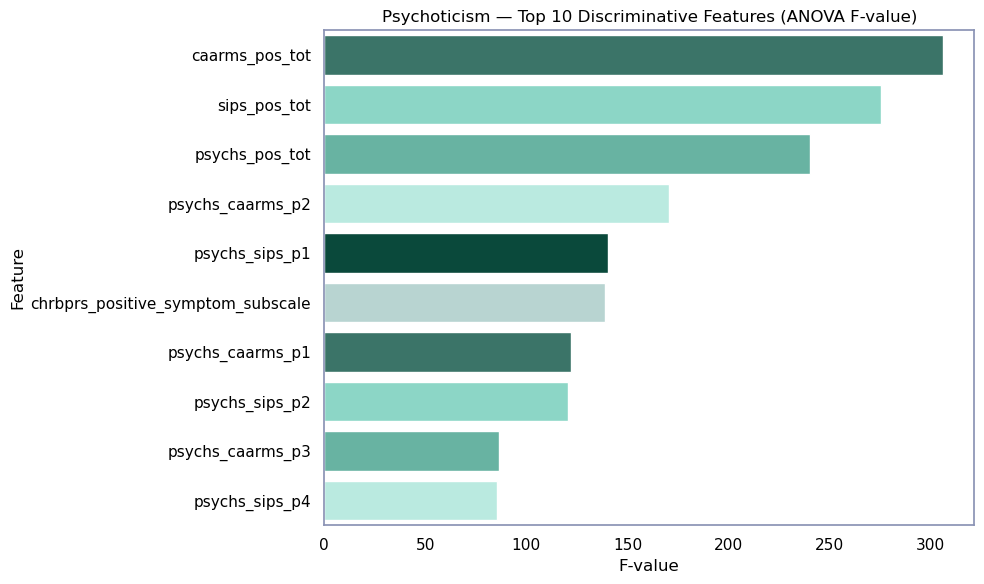

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

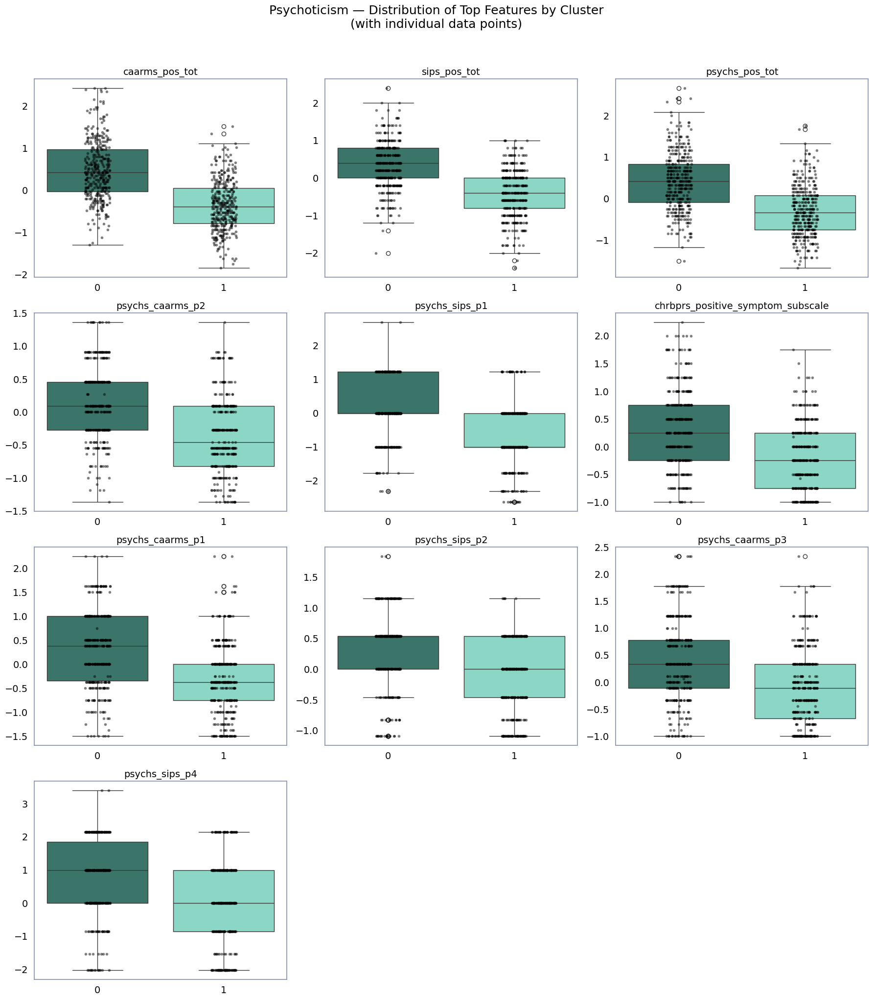


=== Modality: Cognition ===


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:28: UserWarning:

The palette list has more values (10) than needed (8), which may not be intended.



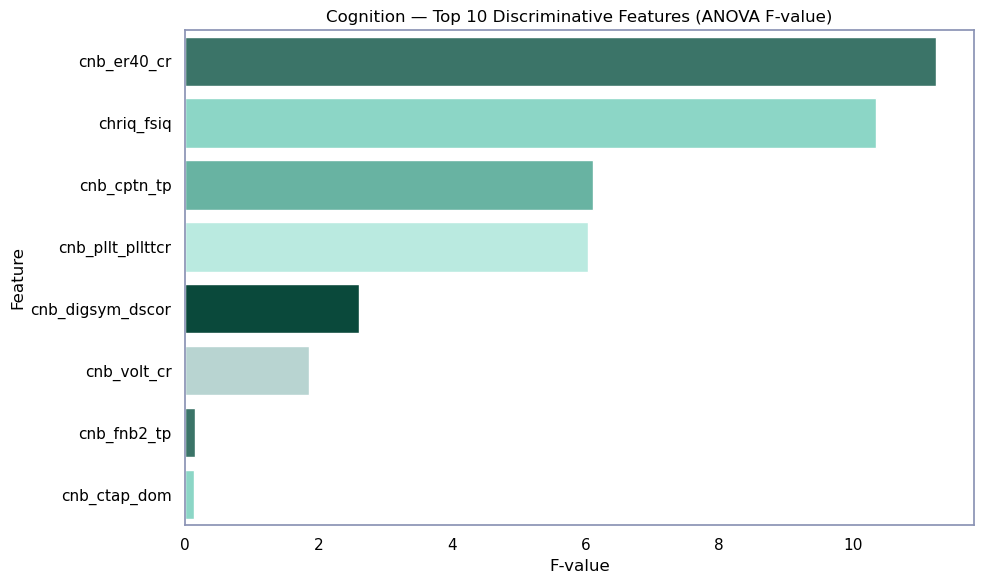

/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1044487314.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

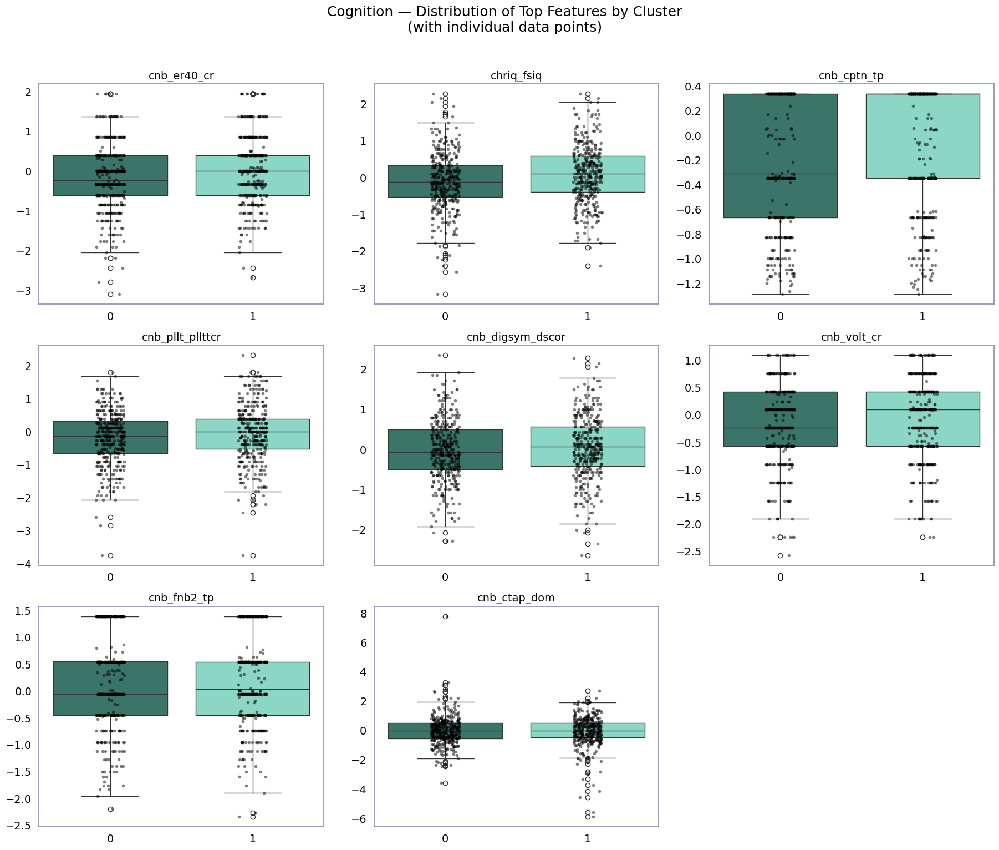

In [160]:
from sklearn.feature_selection import f_classif
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create directory for differences in original features plots
os.makedirs(os.path.join(plots_dir, "merged_feature_differences/"), exist_ok=True)

for modality, df in dict_final.items():

    print(f"\n=== Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = labels_test_final
    feature_names = df.drop(columns=['src_subject_id']).columns

    # --- Feature Ranking (ANOVA F-test) ---
    f_vals, _ = f_classif(X, clusters)
    f_df = (
        pd.DataFrame({'feature': feature_names, 'f_value': f_vals})
        .sort_values('f_value', ascending=False)
    )

    # --- Barplot of Top Features ---
    top_k = 10
    plt.figure(figsize=(10, 6))
    sns.barplot(x='f_value', y='feature', data=f_df.head(top_k), palette=sns.color_palette(n_colors=top_k))
    plt.title(f"{modality} — Top {top_k} Discriminative Features (ANOVA F-value)")
    plt.xlabel("F-value")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()


    # --- Boxplots + Scatter Points of Top Features ---
    top_features = f_df['feature'].head(top_k).tolist()

    max_cols = 3
    n_feats = len(top_features)
    n_rows = int(np.ceil(n_feats / max_cols))

    fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 6, n_rows * 5))
    axes = axes.flatten()

    for i, feat in enumerate(top_features):
        ax = axes[i]
        sns.boxplot(
            x=clusters, y=df[feat],
            palette=sns.color_palette(n_colors=len(np.unique(clusters))), ax=ax
        )
        sns.stripplot(
            x=clusters, y=df[feat],
            color='black', size=4, jitter=True, alpha=0.5, ax=ax
        )

        # Larger text sizes
        ax.set_title(feat, fontsize=14)
        ax.set_xlabel("", fontsize=22)
        ax.set_ylabel("", fontsize=22)
        ax.tick_params(axis='both', labelsize=14)

    # Hide unused axes
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.suptitle(
        f"{modality} — Distribution of Top Features by Cluster\n(with individual data points)",
        y=1.02, fontsize=18
    )

    plt.tight_layout()
    fig.savefig(os.path.join(plots_dir, "merged_feature_differences/", f"{modality}_top_features.png"))
    plt.show()


=== PCA Aggregated Plots test sample — Modality: Internalising ===
PC1 EVR: 44.36%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1705655403.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




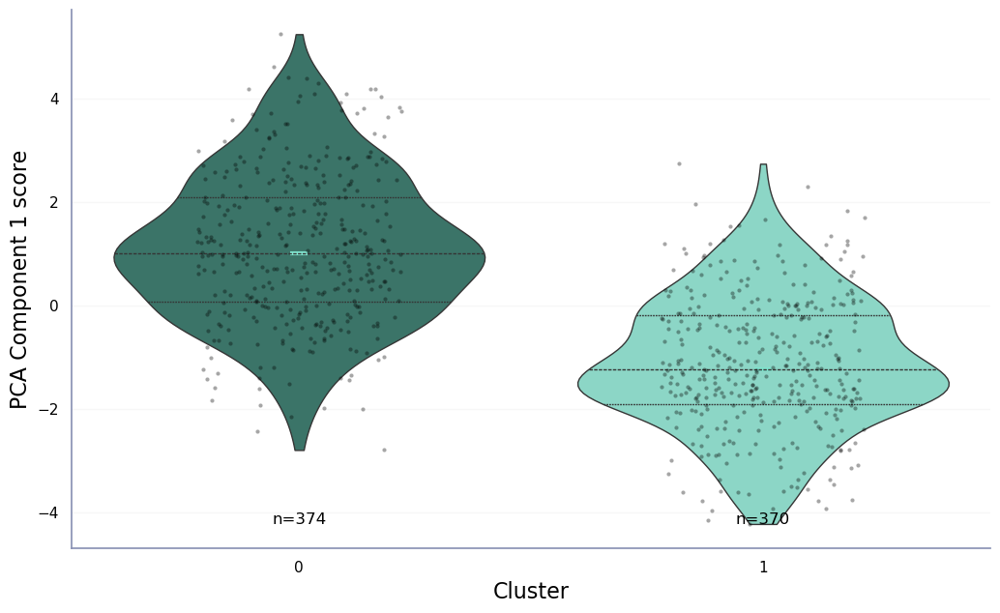

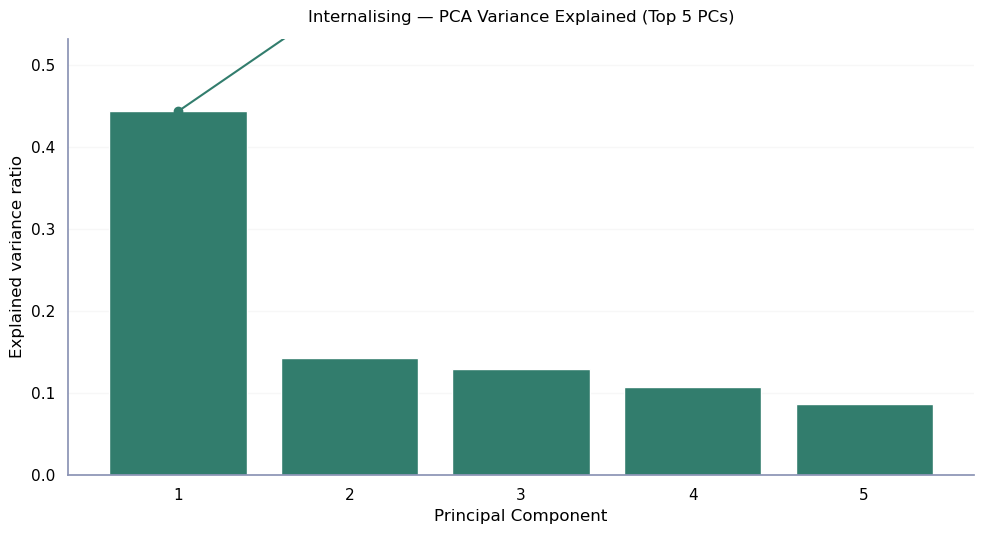

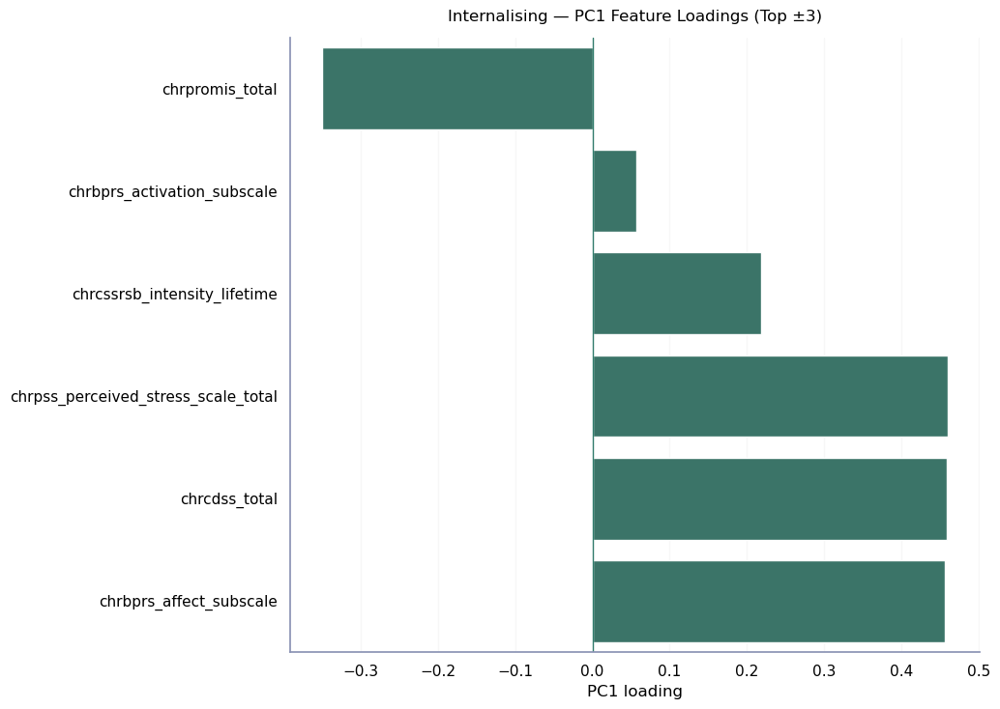


=== PCA Aggregated Plots test sample — Modality: Functioning ===
PC1 EVR: 47.86%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1705655403.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




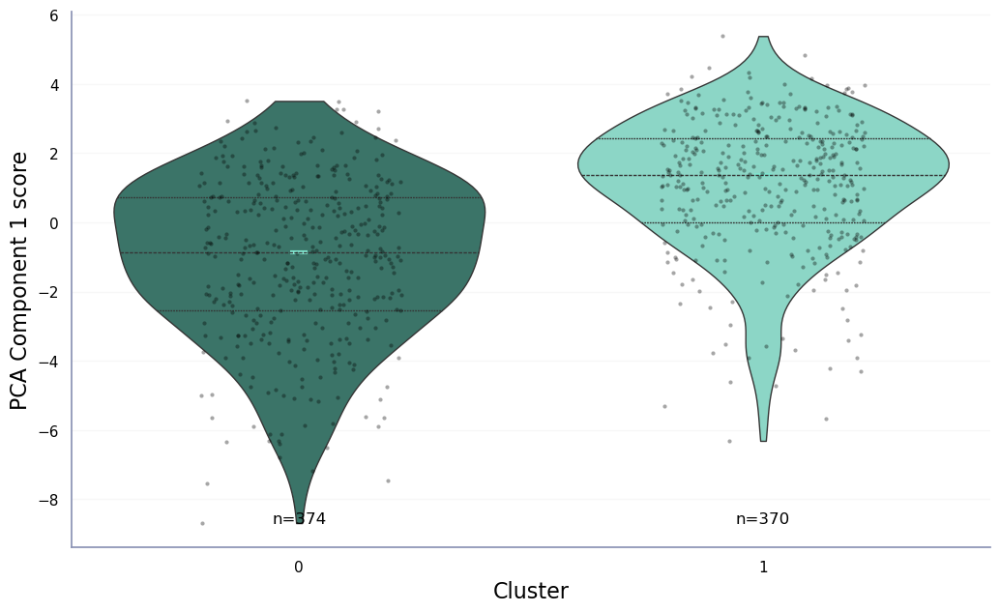

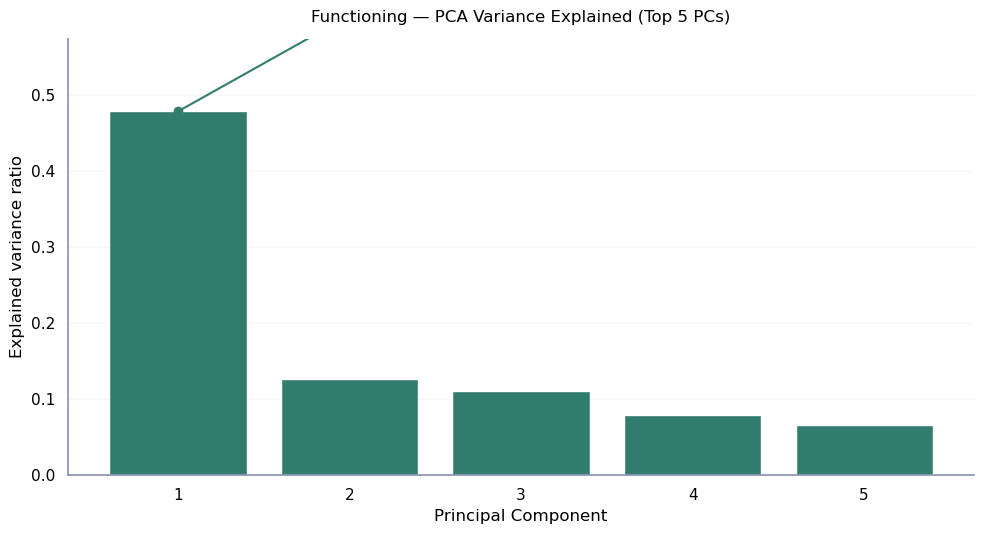

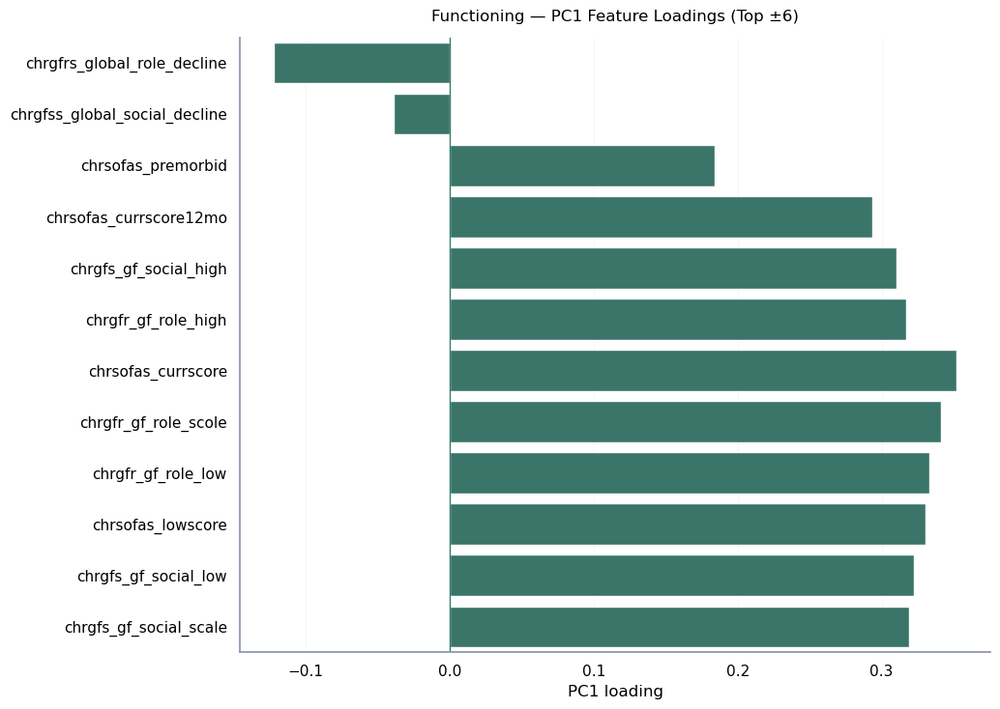


=== PCA Aggregated Plots test sample — Modality: Detachment ===
PC1 EVR: 54.40%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1705655403.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




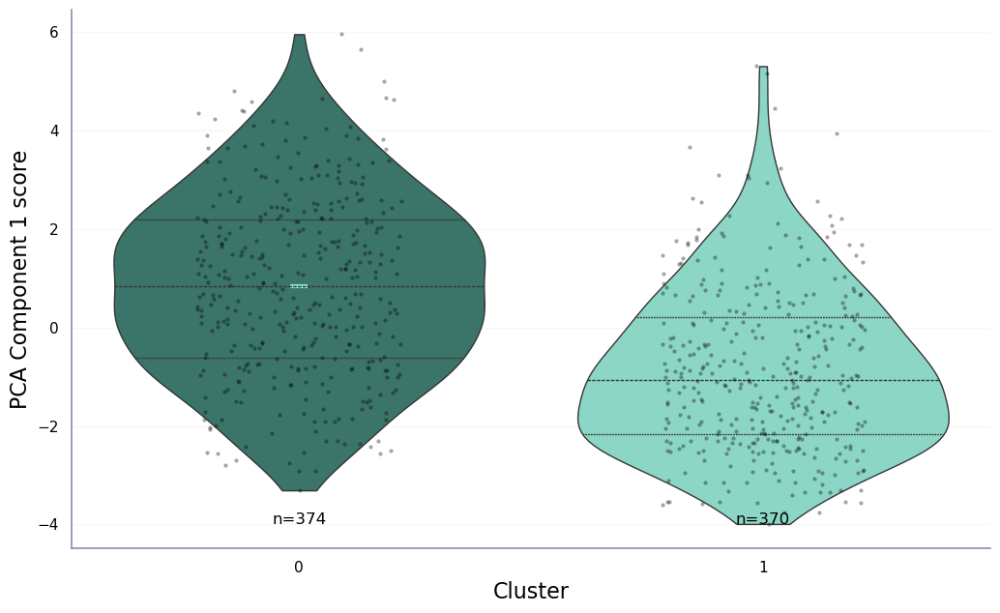

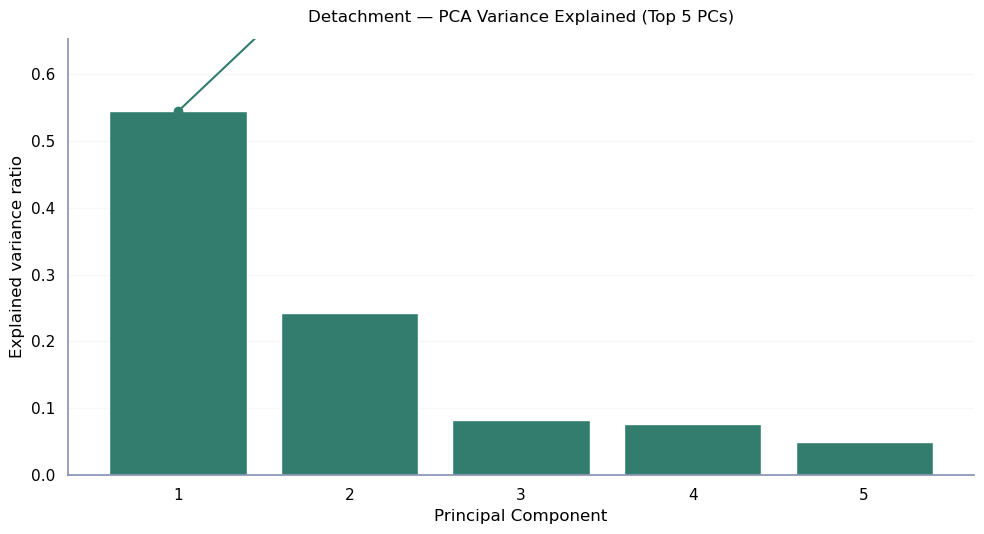

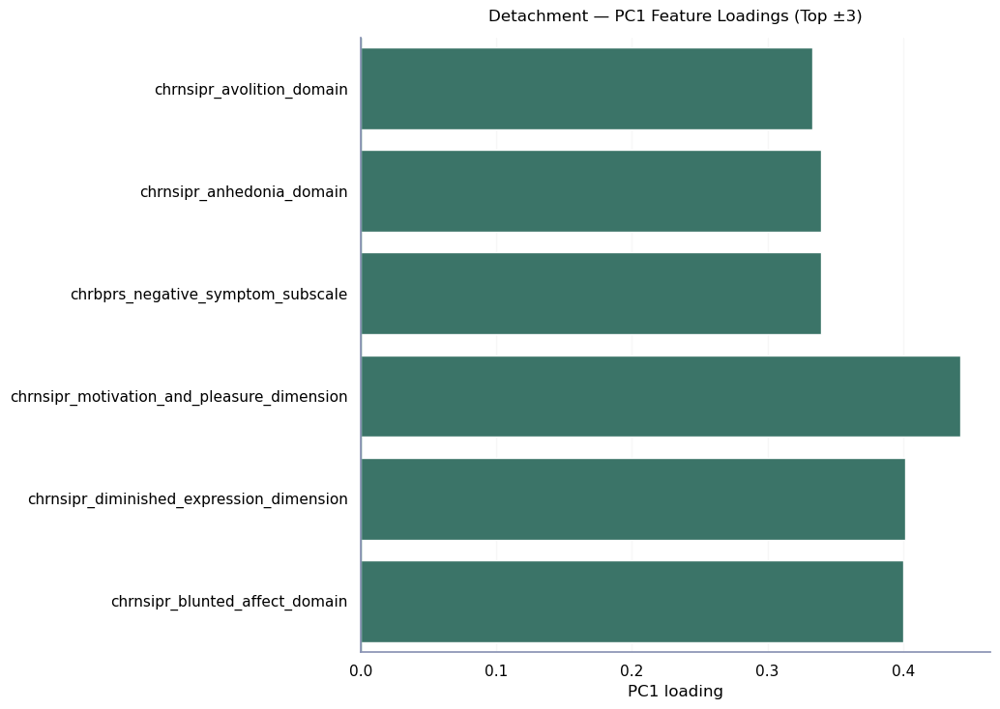


=== PCA Aggregated Plots test sample — Modality: Psychoticism ===
PC1 EVR: 42.78%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1705655403.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




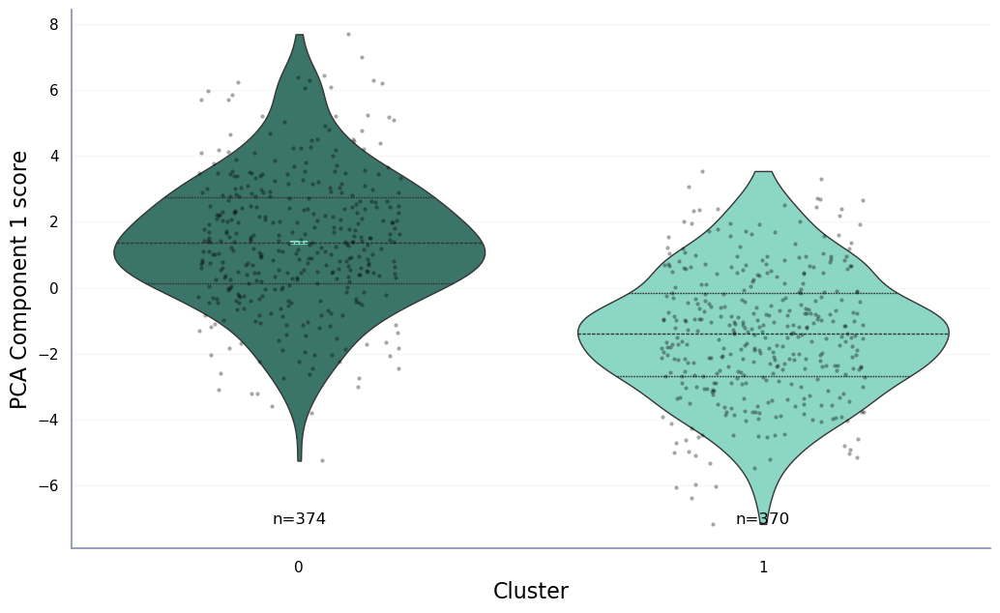

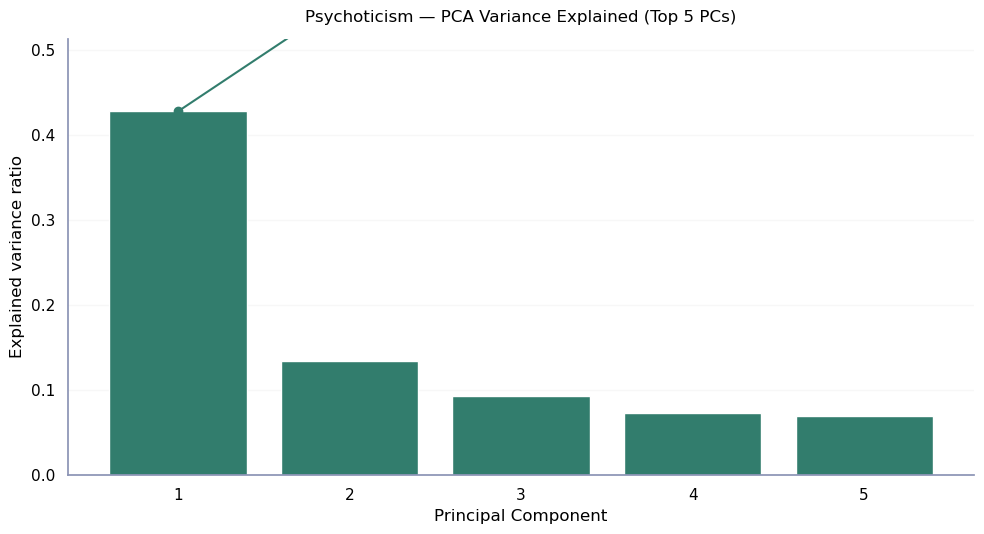

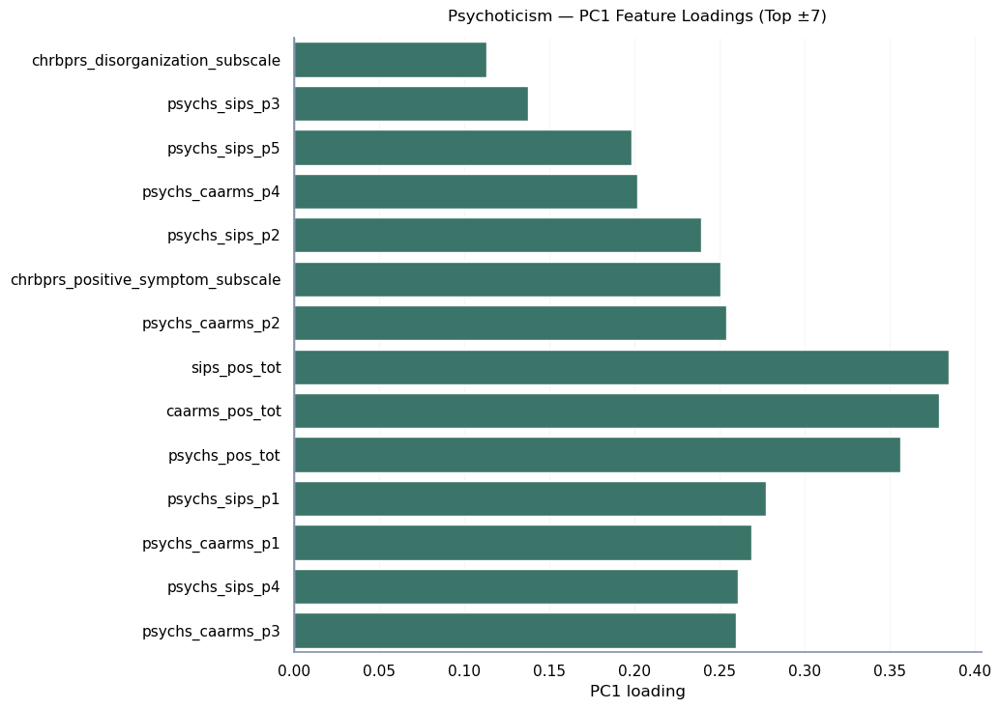


=== PCA Aggregated Plots test sample — Modality: Cognition ===
PC1 EVR: 33.56%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/1705655403.py:64: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




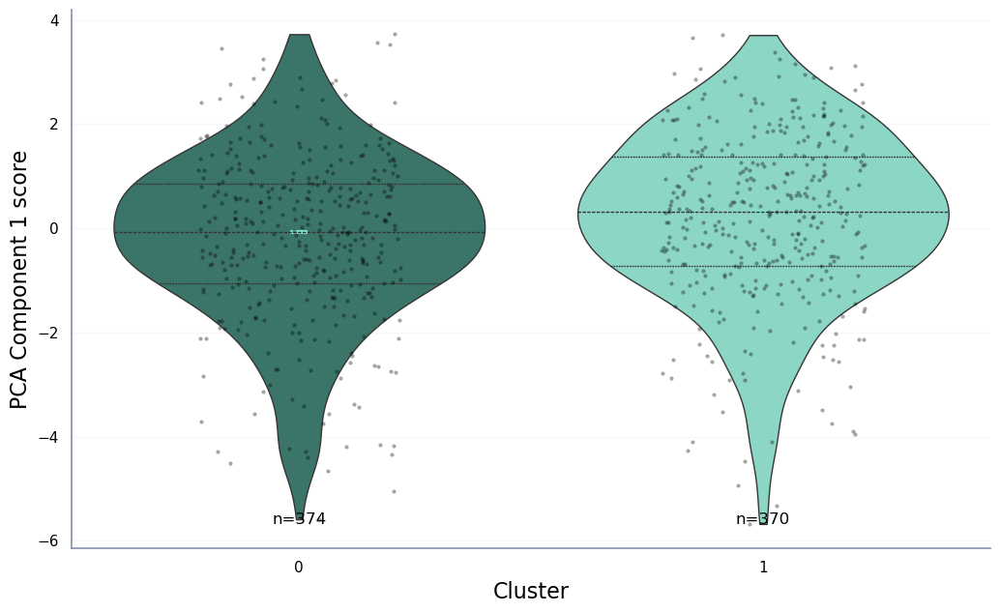

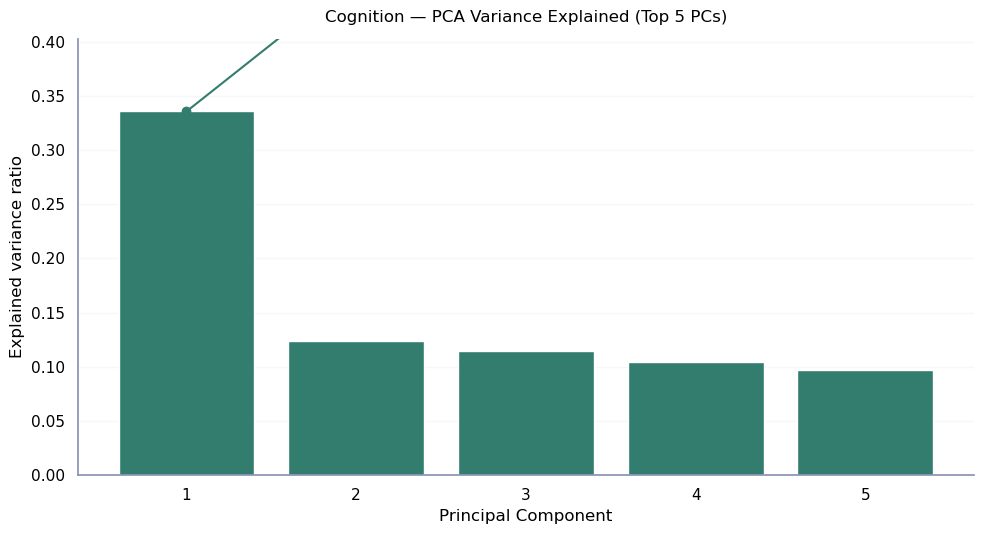

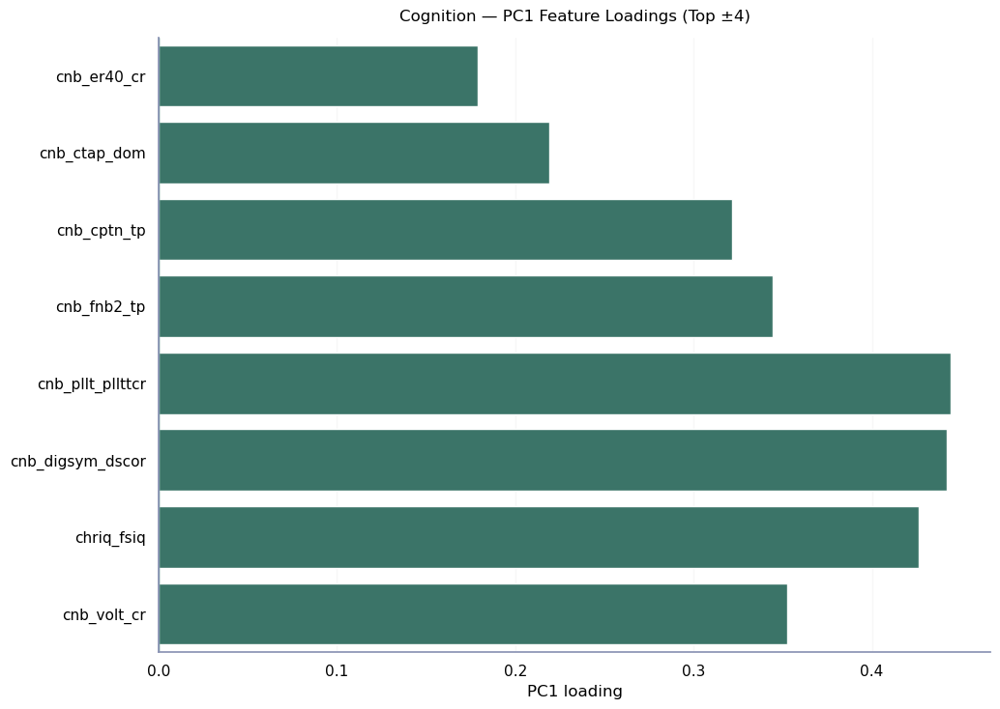

In [203]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# =========================
# PCA aggregated plots per modality + variance explained (first 5 PCs)
# - Respects your existing global theme (NO sns.set_theme here)
# - PC1 by cluster: violin (quartiles) + jitter + median marker + n labels
# - Variance plot: explained variance ratio for PC1..PC5
# - Optional: PC1 loadings (top +/- contributors)
# =========================

out_dir = os.path.join(plots_dir, "merged_feature_pca/")
os.makedirs(out_dir, exist_ok=True)

loadings_dir = os.path.join(out_dir, "pc1_loadings/")
os.makedirs(loadings_dir, exist_ok=True)

variance_dir = os.path.join(out_dir, "variance/")
os.makedirs(variance_dir, exist_ok=True)

mod_num = 0
for modality, df in dict_final.items():
    print(f"\n=== PCA Aggregated Plots test sample — Modality: {modality} ===")

    # Extract data and labels
    X = df.drop(columns=['src_subject_id']).values
    clusters = labels_test_final
    feature_names = df.drop(columns=['src_subject_id']).columns

    # Stable cluster order (customize if you want a specific ordering)
    cluster_order = np.sort(pd.unique(clusters))

    # --- Standardize ---
    Xz = StandardScaler().fit_transform(X)

    # --- PCA for variance (first 5 components) ---
    n_pcs = min(5, Xz.shape[1])  # cannot exceed number of features
    pca_var = PCA(n_components=n_pcs, random_state=0)
    pca_var.fit(Xz)

    evr = pca_var.explained_variance_ratio_
    cum_evr = np.cumsum(evr)

    # --- Also compute PC scores (at least PC1) ---
    pc_scores = pca_var.transform(Xz)  # shape: (n_samples, n_pcs)
    pc1 = pc_scores[:, 0]
    evr1 = float(evr[0])
    print(f"PC1 EVR: {evr1:.2%}")

    plot_df = pd.DataFrame({"cluster": clusters, "PC1": pc1})

    # -------------------------
    # 1) PC1 by cluster (publication-ready, respects global theme)
    # -------------------------
    fig, ax = plt.subplots(figsize=(10.5, 6.5))


    sns.violinplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        palette=sns.color_palette(n_colors=len(cluster_order)),
        inner="quartile",
        cut=0,
        bw_adjust=1.0,
        linewidth=1,
        ax=ax
    )

    sns.stripplot(
        data=plot_df,
        x="cluster",
        y="PC1",
        order=cluster_order,
        color="black",
        size=3,
        jitter=0.22,
        alpha=0.35,
        ax=ax
    )

    # Median marker per cluster
    medians = plot_df.groupby("cluster")["PC1"].median()
    x_positions = np.arange(len(cluster_order))
    ax.scatter(
        x=x_positions,
        y=[medians.loc[c] for c in cluster_order],
        s=180,
        marker="_",
        linewidths=3
    )

    # Annotate n per cluster near the bottom
    counts = plot_df["cluster"].value_counts()
    ymin, ymax = ax.get_ylim()
    y_annot = ymin + 0.04 * (ymax - ymin)
    for i, c in enumerate(cluster_order):
        ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="bottom", fontsize=12)

    ax.set_xlabel("Cluster", fontsize=16)
    ax.set_ylabel("PCA Component 1 score", fontsize=16)

    # Light grid for readability; remove if your global theme already handles grids
    ax.grid(axis="y", alpha=0.15)
    sns.despine(ax=ax)

    fig.tight_layout()
    fig.savefig(os.path.join(out_dir, f"{modality}_PC1_violin_pubready.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 2) Variance explained (PC1..PC5): bar + cumulative line
    # -------------------------
    figv, axv = plt.subplots(figsize=(10, 5.5))

    pcs_idx = np.arange(1, n_pcs + 1)
    axv.bar(pcs_idx, evr)  # uses your global matplotlib color cycle
    axv.plot(pcs_idx, cum_evr, marker="o")

    axv.set_xticks(pcs_idx)
    axv.set_xlabel("Principal Component")
    axv.set_ylabel("Explained variance ratio")
    axv.set_title(f"{modality} — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

    axv.set_ylim(0, max(0.25, evr.max() * 1.2))  # keeps plot readable if EVR is small/large
    axv.grid(axis="y", alpha=0.15)
    sns.despine(ax=axv)

    figv.tight_layout()
    figv.savefig(os.path.join(variance_dir, f"{modality}_variance_top{n_pcs}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    # -------------------------
    # 3) Optional: PC1 feature loadings (top +/- contributors)
    # -------------------------
    loadings = pca_var.components_[0]  # PC1 loadings
    load_df = pd.DataFrame({"feature": feature_names, "loading": loadings})

    top_n = min(15, len(feature_names) // 2) if len(feature_names) >= 2 else 1
    top_pos = load_df.sort_values("loading", ascending=False).head(top_n)
    top_neg = load_df.sort_values("loading", ascending=True).head(top_n)
    load_plot_df = pd.concat([top_neg, top_pos], axis=0)

    fig2, ax2 = plt.subplots(figsize=(10.5, 7.5))
    sns.barplot(data=load_plot_df, x="loading", y="feature", ax=ax2)
    ax2.axvline(0, linewidth=1)

    ax2.set_title(f"{modality} — PC1 Feature Loadings (Top ±{top_n})", pad=12)
    ax2.set_xlabel("PC1 loading")
    ax2.set_ylabel("")

    ax2.grid(axis="x", alpha=0.15)
    sns.despine(ax=ax2)

    fig2.tight_layout()
    fig2.savefig(os.path.join(loadings_dir, f"{modality}_PC1_loadings_top_pm{top_n}.png"), dpi=300, bbox_inches="tight")
    plt.show()

    mod_num += 1

[GLOBAL PCA] Subjects after inner-join across modalities: 744
[GLOBAL PCA] Total merged features: 48
[GLOBAL PCA] PC1 EVR: 20.04%


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/2116285572.py:90: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




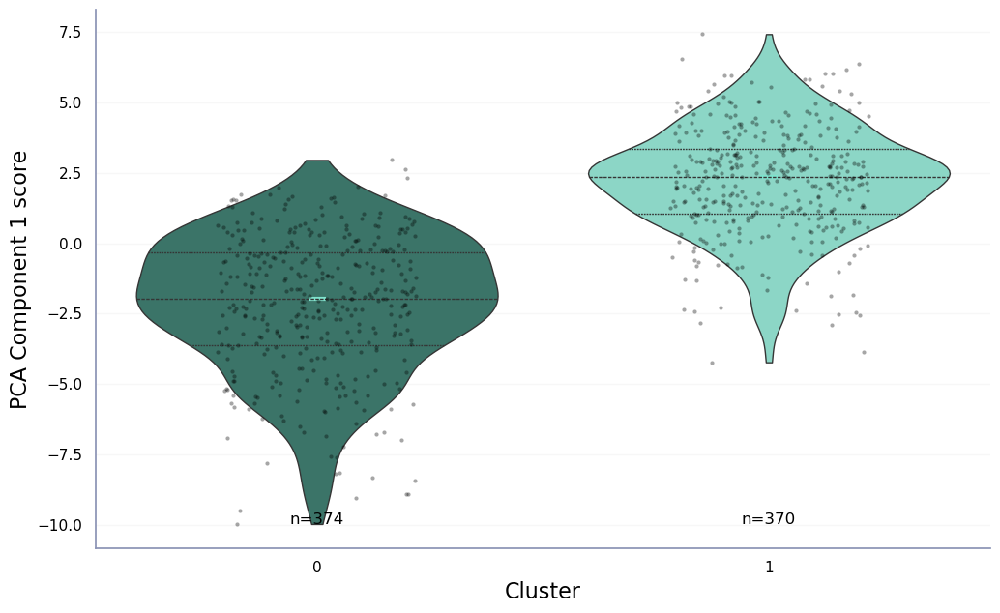

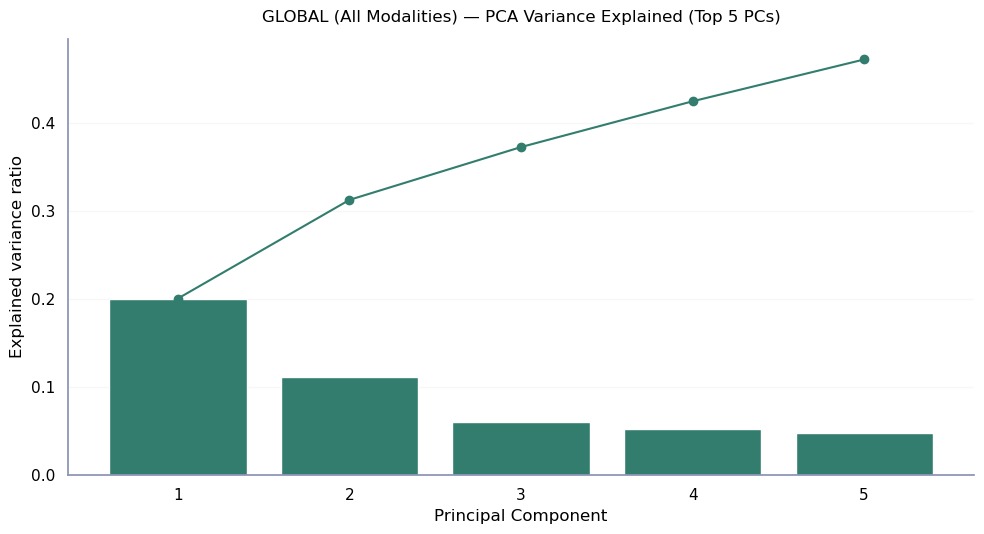

In [211]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# ==========================================================
# GLOBAL PCA (ALL modalities merged) -> PC1 by final clusters
# - Merges modalities on src_subject_id (inner-join by default)
# - Standardizes all features
# - PCA -> PC1
# - Publication-ready violin (quartiles) + jitter + median + n
# - Also saves a variance plot (top 5 PCs) for the merged space
# ==========================================================

global_out_dir = os.path.join(plots_dir, "global_pca_all_modalities/")
os.makedirs(global_out_dir, exist_ok=True)

# ---- 1) Merge all modalities into one wide dataframe ----
dfs = []
for modality, df in dict_final.items():
    tmp = df.copy()

    # Prefix feature names with modality to avoid collisions
    feat_cols = [c for c in tmp.columns if c != "src_subject_id"]
    tmp = tmp.rename(columns={c: f"{modality}__{c}" for c in feat_cols})

    dfs.append(tmp)

# Inner join across modalities by subject id (keeps subjects present in ALL modalities)
merged = dfs[0]
for d in dfs[1:]:
    merged = merged.merge(d, on="src_subject_id", how="inner")

print(f"[GLOBAL PCA] Subjects after inner-join across modalities: {merged.shape[0]}")
print(f"[GLOBAL PCA] Total merged features: {merged.shape[1] - 1}")

# ---- 2) Align final labels to the merged subject IDs ----
clusters = np.asarray(labels_test_final)

# If your final_labels are already in the same row-order as each modality df,
# then this should match the *intersection* order only if you kept the same subjects.
# Safest is to align by subject ID if you have a mapping.
#
# Try to auto-detect a mapping dict if provided:
label_map = final_metrics.get("final_labels_by_subject_id", None)

if label_map is not None:
    # label_map should be {src_subject_id: label}
    merged_clusters = merged["src_subject_id"].map(label_map).to_numpy()
    if np.any(pd.isna(merged_clusters)):
        raise ValueError("Some merged subjects are missing labels in final_labels_by_subject_id.")
else:
    # Fallback: assume labels are already aligned to the rows of EACH modality df.
    # This is ONLY safe if all modality dfs share the same subject order and
    # inner-joining didn't change it. If you see mismatches, create label_map above.
    if len(clusters) != merged.shape[0]:
        raise ValueError(
            f"final_labels length ({len(clusters)}) != merged subjects ({merged.shape[0]}). "
            "Provide final_metrics['final_labels_by_subject_id'] to align labels safely."
        )
    merged_clusters = clusters

# ---- 3) PCA on all features ----
X = merged.drop(columns=["src_subject_id"]).values

# Standardize before PCA
Xz = StandardScaler().fit_transform(X)

# Fit PCA (enough components to report variance for first 5, but at least 2 if possible)
n_pcs = min(5, Xz.shape[1])
pca = PCA(n_components=n_pcs, random_state=0)
scores = pca.fit_transform(Xz)

pc1 = scores[:, 0]
evr = pca.explained_variance_ratio_
cum_evr = np.cumsum(evr)

print(f"[GLOBAL PCA] PC1 EVR: {evr[0]:.2%}")

# ---- 4) Plot PC1 by cluster (global / all modalities) ----
plot_df = pd.DataFrame({"cluster": merged_clusters, "PC1": pc1})
cluster_order = np.sort(pd.unique(plot_df["cluster"]))

fig, ax = plt.subplots(figsize=(10.5, 6.5))

sns.violinplot(
    data=plot_df,
    x="cluster",
    y="PC1",
    order=cluster_order,
    palette=sns.color_palette(n_colors=len(cluster_order)),
    inner="quartile",
    cut=0,
    bw_adjust=1.0,
    linewidth=1,
    ax=ax
)

sns.stripplot(
    data=plot_df,
    x="cluster",
    y="PC1",
    order=cluster_order,
    color="black",
    size=3,
    jitter=0.22,
    alpha=0.35,
    ax=ax
)

# Median marker per cluster
medians = plot_df.groupby("cluster")["PC1"].median()
x_positions = np.arange(len(cluster_order))
ax.scatter(
    x=x_positions,
    y=[medians.loc[c] for c in cluster_order],
    s=180,
    marker="_",
    linewidths=3
)

# Annotate n per cluster near bottom
counts = plot_df["cluster"].value_counts()
ymin, ymax = ax.get_ylim()
y_annot = ymin + 0.04 * (ymax - ymin)
for i, c in enumerate(cluster_order):
    ax.text(i, y_annot, f"n={int(counts.loc[c])}", ha="center", va="bottom", fontsize=12)

ax.set_xlabel("Cluster", fontsize=16)
ax.set_ylabel("PCA Component 1 score", fontsize=16)
ax.grid(axis="y", alpha=0.15)
sns.despine(ax=ax)

fig.tight_layout()
fig.savefig(os.path.join(global_out_dir, "GLOBAL_all_modalities_PC1_violin.png"), dpi=300, bbox_inches="tight")
plt.show()

# ---- 5) Variance explained plot (Top PCs) ----
figv, axv = plt.subplots(figsize=(10, 5.5))
pcs_idx = np.arange(1, n_pcs + 1)

axv.bar(pcs_idx, evr)
axv.plot(pcs_idx, cum_evr, marker="o")

axv.set_xticks(pcs_idx)
axv.set_xlabel("Principal Component")
axv.set_ylabel("Explained variance ratio")
axv.set_title(f"GLOBAL (All Modalities) — PCA Variance Explained (Top {n_pcs} PCs)", pad=12)

axv.grid(axis="y", alpha=0.15)
sns.despine(ax=axv)

figv.tight_layout()
figv.savefig(os.path.join(global_out_dir, f"GLOBAL_all_modalities_variance_top{n_pcs}.png"),
             dpi=300, bbox_inches="tight")
plt.show()

### Differences in categorical variables - individual labels

In [149]:
def add_metadata_and_clusters(dict_final, data_full, mod_num):
    """
    Merge cluster labels into full metadata DataFrame using src_subject_id
    from the actual training data stored in fold_metrics['data'].
    This ensures correct alignment even when not all train_ids were clustered.
    """
    clusters = pd.Series(labels_test_modalities[mod_num])

    # Get the first modality’s dataframe — all have the same subject order
    modality_dfs = dict_final
    if not modality_dfs:
        raise ValueError("dict_final is empty; cannot extract subject IDs.")
    
    # Use the src_subject_id column from the first available modality
    first_modality = list(modality_dfs.keys())[0]
    subj_ids = modality_dfs[first_modality]['src_subject_id'].reset_index(drop=True)
    
    # Sanity check: should match cluster array length
    if len(subj_ids) != len(clusters):
        print(f"⚠️ Mismatch: {len(subj_ids)} subject IDs vs {len(clusters)} cluster labels.")
        min_len = min(len(subj_ids), len(clusters))
        subj_ids = subj_ids.iloc[:min_len]
        clusters = clusters.iloc[:min_len]
        print(f"Trimmed both to {min_len} entries to align.")

    # Build cluster mapping dataframe
    cluster_df = pd.DataFrame({
        'src_subject_id': subj_ids,
        'Cluster': clusters
    })

    # Merge back into full metadata
    merged = pd.merge(data_full, cluster_df, on='src_subject_id', how='left')

    print(f"✅ Merged clusters for {merged['Cluster'].notna().sum()} subjects (out of {len(merged)} total).")
    return merged

def chi_square_comparison(df, group_col, label_col, title_prefix):
    """
    Perform chi-square test and plot grouped bar chart.
    """
    # Drop missing values
    df = df.dropna(subset=[group_col, label_col])

    # Make a copy for plotting / stats so we can safely relabel
    df_plot = df.copy()

    # Rename 'HC' -> 'CC' only for phenotype (for plotting and stats)
    if label_col == 'phenotype':
        df_plot[label_col] = df_plot[label_col].replace({'HC': 'CC'})

    # 1. Summarize counts
    summary_df = (
        df_plot.groupby([group_col, label_col])
        .size()
        .reset_index(name='n')
    )

    # 2. Chi-square test
    tbl = pd.crosstab(df_plot[group_col], df_plot[label_col])
    chi2, pval, dof, expected = chi2_contingency(tbl)
    pval = round(pval, 3)

    # 3. Grouped bar chart
    plt.figure(figsize=(8, 6))
    sns.barplot(
        data=summary_df,
        x=group_col,
        y='n',
        hue=label_col,
        dodge=True
    )
    plt.title(f"{title_prefix}\n(Chi-square p = {pval})")
    plt.xlabel("Cluster")
    plt.ylabel("Count")
    sns.despine()
    plt.tight_layout()
    plt.show()


mod_num = 0
for modality in dict_final.keys():
    print(f"\n=== Analyzing categorical differences for modality: {modality} ===")

    # Merge cluster labels into full data
    df = add_metadata_and_clusters(dict_final[modality], test_data, mod_num)

    # Compare by phenotype (CHR vs CC)
    if 'phenotype' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='phenotype',
            title_prefix=f"Comparison of CHR vs CC per Subgroup",
        )

    # Compare by site
    if 'Site' in df.columns:
        chi_square_comparison(
            df=df,
            group_col='Cluster',
            label_col='Site',
            title_prefix=f"Comparison of Site Distribution per Subgroup",
        )

    # Optional: extend for other categorical variables
    for col in ['sips_bips_scr_lifetime', 'sips_aps_scr_lifetime', 'sips_grd_scr_lifetime']:
        if col in df.columns:
            chi_square_comparison(
                df=df,
                group_col='Cluster',
                label_col=col,
                title_prefix=f"Comparison of {col} per Subgroup",
            )
    mod_num = mod_num + 1





=== Analyzing categorical differences for modality: Internalising ===


ValueError: The truth value of a DataFrame is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

### Mapping modalities -> final

In [150]:
import numpy as np
import pandas as pd

new_test_labels_by_modality = {}

for i, modality in enumerate(modality_names):
    df = dict_final[modality]
    labels = labels_test_modalities[i]

    # Validate alignment
    if len(labels) != len(df):
        raise ValueError(
            f"Length mismatch for {modality}: labels={len(labels)} vs df={len(df)}"
        )

    labels_s = pd.Series(labels, index=df.index)

    uniq = labels_s.dropna().unique()
    if len(uniq) < 2:
        continue

    # Features only (avoid double mean of empty/invalid frames)
    X = df.drop(columns=['src_subject_id'], errors='ignore')
    if X.shape[1] == 0:
        raise ValueError(f"{modality}: no feature columns after dropping src_subject_id")

    # Cluster-specific means
    cluster_means = labels_s.groupby(labels_s).apply(
        lambda s: X.loc[s.index].to_numpy().mean()
    )

    # Choose the "highest mean" cluster as the high_cluster
    high_cluster = cluster_means.sort_values(ascending=False).index[0]

    # Map to severity labels (your modality-specific inversion kept)
    if modality in ("Functioning", "Cognition"):
        # higher score means *lower* severity (per your rule)
        new_labels = np.where(labels_s == high_cluster, "low_severity", "high_severity")
    else:
        new_labels = np.where(labels_s == high_cluster, "high_severity", "low_severity")

    new_test_labels_by_modality[modality] = new_labels.tolist()

In [151]:

stage_order = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]  # example reorder


alluvial_sankey_force_high_top(
    labels_by_modality=new_test_labels_by_modality,
    final_labels=labels_test_final,
    stage_order=stage_order,
    arrangement="snap",
    high_token = "low_severity",
    low_token = "high_severity",
    high_y=0.08,
    low_y=0.92,
    node_thickness=12,          # ↓ thinner nodes
    node_pad=40,                # ↓ tighter vertical spacing requirement
    width=1000,
    height=400,
    title="All modalities → final (alluvial Sankey)",
)

In [152]:
parcats_low_on_top_with_gap_keep_final_numeric(
    new_labels_by_modality=new_test_labels_by_modality,
    final_labels=labels_test_final,
    stage_order=["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"],
    final_name="Integrated",
    top_token="high_severity",          # now HIGH is on top
    bottom_token="low_severity",
    invert_final=False,
    color_for_top_final="#005341",      # top-like final ribbons
    color_for_bottom_final="#B3D9D5",   # bottom-like final ribbons
    add_gap_in_final=True,
    gap_weight=20,
    plots_dir=plots_dir,
    save_file_name = "Parcats_by_final_test.pdf"
)


/var/folders/wr/tvbdcgk96mz7dl1d_qnw0l5m0000gn/T/ipykernel_43120/3605646250.py:111: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [161]:
import pandas as pd

stage_order = ["Psychoticism", "Detachment", "Internalising", "Functioning", "Cognition"]

# Pick subject_id vector from one modality (must share row order with labels)
subject_ids_test = dict_final[stage_order[0]]['src_subject_id'].astype(str).reset_index(drop=True)

# Build the path dataframe
df_paths_test = pd.DataFrame({"src_subject_id": subject_ids_test})
for stage in stage_order:
    df_paths_test[stage] = pd.Series(new_test_labels_by_modality[stage]).astype(str).reset_index(drop=True)

df_paths_test["final"] = pd.Series(labels_test_final).astype(str).reset_index(drop=True)

# Sanity checks
N = len(df_paths_test)
assert all(len(new_test_labels_by_modality[s]) == N for s in stage_order), "Label lengths don't match subject_ids length"
assert len(labels_test_final) == N, "Final labels length doesn't match subject_ids length"

df_paths_test

,src_subject_id,Psychoticism,Detachment,Internalising,Functioning,Cognition,final
0,CA00229,high_severity,low_severity,low_severity,high_severity,low_severity,1
1,CA17436,high_severity,low_severity,low_severity,low_severity,low_severity,1
2,HA03882,low_severity,high_severity,low_severity,low_severity,high_severity,1
3,HA16198,high_severity,low_severity,low_severity,high_severity,high_severity,1
4,HA19439,high_severity,high_severity,low_severity,high_severity,low_severity,0
...,...,...,...,...,...,...,...
739,MU07483,low_severity,high_severity,high_severity,high_severity,high_severity,0
740,HA35140,high_severity,low_severity,high_severity,high_severity,low_severity,0
741,PI13295,high_severity,low_severity,high_severity,high_severity,high_severity,0
742,GA48061,low_severity,low_severity,high_severity,low_severity,high_severity,1


In [164]:
stream_summary_test = summarize_streams(df_paths_test, stage_order, top_k=100, sample_ids=12)
stream_summary_test

,n,pct,stream,example_ids,Psychoticism,Detachment,Internalising,Functioning,Cognition,final
52,125,16.80,Psychoticism=low_severity → Detachment=low_sev...,"[IR00124, IR01451, IR19595, LA14055, NC10194, ...",low_severity,low_severity,low_severity,low_severity,low_severity,1
24,52,6.99,Psychoticism=high_severity → Detachment=low_se...,"[CA17436, NC36722, NN24751, OR02023, OR19379, ...",high_severity,low_severity,low_severity,low_severity,low_severity,1
15,46,6.18,Psychoticism=high_severity → Detachment=low_se...,"[HA20220, NC03026, NC22878, MT22493, MT24774, ...",high_severity,low_severity,high_severity,low_severity,low_severity,0
50,36,4.84,Psychoticism=low_severity → Detachment=low_sev...,"[IR37610, NC17053, NN14164, SF13975, WU09114, ...",low_severity,low_severity,low_severity,low_severity,high_severity,1
0,33,4.44,Psychoticism=high_severity → Detachment=high_s...,"[WU01590, YA69831, CM02493, CM05540, CM11781, ...",high_severity,high_severity,high_severity,high_severity,high_severity,0
1,31,4.17,Psychoticism=high_severity → Detachment=high_s...,"[NN06092, OR19696, SI05265, YA57935, YA60580, ...",high_severity,high_severity,high_severity,high_severity,low_severity,0
3,31,4.17,Psychoticism=high_severity → Detachment=high_s...,"[IR24693, OR13725, PA30176, PA41151, CM06861, ...",high_severity,high_severity,high_severity,low_severity,low_severity,0
47,28,3.76,Psychoticism=low_severity → Detachment=low_sev...,"[HA19417, IR11959, OR28673, TE14162, TE42329, ...",low_severity,low_severity,high_severity,low_severity,low_severity,1
40,27,3.63,Psychoticism=low_severity → Detachment=high_se...,"[IR19434, IR35884, PA21438, PI40525, TE05018, ...",low_severity,high_severity,low_severity,low_severity,low_severity,1
6,19,2.55,Psychoticism=high_severity → Detachment=high_s...,"[HA19439, IR08615, CM01883, MA19973, CA16121, ...",high_severity,high_severity,low_severity,high_severity,low_severity,0


### Comparison between discovery and test in cluster mapping

In [ ]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial.distance import jensenshannon

# Optional (for sankey). If plotly isn't installed, sankey functions will gracefully fail.
try:
    import plotly.graph_objects as go
    _HAS_PLOTLY = True
except Exception:
    _HAS_PLOTLY = False


ARROW_PAT = re.compile(r"\s*(?:→|->)\s*")

def parse_stream(stream_str):
    """
    Parse stream like:
      "Psychoticism=low_severity → Detachment=high_severity → ... → final=1"
    into ordered list of (domain, label).
    """
    if pd.isna(stream_str):
        return []
    parts = [p.strip() for p in ARROW_PAT.split(str(stream_str).strip()) if p.strip()]
    out = []
    for p in parts:
        if "=" in p:
            dom, lab = p.split("=", 1)
            out.append((dom.strip(), lab.strip()))
        else:
            out.append((p.strip(), "<NA>"))
    return out


def infer_stage_order(df, stream_col="stream"):
    """
    Infer stage order from the first non-null stream.
    Assumes all streams follow the same domain order.
    """
    s = df[stream_col].dropna().astype(str)
    if s.empty:
        raise ValueError("No streams found to infer stage order.")
    path = parse_stream(s.iloc[0])
    return [d for d, _ in path]


def _normalize(v, eps=1e-12):
    v = np.asarray(v, dtype=float)
    s = v.sum()
    if s <= 0:
        return np.ones_like(v) / max(1, len(v))
    return v / (s + eps)


# ------------------------------------------------------------
# 1) Prefix-tree comparison: compare P(next | prefix)
# ------------------------------------------------------------

def build_prefix_next(df, stream_col="stream", n_col="n"):
    """
    Returns:
      prefix_next: dict[prefix_tuple_of_(domain,label)] -> dict[next_token_(domain,label)|<END>] -> weight
      prefix_mass: dict[prefix] -> total weight passing through prefix
    Where prefix is a tuple of (domain,label) tokens, e.g.:
      prefix = (("Psychoticism","low_severity"), ("Detachment","high_severity"))
    and next token is the next (domain,label) or "<END>".
    """
    prefix_next = {}
    prefix_mass = {}

    for _, row in df.iterrows():
        w = float(row.get(n_col, 1.0))
        path = parse_stream(row[stream_col])
        if not path:
            continue

        # For each prefix (including empty prefix), record what comes next
        for i in range(len(path)):
            prefix = tuple(path[:i])  # empty prefix for i=0
            nxt = path[i]             # next token
            prefix_mass[prefix] = prefix_mass.get(prefix, 0.0) + w
            d = prefix_next.setdefault(prefix, {})
            d[nxt] = d.get(nxt, 0.0) + w

        # terminal transition from full path to END
        full_prefix = tuple(path)
        prefix_mass[full_prefix] = prefix_mass.get(full_prefix, 0.0) + w
        d = prefix_next.setdefault(full_prefix, {})
        d["<END>"] = d.get("<END>", 0.0) + w

    return prefix_next, prefix_mass


def compare_prefix_structure(df_disc, df_test, stream_col="stream", n_col="n", eps=1e-12):
    """
    For each prefix, compare the conditional distribution over next tokens:
        P_disc(next | prefix)  vs  P_test(next | prefix)

    Returns DataFrame with:
      - prefix_str
      - depth
      - js_next (Jensen–Shannon distance on next-step distributions)
      - mass_disc / mass_test (how much data passes through prefix; useful for weighting but not "size-equality")
      - top_next_disc / top_next_test (most likely next step)
      - support_next_overlap (Jaccard on next-token supports)
    """
    pn_d, pm_d = build_prefix_next(df_disc, stream_col, n_col)
    pn_t, pm_t = build_prefix_next(df_test, stream_col, n_col)

    prefixes = set(pn_d.keys()) | set(pn_t.keys())

    rows = []
    for pref in prefixes:
        nd = pn_d.get(pref, {})
        nt = pn_t.get(pref, {})

        keys = set(nd.keys()) | set(nt.keys())
        # Align next-token vectors
        vd = np.array([nd.get(k, 0.0) for k in keys], dtype=float)
        vt = np.array([nt.get(k, 0.0) for k in keys], dtype=float)

        pd_ = _normalize(vd, eps=eps)
        pt_ = _normalize(vt, eps=eps)

        js = float(jensenshannon(pd_ + eps, pt_ + eps, base=2.0))

        # Next-token support overlap (presence/absence, structure)
        supp_d = {k for k, v in nd.items() if v > 0}
        supp_t = {k for k, v in nt.items() if v > 0}
        supp_j = len(supp_d & supp_t) / max(1, len(supp_d | supp_t))

        # Most likely next token in each
        top_d = max(nd.items(), key=lambda x: x[1])[0] if nd else None
        top_t = max(nt.items(), key=lambda x: x[1])[0] if nt else None

        def tok_str(tok):
            if tok == "<END>":
                return "<END>"
            if tok is None:
                return "<NONE>"
            return f"{tok[0]}={tok[1]}"

        prefix_str = " → ".join([f"{d}={l}" for d, l in pref]) if pref else "<START>"
        rows.append({
            "prefix_str": prefix_str,
            "depth": len(pref),
            "js_next": js,
            "mass_disc": pm_d.get(pref, 0.0),
            "mass_test": pm_t.get(pref, 0.0),
            "top_next_disc": tok_str(top_d),
            "top_next_test": tok_str(top_t),
            "support_next_jaccard": supp_j,
            "prefix_exists_in_disc": pref in pn_d,
            "prefix_exists_in_test": pref in pn_t,
        })

    out = pd.DataFrame(rows)
    # A useful default sorting: prioritize structurally-different AND commonly-used prefixes
    out["mass_min"] = np.minimum(out["mass_disc"], out["mass_test"])
    out = out.sort_values(["mass_min", "js_next"], ascending=[False, False]).reset_index(drop=True)
    return out


def plot_top_prefix_differences(prefix_report, top_n=20, min_depth=1):
    """
    Barh plot of top prefixes by JS(next) after filtering.
    """
    d = prefix_report[prefix_report["depth"] >= min_depth].copy()
    d = d.sort_values("js_next", ascending=False).head(top_n)

    plt.figure(figsize=(11, max(4, 0.35 * len(d))))
    y = np.arange(len(d))[::-1]
    plt.barh(y, d["js_next"].iloc[::-1].to_numpy())
    plt.yticks(y, d["prefix_str"].iloc[::-1].to_list(), fontsize=9)
    plt.xlabel("Jensen–Shannon distance of P(next | prefix)")
    plt.title("Most structurally different prefixes (next-step rule)")
    plt.tight_layout()
    plt.show()


# ------------------------------------------------------------
# 2) Full mapping to final: compare P(final | modalities-prefix)
# ------------------------------------------------------------

def final_mapping_table(df, stream_col="stream", n_col="n", final_domain="final"):
    """
    Builds a table over modality-prefixes (everything up to but excluding final)
    with P(final=label | prefix) computed within each dataset.

    Returns DataFrame:
      prefix_str, final_label, weight
    and also a pivoted table of P(final=...) by prefix.
    """
    rows = []
    for _, row in df.iterrows():
        w = float(row.get(n_col, 1.0))
        path = parse_stream(row[stream_col])
        if not path:
            continue

        # split into prefix (before final) and final token
        final_tokens = [t for t in path if t[0] == final_domain]
        if not final_tokens:
            # If final isn't explicitly present, skip
            continue
        final_tok = final_tokens[-1]  # in case of duplicates, take last
        final_label = final_tok[1]

        # prefix = all tokens before the final token position (first occurrence)
        # more robust: take all tokens except the final-domain token(s)
        prefix = tuple([t for t in path if t[0] != final_domain])

        prefix_str = " → ".join([f"{d}={l}" for d, l in prefix]) if prefix else "<NO_MODALITIES>"
        rows.append({"prefix_str": prefix_str, "final_label": final_label, "w": w})

    long = pd.DataFrame(rows)
    if long.empty:
        return long, pd.DataFrame()

    # Compute conditional probabilities P(final_label | prefix)
    grp = long.groupby(["prefix_str", "final_label"], dropna=False)["w"].sum().reset_index()
    totals = grp.groupby("prefix_str")["w"].sum().reset_index().rename(columns={"w": "w_total"})
    grp = grp.merge(totals, on="prefix_str", how="left")
    grp["p_final_given_prefix"] = grp["w"] / grp["w_total"]

    pivot = grp.pivot_table(index="prefix_str", columns="final_label", values="p_final_given_prefix", fill_value=0.0)
    return grp, pivot


def compare_final_mapping(df_disc, df_test, stream_col="stream", n_col="n", final_domain="final"):
    """
    Compare P(final | modalities) between discovery and test.
    Returns a table with per-prefix deltas per final label plus summary metrics.
    """
    long_d, piv_d = final_mapping_table(df_disc, stream_col, n_col, final_domain)
    long_t, piv_t = final_mapping_table(df_test, stream_col, n_col, final_domain)

    if piv_d.empty or piv_t.empty:
        return pd.DataFrame(), {"note": "No final mapping found (missing final tokens?)"}

    # align
    idx = sorted(set(piv_d.index) | set(piv_t.index))
    cols = sorted(set(piv_d.columns) | set(piv_t.columns))
    A = piv_d.reindex(index=idx, columns=cols).fillna(0.0)
    B = piv_t.reindex(index=idx, columns=cols).fillna(0.0)

    # Delta per final label
    delta = (B - A)
    out = delta.copy()
    out.columns = [f"delta_final={c}" for c in out.columns]
    out.insert(0, "prefix_str", out.index)

    # A per-prefix summary: JS distance between final distributions for that prefix
    js_list = []
    for i in range(A.shape[0]):
        p = _normalize(A.iloc[i].to_numpy())
        q = _normalize(B.iloc[i].to_numpy())
        js_list.append(float(jensenshannon(p + 1e-12, q + 1e-12, base=2.0)))
    out["js_final_given_prefix"] = js_list

    # Add weights: how common the prefix is (within each dataset)
    wD = long_d.groupby("prefix_str")["w"].sum() if not long_d.empty else pd.Series(dtype=float)
    wT = long_t.groupby("prefix_str")["w"].sum() if not long_t.empty else pd.Series(dtype=float)
    out["w_disc"] = out["prefix_str"].map(wD).fillna(0.0)
    out["w_test"] = out["prefix_str"].map(wT).fillna(0.0)
    out["w_min"] = np.minimum(out["w_disc"], out["w_test"])

    # Sort by (common prefixes) then by biggest JS shift in final mapping
    out = out.sort_values(["w_min", "js_final_given_prefix"], ascending=[False, False]).reset_index(drop=True)

    # Global summary metric: weighted average JS over prefixes (weights = w_min)
    w = out["w_min"].to_numpy()
    if w.sum() > 0:
        global_js = float(np.sum(out["js_final_given_prefix"].to_numpy() * w) / w.sum())
    else:
        global_js = float(out["js_final_given_prefix"].mean())

    metrics = {
        "num_prefixes_union": len(out),
        "weighted_js_final_given_prefix": global_js,
        "final_labels": cols,
    }
    return out, metrics


def plot_top_final_mapping_shifts(final_cmp, top_n=20):
    d = final_cmp.head(top_n).copy()
    plt.figure(figsize=(11, max(4, 0.35 * len(d))))
    y = np.arange(len(d))[::-1]
    plt.barh(y, d["js_final_given_prefix"].iloc[::-1].to_numpy())
    plt.yticks(y, d["prefix_str"].iloc[::-1].to_list(), fontsize=9)
    plt.xlabel("JS distance between P(final | prefix) in test vs discovery")
    plt.title("Prefixes with biggest changes in final mapping")
    plt.tight_layout()
    plt.show()


# ------------------------------------------------------------
# 3) Full stream presence + rank overlap
# ------------------------------------------------------------

def stream_presence_and_topk(df_disc, df_test, stream_col="stream", n_col="n", topk=30):
    A = set(df_disc[stream_col].dropna().astype(str))
    B = set(df_test[stream_col].dropna().astype(str))

    presence = {
        "unique_streams_disc": len(A),
        "unique_streams_test": len(B),
        "stream_jaccard_presence": len(A & B) / max(1, len(A | B)),
        "coverage_disc_in_test": len(A & B) / max(1, len(A)),
        "coverage_test_in_disc": len(A & B) / max(1, len(B)),
    }

    pD = df_disc.groupby(stream_col)[n_col].sum().sort_values(ascending=False)
    pT = df_test.groupby(stream_col)[n_col].sum().sort_values(ascending=False)
    pD = pD / pD.sum()
    pT = pT / pT.sum()

    topD = set(pD.index[: min(topk, len(pD))].astype(str))
    topT = set(pT.index[: min(topk, len(pT))].astype(str))

    presence[f"top{topk}_jaccard_by_rank"] = len(topD & topT) / max(1, len(topD | topT))
    presence["top_disc_only"] = sorted(list(topD - topT))[:10]
    presence["top_test_only"] = sorted(list(topT - topD))[:10]
    return presence, pD, pT


# ------------------------------------------------------------
# 4) Sankey (full structure) per dataset
# ------------------------------------------------------------

def sankey_from_streams(df, stream_col="stream", n_col="n", max_edges=200):
    """
    Build a Sankey graph from full streams.
    Nodes are stage-specific label tokens: f"{domain}={label}".
    Edges connect consecutive tokens. We prune to max_edges by weight.
    """
    if not _HAS_PLOTLY:
        raise RuntimeError("Plotly not installed; cannot draw sankey.")

    edge_w = {}
    for _, row in df.iterrows():
        w = float(row.get(n_col, 1.0))
        path = parse_stream(row[stream_col])
        toks = [f"{d}={l}" for d, l in path]
        for a, b in zip(toks[:-1], toks[1:]):
            edge_w[(a, b)] = edge_w.get((a, b), 0.0) + w

    # prune
    edges = sorted(edge_w.items(), key=lambda x: -x[1])[:max_edges]
    nodes = {}
    def nid(x):
        if x not in nodes:
            nodes[x] = len(nodes)
        return nodes[x]

    src, tgt, val = [], [], []
    for (a, b), w in edges:
        src.append(nid(a))
        tgt.append(nid(b))
        val.append(w)

    labels = [None] * len(nodes)
    for k, i in nodes.items():
        labels[i] = k

    fig = go.Figure(data=[go.Sankey(
        node=dict(label=labels, pad=12, thickness=12),
        link=dict(source=src, target=tgt, value=val),
    )])
    return fig


# ------------------------------------------------------------
# Master runner
# ------------------------------------------------------------

def full_structure_report(stream_summary, stream_summary_test, stream_col="stream", n_col="n", topk=30, final_domain="final"):
    # Presence + top-k overlap
    presence, pD, pT = stream_presence_and_topk(stream_summary, stream_summary_test, stream_col, n_col, topk=topk)

    # Prefix-tree structural differences
    prefix_report = compare_prefix_structure(stream_summary, stream_summary_test, stream_col, n_col)

    # Full mapping to final
    final_cmp, final_metrics = compare_final_mapping(stream_summary, stream_summary_test, stream_col, n_col, final_domain)

    return {
        "presence_metrics": presence,
        "p_stream_disc": pD,
        "p_stream_test": pT,
        "prefix_report": prefix_report,
        "final_mapping_compare": final_cmp,
        "final_mapping_metrics": final_metrics,
    }


# -----------------------------
# Example usage
# -----------------------------
# rep = full_structure_report(stream_summary, stream_summary_test, topk=30, final_domain="final")
# rep["presence_metrics"]
# rep["prefix_report"].head(30)  # structural differences by prefix
# plot_top_prefix_differences(rep["prefix_report"], top_n=20, min_depth=1)
#
# rep["final_mapping_metrics"]
# rep["final_mapping_compare"].head(30)
# plot_top_final_mapping_shifts(rep["final_mapping_compare"], top_n=20)
#
# # Sankey (if plotly installed)
# if _HAS_PLOTLY:
#     figD = sankey_from_streams(stream_summary, max_edges=250)
#     figD.update_layout(title_text="Discovery stream structure (Sankey)")
#     figD.show()
#     figT = sankey_from_streams(stream_summary_test, max_edges=250)
#     figT.update_layout(title_text="Test stream structure (Sankey)")
#     figT.show()

In [165]:
rep = full_structure_report(stream_summary, stream_summary_test, topk=100, final_domain="final")

rep["presence_metrics"]

{'unique_streams_disc': 43,
 'unique_streams_test': 53,
 'stream_jaccard_presence': 0.6842105263157895,
 'coverage_disc_in_test': 0.9069767441860465,
 'coverage_test_in_disc': 0.7358490566037735,
 'top100_jaccard_by_rank': 0.6842105263157895,
 'top_disc_only': ['Psychoticism=high_severity → Detachment=high_severity → Internalising=low_severity → Functioning=high_severity → Cognition=low_severity → final=1',
  'Psychoticism=low_severity → Detachment=low_severity → Internalising=low_severity → Functioning=high_severity → Cognition=high_severity → final=0',
  'Psychoticism=low_severity → Detachment=low_severity → Internalising=low_severity → Functioning=high_severity → Cognition=low_severity → final=0',
  'Psychoticism=low_severity → Detachment=low_severity → Internalising=low_severity → Functioning=low_severity → Cognition=high_severity → final=0'],
 'top_test_only': ['Psychoticism=high_severity → Detachment=high_severity → Internalising=low_severity → Functioning=high_severity → Cogniti

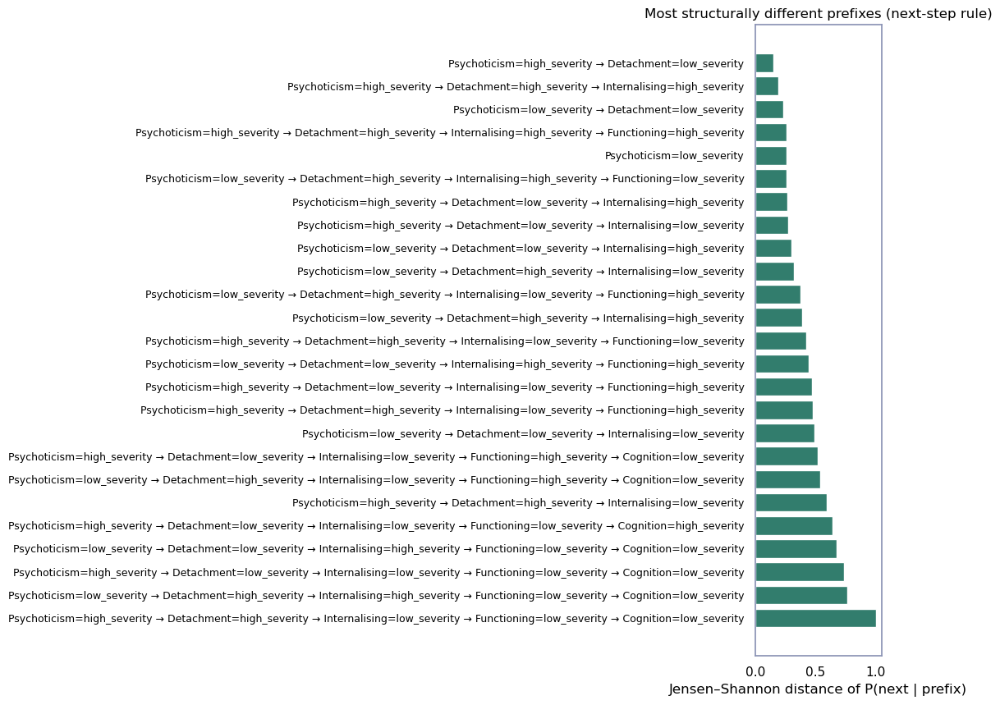

In [ ]:
# Where does the pathway grammar differ most?
rep["prefix_report"].head(25)
plot_top_prefix_differences(rep["prefix_report"], top_n=25, min_depth=1)

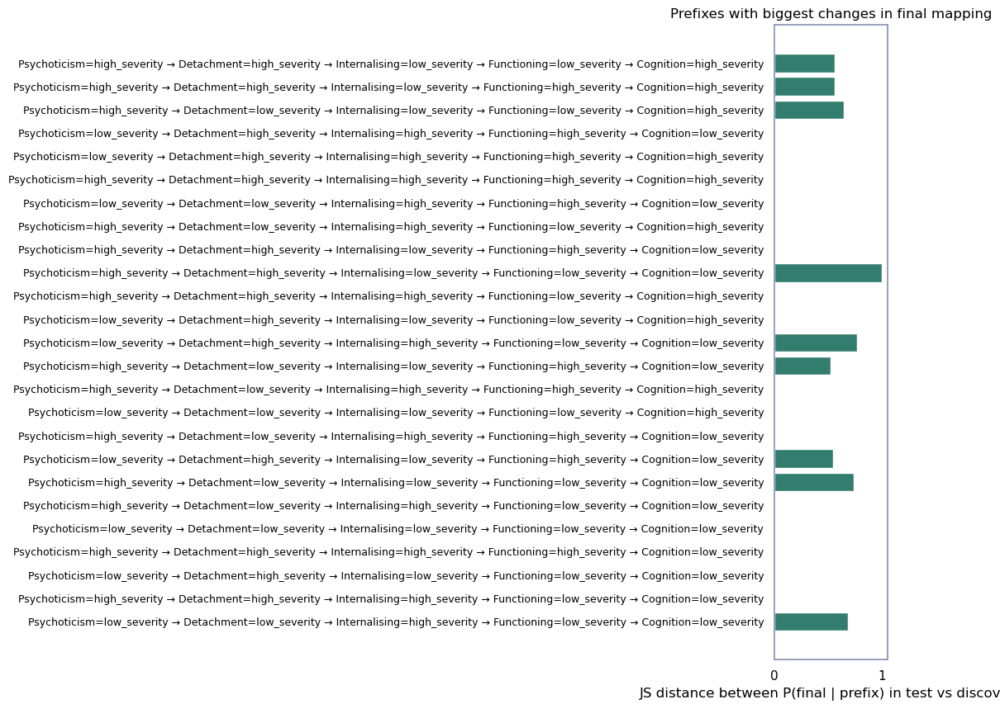

In [ ]:
# Does the multimodal signature map to the same final label?
rep["final_mapping_metrics"]
rep["final_mapping_compare"].head(25)
plot_top_final_mapping_shifts(rep["final_mapping_compare"], top_n=25)

In [166]:
import pandas as pd
import numpy as np

def all_streams_table(stream_summary, stream_summary_test, stream_col="stream", n_col="n"):
    # Aggregate in case there are duplicate stream rows
    disc = (stream_summary
            .groupby(stream_col, dropna=False)[n_col]
            .sum()
            .rename("n_disc")
            .to_frame())

    test = (stream_summary_test
            .groupby(stream_col, dropna=False)[n_col]
            .sum()
            .rename("n_test")
            .to_frame())

    # Outer join gives union of streams
    tbl = disc.join(test, how="outer").fillna(0)

    # Add proportions within each dataset
    N_disc = tbl["n_disc"].sum()
    N_test = tbl["n_test"].sum()

    tbl["p_disc"] = tbl["n_disc"] / N_disc if N_disc > 0 else np.nan
    tbl["p_test"] = tbl["n_test"] / N_test if N_test > 0 else np.nan

    # Helpful comparisons
    tbl["delta_p"] = tbl["p_test"] - tbl["p_disc"]
    tbl["abs_delta_p"] = tbl["delta_p"].abs()
    tbl["log2_fc"] = np.log2((tbl["p_test"] + 1e-12) / (tbl["p_disc"] + 1e-12))

    # Make stream a real column, sort by biggest shift
    tbl = tbl.reset_index().rename(columns={stream_col: "stream"})
    tbl = tbl.sort_values("abs_delta_p", ascending=False).reset_index(drop=True)

    return tbl

# Usage
streams_tbl = all_streams_table(stream_summary, stream_summary_test)
streams_tbl.head(100)

,stream,n_disc,n_test,p_disc,p_test,delta_p,abs_delta_p,log2_fc
0,Psychoticism=low_severity → Detachment=high_se...,114.0,27.0,0.171429,0.036290,-0.135138,0.135138,-2.239951
1,Psychoticism=low_severity → Detachment=low_sev...,24.0,125.0,0.036090,0.168011,0.131921,0.131921,2.218874
2,Psychoticism=high_severity → Detachment=low_se...,0.0,52.0,0.000000,0.069892,0.069892,0.069892,36.024418
3,Psychoticism=high_severity → Detachment=high_s...,37.0,4.0,0.055639,0.005376,-0.050263,0.050263,-3.371402
4,Psychoticism=low_severity → Detachment=high_se...,36.0,4.0,0.054135,0.005376,-0.048759,0.048759,-3.331873
5,Psychoticism=low_severity → Detachment=low_sev...,0.0,28.0,0.000000,0.037634,0.037634,0.037634,35.131333
6,Psychoticism=low_severity → Detachment=high_se...,34.0,12.0,0.051128,0.016129,-0.034999,0.034999,-1.664449
7,Psychoticism=high_severity → Detachment=high_s...,7.0,33.0,0.010526,0.044355,0.033829,0.033829,2.075091
8,Psychoticism=low_severity → Detachment=low_sev...,34.0,14.0,0.051128,0.018817,-0.032311,0.032311,-1.442056
9,Psychoticism=high_severity → Detachment=low_se...,20.0,46.0,0.030075,0.061828,0.031753,0.031753,1.039686


# Month 2 comparisons

Load in month 2 data

## Discovery

### Individual labels

### Integrated labels

## Test

### Individual labels

### Integrated labels

# Save dataframe with subject IDs and labels

In [179]:
# Save dataframe with subject ids and all labels discovery

## Create dataframe with subjects ids and all labels for discovery
subject_ids_disc = final_metrics['data'][stage_order[0]]['src_subject_id'].astype(str).reset_index(drop=True)
df_disc_labels = pd.DataFrame({"src_subject_id": subject_ids_disc})
for stage in stage_order:
    df_disc_labels[stage] = pd.Series(new_labels_by_modality[stage]).astype(str).reset_index(drop=True)
df_disc_labels["final"] = pd.Series(final_metrics["final_labels"]).astype(str).reset_index(drop=True) 

## Create dataframe with subjects ids and all labels for test
subject_ids_test = dict_final[stage_order[0]]['src_subject_id'].astype(str).reset_index(drop=True)
df_test_labels = pd.DataFrame({"src_subject_id": subject_ids_test})
for stage in stage_order:
    df_test_labels[stage] = pd.Series(new_test_labels_by_modality[stage]).astype(str).reset_index(drop=True)
df_test_labels["final"] = pd.Series(labels_test_final).astype(str).reset_index(drop=True) 

## Save to CSV files
df_disc_labels.to_csv("discovery_labels.csv", index=False)
df_test_labels.to_csv("test_labels.csv", index=False)